In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days

%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

38


In [2]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [3]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])*(t- coeffs[3]) )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQR','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logisticQR')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x


In [24]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly Change,Net Change,Density (P/Km²),Land Area (Km²),Migrants (net),Fert. Rate,Med. Age,Urban Pop %,World Share
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [25]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [26]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [27]:
df.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1019143,North America,North America,NaN,1386.0,254.0,17362.0,NaN,1348588,79700.0,249745.0,NaN,NaN
1,781335,Europe,Europe,NaN,46.0,10.0,16502.0,NaN,1494019,144112.0,568572.0,NaN,NaN
2,250527,Asia,Asia,NaN,580.0,17.0,5258.0,NaN,587772,20467.0,316778.0,NaN,NaN
3,143797,South America,South America,NaN,1371.0,42.0,9958.0,NaN,238196,12023.0,82376.0,NaN,NaN
4,31329,Africa,Africa,NaN,64.0,2.0,128.0,NaN,50230,1919.0,16982.0,NaN,NaN


In [28]:
df.tail()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
224,143797,South America,Total:,NaN,1371.0,42.0,9958.0,NaN,238196,12023.0,82376.0,NaN,NaN
225,31329,Africa,Total:,NaN,64.0,2.0,128.0,NaN,50230,1919.0,16982.0,NaN,NaN
226,965,Australia/Oceania,Total:,NaN,28.0,2.0,31.0,NaN,8467,118.0,7384.0,NaN,NaN
227,61,NaN,Total:,NaN,NaN,NaN,4.0,NaN,721,15.0,645.0,NaN,NaN
228,434135,Europe,European Union,247.301231,46.0,10.0,11888.0,26309.595681,1052341,110111.0,507845.0,11714361.0,2363.480708


In [29]:
dfAll.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1019143,North America,North America,NaN,1386.0,254.0,17362.0,NaN,1348588,79700.0,249745.0,NaN,NaN
1,781335,Europe,Europe,NaN,46.0,10.0,16502.0,NaN,1494019,144112.0,568572.0,NaN,NaN
2,250527,Asia,Asia,NaN,580.0,17.0,5258.0,NaN,587772,20467.0,316778.0,NaN,NaN
3,143797,South America,South America,NaN,1371.0,42.0,9958.0,NaN,238196,12023.0,82376.0,NaN,NaN
4,31329,Africa,Africa,NaN,64.0,2.0,128.0,NaN,50230,1919.0,16982.0,NaN,NaN


In [30]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
89,699,Europe,Lithuania,17.0,0.0,0.0,17.0,54772.0,1423,46.0,678.0,149106.0,523.0


No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


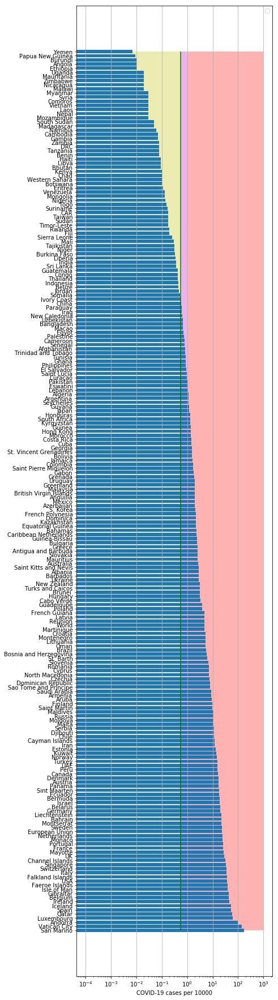

In [31]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


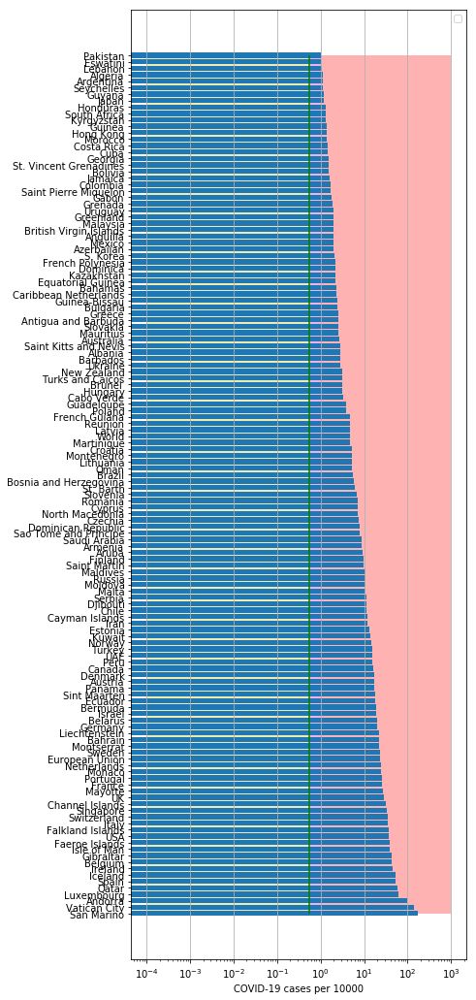

In [32]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

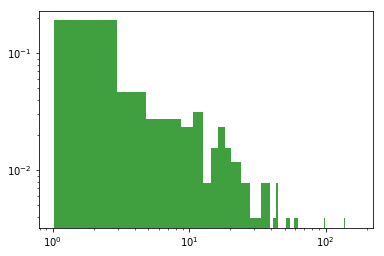

In [33]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [34]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
          date   cases  active    death
66 2020-05-01  242988   75714  24824.0
67 2020-05-02  245567   74234  25100.0
68 2020-05-03  247122   73300  25264.0
69 2020-05-04  248301   71240  25428.0
70 2020-05-05  250561   70230  25613.0
GB
          date   cases  active    death
65 2020-05-01  177454  149600  27510.0
66 2020-05-02  182260  153785  28131.0
67 2020-05-03  186599  157809  28446.0
68 2020-05-04  190584  161506  28734.0
69 2020-05-05  194990  165219  29427.0
IT
          date   cases  active    death
68 2020-05-01  207428  100943  28236.0
69 2020-05-02  209328  100704  28710.0
70 2020-05-03  210717  100179  28884.0
71 2020-05-04  211938   99980  29079.0
72 2020-05-05  213013   98467  29315.0
LT
          date  cases  active  death     tests
53 2020-05-01   1406     728   45.0  138270.0
54 2020-05-02   1410     727   46.0  141678.0
55 2020-05-03   1419     735   46.1  144029.0
56 2020-05-04   1423     678   46.0  149106.0
57 2020-05-05   1423     699   46.0       NaN
Ukr
  

          date  cases  active  death
52 2020-05-01   6720  5906.0  192.0
53 2020-05-02   7090  6252.0  197.0
54 2020-05-03   7197  6356.0  200.0
55 2020-05-04   7387  6458.0  203.0
56 2020-05-05   7523  6490.0  210.0
PU
          date  cases   active   death
55 2020-05-01  40459  28206.0  1124.0
56 2020-05-02  42534  28900.0  1200.0
57 2020-05-03  45928  31092.0  1286.0
58 2020-05-04  47372  31601.0  1344.0
59 2020-05-05  51189  34332.0  1444.0
SB
          date  cases  active  death
52 2020-05-01   9205  7641.0  185.0
53 2020-05-02   9362  7747.0  189.0
54 2020-05-03   9464  7720.0  193.0
55 2020-05-04   9557  7786.0  197.0
56 2020-05-05   9677  7754.0  200.0
AG
          date   cases  active  death
58 2020-05-01  4532.0  3015.0  225.0
59 2020-05-02  4681.0  3124.0  237.0
60 2020-05-03  4783.0  3183.0  246.0
61 2020-05-04  4887.0  3185.0  260.0
62 2020-05-05  5020.0  3284.0  264.0
CT
          date  cases  active  death
62 2020-05-01   2085   589.0   75.0
63 2020-05-02   2088   548.0 

In [35]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)

In [36]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.7948700613380543
intercept: -2.914642282459711
slope: [0.12688151]


/usr/local/lib/python3.5/dist-packages/pandas/plotting/_converter.py:129: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


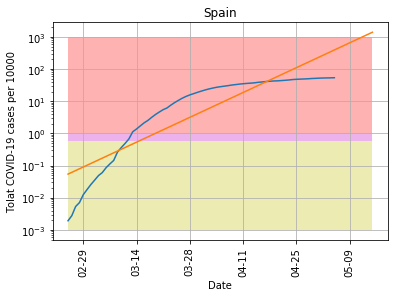

In [37]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-05-15', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [38]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.9019327124505176
intercept: -4.461511867248462
slope: [0.13771801]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


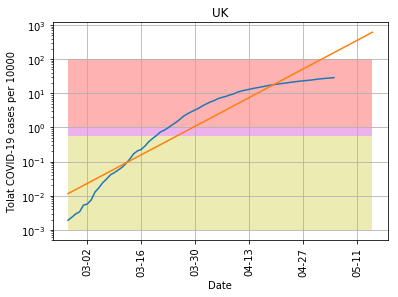

In [39]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-05-15', "pictures/coronaGB.png", model1, 'UK',100)

In [40]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 4.0718751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9938352037622925
intercept: 1.9290310346618538
slope: [-0.0513316]


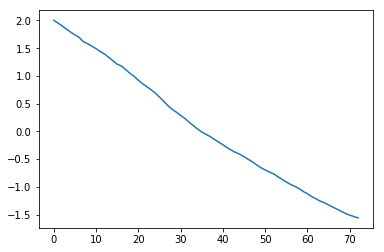

In [41]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


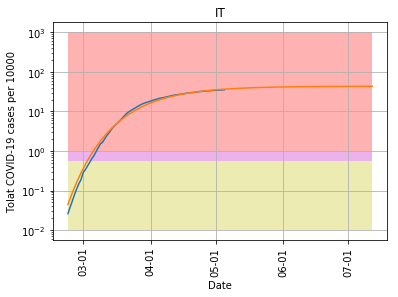

In [42]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-07-12', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [43]:
cs=y_pred11[-1]/10000.*populationIT

In [44]:
cs

261410.8557757701

In [45]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.7153131285000927
intercept: -2.546644729984232
slope: [0.09847925]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


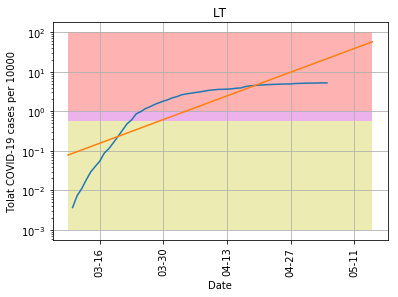

In [46]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-05-15', "pictures/coronaLT.png", model1, 'LT',100)

In [47]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9938352037622925
intercept: -6.298146192719458
slope: [0.15720272]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


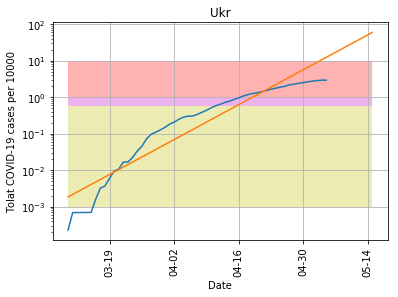

In [48]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-05-15', "pictures/coronaUkr.png", model11, 'Ukr',10)

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


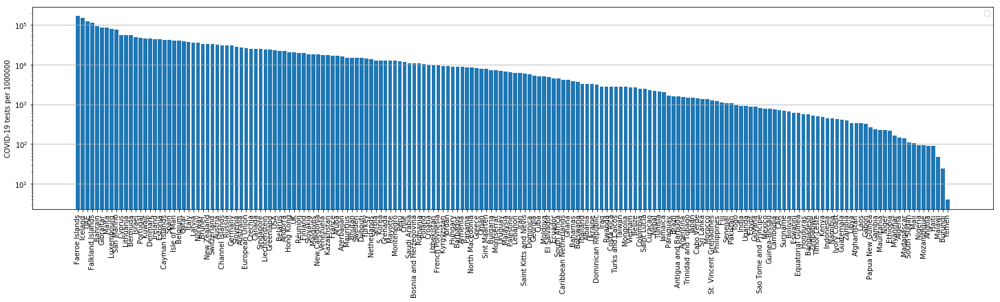

In [49]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [50]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9938352037622925
intercept: -4.048656601770069
slope: [0.14613426]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


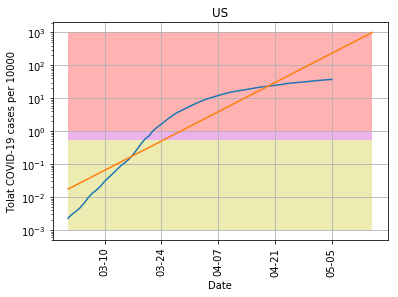

In [51]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-05-15', "pictures/coronaUS.png", model11, 'US',1000)

In [52]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
228  European Union  0.104634


(0, 0.15)

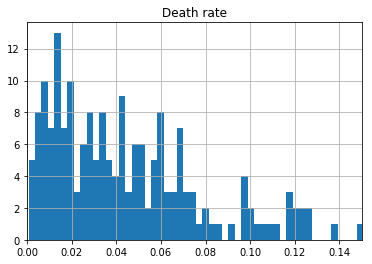

In [53]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
plt.xlim([0,0.15])

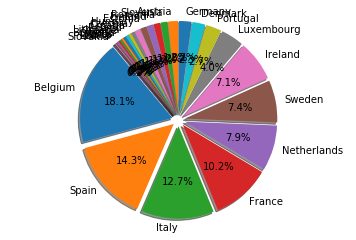

In [54]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [55]:
dfTTh.head()

,Country,Deathsper1Mpop
19,Belgium,692.0
8,Spain,548.0
9,Italy,485.0
11,France,391.0
21,Netherlands,302.0


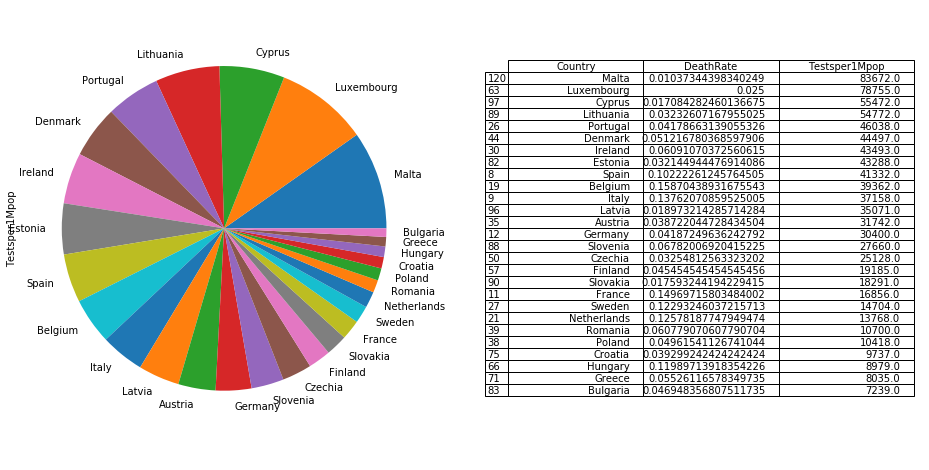

In [56]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

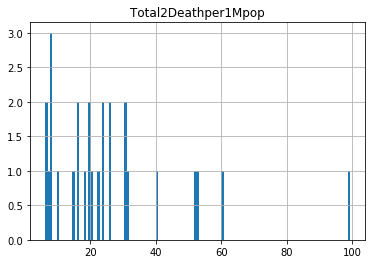

In [57]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [58]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
8,Spain,5359.0,548.0
9,Italy,3523.0,485.0
11,France,2613.0,391.0
12,Germany,1993.0,83.0
19,Belgium,4358.0,692.0


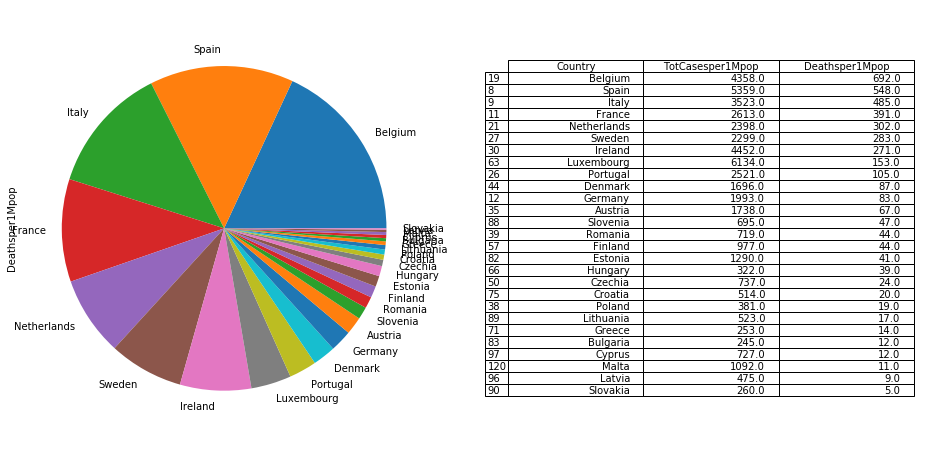

In [59]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [60]:
dfAll.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1019143,North America,North America,0.0,1386.0,254.0,17362.0,0.0,1348588,79700.0,249745.0,0.0,0.0
1,781335,Europe,Europe,0.0,46.0,10.0,16502.0,0.0,1494019,144112.0,568572.0,0.0,0.0
2,250527,Asia,Asia,0.0,580.0,17.0,5258.0,0.0,587772,20467.0,316778.0,0.0,0.0
3,143797,South America,South America,0.0,1371.0,42.0,9958.0,0.0,238196,12023.0,82376.0,0.0,0.0
4,31329,Africa,Africa,0.0,64.0,2.0,128.0,0.0,50230,1919.0,16982.0,0.0,0.0


In [61]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
8,Spain,0.129657
9,Italy,0.094811
11,France,0.155019
12,Germany,0.065559
19,Belgium,0.110716


In [62]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

In [63]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))

     Country  Cases2Testsper1Mpop
 Netherlands             0.174172
      Sweden             0.156352
      France             0.155019
       Spain             0.129657
     Belgium             0.110716
     Ireland             0.102361
       Italy             0.094811
  Luxembourg             0.077887
     Romania             0.067196
     Germany             0.065559
    Portugal             0.054759
     Austria             0.054754
     Croatia             0.052788
     Finland             0.050925
     Denmark             0.038115
      Poland             0.036571
     Hungary             0.035861
    Bulgaria             0.033844
      Greece             0.031487
     Estonia             0.029800
     Czechia             0.029330
    Slovenia             0.025127
    Slovakia             0.014215
      Latvia             0.013544
      Cyprus             0.013106
       Malta             0.013051
   Lithuania             0.009549


In [64]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
33,Qatar,0.000700,38098.000000
31,Singapore,0.000927,24600.000000
93,Djibouti,0.001786,14553.000000
64,Bahrain,0.002151,91387.000000
117,Maldives,0.003490,18246.000000
94,Hong Kong,0.003842,20674.000000
122,Guinea-Bissau,0.004211,762.000000
74,Uzbekistan,0.004511,9710.000000
69,Oman,0.004753,7923.000000
129,Palestine,0.005391,6312.000000


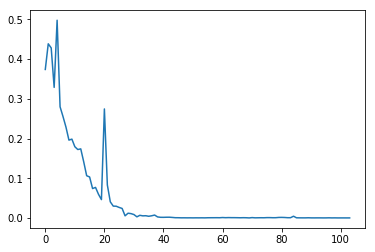

In [65]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [66]:
#np.diff(np.log(dfCN["cases"].values))

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.


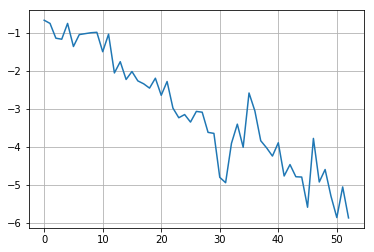

In [67]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in log
  This is separate from the ipykernel package so we can avoid doing imports until


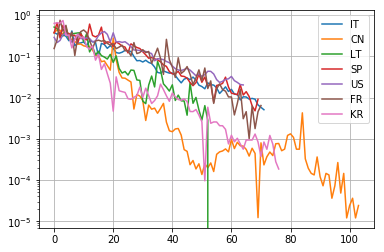

In [68]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

65 65
coefficient of determination: 0.9350981463004918
intercept: -7.528130688178038
slope: [-0.18913293]


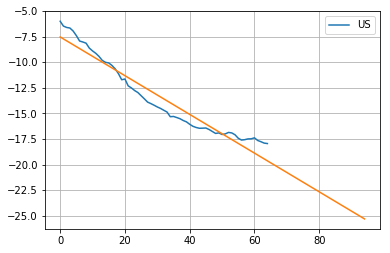

In [69]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

72 72
coefficient of determination: 0.9253088968409872
intercept: -8.830344772754145
slope: [-0.13627363]


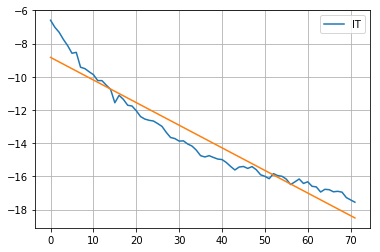

In [70]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [71]:
#model11.coef_

In [72]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

54 54
coefficient of determination: 0.973060603907959
intercept: -14.421825249848268
slope: [-0.09401688]


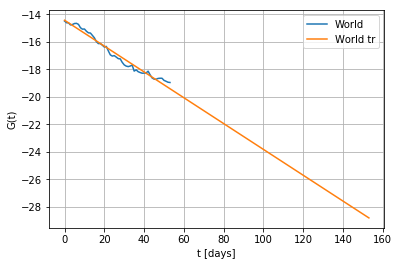

In [73]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

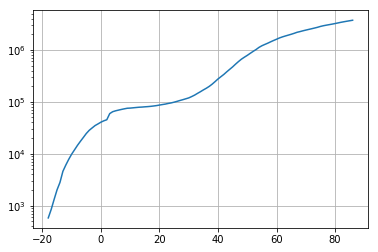

In [74]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [75]:
dfW['cases'].values

array([    580,     845,    1317,    2015,    2800,    4581,    6058,
          7813,    9823,   11950,   14553,   17391,   20630,   24545,
         28266,   31439,   34876,   37552,   40553,   43099,   45134,
         59287,   64438,   67100,   69197,   71329,   73332,   75184,
         75700,   76677,   77673,   78651,   79205,   80087,   80828,
         81820,   83112,   84615,   86604,   88585,   90443,   93016,
         95314,   98425,  102050,  106099,  109991,  114381,  118948,
        126214,  134576,  145483,  156653,  169593,  182490,  198238,
        218822,  244933,  275597,  305036,  337489,  378860,  422629,
        471035,  531864,  596366,  663079,  723279,  784738,  858355,
        936237, 1016330, 1117928, 1203058, 1274578, 1347566, 1432869,
       1519195, 1605277, 1700004, 1780713, 1853505, 1925330, 2000065,
       2084633, 2183942, 2252370, 2332650, 2407467, 2482272, 2557917,
       2638909, 2725972, 2833697, 2921571, 2995209, 3065871, 3139009,
       3221029, 3308

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 5.21372470e+06  3.76549271e+00 -2.94745113e+01  1.23405011e-02]


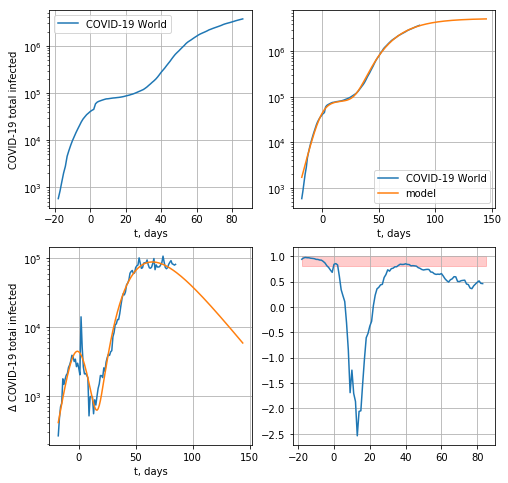

23676.208502327314


In [76]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

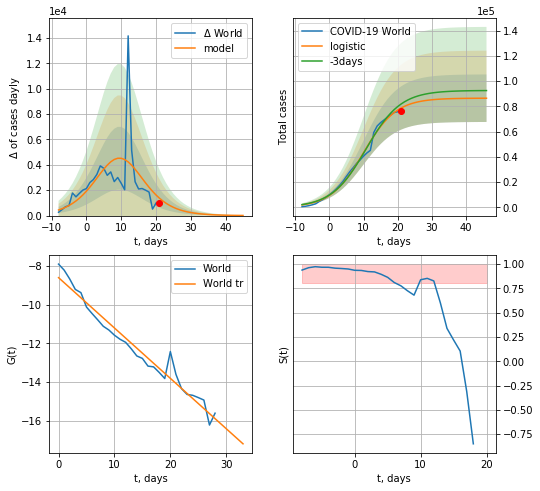

World data at: 2020-05-05
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +25 days
	 deltaDaycases:  10
	 total cases:  86428 ± 18824
	 total death:  5989 ± 3913
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


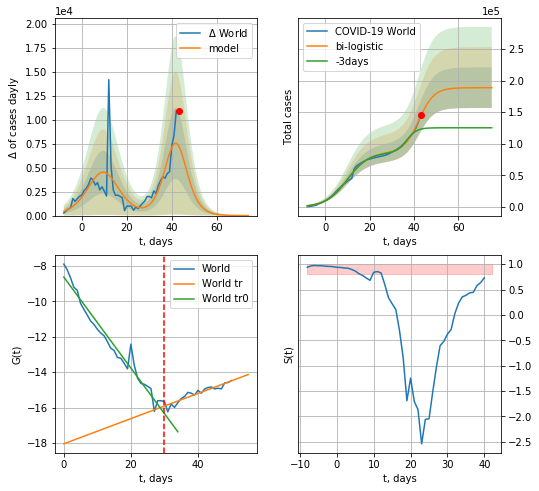

World data at: 2020-05-05
+3 day model MAPE: 0.2157297639626565
model: bi-logistic
coeffs:  [1.02227608e+05 2.95650820e-01 4.22366999e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860985061978
forecast at the end of period: +32 days
	 deltaDaycases:  2
	 total cases:  188694 ± 32064
	 total death:  13076 ± 6665
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


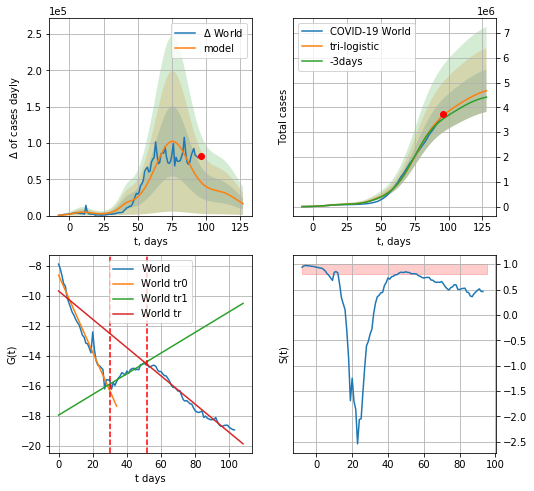

World data at: 2020-05-05
+3 day model MAPE: 0.03870160294999629
model: tri-logistic
coeffs:  [3.72506615e+06 1.08164491e-01 7.56309443e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227608e+05
 2.95650820e-01 4.22366999e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.1833281708146213
forecast at the end of period: +32 days
	 deltaDaycases:  16297
	 total cases:  4672338 ± 856571
	 total death:  323798 ± 178083
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.970243
 intercept: -9.692707
 slope: -0.094346


In [77]:
vL = 30
x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*10-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

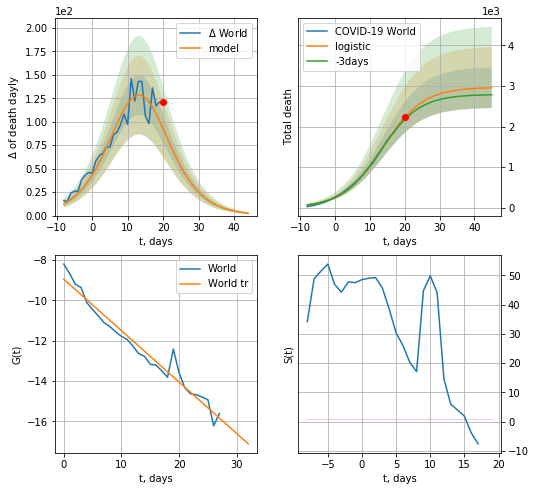

World data at: 2020-05-05
+3 day model MAPE: 0.027312192470115494
model: logistic
coeffs:  [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16928081921473714
forecast at the end of period: +25 days
	 total death:  2956 ± 500
trend coefficient of determination: 0.959176
 intercept: -8.958870
 slope: -0.254930


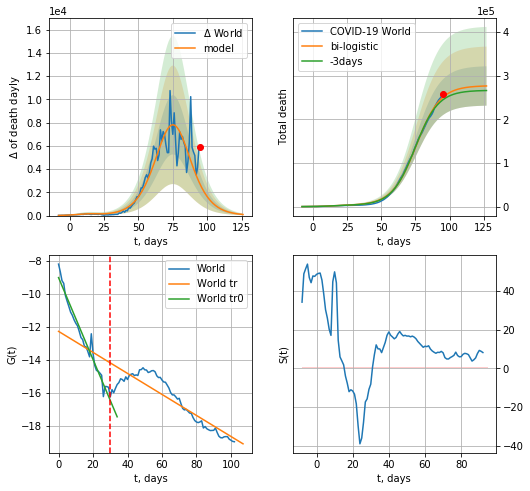

World data at: 2020-05-05
+3 day model MAPE: 0.024651014838356047
model: bi-logistic
coeffs:  [2.74482953e+05 1.13948966e-01 7.55599117e+01] [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16316210625760447
forecast at the end of period: +32 days
	 deltaDaydeath:  93
	 total death:  276673 ± 45142
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.960969
 intercept: -9.026339
 slope: -0.247583
trend coefficient of determination: 0.801827
 intercept: -12.276592
 slope: -0.063565


In [78]:
vL = 30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*9-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*10-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [79]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


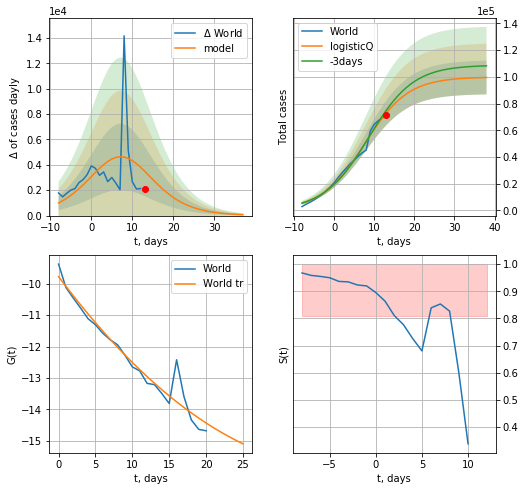

World data at: 2020-05-05
+3 day model MAPE: 0.031802
model: logisticQ
coeffs: [ 9.98643255e+04  1.79652646e-05  7.63889680e+00 -1.03375904e+04]
rational stdev: 0.126959
forecast at the end of period: +25 days
	 deltaDaycases: 70
	 total cases: 99517 ± 12634
	 total death: 6896 ± 2626
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


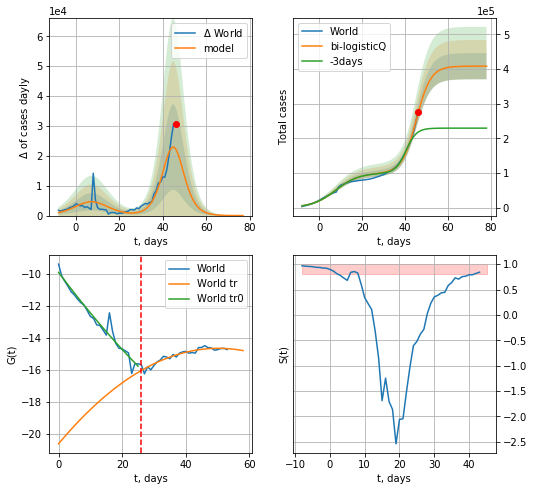

World data at: 2020-05-05
+3 day model MAPE: 0.322399
model: bi-logisticQ
coeffs: [ 3.08550720e+05  9.52088730e-05  4.52981129e+01 -3.08910430e+03]
rational stdev: 0.092561
forecast at the end of period: +32 days
	 deltaDaycases: 5
	 total cases: 408398 ± 37801
	 total death: 28302 ± 7859
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


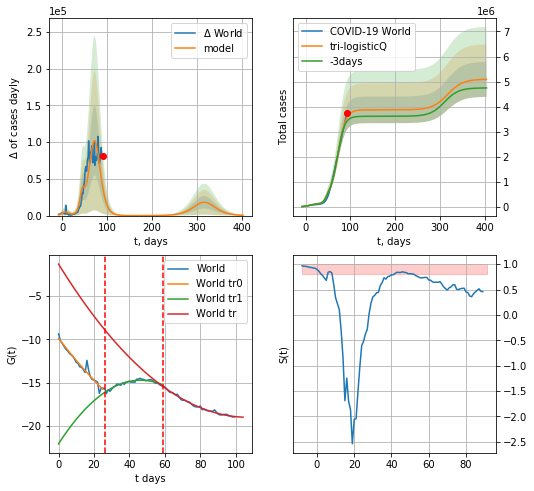

World data at: 2020-05-05
+3 day model MAPE: 0.044982
model: bi-logisticQ
coeffs: [ 3.46017754e+06  1.92678624e-06  7.27167811e+01 -6.11127277e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.137365
forecast at the end of period: +312 days
	 deltaDaycases: 424
	 total cases: 5087082 ± 698784
	 total death: 352540 ± 145279
tri-logisticQ approximation splitting points: 26,59
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.874764
 intercept_: -22.035447570025077
 coeffs_: [ 0.          0.31660897 -0.00341999]
trend coefficient of determination: 0.989986
 intercept_: -1.3387764729766225
 coeffs_: [ 0.         -0.33064627  0.00154962]


In [80]:
vL=30 - 4
vL1=59
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*9-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*10-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*50-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

In [81]:
#x = forecastR("World",dfW[:30],d1,7*9-dT,1.0)
#xx = forecast2R("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


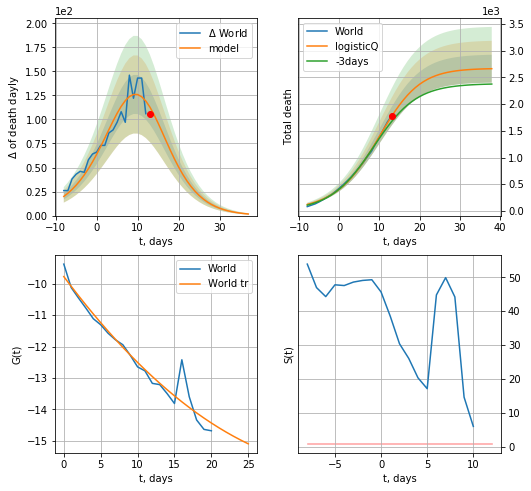

World data at: 2020-05-05
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67019299e+03  8.28077677e-04  9.49653382e+00 -2.18469917e+02]
rational stdev: 0.098000
forecast at the end of period: +25 days
	 total death: 2663 ± 261
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


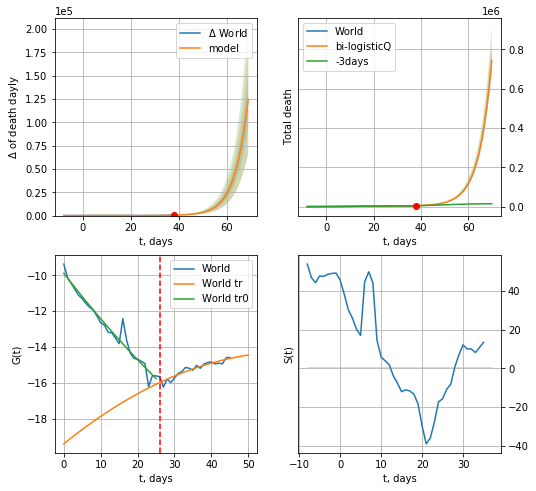

World data at: 2020-05-05
+3 day model MAPE: 0.105655
model: bi-logisticQ
coeffs: [ 6.42204134e+06  6.90051546e-04  7.95652837e+01 -2.38689793e+02]
rational stdev: 0.076590
forecast at the end of period: +32 days
	 total death: 743257 ± 56926
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:432: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


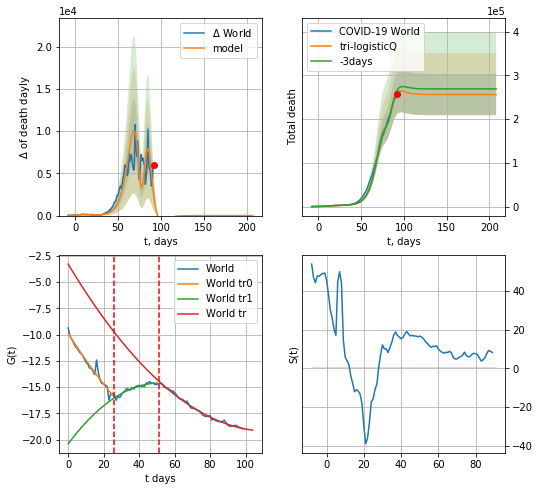

World data at: 2020-05-05
+3 day model MAPE: 0.028006
model: bi-logisticQ
coeffs: [-6.16828869e+06  5.42175485e-05  7.97235872e+01 -4.09461014e+03]
rational stdev: 0.184649
forecast at the end of period: +116 days
	 total death: 256422 ± 47348
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.992774
 intercept_: -3.3084696694693534
 coeffs_: [ 0.         -0.28122654  0.00124549]


In [82]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*9-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*10-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*22-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


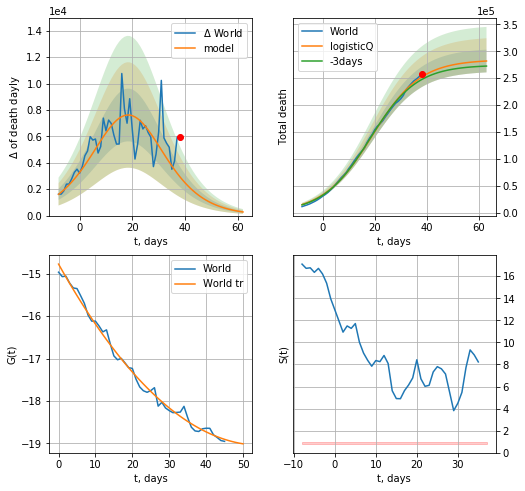

World data at: 2020-05-05
+3 day model MAPE: 0.020486
model: logisticQ
coeffs: [ 2.84286329e+05  1.18555046e-05  1.88661755e+01 -9.02854936e+03]
rational stdev: 0.074933
forecast at the end of period: +25 days
	 total death: 281864 ± 21120
trend coefficient of determination: 0.992414
 intercept_: -14.775981870752632
 coeffs_: [ 0.         -0.15534169  0.00141348]


In [83]:
x = forecastRRR("World",dfW[58:],d1,7*9-dT,1.0,False,cases='death')

In [529]:
#trend(dfSP,'SP',10)

In [531]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

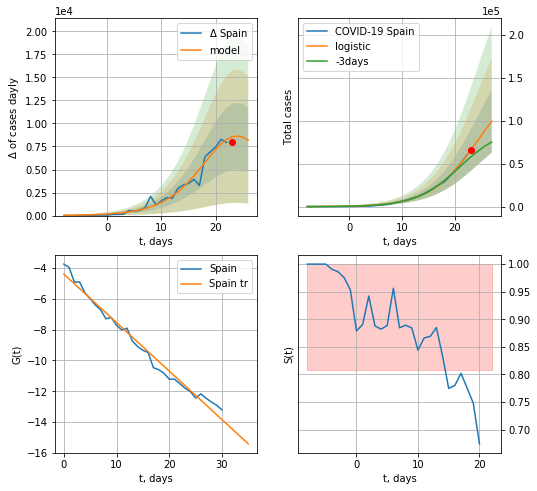

Spain data at: 2020-05-05
+3 day model MAPE: 0.17994225331219452
model: logistic
coeffs:  [1.55796358e+05 2.21769203e-01 2.44355993e+01]
rational stdev:  0.3682790859287634
forecast at the end of period: +4 days
	 deltaDaycases:  8193
	 total cases:  99470 ± 36632
	 total death:  10168 ± 11233
trend coefficient of determination: 0.981962
 intercept: -4.388643
 slope: -0.315050


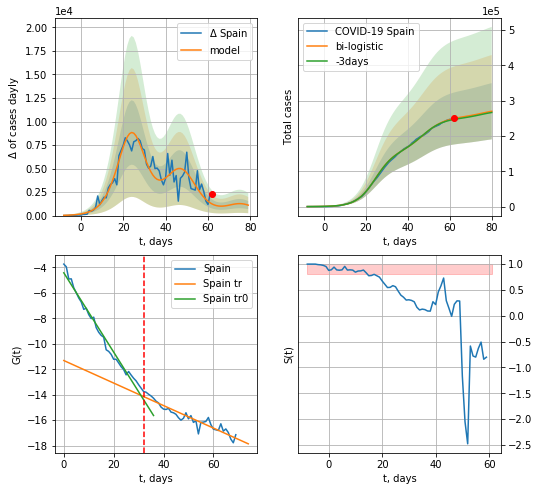

Spain data at: 2020-05-05
+3 day model MAPE: 0.011118283302749573
model: bi-logistic
coeffs:  [9.78405382e+04 1.95741872e-01 4.75613801e+01] [1.55796358e+05 2.21769203e-01 2.44355993e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.2948441764967477
forecast at the end of period: +18 days
	 deltaDaycases:  1109
	 total cases:  270151 ± 79652
	 total death:  27615 ± 24426
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.981698
 intercept: -4.427117
 slope: -0.311203
trend coefficient of determination: 0.896729
 intercept: -11.314853
 slope: -0.088364


In [84]:
vL = 32#len(dfSP[:])-7-dT
x = forecast('Spain',dfSP[:vL],d1,6*7-dT,1.0,cases='cases')
xx = forecast2('Spain',dfSP[:],d1,7*8-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')

SP
          date   cases  active    death
66 2020-05-01  242988   75714  24824.0
67 2020-05-02  245567   74234  25100.0
68 2020-05-03  247122   73300  25264.0
69 2020-05-04  248301   71240  25428.0
70 2020-05-05  250561   70230  25613.0


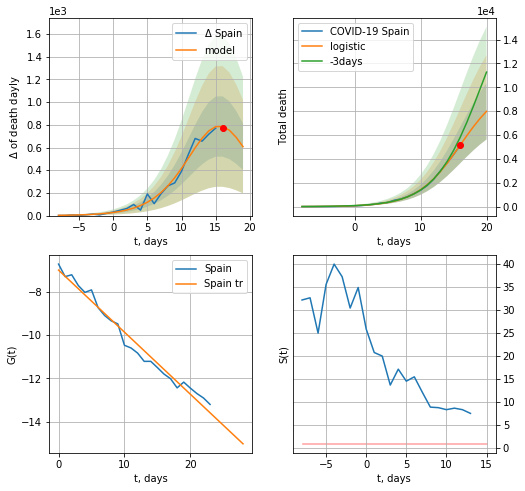

Spain data at: 2020-05-05
+3 day model MAPE: 0.15747030887395475
model: logistic
coeffs:  [1.03877331e+04 3.04619794e-01 1.60547713e+01]
rational stdev:  0.29538659014568974
forecast at the end of period: +4 days
	 total death:  7986 ± 2359
trend coefficient of determination: 0.976452
 intercept: -6.992078
 slope: -0.287044


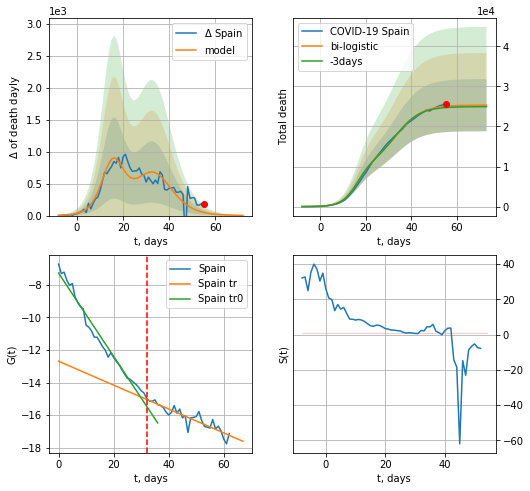

Spain data at: 2020-05-05
+3 day model MAPE: 0.013233260824795787
model: bi-logistic
coeffs:  [1.49403250e+04 1.78587277e-01 3.34119168e+01] [1.03877331e+04 3.04619794e-01 1.60547713e+01]
rational stdev:  0.25713263692799654
forecast at the end of period: +18 days
	 deltaDaydeath:  2
	 total death:  25315 ± 6509
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.975844
 intercept: -7.265510
 slope: -0.256124
trend coefficient of determination: 0.825723
 intercept: -12.688425
 slope: -0.073557


In [85]:
vL = 32#len(dfSP[:])-7-dT
dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,6*7-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*8-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


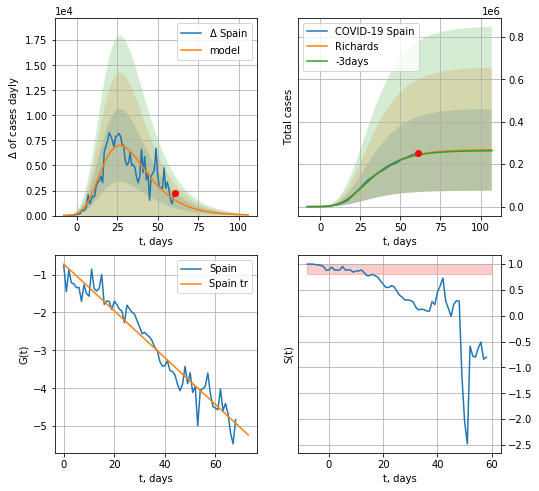

Spain data at: 2020-05-05
+3 day model MAPE: 0.010851
model: Richards
coeffs: [ 2.68792467e+05  7.54895902e+00 -3.83957944e+01  9.42668488e-03]
rational stdev: 0.720618
forecast at the end of period: +46 days
	 deltaDaycases: 67
	 total cases: 267878 ± 193038
	 total death: 27383 ± 59198
trend coefficient of determination: 0.941460
 intercept: -0.724528
 slope: -0.061765


In [86]:
x = forecastRR('Spain',dfSP[1:],d1,7*12-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:72: RuntimeWarning: divide by zero encountered in true_divide


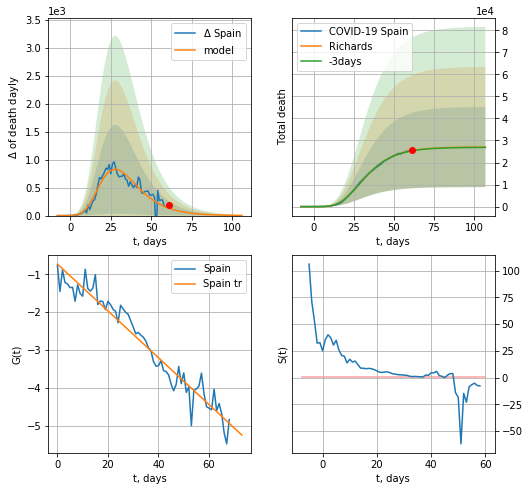

Spain data at: 2020-05-05
+3 day model MAPE: 0.004341
model: Richards
coeffs: [ 2.70619407e+04  8.12124167e+00 -2.66298070e+01  1.02879438e-02]
rational stdev: 0.672269
forecast at the end of period: +46 days
	 total death: 27024 ± 18167
trend coefficient of determination: 0.941775
 intercept: -0.729839
 slope: -0.061867


In [87]:
x = forecastRR('Spain',dfSP[1:],d1,7*12-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


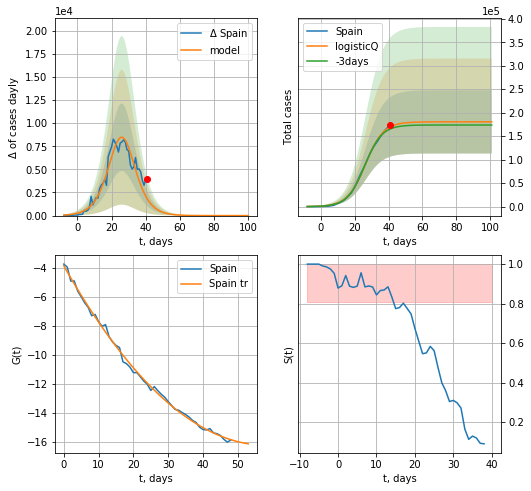

Spain data at: 2020-05-05
+3 day model MAPE: 0.028157
model: logisticQ
coeffs: [ 1.80489569e+05  4.90633148e-06  2.63952659e+01 -3.83458431e+04]
rational stdev: 0.373397
forecast at the end of period: +60 days
	 deltaDaycases: 0
	 total cases: 180489 ± 67394
	 total death: 18450 ± 20667
trend coefficient of determination: 0.997432
 intercept_: -3.859009253100683
 coeffs_: [ 0.         -0.42385579  0.00363487]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


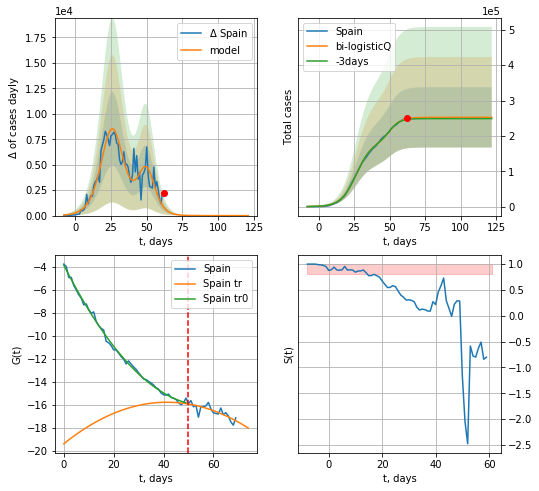

Spain data at: 2020-05-05
+3 day model MAPE: 0.011027
model: bi-logisticQ
coeffs: [ 7.18880937e+04  3.57546986e-06  5.01265590e+01 -6.91365043e+04]
rational stdev: 0.337804
forecast at the end of period: +60 days
	 deltaDaycases: 0
	 total cases: 252377 ± 85254
	 total death: 25798 ± 26143
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.997202
 intercept_: -3.834231460165485
 coeffs_: [ 0.         -0.42809872  0.00374483]
trend coefficient of determination: 0.640409
 intercept_: -19.399393654921216
 coeffs_: [ 0.          0.17492744 -0.0021126 ]


In [88]:
x = forecastRRR('Spain',dfSP[:50],d1,7*14-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[:],d1,7*14-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: divide by zero encountered in true_divide


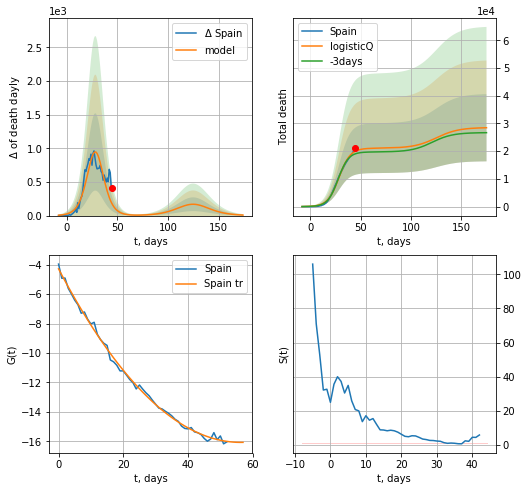

Spain data at: 2020-05-05
+3 day model MAPE: 0.052146
model: logisticQ
coeffs: [ 2.10785072e+04  2.45976331e-06  2.87220026e+01 -7.30294753e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.426167
forecast at the end of period: +130 days
	 total death: 28462 ± 12129
trend coefficient of determination: 0.997093
 intercept_: -4.2745317106494545
 coeffs_: [ 0.         -0.41935329  0.00372528]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:344: RuntimeWarning: divide by zero encountered in true_divide


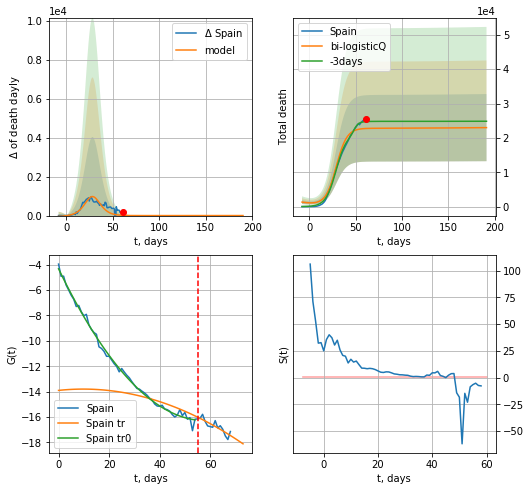

Spain data at: 2020-05-05
+3 day model MAPE: 0.080886
model: bi-logisticQ
coeffs: [ 1.52177874e+03  2.85390782e-03  2.94237190e+01 -1.00307143e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.425103
forecast at the end of period: +130 days
	 total death: 22992 ± 9774
bi-logisticQ approximation splitting point: 55
trend coefficient of determination: 0.995977
 intercept_: -4.321307017900119
 coeffs_: [ 0.         -0.41196694  0.00354831]
trend coefficient of determination: 0.730517
 intercept_: -13.901169802589276
 coeffs_: [ 0.          0.02103334 -0.00107779]


In [89]:
x = forecastRRR('Spain',dfSP[1:55],d1,7*24-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*24-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=55)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


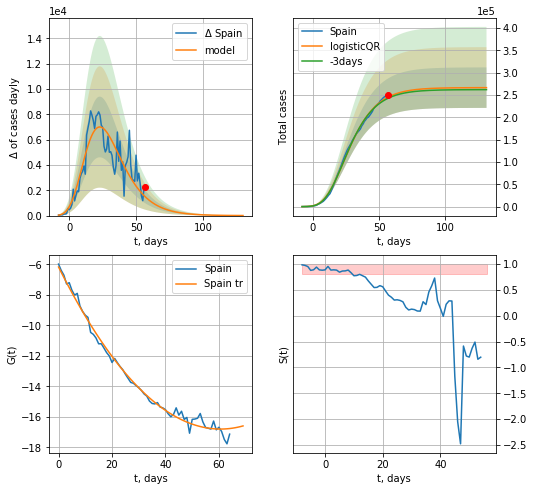

Spain data at: 2020-05-05
+3 day model MAPE: 0.010962566217761906
model: logisticQR
coeffs:  [ 2.66342695e+05  3.95097236e-02 -1.09029580e+03 -7.60604839e+01
  1.49335863e-03]
rational stdev:  0.1702010855485301
forecast at the end of period: +74 days
	 deltaDaycases:  5
	 total cases:  266283 ± 45321
	 total death:  27220 ± 13898
trend coefficient of determination: 0.990791
 intercept_: -6.181121732418895
 coeffs_: [ 0.         -0.35080697  0.00289588]


In [90]:
x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

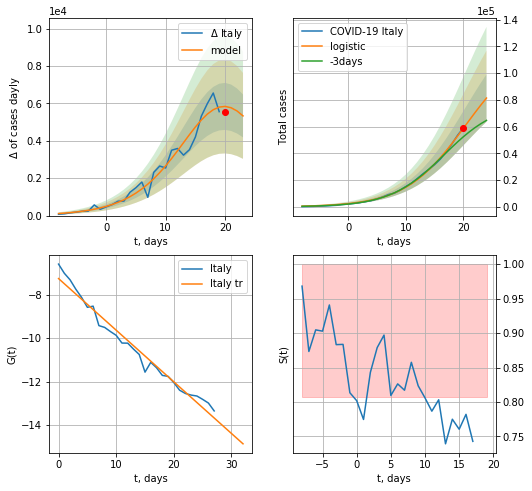

Italy data at: 2020-05-05
+3 day model MAPE: 0.1545703725042627
model: logistic
coeffs:  [1.21492367e+05 1.92504372e-01 2.03342758e+01]
rational stdev:  0.21800555140478417
forecast at the end of period: +4 days
	 deltaDaycases:  5332
	 total cases:  81332 ± 17730
	 total death:  11193 ± 7320
trend coefficient of determination: 0.973351
 intercept: -7.256152
 slope: -0.237823


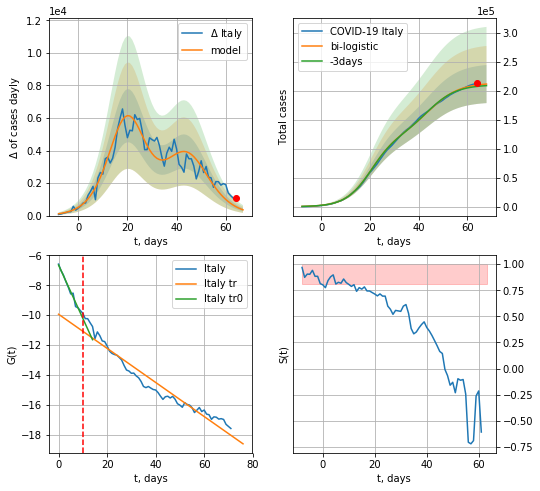

Italy data at: 2020-05-05
+3 day model MAPE: 0.011831862599301536
model: bi-logistic
coeffs:  [9.23573412e+04 1.60471778e-01 4.44966760e+01] [1.21492367e+05 1.92504372e-01 2.03342758e+01]
rational stdev:  0.1553164067409681
forecast at the end of period: +4 days
	 deltaDaycases:  354
	 total cases:  211759 ± 32889
	 total death:  29142 ± 13578
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.941759
 intercept: -9.934158
 slope: -0.113763


In [91]:
x = forecast('Italy',dfIT[:-6-dT],d1,6*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,6*7-dT,x,1.0)

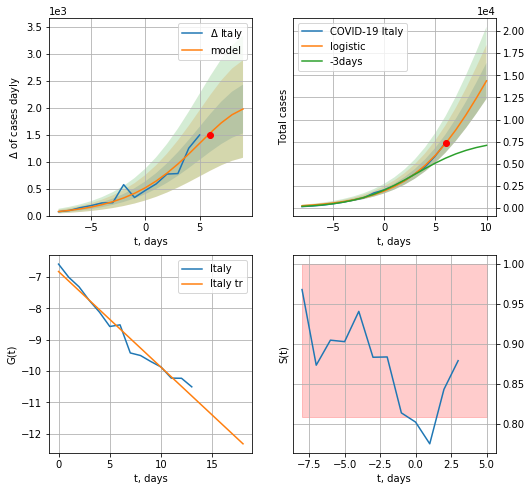

Italy data at: 2020-05-05
+3 day model MAPE: 0.4420796150765939
model: logistic
coeffs:  [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.1413171221665118
forecast at the end of period: +4 days
	 deltaDaycases:  1972
	 total cases:  14377 ± 2031
	 total death:  1978 ± 838
trend coefficient of determination: 0.972659
 intercept: -6.827339
 slope: -0.305199


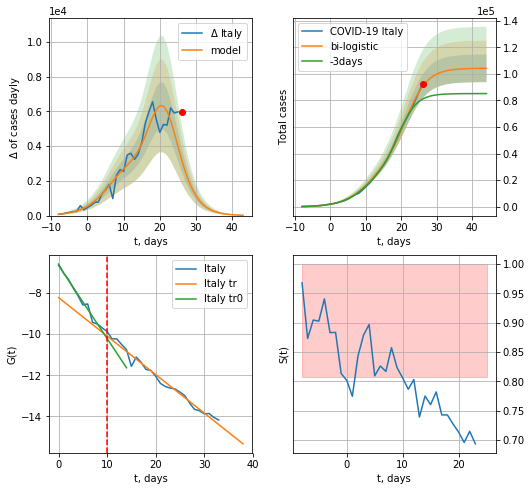

Italy data at: 2020-05-05
+3 day model MAPE: 0.1396868970300245
model: bi-logistic
coeffs:  [7.26693885e+04 3.23703466e-01 2.12981095e+01] [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.09972560756251159
forecast at the end of period: +18 days
	 deltaDaycases:  19
	 total cases:  104126 ± 10384
	 total death:  14330 ± 4287
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.981847
 intercept: -8.219306
 slope: -0.187258


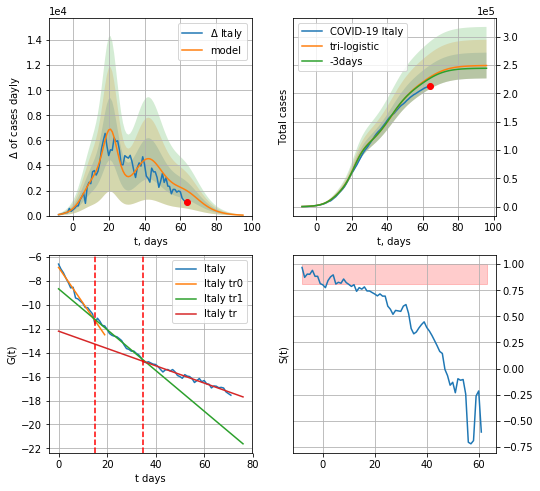

Italy data at: 2020-05-05
+3 day model MAPE: 0.009587880208704358
model: tri-logistic
coeffs:  [1.07533511e+05 1.60824775e-01 4.22193276e+01] [3.15102860e+04 2.56561304e-01 1.06831560e+01 7.26693885e+04
 3.23703466e-01 2.12981095e+01]
scenario coeffs:  [0.35, 1.0, 1.5]
forecast rational stdev:  0.09124495921959727
forecast at the end of period: +32 days
	 deltaDaycases:  37
	 total cases:  249135 ± 22732
	 total death:  34286 ± 9385
tri-logistic approximation splitting points: 15,35
trend0 coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544
trend1 coefficient of determination: 0.978019
 intercept: -8.656402
 slope: -0.170599
trend coefficient of determination: 0.969159
 intercept: -12.199134
 slope: -0.072361


In [92]:
vL = 15#len(dfSP[:])-11-dT
vL1=35
x = forecast('Italy',dfIT[:vL],d1,6*7-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*8-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.35,1.,1.5],vL=[vL,vL1])

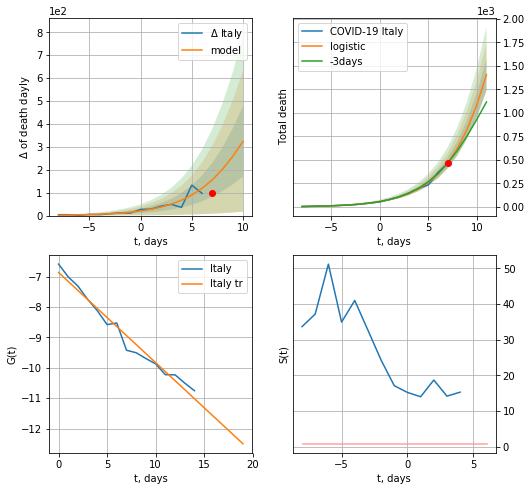

Italy data at: 2020-05-05
+3 day model MAPE: 0.04050471838994123
model: logistic
coeffs:  [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12009380059110428
forecast at the end of period: +4 days
	 total death:  1407 ± 169
trend coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544


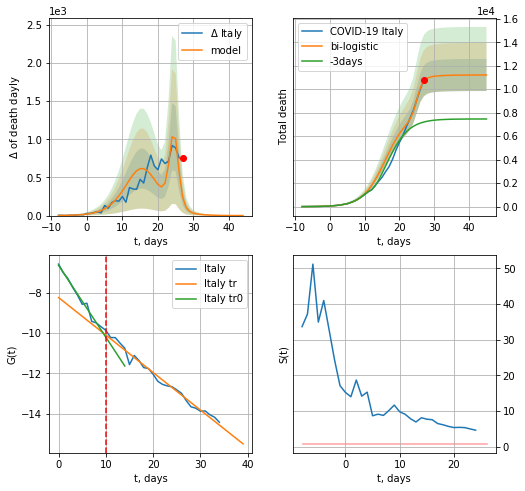

Italy data at: 2020-05-05
+3 day model MAPE: 0.5045455507817326
model: bi-logistic
coeffs:  [3.18991891e+03 1.24679374e+00 2.50159525e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12176249997037505
forecast at the end of period: +18 days
	 deltaDaydeath:  0
	 total death:  11210 ± 1365
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.983136
 intercept: -8.246485
 slope: -0.185719


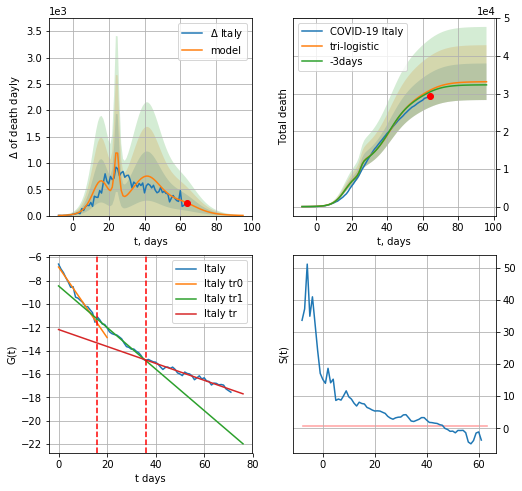

Italy data at: 2020-05-05
+3 day model MAPE: 0.015121628154418105
model: tri-logistic
coeffs:  [1.75469688e+04 1.65883414e-01 4.15510481e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01 3.18991891e+03
 1.24679374e+00 2.50159525e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.14641344303468282
forecast at the end of period: +32 days
	 deltaDaydeath:  3
	 total death:  33126 ± 4850
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976838
 intercept: -6.838821
 slope: -0.302120
trend1 coefficient of determination: 0.986419
 intercept: -8.458056
 slope: -0.177939
trend coefficient of determination: 0.966722
 intercept: -12.192897
 slope: -0.072467


In [93]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,6*7-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*8-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


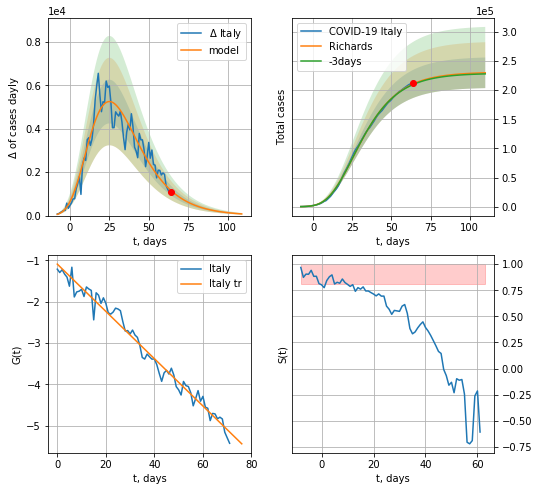

Italy data at: 2020-05-05
+3 day model MAPE: 0.004945
model: Richards
coeffs: [ 2.31119638e+05  5.71806665e+00 -4.71817751e+01  1.08750443e-02]
rational stdev: 0.114290
forecast at the end of period: +46 days
	 deltaDaycases: 77
	 total cases: 229913 ± 26276
	 total death: 31640 ± 10848
trend coefficient of determination: 0.977410
 intercept: -1.093989
 slope: -0.057127


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


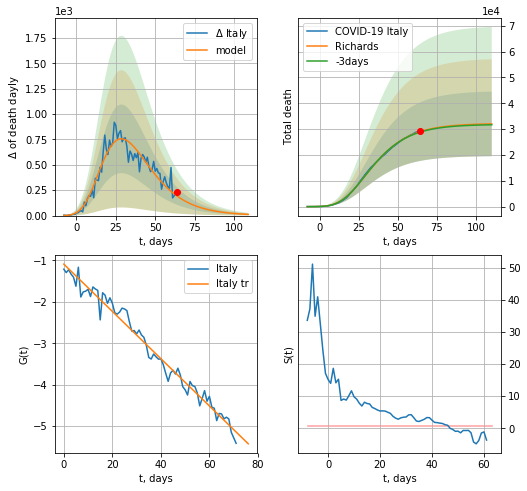

Italy data at: 2020-05-05
+3 day model MAPE: 0.006221
model: Richards
coeffs: [ 3.22035135e+04  6.24125505e+00 -4.23504814e+01  1.02811291e-02]
rational stdev: 0.390735
forecast at the end of period: +46 days
	 total death: 32026 ± 12513
trend coefficient of determination: 0.977342
 intercept: -1.089344
 slope: -0.057080


In [94]:
x = forecastRR('Italy',dfIT[:],d1,12*7-dT,1.0)
x = forecastRR('Italy',dfIT[:],d1,12*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


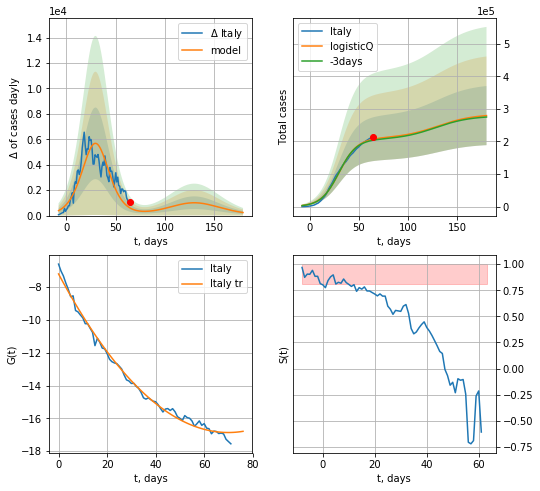

Italy data at: 2020-05-05
+3 day model MAPE: 0.015329
model: logisticQ
coeffs: [ 2.09786122e+05  7.34234368e-07  2.98431256e+01 -1.47141993e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.324623
forecast at the end of period: +116 days
	 deltaDaycases: 241
	 total cases: 279467 ± 90721
	 total death: 38460 ± 37455
trend coefficient of determination: 0.992805
 intercept_: -7.191608797660742
 coeffs_: [ 0.         -0.2767549   0.00197873]


In [95]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


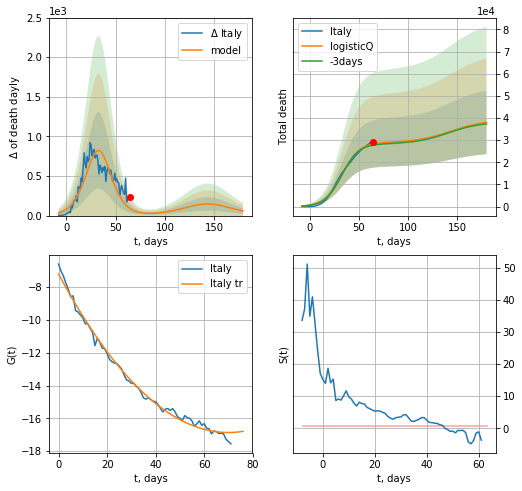

Italy data at: 2020-05-05
+3 day model MAPE: 0.018404
model: logisticQ
coeffs: [ 2.89175371e+04  8.59300524e-07  3.29085430e+01 -1.32184567e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.377746
forecast at the end of period: +116 days
	 total death: 38031 ± 14366
trend coefficient of determination: 0.992805
 intercept_: -7.191608797660742
 coeffs_: [ 0.         -0.2767549   0.00197873]


In [96]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [97]:
dT

38

FR
          date     cases  active    death
76 2020-05-01  167346.0   92540  24594.0
77 2020-05-02  168396.0   93074  24760.0
78 2020-05-03  168693.0   93014  24895.0
79 2020-05-04  169462.0   92890  25201.0
80 2020-05-05  170551.0   92284  25531.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


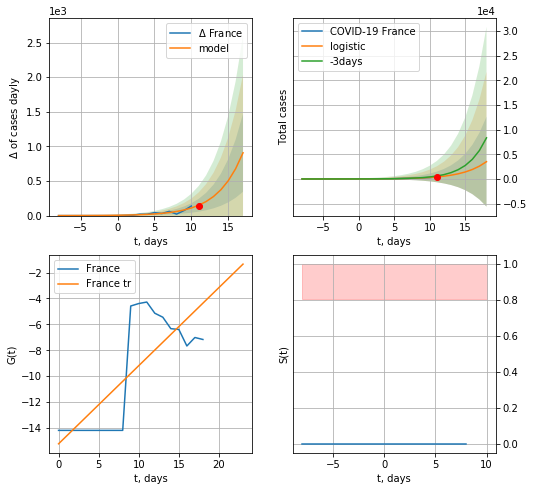

France data at: 2020-05-05
+3 day model MAPE: 0.3579011645535763
model: logistic
coeffs:  [9.13757357e+04 3.09894510e-01 2.83979795e+01]
rational stdev:  2.5989080654975822
forecast at the end of period: +7 days
	 deltaDaycases:  906
	 total cases:  3502 ± 9103
	 total death:  524 ± 4085
trend coefficient of determination: 0.603781
 intercept: -15.217380
 slope: 0.602806


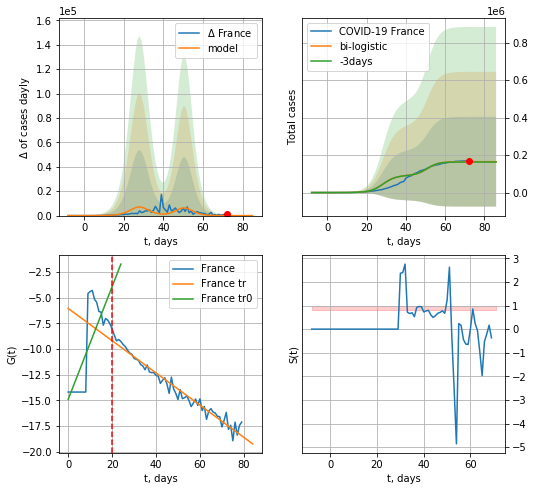

France data at: 2020-05-05
+3 day model MAPE: 0.01110689598524172
model: bi-logistic
coeffs:  [7.33565340e+04 3.44438069e-01 5.09686051e+01] [9.13757357e+04 3.09894510e-01 2.83979795e+01]
rational stdev:  1.4558844461481402
forecast at the end of period: +14 days
	 deltaDaycases:  0
	 total cases:  164731 ± 239830
	 total death:  24659 ± 107701
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.576236
 intercept: -14.895009
 slope: 0.549077
trend coefficient of determination: 0.962660
 intercept: -6.036406
 slope: -0.156984


In [100]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
x = forecast('France',dfFR[:vL],d1,7*7-dT-4,1.0)
xx = forecast2('France',dfFR,d1,8*7-dT-4,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)

In [101]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

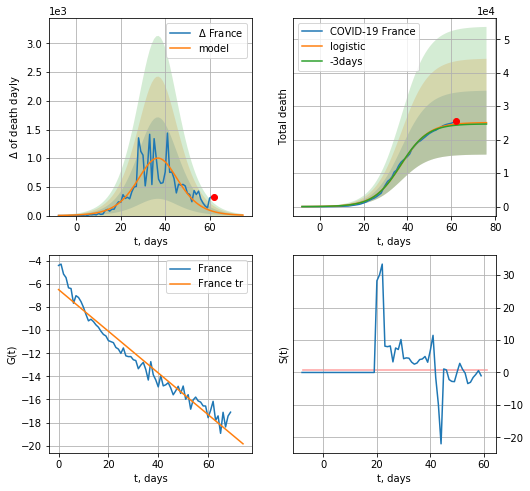

France data at: 2020-05-05
+3 day model MAPE: 0.014469504498756131
model: logistic
coeffs:  [2.51236557e+04 1.59769115e-01 3.71680412e+01]
rational stdev:  0.38036365313790665
forecast at the end of period: +14 days
	 total death:  25072 ± 9536
trend coefficient of determination: 0.950925
 intercept: -6.484078
 slope: -0.180500


In [102]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*8-dT-4,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


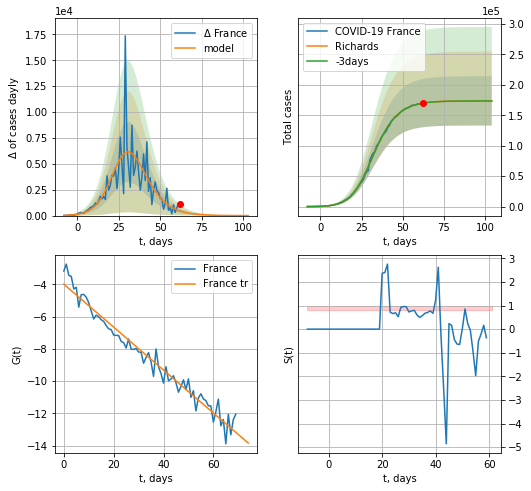

France data at: 2020-05-05
+3 day model MAPE: 0.000758
model: Richards
coeffs: [1.73719545e+05 2.12507586e-01 2.68123243e+01 5.80683590e-01]
rational stdev: 0.233008
forecast at the end of period: +42 days
	 deltaDaycases: 2
	 total cases: 173697 ± 40472
	 total death: 26002 ± 18176
trend coefficient of determination: 0.963379
 intercept: -3.996745
 slope: -0.133041


In [103]:
x = forecastRR('France',dfFR[10:],d1,12*7-dT-4,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


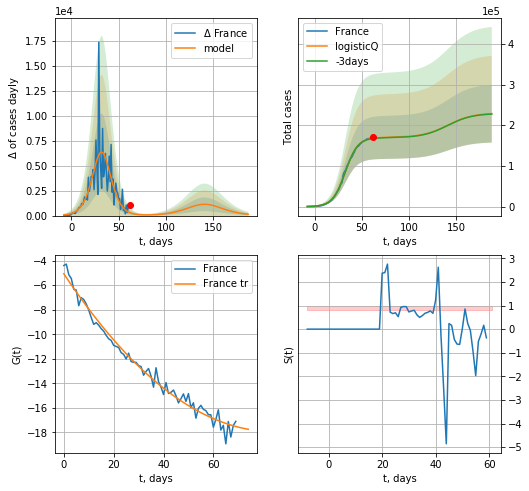

France data at: 2020-05-05
+3 day model MAPE: 0.004556
model: logisticQ
coeffs: [ 1.69970017e+05  2.52488103e-06  3.24072117e+01 -5.92318776e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.310951
forecast at the end of period: +126 days
	 deltaDaycases: 131
	 total cases: 228434 ± 71031
	 total death: 34196 ± 31899
trend coefficient of determination: 0.982452
 intercept_: -5.0636351891747164
 coeffs_: [ 0.         -0.30585527  0.0018169 ]


In [104]:
x = forecastRRR('France',dfFR[10:],d1,24*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


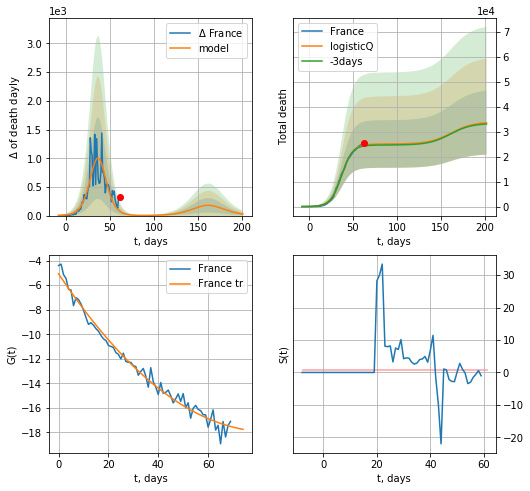

France data at: 2020-05-05
+3 day model MAPE: 0.014500
model: logisticQ
coeffs: [ 2.51220096e+04  2.22722537e-06  3.71676423e+01 -7.16877428e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.380553
forecast at the end of period: +140 days
	 total death: 33675 ± 12815
trend coefficient of determination: 0.982452
 intercept_: -5.0636351891747164
 coeffs_: [ 0.         -0.30585527  0.0018169 ]


In [105]:
x = forecastRRR('France',dfFR[10:],d1,26*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [106]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [107]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


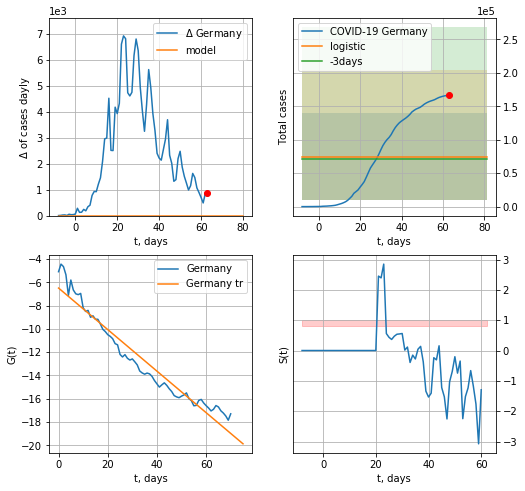

Germany data at: 2020-05-05
+3 day model MAPE: 0.05659750740457705
model: logistic
coeffs:  [ 7.44952081e+04 -3.42348509e+00  1.11082132e+02]
rational stdev:  0.8684805347559807
forecast at the end of period: +18 days
	 deltaDaycases:  0
	 total cases:  74495 ± 64697
	 total death:  3119 ± 8126
trend coefficient of determination: 0.941349
 intercept: -6.493625
 slope: -0.178472


In [108]:
x = forecast('Germany',dfGR[:],d1,7*8-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


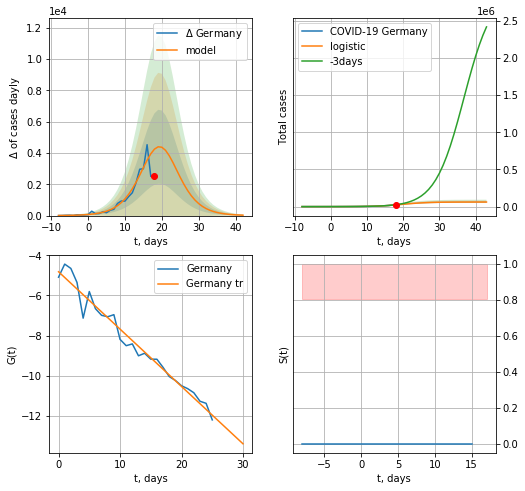

Germany data at: 2020-05-05
+3 day model MAPE: 0.18319320379671997
model: logistic
coeffs:  [6.16394025e+04 2.86275294e-01 1.98444846e+01]
rational stdev:  0.17054836328949527
forecast at the end of period: +25 days
	 deltaDaycases:  26
	 total cases:  61558 ± 10498
	 total death:  2577 ± 1318
trend coefficient of determination: 0.966826
 intercept: -4.817840
 slope: -0.285777


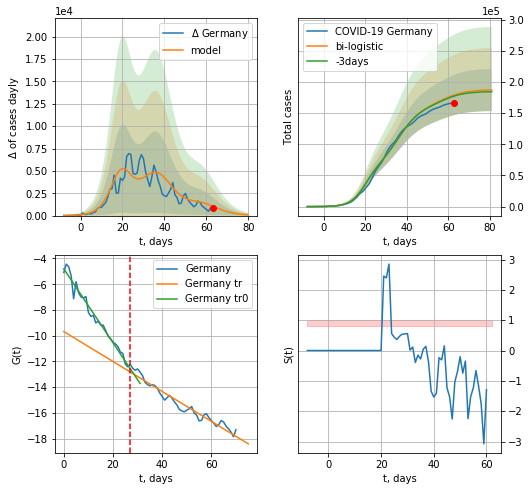

Germany data at: 2020-05-05
+3 day model MAPE: 0.010078905091660725
model: bi-logistic
coeffs:  [1.00699845e+05 1.83497107e-01 3.64777830e+01] [6.16394025e+04 2.86275294e-01 1.98444846e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.18039184207755055
forecast at the end of period: +18 days
	 deltaDaycases:  82
	 total cases:  187096 ± 33750
	 total death:  7834 ± 4239
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970373
 intercept: -4.806769
 slope: -0.287106
trend coefficient of determination: 0.950384
 intercept: -9.677864
 slope: -0.116292


In [109]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,9*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*8-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

GR
          date   cases  active   death
67 2020-05-01  164077   30441  6736.0
68 2020-05-02  164967   27555  6812.0
69 2020-05-03  165664   28198  6866.0
70 2020-05-04  166152   24059  6993.0
71 2020-05-05  167007   24914  6993.5


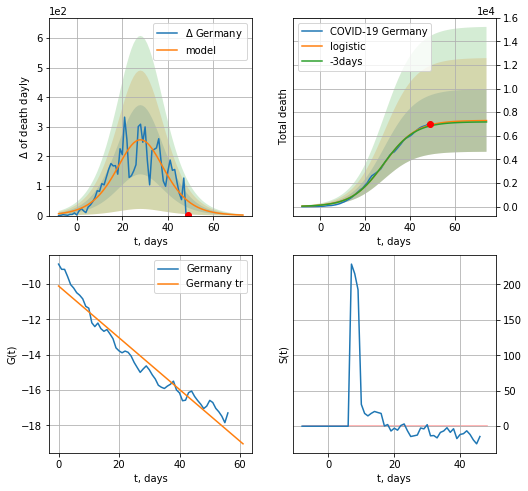

Germany data at: 2020-05-05
+3 day model MAPE: 0.012115269843371796
model: logistic
coeffs:  [7.30007384e+03 1.40632068e-01 2.84553927e+01]
rational stdev:  0.36280706213031527
forecast at the end of period: +25 days
	 total death:  7288 ± 2644
trend coefficient of determination: 0.943742
 intercept: -10.116463
 slope: -0.146420


In [114]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[14:],d1,9*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


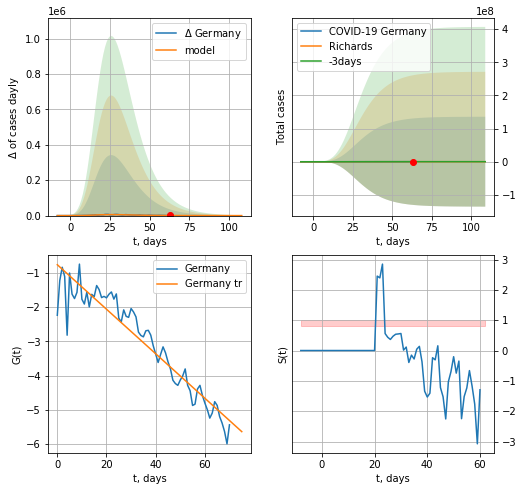

Germany data at: 2020-05-05
+3 day model MAPE: 0.003645
model: Richards
coeffs: [ 1.72551619e+05  6.40201312e+00 -2.24555051e+01  1.37155202e-02]
rational stdev: 786.033527
forecast at the end of period: +46 days
	 deltaDaycases: 11
	 total cases: 172429 ± 135535404
	 total death: 7220 ± 17025486
trend coefficient of determination: 0.900876
 intercept: -0.759307
 slope: -0.065066


In [115]:
x = forecastRR('Germany',dfGR[:],d1,12*7-dT,1.0,addpred=False,xcoef=[0.25,1.,5.0,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


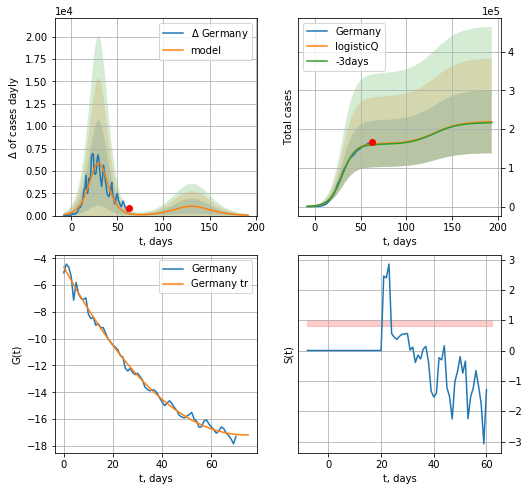

Germany data at: 2020-05-05
+3 day model MAPE: 0.011633
model: logisticQ
coeffs: [ 1.62296238e+05  1.16949783e-06  3.01203706e+01 -1.23671732e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.372480
forecast at the end of period: +130 days
	 deltaDaycases: 47
	 total cases: 219139 ± 81625
	 total death: 9175 ± 10252
trend coefficient of determination: 0.993126
 intercept_: -4.6571872852012355
 coeffs_: [ 0.         -0.33818551  0.00228178]


In [116]:
x = forecastRRR('Germany',dfGR[:],d1,24*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: invalid value encountered in true_divide


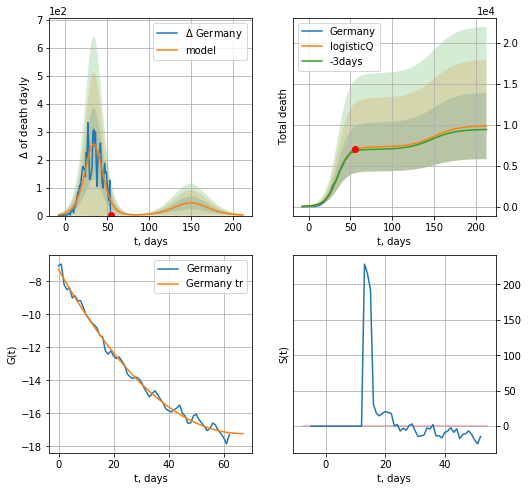

Germany data at: 2020-05-05
+3 day model MAPE: 0.025485
model: logisticQ
coeffs: [ 7.29332204e+03  1.13571000e-05  3.44425638e+01 -1.23597154e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.410377
forecast at the end of period: +158 days
	 total death: 9846 ± 4040
trend coefficient of determination: 0.992381
 intercept_: -7.281110858361204
 coeffs_: [ 0.         -0.29699136  0.00221551]


In [117]:
x = forecastRRR('Germany',dfGR[8:],d1,28*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

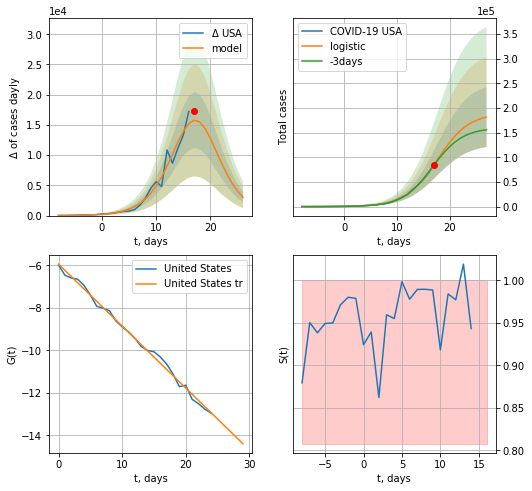

USA data at: 2020-05-05
+3 day model MAPE: 0.02944277425803263
model: logistic
coeffs:  [1.89999777e+05 3.33354123e-01 1.76550850e+01]
rational stdev:  0.3349926957690878
forecast at the end of period: +10 days
	 deltaDaycases:  3007
	 total cases:  181927 ± 60944
	 total death:  10623 ± 10675
trend coefficient of determination: 0.994747
 intercept: -5.944308
 slope: -0.291379


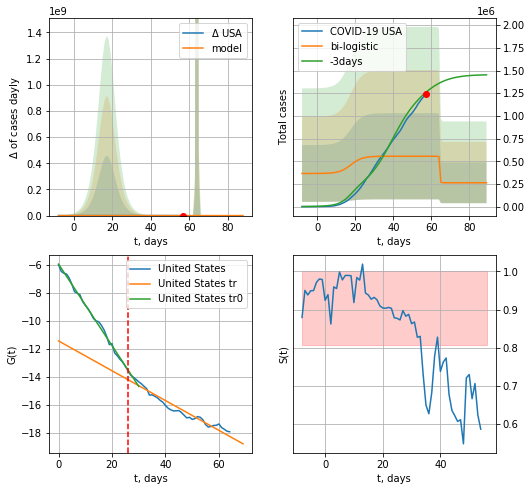

USA data at: 2020-05-05
+3 day model MAPE: 0.5644282858973699
model: bi-logistic
coeffs:  [ 2.92201542e+05 -7.56627185e+00  6.45327036e+01] [1.89999777e+05 3.33354123e-01 1.76550850e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.8558130773896202
forecast at the end of period: +32 days
	 deltaDaycases:  0
	 total cases:  263050 ± 225121
	 total death:  15360 ± 39435
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.995329
 intercept: -5.941731
 slope: -0.291701
trend coefficient of determination: 0.945089
 intercept: -11.439708
 slope: -0.106717


In [118]:
x = forecast('USA',dfUS[:26],d1,16*3-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,10*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=26)

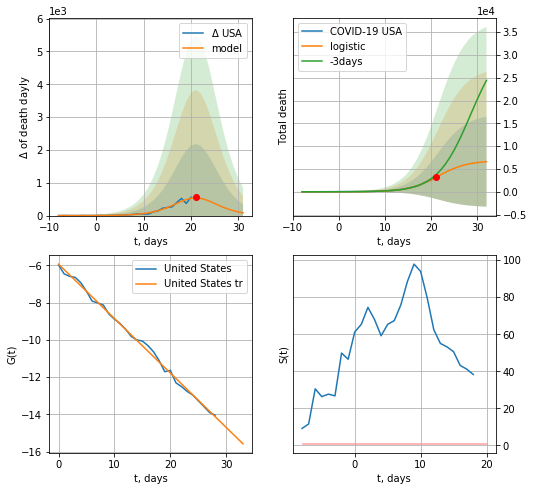

USA data at: 2020-05-05
+3 day model MAPE: 0.214213224760407
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +11 days
	 total death:  6596 ± 9847
trend coefficient of determination: 0.996563
 intercept: -5.939898
 slope: -0.291951


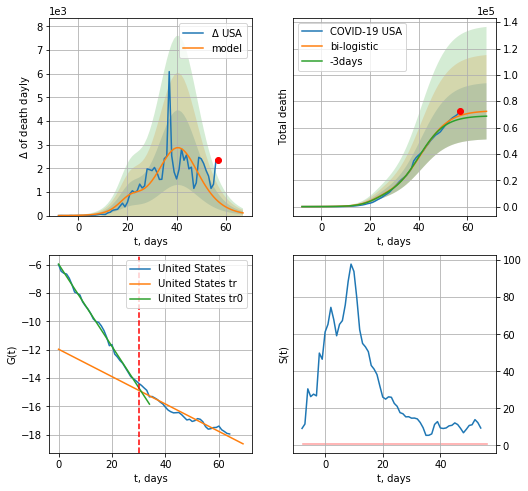

USA data at: 2020-05-05
+3 day model MAPE: 0.04167272413921099
model: bi-logistic
coeffs:  [6.60927346e+04 1.73780800e-01 4.10540137e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.2953871268538609
forecast at the end of period: +11 days
	 deltaDaydeath:  113
	 total death:  72320 ± 21362
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996662
 intercept: -5.952610
 slope: -0.290589
trend coefficient of determination: 0.944661
 intercept: -11.959770
 slope: -0.096747


In [119]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*7-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*7-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


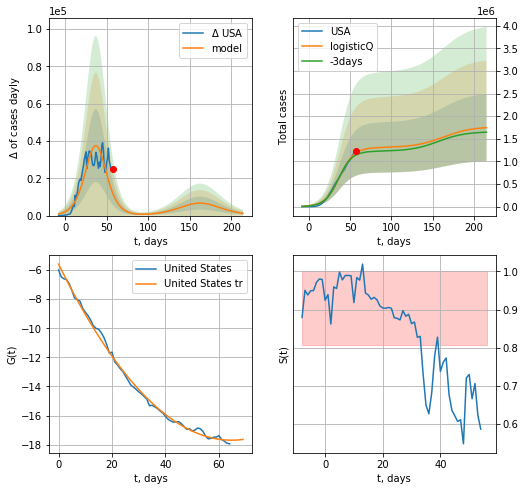

USA data at: 2020-05-05
+3 day model MAPE: 0.041904
model: logisticQ
coeffs: [ 1.30530718e+06  1.25382178e-06  3.73111812e+01 -9.16171064e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.425116
forecast at the end of period: +158 days
	 deltaDaycases: 1208
	 total cases: 1746248 ± 742357
	 total death: 101971 ± 130048
trend coefficient of determination: 0.996616
 intercept_: -5.587813617279846
 coeffs_: [ 0.         -0.3739585   0.00288815]


In [120]:
x = forecastRRR('USA',dfUS[:],d1,7*28-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


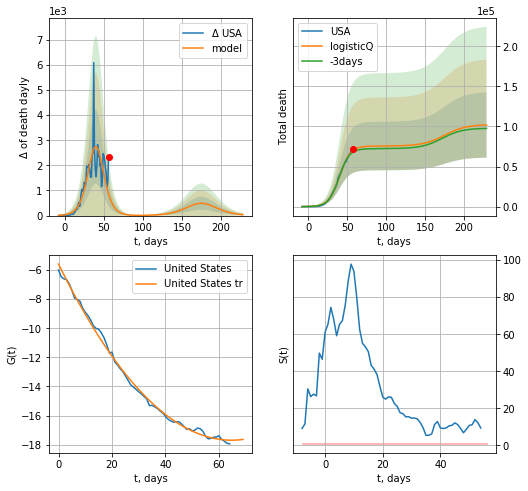

USA data at: 2020-05-05
+3 day model MAPE: 0.030545
model: logisticQ
coeffs: [ 7.55973968e+04  3.27095740e-06  4.01498312e+01 -4.44423438e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.400342
forecast at the end of period: +172 days
	 total death: 101866 ± 40781
trend coefficient of determination: 0.996616
 intercept_: -5.587813617279846
 coeffs_: [ 0.         -0.3739585   0.00288815]


In [121]:
x = forecastRRR('USA',dfUS[:],d1,7*30-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


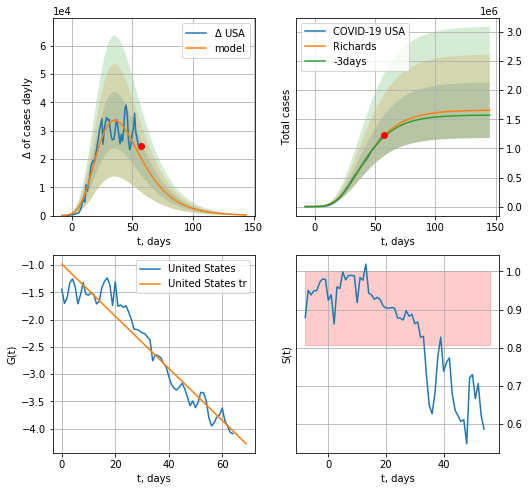

USA data at: 2020-05-05
+3 day model MAPE: 0.018688
model: Richards
coeffs: [ 1.65959252e+06  4.39887633e+00 -4.27681627e+01  1.26136485e-02]
rational stdev: 0.288254
forecast at the end of period: +88 days
	 deltaDaycases: 223
	 total cases: 1655666 ± 477252
	 total death: 96681 ± 83606
trend coefficient of determination: 0.927603
 intercept: -0.981380
 slope: -0.047749


In [122]:
x = forecastRR('USA',dfUS[:],d1,7*18-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


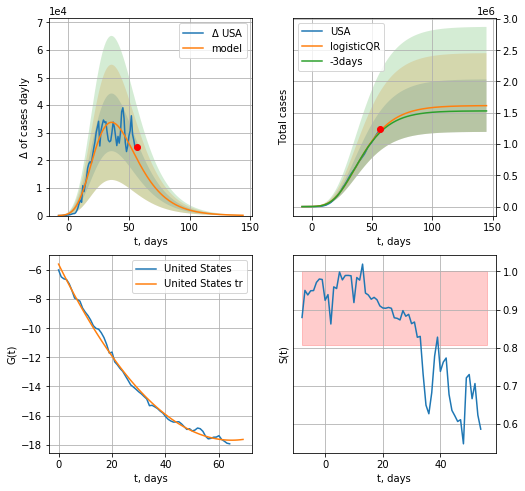

USA data at: 2020-05-05
+3 day model MAPE: 0.019726568454326198
model: logisticQR
coeffs:  [ 1.61532472e+06  1.94064466e-02 -8.03613606e+01 -8.28348848e+02
  2.99254458e-03]
rational stdev:  0.2600587943013587
forecast at the end of period: +88 days
	 deltaDaycases:  113
	 total cases:  1613741 ± 419667
	 total death:  94233 ± 73518
trend coefficient of determination: 0.996616
 intercept_: -5.587813617279846
 coeffs_: [ 0.         -0.3739585   0.00288815]


In [123]:
x = forecastQR('USA',dfUS[:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
          date   cases  active    death
65 2020-05-01  177454  149600  27510.0
66 2020-05-02  182260  153785  28131.0
67 2020-05-03  186599  157809  28446.0
68 2020-05-04  190584  161506  28734.0
69 2020-05-05  194990  165219  29427.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


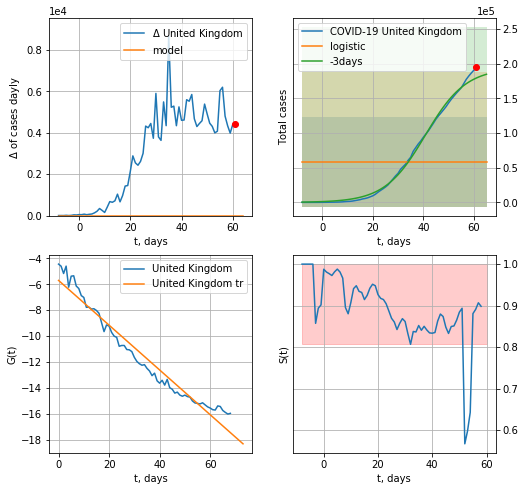

United Kingdom data at: 2020-05-05
+3 day model MAPE: 0.675536746333693
model: logistic
coeffs:  [ 5.87008284e+04 -4.11152696e+00  1.18521287e+02]
rational stdev:  1.1033717106420862
forecast at the end of period: +4 days
	 deltaDaycases:  0
	 total cases:  58700 ± 64768
	 total death:  8858 ± 29320
trend coefficient of determination: 0.955066
 intercept: -5.705128
 slope: -0.172857


In [124]:
dfGB = read_df(pd.DataFrame(),"GB")
x = forecast('United Kingdom',dfGB[:],d1,6*7-dT,1.)
#x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
#xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


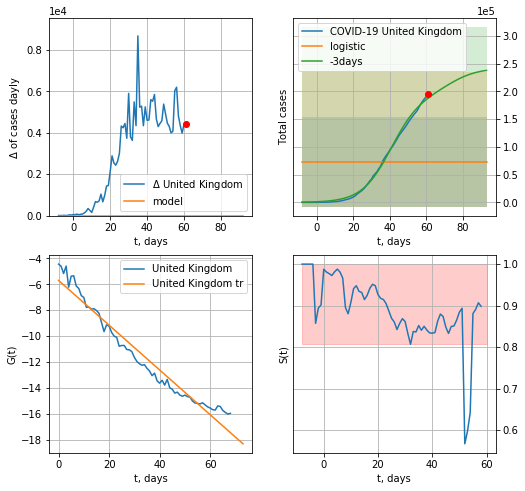

United Kingdom data at: 2020-05-05
+3 day model MAPE: 0.6144133770179064
model: logistic
coeffs:  [ 5.87008284e+04 -4.11152696e+00  1.18521287e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.1033717106420862
forecast at the end of period: +32 days
	 deltaDaycases:  0
	 total cases:  73376 ± 80961
	 total death:  11073 ± 36652
trend coefficient of determination: 0.955066
 intercept: -5.705128
 slope: -0.172857


In [125]:
x = forecast('United Kingdom',dfGB[:],d1,10*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:131: RuntimeWarning: divide by zero encountered in true_divide


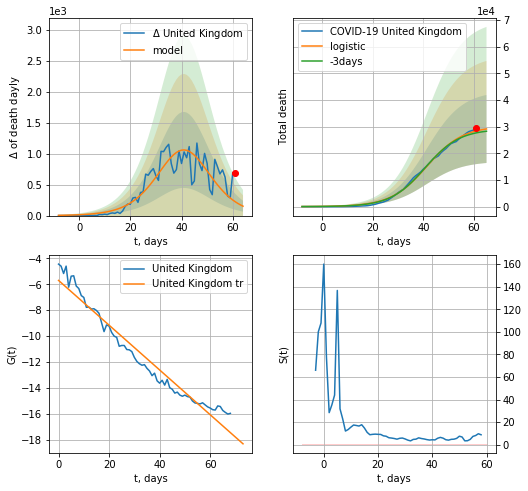

United Kingdom data at: 2020-05-05
+3 day model MAPE: 0.027177339541106214
model: logistic
coeffs:  [3.01741796e+04 1.40763677e-01 4.13643370e+01]
rational stdev:  0.4380352531870458
forecast at the end of period: +4 days
	 total death:  29128 ± 12759
trend coefficient of determination: 0.955066
 intercept: -5.705128
 slope: -0.172857


In [126]:
x = forecast('United Kingdom',dfGB[:],d1,6*7-dT,1.,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


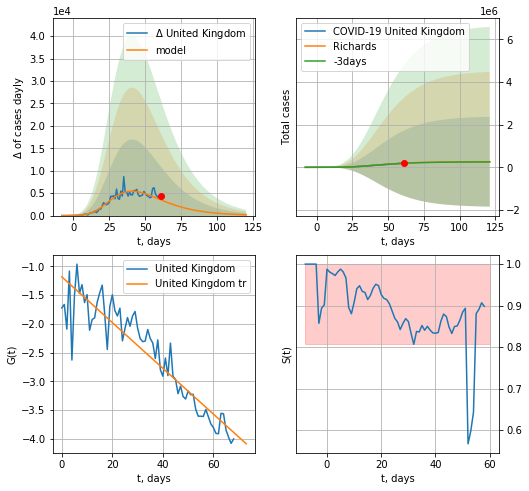

United Kingdom data at: 2020-05-05
+3 day model MAPE: 0.016400
model: Richards
coeffs: [ 2.66740490e+05  3.23242816e+00 -3.11899344e+01  1.73234182e-02]
rational stdev: 7.982538
forecast at the end of period: +60 days
	 deltaDaycases: 174
	 total cases: 263693 ± 2104947
	 total death: 39795 ± 952995
trend coefficient of determination: 0.857191
 intercept: -1.181521
 slope: -0.039782


In [127]:
x = forecastRR('United Kingdom',dfGB[:],d1,14*7-dT,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


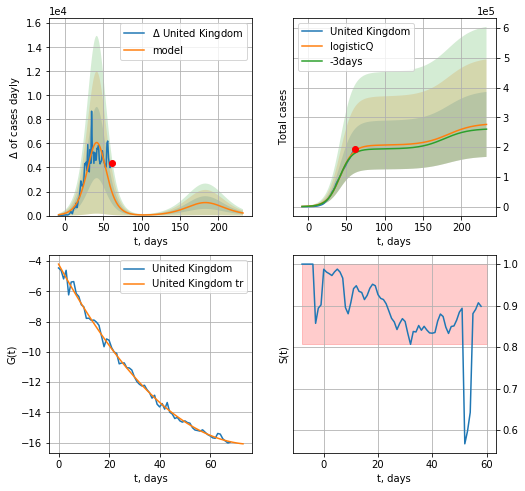

United Kingdom data at: 2020-05-05
+3 day model MAPE: 0.041794
model: logisticQ
coeffs: [ 2.06538838e+05  1.50338322e-06  4.20962098e+01 -7.82515472e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.395570
forecast at the end of period: +172 days
	 deltaDaycases: 213
	 total cases: 275985 ± 109171
	 total death: 41650 ± 49426
trend coefficient of determination: 0.995438
 intercept_: -4.191973134440168
 coeffs_: [ 0.         -0.30838628  0.00199325]


In [128]:
x = forecastRRR('United Kingdom',dfGB[:],d1,30*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: divide by zero encountered in true_divide


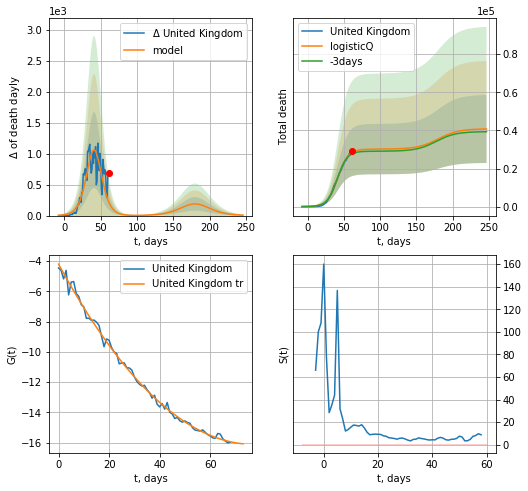

United Kingdom data at: 2020-05-05
+3 day model MAPE: 0.027223
model: logisticQ
coeffs: [ 3.01700665e+04  2.15174835e-06  4.13626145e+01 -6.53722688e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.438071
forecast at the end of period: +186 days
	 total death: 40761 ± 17856
trend coefficient of determination: 0.995438
 intercept_: -4.191973134440168
 coeffs_: [ 0.         -0.30838628  0.00199325]


In [129]:
x = forecastRRR('United Kingdom',dfGB[:],d1,32*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [134]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [169]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [170]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [171]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [172]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

In [130]:
dT

38

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


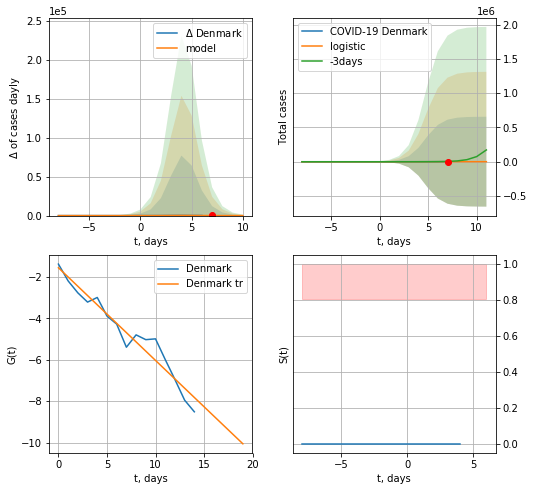

Denmark data at: 2020-05-05
+3 day model MAPE: 0.9299494930201694
model: logistic
coeffs:  [849.15572285   1.15642837   4.69716859]
rational stdev:  772.2918388633376
forecast at the end of period: +4 days
	 deltaDaycases:  1
	 total cases:  848 ± 655348
	 total death:  43 ± 99625
trend coefficient of determination: 0.941867
 intercept: -1.561623
 slope: -0.447087


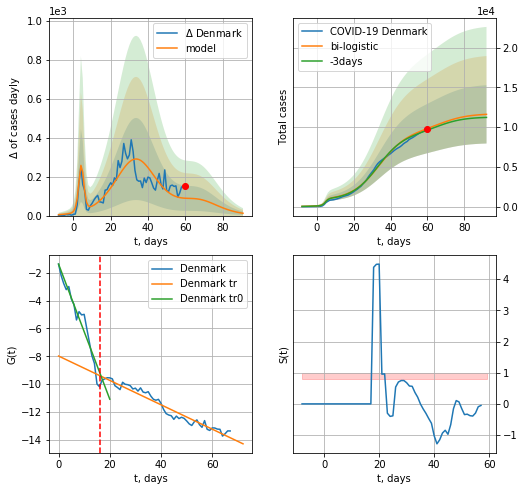

Denmark data at: 2020-05-05
+3 day model MAPE: 0.02163669387905668
model: bi-logistic
coeffs:  [8.68528570e+03 1.32768448e-01 3.39089904e+01] [849.15572285   1.15642837   4.69716859]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.315919424345326
forecast at the end of period: +32 days
	 deltaDaycases:  11
	 total cases:  11617 ± 3670
	 total death:  595 ± 563
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.932975
 intercept: -1.384195
 slope: -0.485107
trend coefficient of determination: 0.946385
 intercept: -7.984947
 slope: -0.087576


In [131]:
vL = 16
x = forecast('Denmark',dfDK[:vL],d1,6*7-dT,1.0)
xx = forecast2('Denmark',dfDK[:],d1,10*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


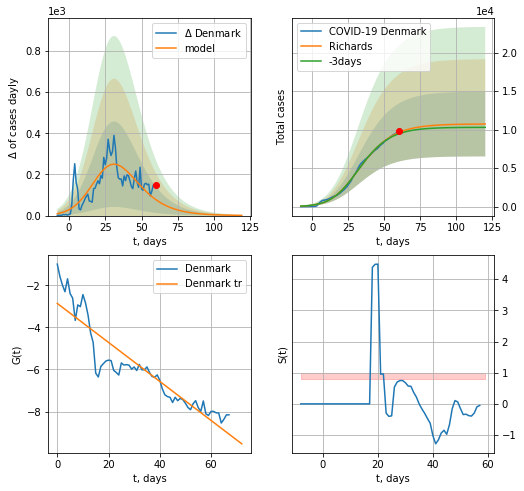

Denmark data at: 2020-05-05
+3 day model MAPE: 0.017690
model: Richards
coeffs: [1.07327096e+04 1.76813965e-01 2.06207923e+01 4.33146271e-01]
rational stdev: 0.391957
forecast at the end of period: +60 days
	 deltaDaycases: 0
	 total cases: 10720 ± 4201
	 total death: 549 ± 645
trend coefficient of determination: 0.851790
 intercept: -2.862477
 slope: -0.092682


In [132]:
x = forecastRR('Denmark',dfDK[:],d1,14*7-dT,1.0)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp


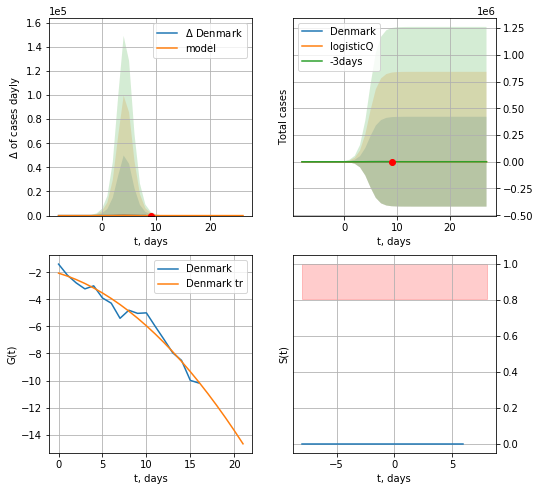

Denmark data at: 2020-05-05
+3 day model MAPE: 2.879608
model: logisticQ
coeffs: [ 8.62480490e+02  2.49401516e-04  4.73670538e+00 -4.50088701e+03]
rational stdev: 487.269302
forecast at the end of period: +18 days
	 deltaDaycases: 0
	 total cases: 862 ± 420260
	 total death: 44 ± 64319
trend coefficient of determination: 0.965266
 intercept_: -2.0557034713075613
 coeffs_: [ 0.         -0.1970759  -0.01925246]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


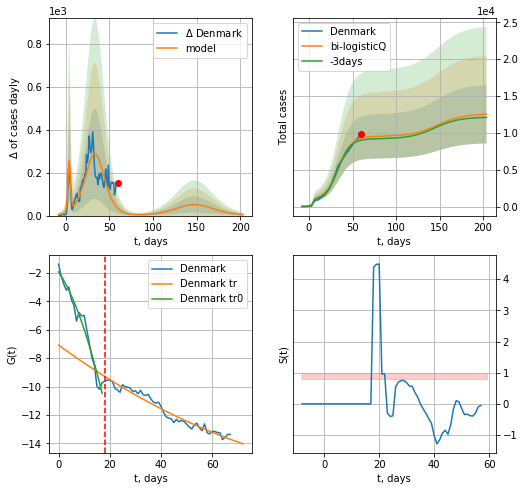

Denmark data at: 2020-05-05
+3 day model MAPE: 0.029505
model: bi-logisticQ
coeffs: [ 8.66638134e+03  9.41644487e-07  3.39267753e+01 -1.41411159e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.315313
forecast at the end of period: +144 days
	 deltaDaycases: 4
	 total cases: 12528 ± 3950
	 total death: 641 ± 606
bi-logisticQ approximation splitting point: 18
trend coefficient of determination: 0.963211
 intercept_: -1.9308894789691964
 coeffs_: [ 0.         -0.26605777 -0.01390014]
trend coefficient of determination: 0.956603
 intercept_: -7.076640062238321
 coeffs_: [ 0.         -0.13143107  0.00048479]


In [133]:
x = forecastRRR('Denmark',dfDK[:18],d1,8*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
          date  cases  active  death
65 2020-05-01   7783    7541  210.0
66 2020-05-02   7809    7566  211.0
67 2020-05-03   7847    7604  211.0
68 2020-05-04   7904    7658  214.0
69 2020-05-05   7955    7708  215.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


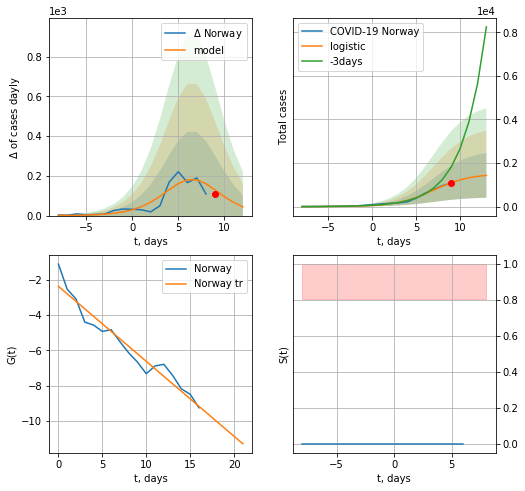

Norway data at: 2020-05-05
+3 day model MAPE: 0.5371818041233266
model: logistic
coeffs:  [1.50888671e+03 4.87443897e-01 6.97859719e+00]
rational stdev:  0.7165081035353225
forecast at the end of period: +4 days
	 deltaDaycases:  44
	 total cases:  1432 ± 1026
	 total death:  38 ± 81
trend coefficient of determination: 0.944117
 intercept: -2.361427
 slope: -0.426195


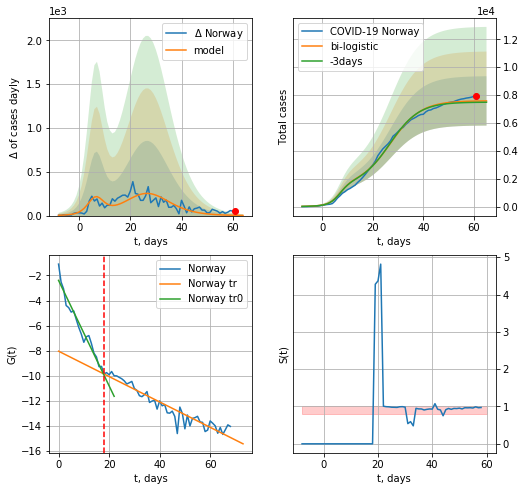

Norway data at: 2020-05-05
+3 day model MAPE: 0.012430827696862663
model: bi-logistic
coeffs:  [6.08309109e+03 1.66568740e-01 2.70318508e+01] [1.50888671e+03 4.87443897e-01 6.97859719e+00]
rational stdev:  0.23336230598322374
forecast at the end of period: +4 days
	 deltaDaycases:  1
	 total cases:  7581 ± 1769
	 total death:  204 ± 142
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.950087
 intercept: -2.394883
 slope: -0.419922
trend coefficient of determination: 0.908095
 intercept: -8.036887
 slope: -0.101114


In [134]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=18
x = forecast('Norway',dfNG[:vL],d1,6*7-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,6*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

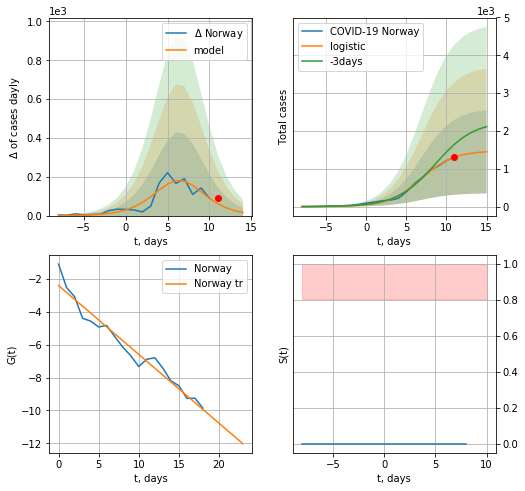

Norway data at: 2020-05-05
+3 day model MAPE: 0.247655347933597
model: logistic
coeffs:  [1.47478891e+03 4.95866797e-01 6.87524749e+00]
rational stdev:  0.7596156049961639
forecast at the end of period: +4 days
	 deltaDaycases:  16
	 total cases:  1449 ± 1100
	 total death:  39 ± 88
trend coefficient of determination: 0.956890
 intercept: -2.403448
 slope: -0.418410


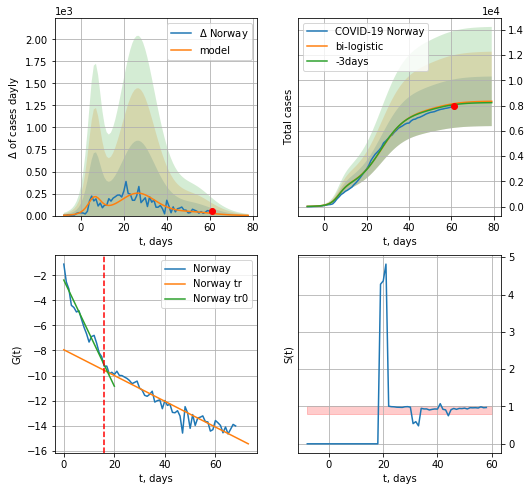

Norway data at: 2020-05-05
+3 day model MAPE: 0.010410298009713395
model: bi-logistic
coeffs:  [6.11828609e+03 1.65794310e-01 2.69533602e+01] [1.47478891e+03 4.95866797e-01 6.87524749e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.23550675886882125
forecast at the end of period: +18 days
	 deltaDaycases:  2
	 total cases:  8345 ± 1965
	 total death:  225 ± 158
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.933194
 intercept: -2.371994
 slope: -0.424081
trend coefficient of determination: 0.917721
 intercept: -7.942776
 slope: -0.102952


In [135]:
vL = 16#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,6*7-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,8*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


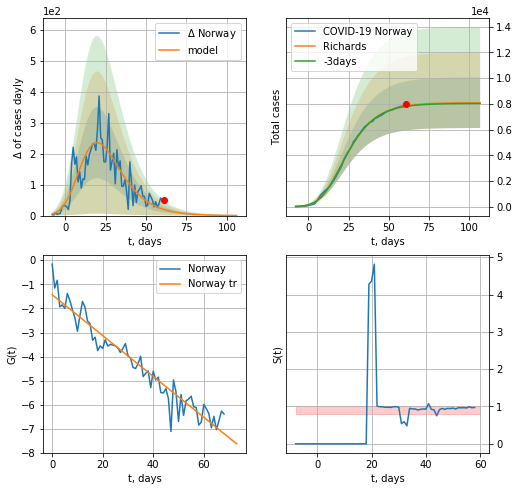

Norway data at: 2020-05-05
+3 day model MAPE: 0.005105
model: Richards
coeffs: [ 8.09272035e+03  5.77973980e-01 -2.26541761e+00  1.47328816e-01]
rational stdev: 0.243256
forecast at the end of period: +46 days
	 deltaDaycases: 0
	 total cases: 8087 ± 1967
	 total death: 218 ± 159
trend coefficient of determination: 0.929316
 intercept: -1.431420
 slope: -0.084645


In [136]:
x = forecastRR('Norway',dfNG[:],d1,12*7-dT,1.0)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


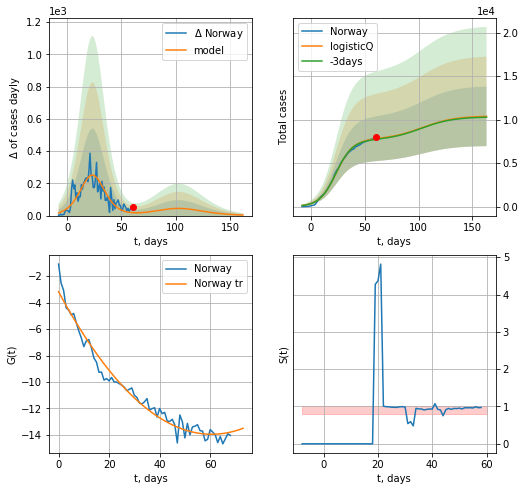

Norway data at: 2020-05-05
+3 day model MAPE: 0.009120
model: logisticQ
coeffs: [ 7.70836668e+03  1.12596331e-06  2.36468633e+01 -1.15351070e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.330154
forecast at the end of period: +102 days
	 deltaDaycases: 3
	 total cases: 10385 ± 3428
	 total death: 280 ± 277
trend coefficient of determination: 0.970341
 intercept_: -3.1834367106630372
 coeffs_: [ 0.         -0.35519213  0.00293052]


In [137]:
x = forecastRRR('Norway',dfNG[:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

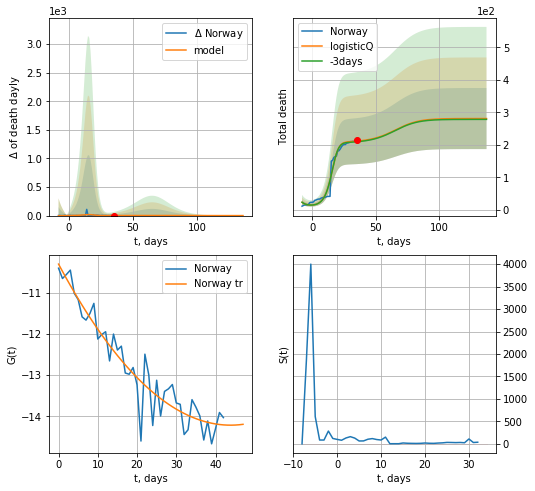

Norway data at: 2020-05-05
+3 day model MAPE: 0.009275
model: logisticQ
coeffs: [ 2.07592570e+02  1.03265471e-02  1.48184618e+01 -1.68986705e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.334798
forecast at the end of period: +102 days
	 total death: 281 ± 94
trend coefficient of determination: 0.900203
 intercept_: -10.300759778074564
 coeffs_: [ 0.         -0.17863712  0.00203822]


In [138]:
x = forecastRRR('Norway',dfNG[26:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

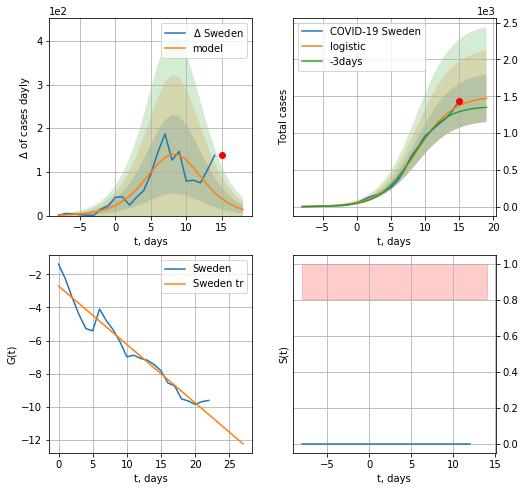

Sweden data at: 2020-05-05
+3 day model MAPE: 0.0730548600677782
model: logistic
coeffs:  [1.50473584e+03 3.76040161e-01 8.77120622e+00]
rational stdev:  0.21926973222081286
forecast at the end of period: +4 days
	 deltaDaycases:  13
	 total cases:  1473 ± 323
	 total death:  181 ± 119
trend coefficient of determination: 0.941971
 intercept: -2.710792
 slope: -0.352814


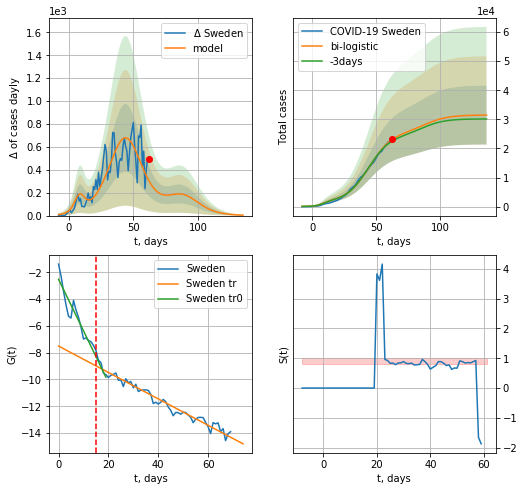

Sweden data at: 2020-05-05
+3 day model MAPE: 0.02391927933350244
model: bi-logistic
coeffs:  [2.39812989e+04 1.12567777e-01 4.42613766e+01] [1.50473584e+03 3.76040161e-01 8.77120622e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3212849699696008
forecast at the end of period: +74 days
	 deltaDaycases:  3
	 total cases:  31452 ± 10105
	 total death:  3866 ± 3726
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.870123
 intercept: -2.515075
 slope: -0.384868
trend coefficient of determination: 0.956787
 intercept: -7.505226
 slope: -0.098660


In [139]:
vL = 15#len(dfSW)-12-dT
x = forecast('Sweden',dfSW[:-9-dT],d1,6*7-dT,1.0)
xx = forecast2('Sweden',dfSW[:],d1,7*16-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

SW
          date  cases  active   death
66 2020-05-01  21520   17862  2653.0
67 2020-05-02  22082   18408  2669.0
68 2020-05-03  22317   18633  2679.0
69 2020-05-04  22721   15878  2769.0
70 2020-05-05  23216   16288  2854.0


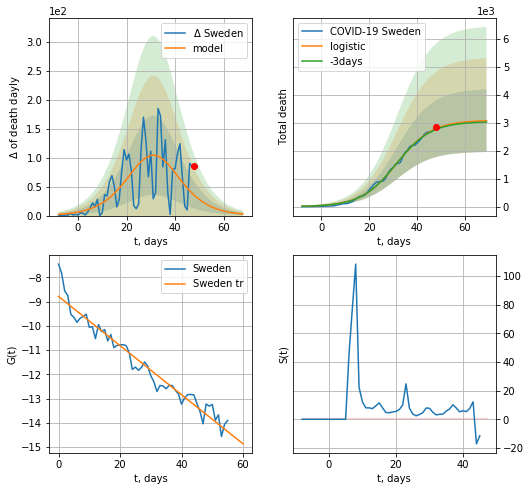

Sweden data at: 2020-05-05
+3 day model MAPE: 0.010360244709897905
model: logistic
coeffs:  [3.09189805e+03 1.35060822e-01 3.15454564e+01]
rational stdev:  0.3641950894110869
forecast at the end of period: +21 days
	 total death:  3072 ± 1118
trend coefficient of determination: 0.949422
 intercept: -8.786739
 slope: -0.101356


In [140]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


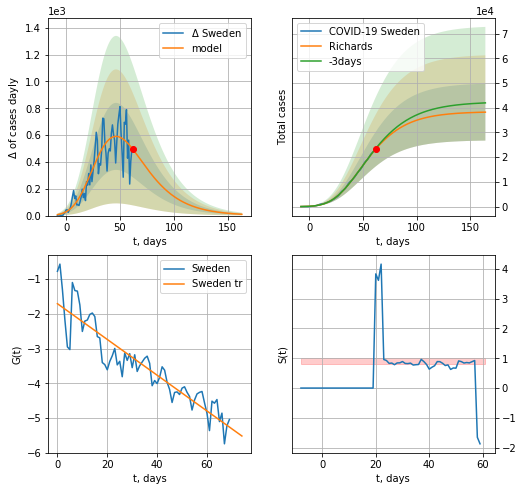

Sweden data at: 2020-05-05
+3 day model MAPE: 0.012116
model: Richards
coeffs: [ 3.84458466e+04  3.71478499e-01 -1.31810730e+00  1.18992124e-01]
rational stdev: 0.300852
forecast at the end of period: +102 days
	 deltaDaycases: 9
	 total cases: 38229 ± 11501
	 total death: 4699 ± 4241
trend coefficient of determination: 0.841601
 intercept: -1.708087
 slope: -0.051510


In [141]:
x = forecastRR('Sweden',dfSW[:],d1,20*7-dT,1.0)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


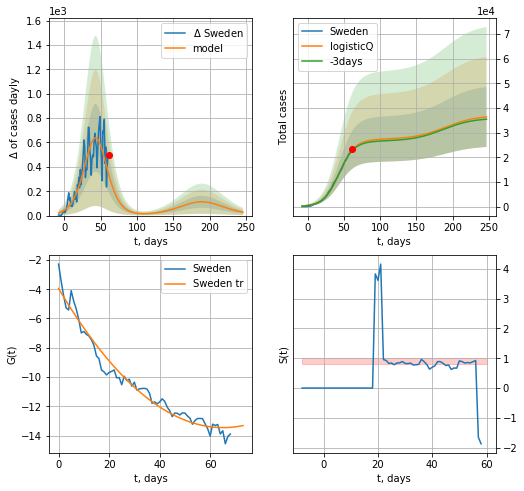

Sweden data at: 2020-05-05
+3 day model MAPE: 0.014018
model: logisticQ
coeffs: [ 2.73340286e+04  1.80047306e-06  4.35065250e+01 -5.17631251e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.334810
forecast at the end of period: +186 days
	 deltaDaycases: 27
	 total cases: 36400 ± 12187
	 total death: 4474 ± 4493
trend coefficient of determination: 0.966027
 intercept_: -3.9490072724247067
 coeffs_: [ 0.         -0.29207891  0.00224256]


In [142]:
x = forecastRRR('Sweden',dfSW[1:],d1,32*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: invalid value encountered in true_divide


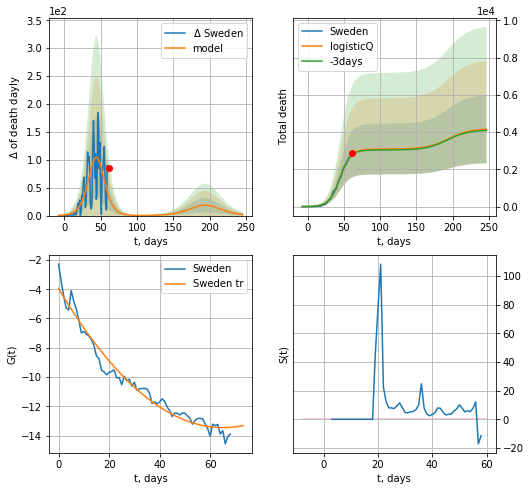

Sweden data at: 2020-05-05
+3 day model MAPE: 0.010567
model: logisticQ
coeffs: [ 3.08938226e+03  4.34840274e-06  4.45318373e+01 -3.10501049e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.440538
forecast at the end of period: +186 days
	 total death: 4154 ± 1830
trend coefficient of determination: 0.966027
 intercept_: -3.9490072724247067
 coeffs_: [ 0.         -0.29207891  0.00224256]


In [143]:
x = forecastRRR('Sweden',dfSW[1:],d1,32*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

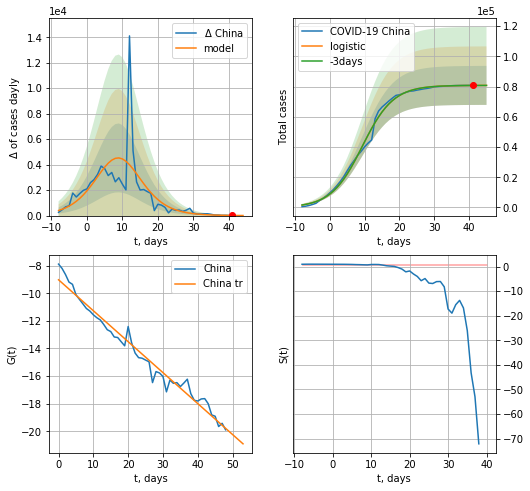

China data at: 2020-05-05
+3 day model MAPE: 0.00012785692335583266
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.15971316009002232
forecast at the end of period: +4 days
	 deltaDaycases:  6
	 total cases:  80783 ± 12902
	 total death:  4515 ± 2163
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


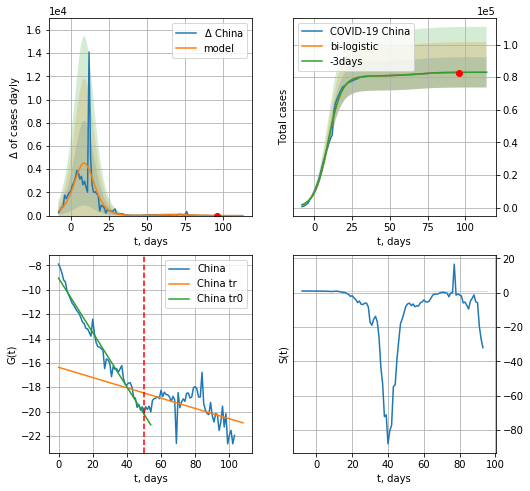

China data at: 2020-05-05
+3 day model MAPE: 0.00033274221928638687
model: bi-logistic
coeffs:  [2.20268965e+03 1.26271799e-01 6.79155792e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.11191175265780086
forecast at the end of period: +18 days
	 deltaDaycases:  0
	 total cases:  83006 ± 9289
	 total death:  4639 ± 1557
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.267310
 intercept: -16.360324
 slope: -0.042304


In [144]:
x = forecast('China',dfCN[:50],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
xx = forecast2('China',dfCN[:],d1,8*7-dT,x,1.0,vL=50)

In [145]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

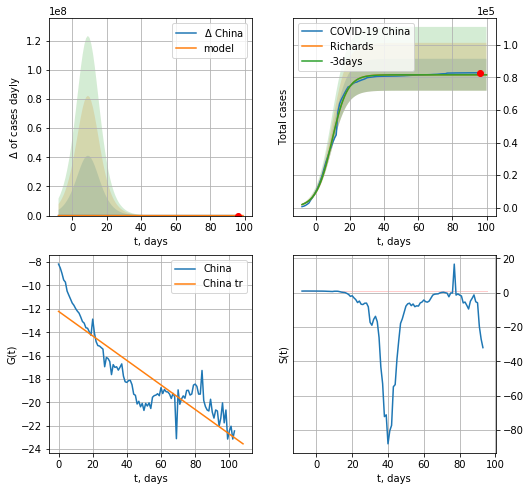

China data at: 2020-05-05
+3 day model MAPE: 0.000716
model: Richards
coeffs: [8.16861990e+04 2.13255898e-01 9.72167010e+00 1.04262384e+00]
rational stdev: 0.120064
forecast at the end of period: +4 days
	 deltaDaycases: 0
	 total cases: 81686 ± 9807
	 total death: 4566 ± 1644
trend coefficient of determination: 0.782163
 intercept: -12.214246
 slope: -0.104869


In [146]:
x = forecastRR('China',dfCN[:],d1,6*7-dT,1.0)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

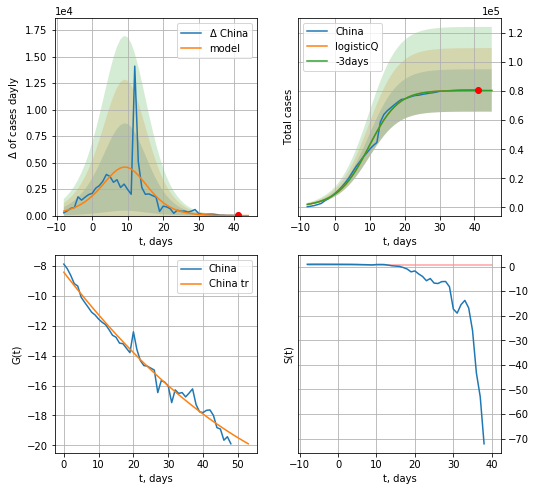

China data at: 2020-05-05
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650457e-03  9.35257488e+00 -2.02425652e+02]
rational stdev: 0.181019
forecast at the end of period: +4 days
	 deltaDaycases: 2
	 total cases: 80411 ± 14555
	 total death: 4494 ± 2440
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp


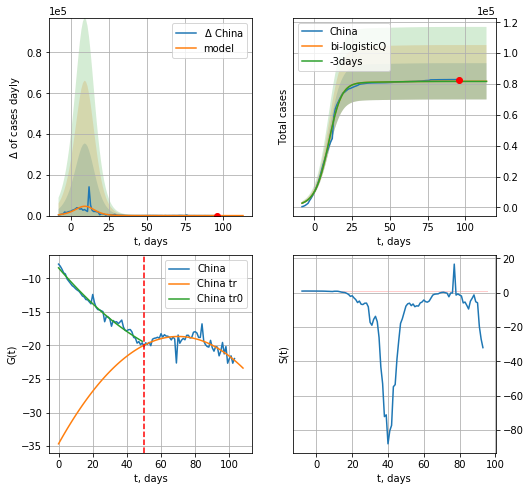

China data at: 2020-05-05
+3 day model MAPE: 0.000852
model: bi-logisticQ
coeffs: [ 1.35081823e+03  8.05491968e-04  2.50250913e+01 -6.47254118e-03]
rational stdev: 0.143671
forecast at the end of period: +18 days
	 deltaDaycases: 0
	 total cases: 81767 ± 11747
	 total death: 4570 ± 1969
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.581120
 intercept_: -34.65731215628827
 coeffs_: [ 0.          0.45680222 -0.00326236]


In [147]:
x = forecastRRR('China',dfCN[:50],d1,6*7-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,8*7-dT,x,1.0,vL=50)

In [148]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
          date  cases  active  death
76 2020-05-01  10780  1407.0  250.0
77 2020-05-02  10793  1360.0  250.0
78 2020-05-03  10801  1332.0  252.0
79 2020-05-04  10804  1267.0  254.0
80 2020-05-05  10806  1218.0  255.0


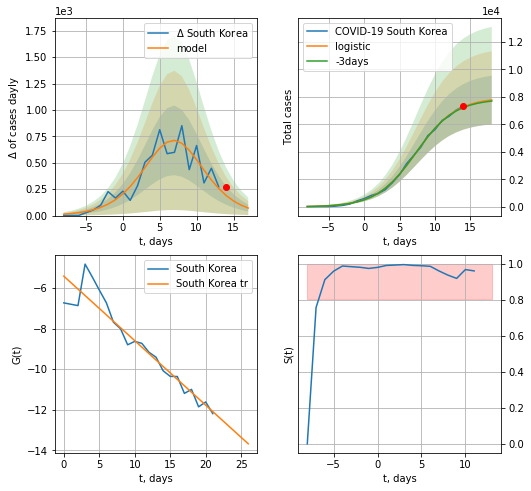

South Korea data at: 2020-05-05
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +4 days
	 deltaDaycases:  71
	 total cases:  7771 ± 1768
	 total death:  183 ± 124
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


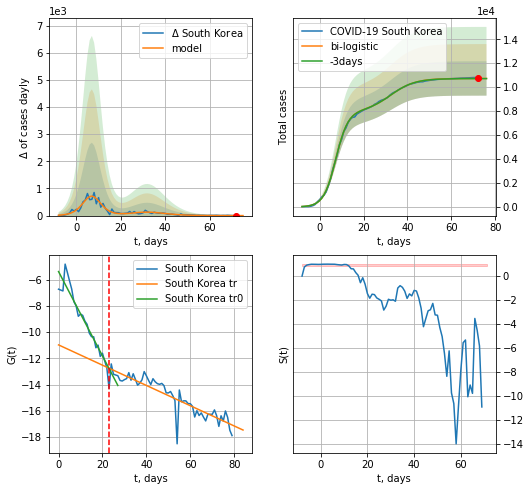

South Korea data at: 2020-05-05
+3 day model MAPE: 0.0012679582530744312
model: bi-logistic
coeffs:  [2.78705694e+03 1.80963503e-01 3.23765106e+01] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.13370893303318238
forecast at the end of period: +4 days
	 deltaDaycases:  0
	 total cases:  10727 ± 1434
	 total death:  253 ± 101
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.791541
 intercept: -10.976851
 slope: -0.077164


In [149]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,6*7-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,6*7-dT,x,1.0,vL=23)

In [150]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

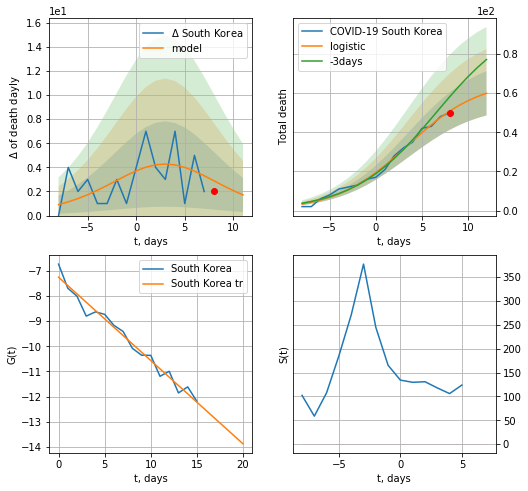

South Korea data at: 2020-05-05
model: logistic
coeffs:  [66.59757424  0.25734808  3.46382915]
rational stdev:  0.18867115045959354
forecast at the end of period: +4 days
	 total death:  59 ± 11
trend coefficient of determination: 0.972428
 intercept: -7.252219
 slope: -0.331355


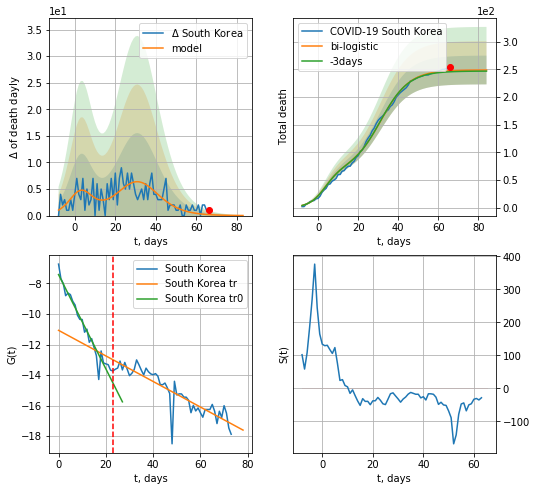

South Korea data at: 2020-05-05
+3 day model MAPE: 0.00765181799353638
model: bi-logistic
coeffs:  [1.82402117e+02 1.39698491e-01 3.13424392e+01] [66.59757424  0.25734808  3.46382915]
rational stdev:  0.10434147033870697
forecast at the end of period: +18 days
	 deltaDaydeath:  0
	 total death:  248 ± 25
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.950305
 intercept: -7.416817
 slope: -0.308862
trend coefficient of determination: 0.791146
 intercept: -11.070526
 slope: -0.083825


In [151]:
x = forecast('South Korea',dfKR[6:23],d1,6*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[6:],d1,8*7-dT,x,1.0,vL=23,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


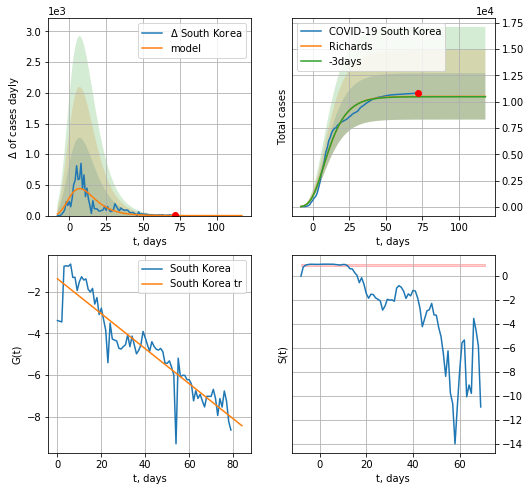

South Korea data at: 2020-05-05
+3 day model MAPE: 0.003289
model: Richards
coeffs: [ 1.05070595e+04  3.03142004e+01 -4.14319992e+01  3.76246949e-03]
rational stdev: 0.209635
forecast at the end of period: +46 days
	 deltaDaycases: 0
	 total cases: 10507 ± 2202
	 total death: 247 ± 155
trend coefficient of determination: 0.854809
 intercept: -1.377371
 slope: -0.083847


In [152]:
x = forecastRR('South Korea',dfKR[:],d1,12*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


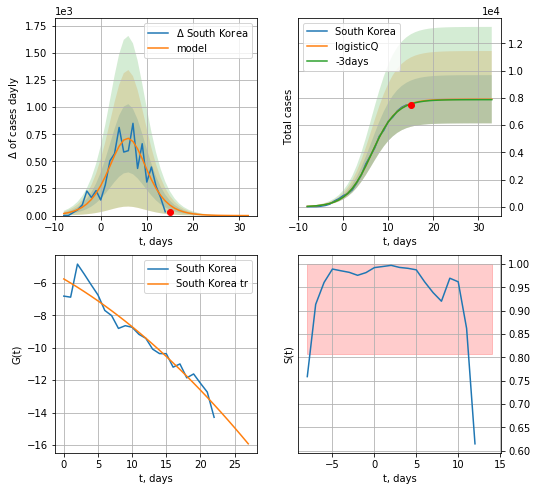

South Korea data at: 2020-05-05
+3 day model MAPE: 0.003444
model: logisticQ
coeffs: [ 7.90024888e+03  7.99722084e-05  6.33808286e+00 -4.52403663e+03]
rational stdev: 0.223765
forecast at the end of period: +18 days
	 deltaDaycases: 0
	 total cases: 7899 ± 1767
	 total death: 186 ± 124
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


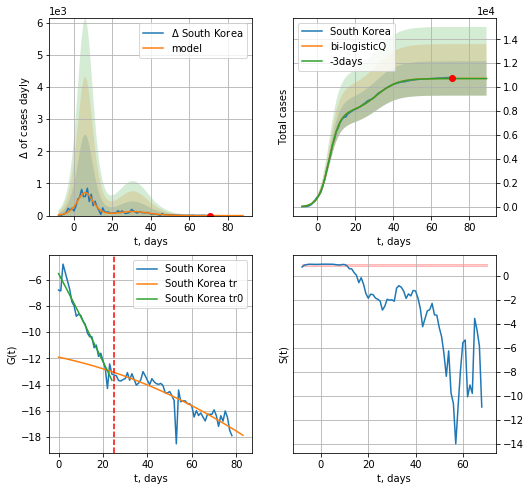

South Korea data at: 2020-05-05
+3 day model MAPE: 0.001236
model: bi-logisticQ
coeffs: [ 2.83050862e+03  1.77728791e-06  3.11847693e+01 -9.98652459e+04]
rational stdev: 0.133603
forecast at the end of period: +18 days
	 deltaDaycases: 0
	 total cases: 10730 ± 1433
	 total death: 253 ± 101
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.936575
 intercept_: -5.550309986859278
 coeffs_: [ 0.         -0.32029791 -0.00074495]
trend coefficient of determination: 0.803000
 intercept_: -11.911067555120695
 coeffs_: [ 0.         -0.03553009 -0.00043539]


In [153]:
vL=25
x = forecastRRR('South Korea',dfKR[1:vL],d1,8*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,8*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


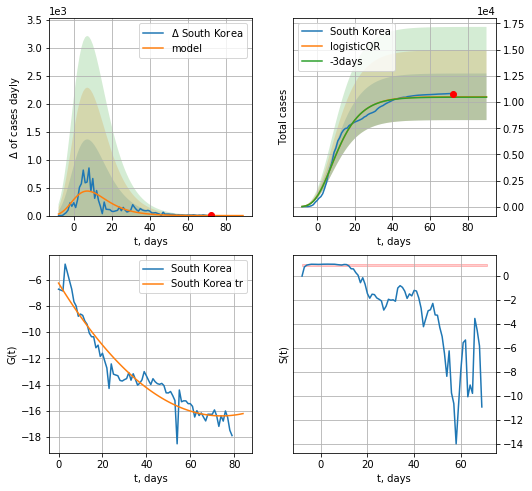

South Korea data at: 2020-05-05
+3 day model MAPE: 0.003354527741853454
model: logisticQR
coeffs:  [ 1.04993632e+04  1.54247685e-01 -6.53374058e+01 -2.13342566e+03
  3.32849900e-04]
rational stdev:  0.21159504271202392
forecast at the end of period: +18 days
	 deltaDaycases:  0
	 total cases:  10498 ± 2221
	 total death:  247 ± 156
trend coefficient of determination: 0.923942
 intercept_: -6.2691182096014195
 coeffs_: [ 0.         -0.27259072  0.00183669]


In [154]:
x = forecastQR('South Korea',dfKR[:],d1,8*7-dT,1.0)

SG
           date  cases  active  death
99  2020-05-01  17101   15817   16.0
100 2020-05-02  17548   16184   17.0
101 2020-05-03  18205   16779   18.0
102 2020-05-04  18778   17303   18.0
103 2020-05-05  19410   17873   18.0


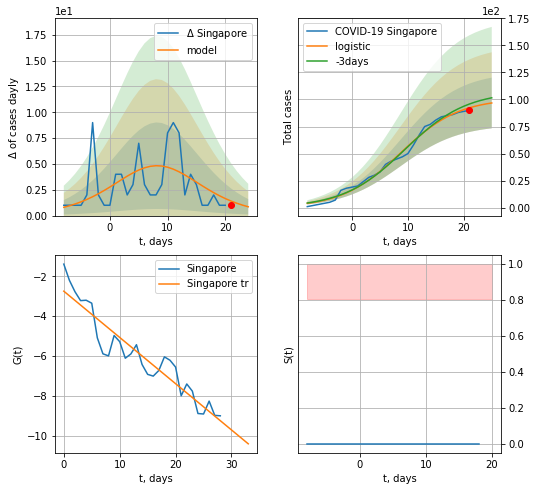

Singapore data at: 2020-05-05
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +4 days
	 deltaDaycases:  0
	 total cases:  96 ± 23
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


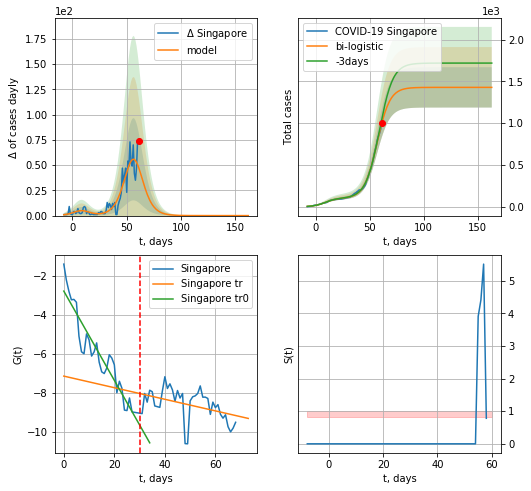

Singapore data at: 2020-05-05
+3 day model MAPE: 0.06119828055586902
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112354758975
forecast at the end of period: +102 days
	 deltaDaycases:  0
	 total cases:  1427 ± 241
	 total death:  1 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776


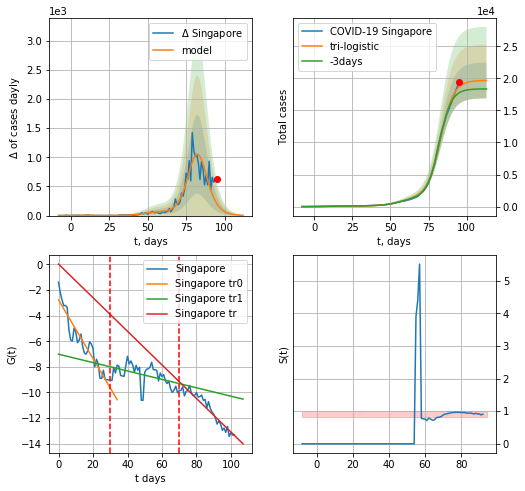

Singapore data at: 2020-05-05
+3 day model MAPE: 0.0543489318228033
model: tri-logistic
coeffs:  [1.82459994e+04 2.30612962e-01 8.28047066e+01] [1.01029909e+02 1.91286963e-01 8.67555654e+00 1.32695355e+03
 1.68329223e-01 5.66911530e+01]
forecast rational stdev:  0.14168239063222063
forecast at the end of period: +18 days
	 deltaDaycases:  4
	 total cases:  19656 ± 2784
	 total death:  18 ± 7
tri-logistic approximation splitting points: 30,70
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend1 coefficient of determination: 0.215531
 intercept: -7.009854
 slope: -0.032798
trend coefficient of determination: 0.918940
 intercept: 0.030017
 slope: -0.131246


In [155]:
vL = 30
vL1 = 70
dfSG = read_df(pd.DataFrame(),"SG")
x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
xx = forecast2('Singapore',dfSG[:vL1],d1,20*7-dT,x,1.0,vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Singapore",dfSG,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


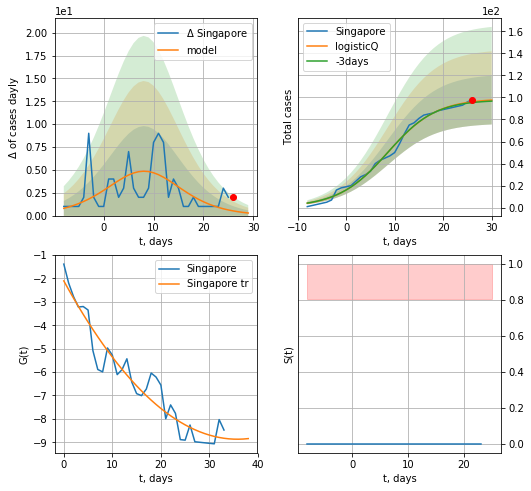

Singapore data at: 2020-05-05
+3 day model MAPE: 0.008158
model: logisticQ
coeffs: [ 9.88556757e+01  2.70682558e-04  8.43151542e+00 -7.17677228e+02]
rational stdev: 0.226599
forecast at the end of period: +4 days
	 deltaDaycases: 0
	 total cases: 97 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp


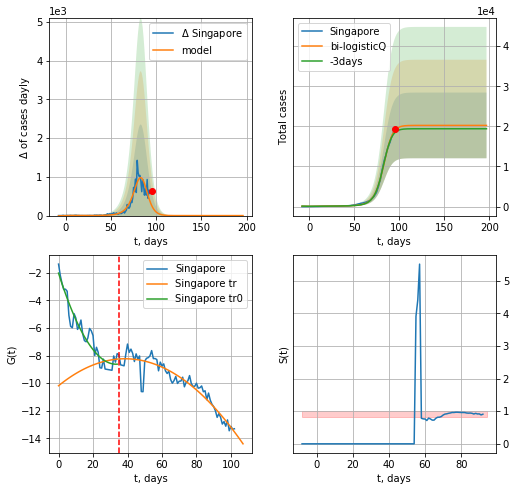

Singapore data at: 2020-05-05
+3 day model MAPE: 0.030617
model: bi-logisticQ
coeffs: [ 2.01380999e+04  1.48078424e-03  8.25077859e+01 -4.83500420e+01]
S.Korea scenario coeffs: [0.35, 0.5, 4.0, 1.0]
rational stdev: 0.404360
forecast at the end of period: +102 days
	 deltaDaycases: 0
	 total cases: 20236 ± 8183
	 total death: 18 ± 21
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.895763
 intercept_: -10.18602256326079
 coeffs_: [ 0.          0.10129739 -0.00131357]


In [156]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,20*7-dT,x,1.0,addpred=True,xcoef=[0.35,.5,4.,1.],vL=vL)

In [157]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


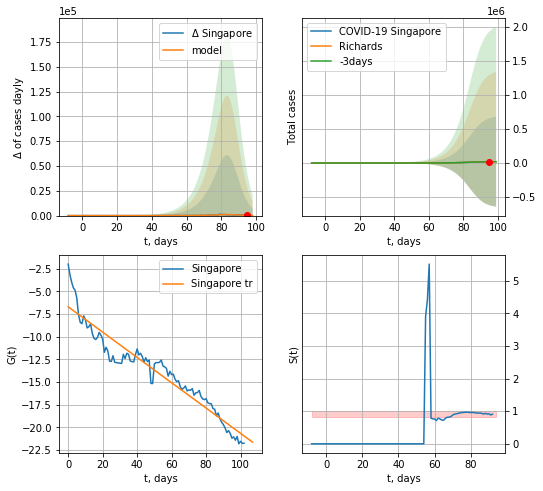

Singapore data at: 2020-05-05
+3 day model MAPE: 0.076307
model: Richards
coeffs: [1.99329580e+04 1.34879678e-01 8.62191357e+01 1.85818104e+00]
rational stdev: 33.893135
forecast at the end of period: +4 days
	 deltaDaycases: 115
	 total cases: 19510 ± 661265
	 total death: 18 ± 1830
trend coefficient of determination: 0.912850
 intercept: -6.696581
 slope: -0.139777


In [158]:
x = forecastRR('Singapore',dfSG[:],d1,6*7-dT,1.0)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)

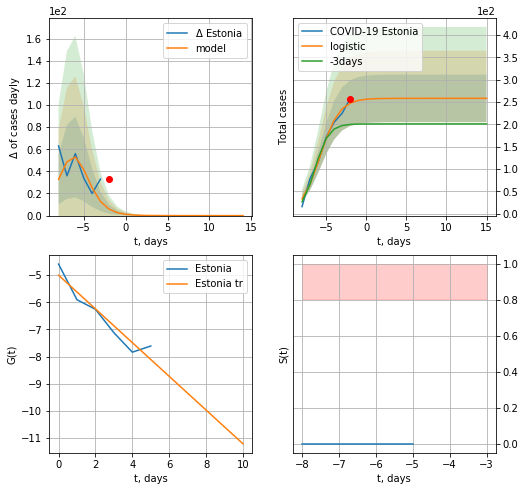

Estonia data at: 2020-05-05
+3 day model MAPE: 0.26329059885154926
model: logistic
coeffs:  [258.51169182   0.83984365  -5.73516243]
rational stdev:  0.20630354623999803
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  258 ± 53
	 total death:  8 ± 4
trend coefficient of determination: 0.908255
 intercept: -5.002820
 slope: -0.620580


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:230: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


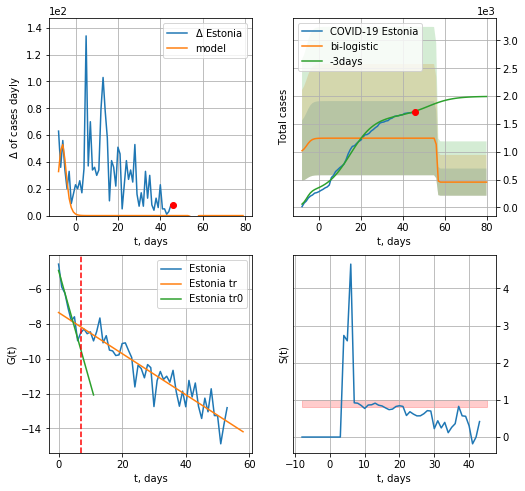

Estonia data at: 2020-05-05
+3 day model MAPE: 0.28533685798788194
model: bi-logistic
coeffs:  [788.72127042  -5.49219652  56.33276288] [258.51169182   0.83984365  -5.73516243]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.5350346616738403
forecast at the end of period: +34 days
	 deltaDaycases:  0
	 total cases:  455 ± 243
	 total death:  14 ± 22
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.942621
 intercept: -4.958003
 slope: -0.647470
trend coefficient of determination: 0.860376
 intercept: -7.365496
 slope: -0.117569


In [162]:
shift = 1.0
x = forecast('Estonia',dfES[:7],d1,17,1.)
xx = forecast2('Estonia',dfES[:],d1,12*6-dT,x,1.,addpred=True,xcoef=[0.25,1.,3.5],vL=7)

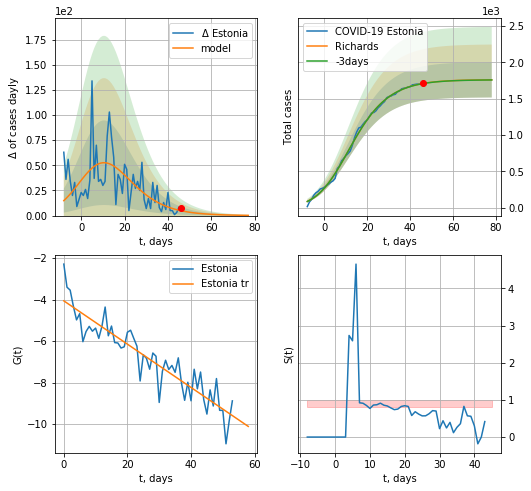

Estonia data at: 2020-05-05
+3 day model MAPE: 0.000749
model: Richards
coeffs: [1.76063610e+03 2.11553903e-01 3.46875698e+00 4.71662026e-01]
rational stdev: 0.137847
forecast at the end of period: +32 days
	 deltaDaycases: 0
	 total cases: 1758 ± 242
	 total death: 56 ± 23
trend coefficient of determination: 0.843132
 intercept: -4.057360
 slope: -0.104322


In [163]:
x = forecastRR('Estonia',dfES[:],d1,7*10-dT,1.)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
#xx = forecast2R('Estonia',dfES[:],d1,7*5-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


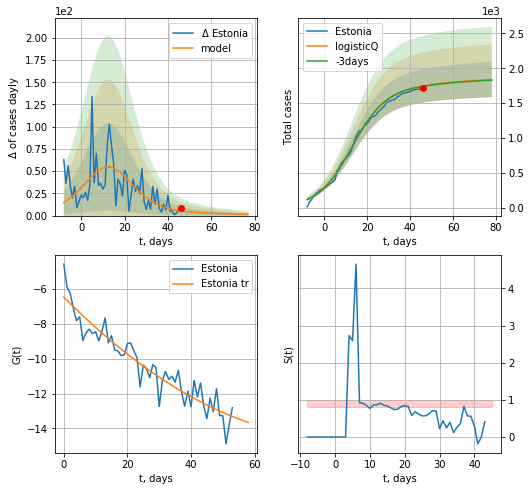

Estonia data at: 2020-05-05
+3 day model MAPE: 0.004277
model: logisticQ
coeffs: [ 1.71180374e+03  2.30668735e-06  1.28128842e+01 -5.47305394e+04]
S.Korea scenario coeffs: [0.0875, 0.5, 4.0, 1]
rational stdev: 0.137231
forecast at the end of period: +32 days
	 deltaDaycases: 1
	 total cases: 1837 ± 252
	 total death: 59 ± 24
trend coefficient of determination: 0.889195
 intercept_: -6.476871599005852
 coeffs_: [ 0.         -0.18446966  0.0010477 ]


In [164]:
x = forecastRRR('Estonia',dfES[:],d1,7*10-dT,1.,addpred=True,xcoef=[0.35/4,.5,4.,1])

LV
          date  cases  active  death
55 2020-05-01  870.0     506   16.0
56 2020-05-02  871.0     507   16.0
57 2020-05-03  879.0     515   16.0
58 2020-05-04  896.0     532   16.0
59 2020-05-05  896.0     531   17.0


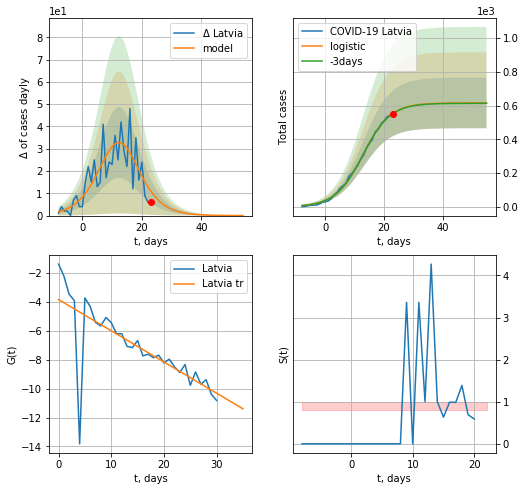

Latvia data at: 2020-05-05
+3 day model MAPE: 0.0032633377916749073
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +32 days
	 deltaDaycases:  0
	 total cases:  616 ± 150
	 total death:  11 ± 8
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:478: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

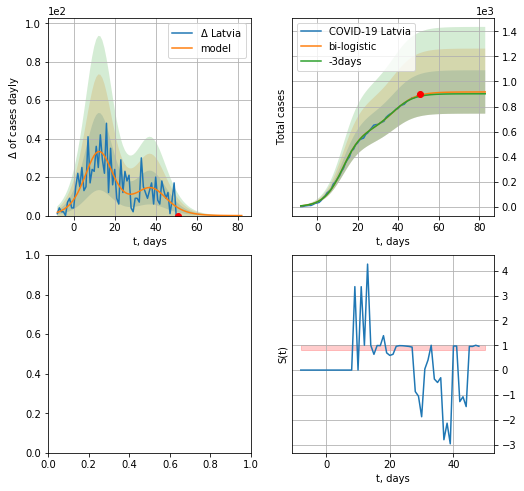

In [165]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
x = forecast('Latvia',dfLV[:vL],d1,10*7-dT,1.)
xx=forecast2('Latvia',dfLV[:],d1,10*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


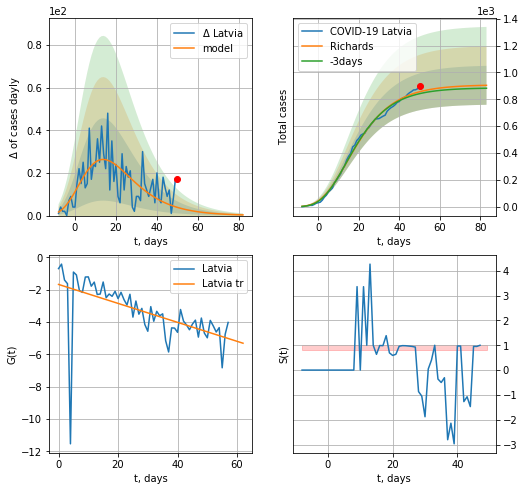

Latvia data at: 2020-05-04
+3 day model MAPE: 0.017238
model: Richards
coeffs: [ 9.08378031e+02  8.26960684e+00 -4.45165842e+01  9.57062727e-03]
rational stdev: 0.160344
forecast at the end of period: +33 days
	 deltaDaycases: 0
	 total cases: 904 ± 145
	 total death: 16 ± 7
trend coefficient of determination: 0.315137
 intercept: -1.679170
 slope: -0.058631


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


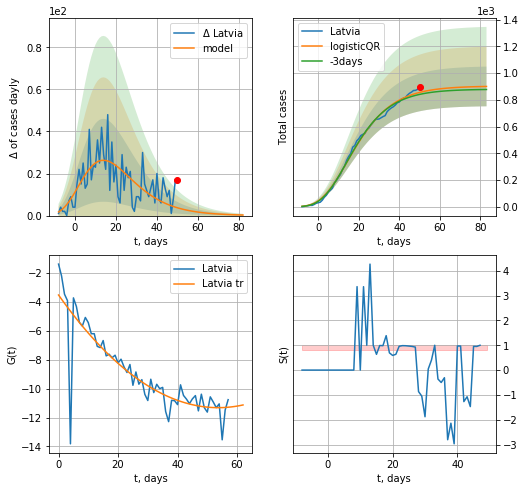

Latvia data at: 2020-05-04
+3 day model MAPE: 0.018056873704357886
model: logisticQR
coeffs:  [ 9.03213647e+02  4.65023304e-02 -7.66670123e+01 -1.33267460e+03
  1.18502841e-03]
rational stdev:  0.16500634436457115
forecast at the end of period: +33 days
	 deltaDaycases:  0
	 total cases:  900 ± 148
	 total death:  16 ± 7
trend coefficient of determination: 0.743096
 intercept_: -3.523642027031876
 coeffs_: [ 0.         -0.29028393  0.00270374]


In [605]:
x = forecastRR('Latvia',dfLV[:],d1,7*10-dT,1.)
x = forecastQR('Latvia',dfLV[:],d1,7*10-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


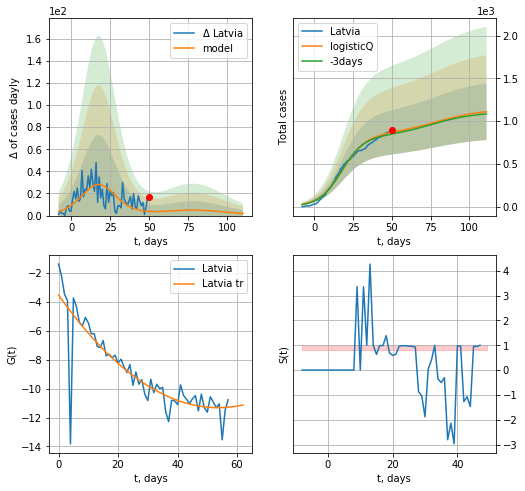

Latvia data at: 2020-05-04
+3 day model MAPE: 0.022842
model: logisticQ
coeffs: [ 8.42870727e+02  7.38741173e-07  1.80367360e+01 -1.78624895e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.297975
forecast at the end of period: +61 days
	 deltaDaycases: 1
	 total cases: 1110 ± 330
	 total death: 19 ± 16
trend coefficient of determination: 0.743096
 intercept_: -3.523642027031876
 coeffs_: [ 0.         -0.29028393  0.00270374]


In [606]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
x = forecastRRR('Latvia',dfLV[:],d1,7*14-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


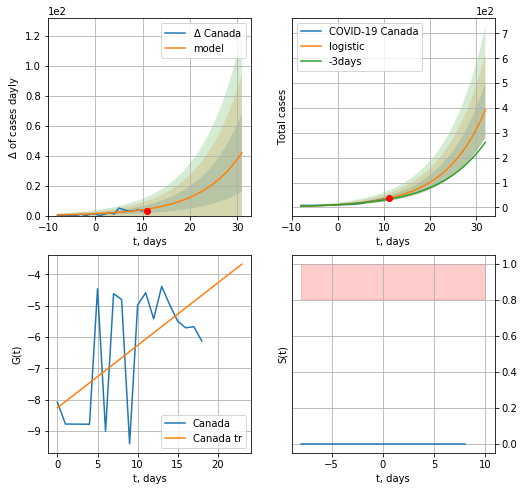

Canada data at: 2020-05-05
+3 day model MAPE: 0.14132705134128837
model: logistic
coeffs:  [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2833741000964234
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  25 ± 21
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


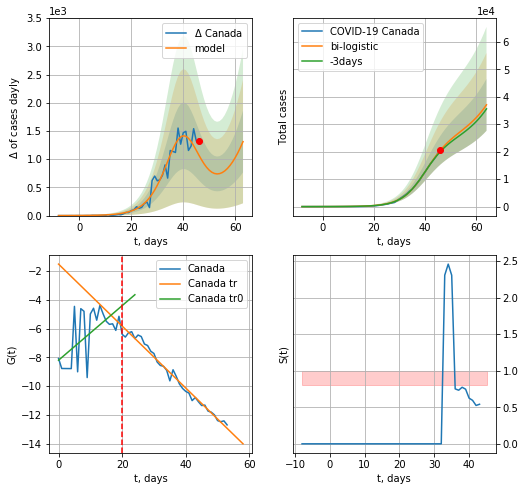

Canada data at: 2020-05-05
+3 day model MAPE: 0.02936701556145869
model: bi-logistic
coeffs:  [2.40154010e+04 2.16961372e-01 4.02658693e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2549294046309869
forecast at the end of period: +18 days
	 deltaDaycases:  1311
	 total cases:  37070 ± 9450
	 total death:  2415 ± 1846
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


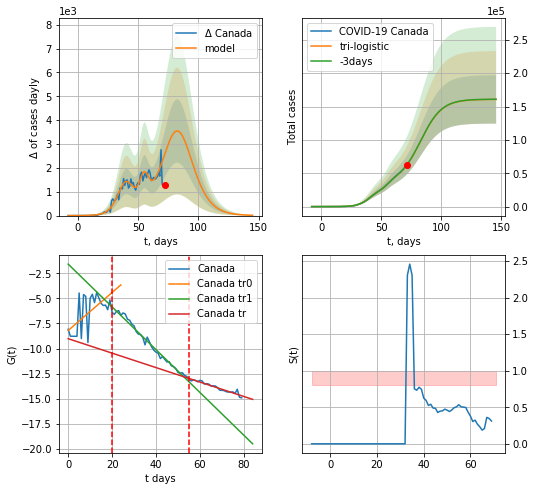

Canada data at: 2020-05-05
+3 day model MAPE: 0.004730471697271397
model: tri-logistic
coeffs:  [1.14400443e+04 3.78450014e-01 5.54804016e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01 2.40154010e+04
 2.16961372e-01 4.02658693e+01]
forecast rational stdev:  0.22554413495182224
forecast at the end of period: +74 days
	 deltaDaycases:  11
	 total cases:  160697 ± 36244
	 total death:  10471 ± 7085
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.925318
 intercept: -9.016399
 slope: -0.072126


In [166]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,8*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
          date    cases  active   death
76 2020-05-01  55061.0   28919  3391.0
77 2020-05-02  56714.0   29347  3566.0
78 2020-05-03  59474.0   30884  3682.0
79 2020-05-04  60772.0   30901  3854.0
80 2020-05-05  62046.0   31010  4043.0


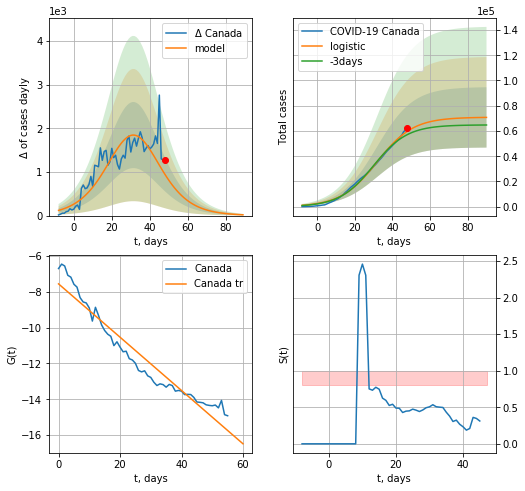

Canada data at: 2020-05-05
+3 day model MAPE: 0.049209329815148604
model: logistic
coeffs:  [7.09098618e+04 1.04112353e-01 3.18373870e+01]
rational stdev:  0.3377969043263257
forecast at the end of period: +42 days
	 deltaDaycases:  18
	 total cases:  70743 ± 23897
	 total death:  4609 ± 4670
trend coefficient of determination: 0.933142
 intercept: -7.550906
 slope: -0.148996


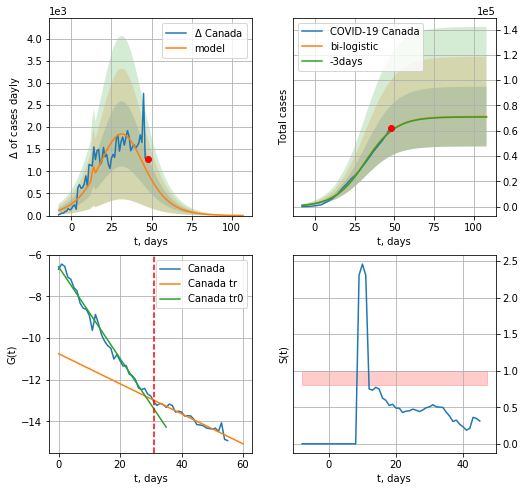

Canada data at: 2020-05-05
+3 day model MAPE: 0.005898613070869095
model: bi-logistic
coeffs:  [358.26460306  14.40652312  14.01859581] [7.09098618e+04 1.04112353e-01 3.18373870e+01]
rational stdev:  0.3314696773198017
forecast at the end of period: +60 days
	 deltaDaycases:  2
	 total cases:  71242 ± 23614
	 total death:  4642 ± 4616
bi-logistic approximation splitting point: 31
trend0 coefficient of determination: 0.983688
 intercept: -6.573152
 slope: -0.220036
trend coefficient of determination: 0.925318
 intercept: -10.747412
 slope: -0.072126


In [167]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,14*7-dT,x,1.,vL=31,cases='cases')

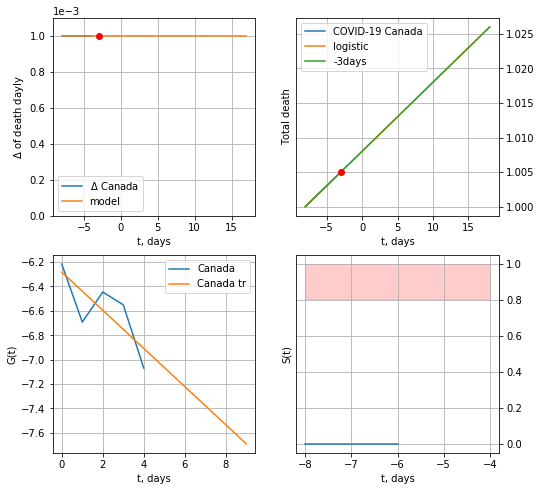

Canada data at: 2020-05-05
+3 day model MAPE: 5.06934136593531e-07
model: logistic
coeffs:  [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  1.4705534785239981e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


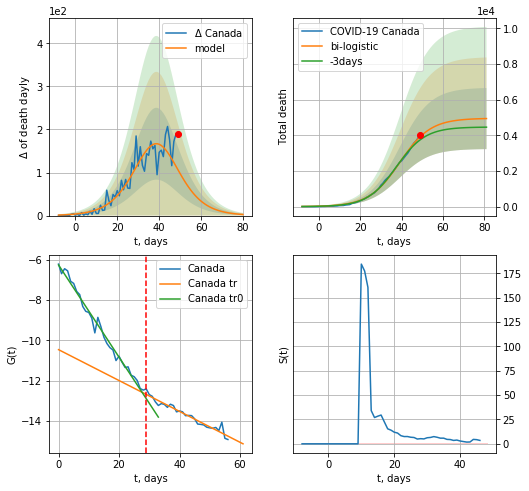

Canada data at: 2020-05-05
+3 day model MAPE: 0.051601019009146855
model: bi-logistic
coeffs:  [4.95288156e+03 1.34971515e-01 3.91406418e+01] [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  0.34696473844466375
forecast at the end of period: +32 days
	 deltaDaydeath:  2
	 total death:  4936 ± 1712
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.941892
 intercept: -10.462076
 slope: -0.076607


In [168]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,10*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


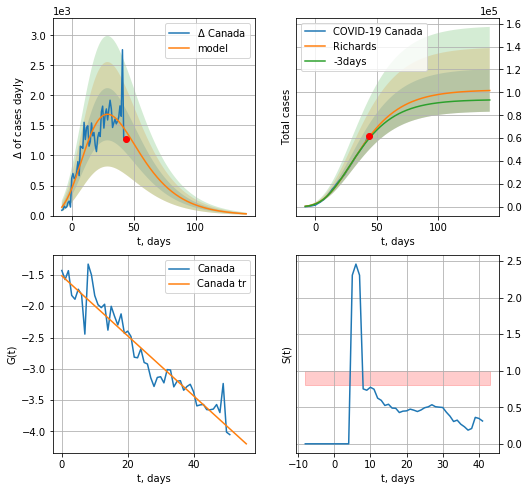

Canada data at: 2020-05-05
+3 day model MAPE: 0.023390
model: Richards
coeffs: [ 1.02232787e+05  3.02474478e+00 -6.37007277e+01  1.49361315e-02]
rational stdev: 0.182187
forecast at the end of period: +98 days
	 deltaDaycases: 28
	 total cases: 101604 ± 18511
	 total death: 6620 ± 3618
trend coefficient of determination: 0.919194
 intercept: -1.515360
 slope: -0.047894


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


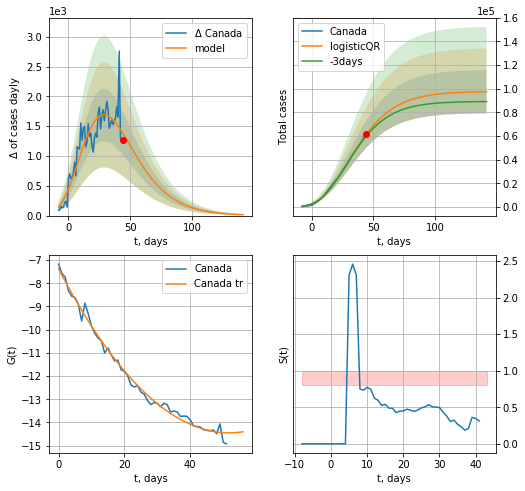

Canada data at: 2020-05-05
+3 day model MAPE: 0.024830518636532385
model: logisticQR
coeffs:  [ 9.76255203e+04  1.01467786e-02 -1.02542950e+02 -7.83357334e+02
  4.93248626e-03]
rational stdev:  0.18776625279256934
forecast at the end of period: +98 days
	 deltaDaycases:  14
	 total cases:  97387 ± 18286
	 total death:  6345 ± 3574
trend coefficient of determination: 0.991168
 intercept_: -7.377115651505401
 coeffs_: [ 0.         -0.27276553  0.00263042]


In [169]:
x = forecastRR('Canada',dfCA[28:],d1,14*7,1.)
x = forecastQR('Canada',dfCA[28:],d1,14*7,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


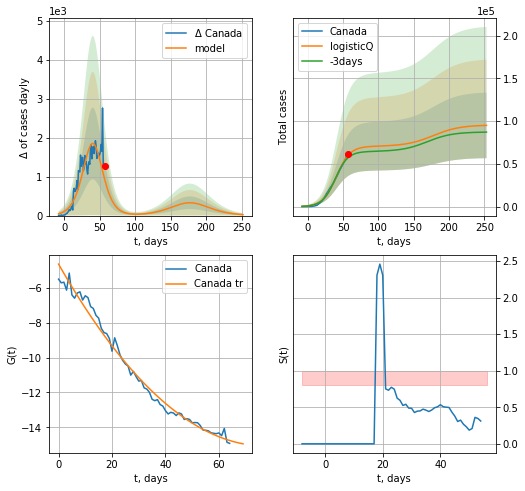

Canada data at: 2020-05-05
+3 day model MAPE: 0.049689
model: logisticQ
coeffs: [ 7.05515599e+04  1.44443891e-06  4.07200895e+01 -7.25481072e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.403870
forecast at the end of period: +196 days
	 deltaDaycases: 24
	 total cases: 95081 ± 38400
	 total death: 6195 ± 7505
trend coefficient of determination: 0.985830
 intercept_: -4.62918807136523
 coeffs_: [ 0.         -0.26946123  0.00173803]


In [170]:
x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
          date  cases  active   death
60 2020-05-01  24988   22697  1007.0
61 2020-05-02  25190   22496  1023.0
62 2020-05-03  25282   22550  1043.0
63 2020-05-04  25524   22749  1063.0
64 2020-05-05  25702   22885  1074.0


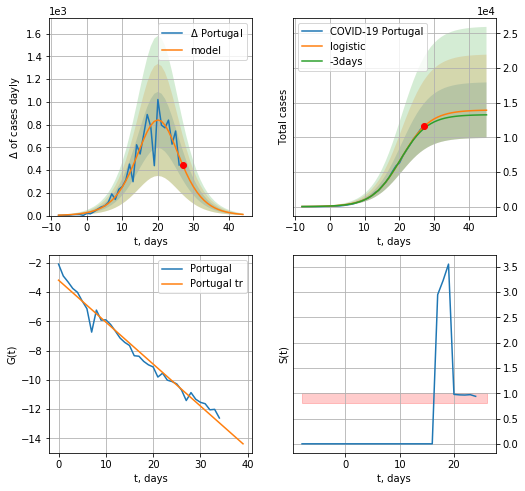

Portugal data at: 2020-05-05
+3 day model MAPE: 0.028768813359110825
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.2880659201380634
forecast at the end of period: +18 days
	 deltaDaycases:  10
	 total cases:  13906 ± 4005
	 total death:  581 ± 502
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


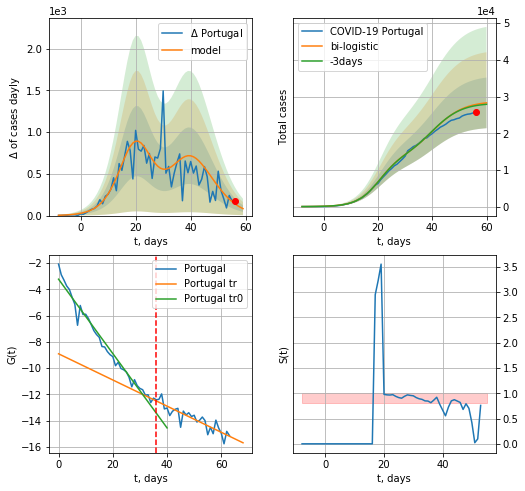

Portugal data at: 2020-05-05
+3 day model MAPE: 0.01227484401342469
model: bi-logistic
coeffs:  [1.17828213e+04 2.04222768e-01 3.95409030e+01] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.24402681864872958
forecast at the end of period: +4 days
	 deltaDaycases:  83
	 total cases:  28282 ± 6901
	 total death:  1181 ± 864
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.787447
 intercept: -8.904297
 slope: -0.099575


In [171]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,8*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,6*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


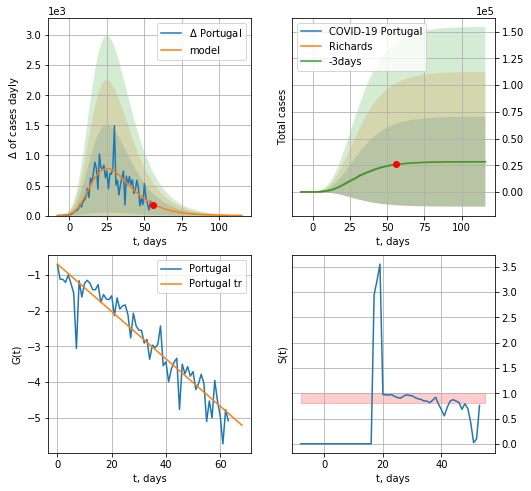

Portugal data at: 2020-05-05
+3 day model MAPE: 0.001382
model: Richards
coeffs: [ 2.83413705e+04  6.95160016e+00 -3.44080490e+01  1.08617658e-02]
rational stdev: 1.484993
forecast at the end of period: +60 days
	 deltaDaycases: 2
	 total cases: 28310 ± 42041
	 total death: 1183 ± 5270
trend coefficient of determination: 0.891300
 intercept: -0.695527
 slope: -0.066320


In [172]:
x = forecastRR('Portugal',dfPT[:],d1,14*7-dT,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


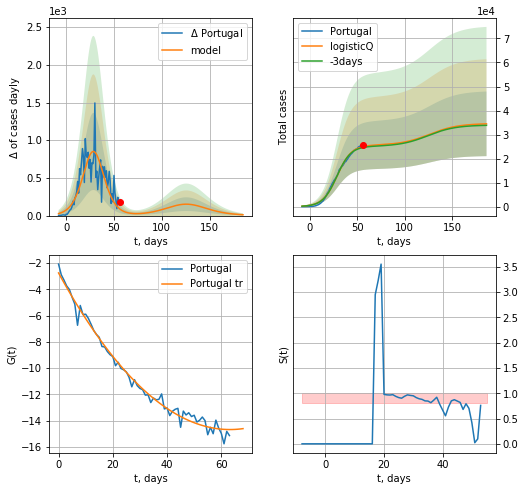

Portugal data at: 2020-05-05
+3 day model MAPE: 0.015839
model: logisticQ
coeffs: [ 2.55625503e+04  1.16174500e-06  2.89201926e+01 -1.14521546e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.390476
forecast at the end of period: +130 days
	 deltaDaycases: 10
	 total cases: 34455 ± 13453
	 total death: 1439 ± 1685
trend coefficient of determination: 0.987116
 intercept_: -2.7516383968708267
 coeffs_: [ 0.         -0.3771196   0.00298371]


In [173]:
x = forecastRRR('Portugal',dfPT[:],d1,24*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

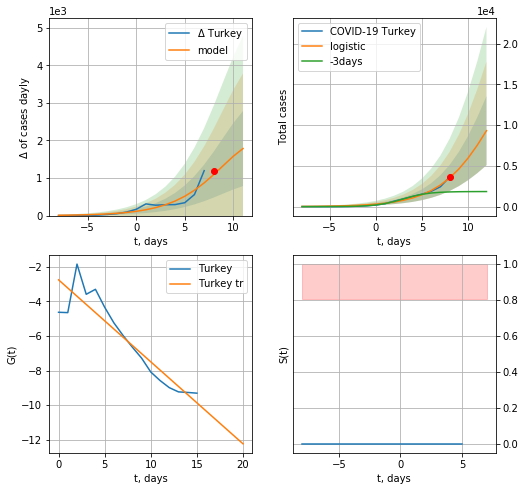

Turkey data at: 2020-05-05
+3 day model MAPE: 1.5246814929812549
model: logistic
coeffs:  [2.42672036e+04 3.25610640e-01 1.34529779e+01]
rational stdev:  0.45520286558776807
forecast at the end of period: +4 days
	 deltaDaycases:  1785
	 total cases:  9315 ± 4240
	 total death:  253 ± 345
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


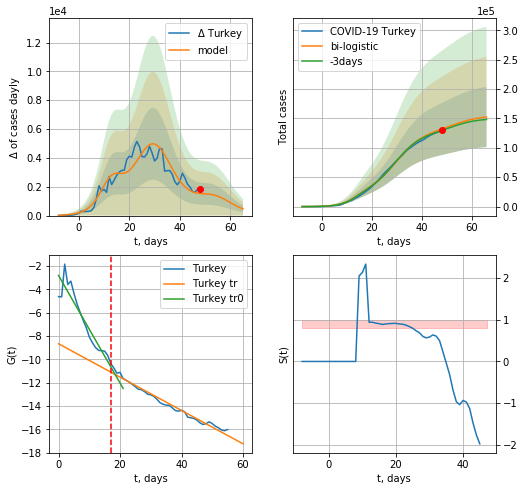

Turkey data at: 2020-05-05
+3 day model MAPE: 0.019619373725539707
model: bi-logistic
coeffs:  [1.04457790e+05 1.87424215e-01 2.98545767e+01] [2.42672036e+04 3.25610640e-01 1.34529779e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.3356269951745309
forecast at the end of period: +18 days
	 deltaDaycases:  462
	 total cases:  152336 ± 51128
	 total death:  4141 ± 4169
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.976204
 intercept: -8.669342
 slope: -0.143037


In [174]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,6*7-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,8*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


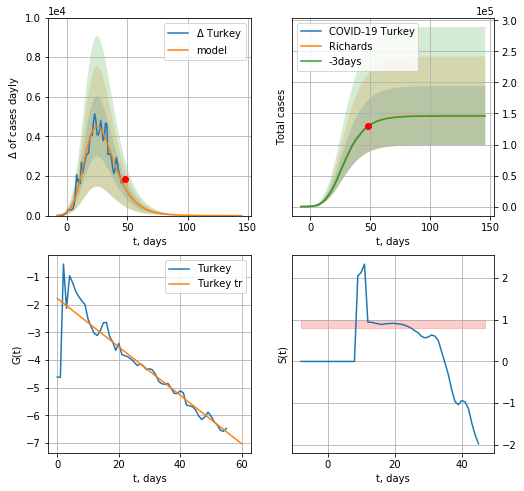

Turkey data at: 2020-05-05
+3 day model MAPE: 0.001610
model: Richards
coeffs: [1.46593285e+05 4.85486349e-01 7.22982330e+00 1.88272877e-01]
rational stdev: 0.324834
forecast at the end of period: +98 days
	 deltaDaycases: 0
	 total cases: 146590 ± 47617
	 total death: 3984 ± 3882
trend coefficient of determination: 0.829752
 intercept: -1.773333
 slope: -0.087689


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


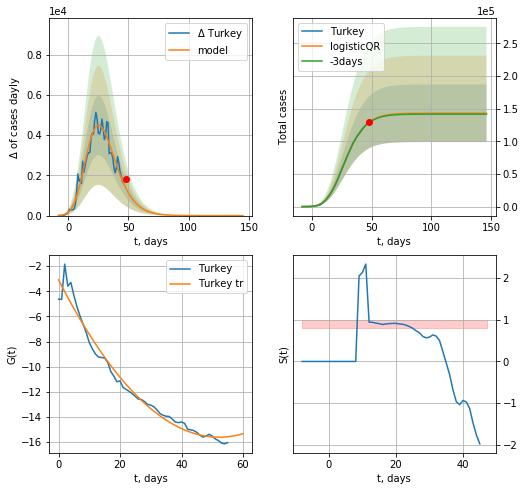

Turkey data at: 2020-05-05
+3 day model MAPE: 0.0037174435656431052
model: logisticQR
coeffs:  [ 1.42913117e+05  2.77925604e-02 -6.32103274e+01 -8.49448379e+01
  1.56587688e-02]
rational stdev:  0.30819396165470536
forecast at the end of period: +98 days
	 deltaDaycases:  0
	 total cases:  142913 ± 44044
	 total death:  3884 ± 3591
trend coefficient of determination: 0.976323
 intercept_: -3.087148032030205
 coeffs_: [ 0.         -0.47923877  0.00458809]


In [175]:
x = forecastRR('Turkey',dfTR[:],d1,14*7,1.,addpred=False,xcoef=[0.35,.5,3,1])
x = forecastQR('Turkey',dfTR[:],d1,14*7,1.,addpred=False,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


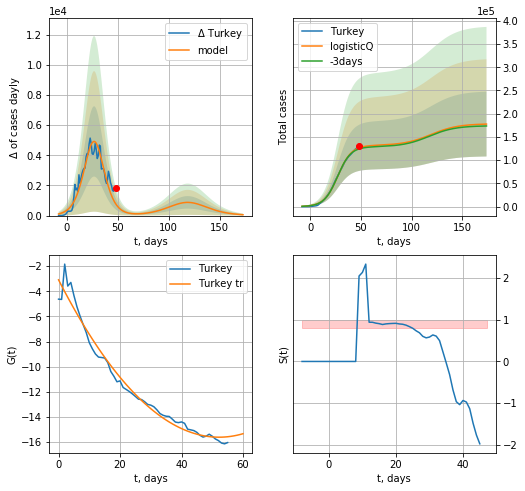

Turkey data at: 2020-05-05
+3 day model MAPE: 0.018578
model: logisticQ
coeffs: [ 1.31715378e+05  2.23769782e-06  2.73409664e+01 -6.67201553e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.392578
forecast at the end of period: +126 days
	 deltaDaycases: 57
	 total cases: 177618 ± 69729
	 total death: 4828 ± 5686
trend coefficient of determination: 0.976323
 intercept_: -3.087148032030205
 coeffs_: [ 0.         -0.47923877  0.00458809]


In [176]:
x = forecastRRR('Turkey',dfTR[:],d1,18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [177]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.018973214285714284

In [178]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

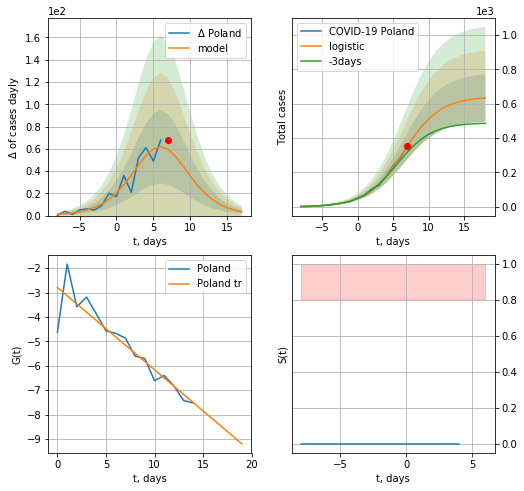

Poland data at: 2020-05-05
+3 day model MAPE: 0.14646234511665837
model: logistic
coeffs:  [6.41107567e+02 3.87606719e-01 6.46563498e+00]
rational stdev:  0.21770687952847212
forecast at the end of period: +11 days
	 deltaDaycases:  3
	 total cases:  633 ± 137
	 total death:  31 ± 20
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


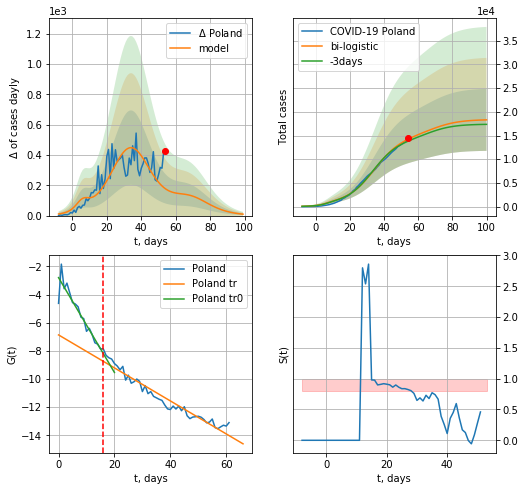

Poland data at: 2020-05-05
+3 day model MAPE: 0.03104162096562426
model: bi-logistic
coeffs:  [1.41835752e+04 1.24960323e-01 3.42746721e+01] [6.41107567e+02 3.87606719e-01 6.46563498e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.35724236872541665
forecast at the end of period: +46 days
	 deltaDaycases:  9
	 total cases:  18298 ± 6536
	 total death:  907 ± 972
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.942499
 intercept: -6.867598
 slope: -0.117297


In [179]:
vL=16
vL1=38
x =  forecast('Poland',dfPL[:vL],d1,7*7-dT,1.)
xx = forecast2('Poland',dfPL[:],d1,12*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


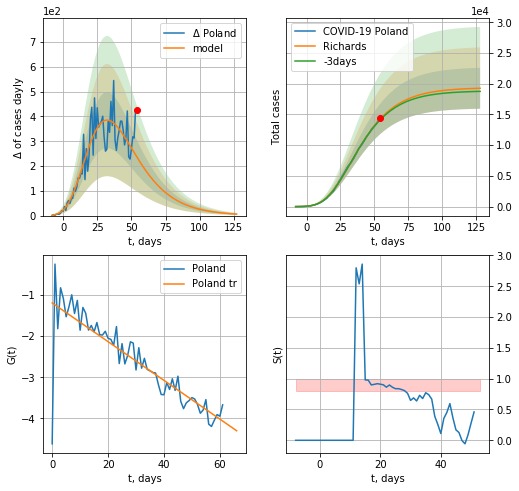

Poland data at: 2020-05-05
+3 day model MAPE: 0.009345
model: Richards
coeffs: [ 1.93675944e+04  3.63562766e+00 -4.44034446e+01  1.49901927e-02]
rational stdev: 0.172803
forecast at the end of period: +74 days
	 deltaDaycases: 5
	 total cases: 19260 ± 3328
	 total death: 955 ± 495
trend coefficient of determination: 0.726681
 intercept: -1.192457
 slope: -0.047044


In [180]:
x =  forecastRR('Poland',dfPL[:],d1,16*7-dT)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


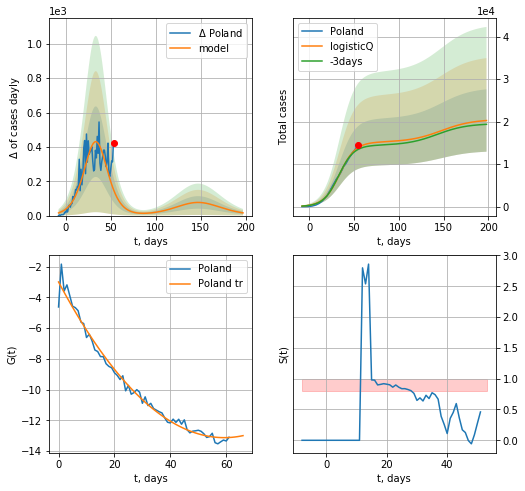

Poland data at: 2020-05-05
+3 day model MAPE: 0.032291
model: logisticQ
coeffs: [ 1.51815233e+04  1.64432013e-06  3.38449250e+01 -6.89101851e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.362376
forecast at the end of period: +144 days
	 deltaDaycases: 15
	 total cases: 20272 ± 7346
	 total death: 1005 ± 1092
trend coefficient of determination: 0.984296
 intercept_: -2.998345964809606
 coeffs_: [ 0.         -0.34191984  0.00288457]


In [181]:
x =  forecastRRR('Poland',dfPL[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
          date    cases  active  death
69 2020-05-01  16101.0    6720  225.0
70 2020-05-02  16185.0    6363  229.0
71 2020-05-03  16208.0    6227  232.0
72 2020-05-04  16246.0    5947  235.0
73 2020-05-05  16289.0    5586  238.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


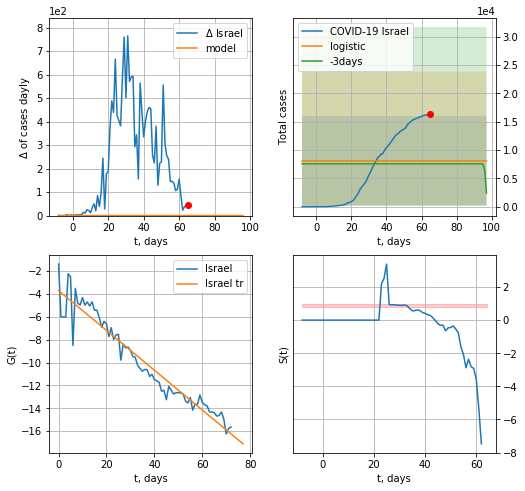

Israel data at: 2020-05-05
+3 day model MAPE: 0.0682399813419625
model: logistic
coeffs:  [ 6.46841986e+03 -3.36707100e+00  1.00071370e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.9765509334101408
forecast at the end of period: +32 days
	 deltaDaycases:  0
	 total cases:  8085 ± 7895
	 total death:  118 ± 345
trend coefficient of determination: 0.928948
 intercept: -3.708596
 slope: -0.174030


In [182]:
dfIS = read_df(pd.DataFrame(),"IS")
x = forecast('Israel',dfIS[:],d1,10*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


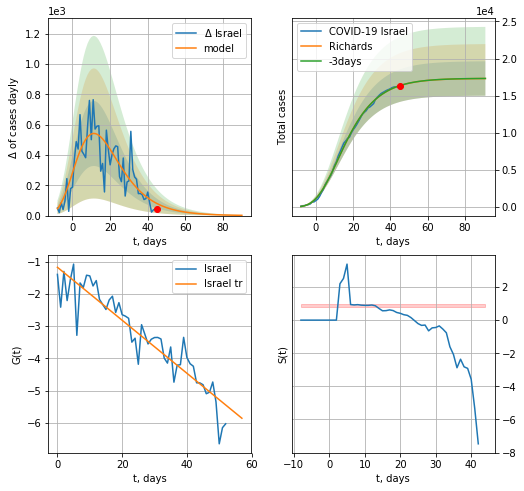

Israel data at: 2020-05-05
+3 day model MAPE: 0.000445
model: Richards
coeffs: [ 1.73415538e+04  9.28384589e+00 -4.30580147e+01  9.20020005e-03]
rational stdev: 0.133751
forecast at the end of period: +46 days
	 deltaDaycases: 1
	 total cases: 17321 ± 2316
	 total death: 253 ± 101
trend coefficient of determination: 0.861275
 intercept: -1.178718
 slope: -0.082039


In [183]:
x = forecastRR('Israel',dfIS[20:],d1,12*7-dT)
#xx = forecast2R('Israel',dfIS[:],d1,7*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


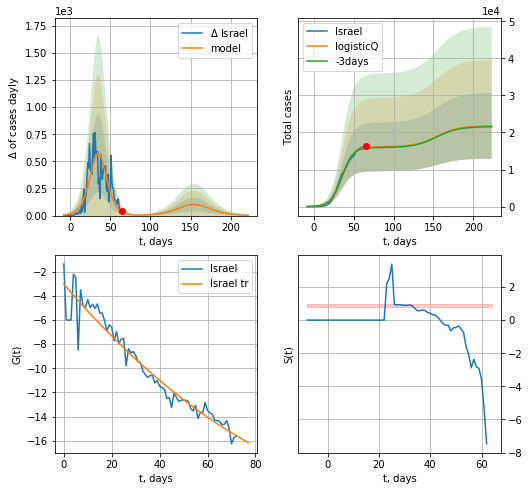

Israel data at: 2020-05-05
+3 day model MAPE: 0.010880
model: logisticQ
coeffs: [ 1.61197365e+04  1.11180867e-06  3.54636098e+01 -1.28524127e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.408279
forecast at the end of period: +158 days
	 deltaDaycases: 3
	 total cases: 21787 ± 8895
	 total death: 318 ± 389
trend coefficient of determination: 0.935533
 intercept_: -3.0475046049993324
 coeffs_: [ 0.         -0.22991117  0.00077623]


In [184]:
x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


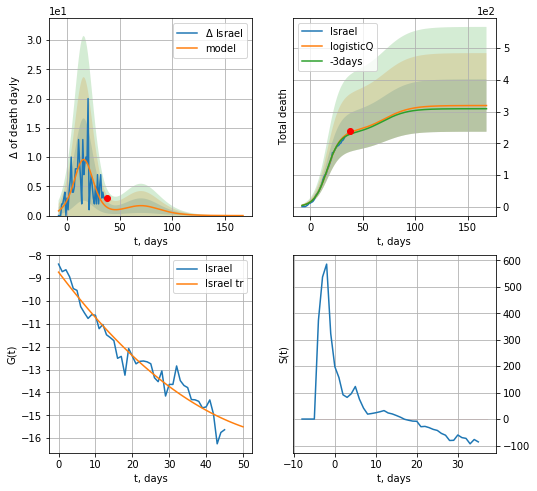

Israel data at: 2020-05-05
+3 day model MAPE: 0.023230
model: logisticQ
coeffs: [ 2.35855923e+02  1.68619808e-05  1.62392715e+01 -9.56347771e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.258552
forecast at the end of period: +130 days
	 total death: 319 ± 82
trend coefficient of determination: 0.949337
 intercept_: -8.7367180246172
 coeffs_: [ 0.         -0.21405763  0.00157313]


In [185]:
x = forecastRRR('Israel',dfIS[27:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


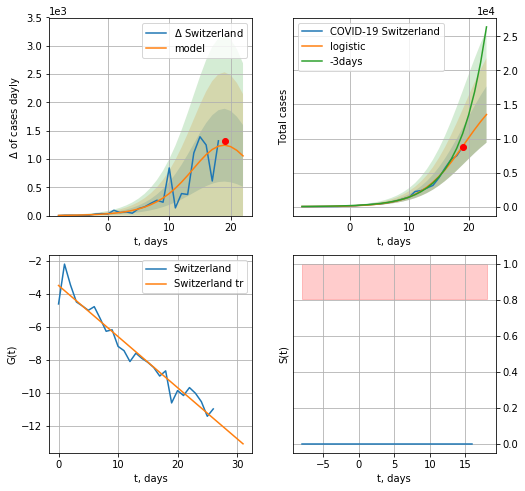

Switzerland data at: 2020-05-05
+3 day model MAPE: 0.24949892382467553
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.30604789910568747
forecast at the end of period: +4 days
	 deltaDaycases:  1054
	 total cases:  13525 ± 4139
	 total death:  809 ± 742
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


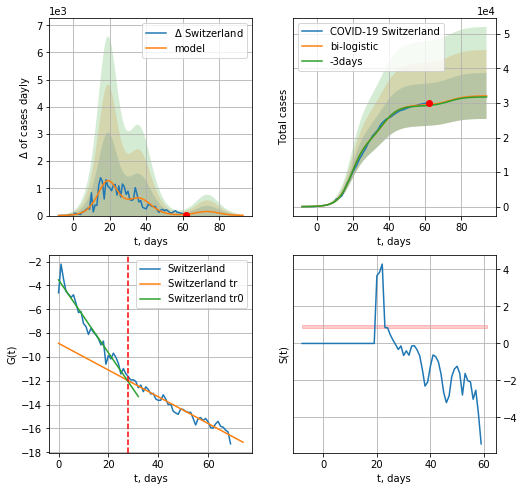

Switzerland data at: 2020-05-05
+3 day model MAPE: 0.008314243933066763
model: bi-logistic
coeffs:  [1.07057415e+04 2.24798399e-01 3.69372505e+01] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.2077553181321185
forecast at the end of period: +32 days
	 deltaDaycases:  7
	 total cases:  32059 ± 6660
	 total death:  1917 ± 1194
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.950851
 intercept: -8.857495
 slope: -0.112089


In [186]:
vL= 28
x = forecast('Switzerland',dfSZ[:vL],d1,7*6-dT)
xx = forecast2('Switzerland',dfSZ[:],d1,7*10-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


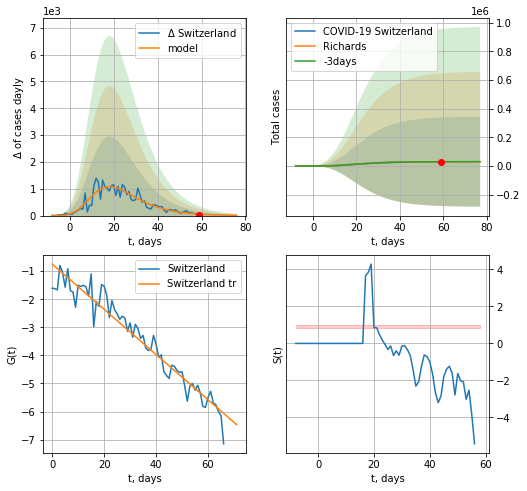

Switzerland data at: 2020-05-05
+3 day model MAPE: 0.001609
model: Richards
coeffs: [ 3.04645749e+04  5.85011596e+00 -2.36027043e+01  1.65954777e-02]
rational stdev: 10.331101
forecast at the end of period: +18 days
	 deltaDaycases: 10
	 total cases: 30359 ± 313647
	 total death: 1815 ± 56252
trend coefficient of determination: 0.935398
 intercept: -0.748789
 slope: -0.080520


In [187]:
x = forecastRR('Switzerland',dfSZ[3:],d1,7*8-dT)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


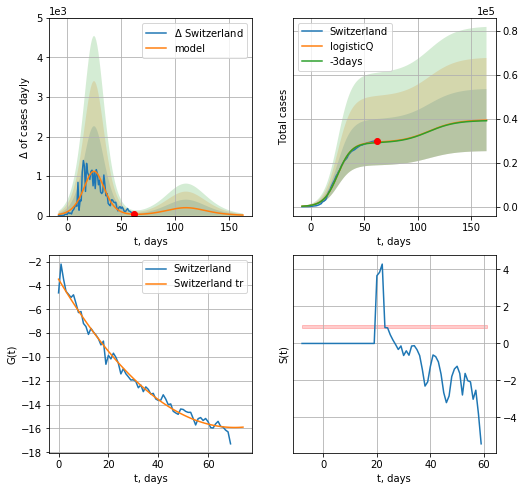

Switzerland data at: 2020-05-05
+3 day model MAPE: 0.007436
model: logisticQ
coeffs: [ 2.92134600e+04  1.09055166e-06  2.53632164e+01 -1.40774304e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.359227
forecast at the end of period: +102 days
	 deltaDaycases: 12
	 total cases: 39396 ± 14152
	 total death: 2356 ± 2539
trend coefficient of determination: 0.985459
 intercept_: -3.479538415091488
 coeffs_: [ 0.         -0.35202697  0.00249122]


In [188]:
x = forecastRRR('Switzerland',dfSZ[:],d1,7*20-dT,addpred=True,xcoef=koreaCoeffs)

In [189]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
          date    cases  active  death
52 2020-05-01  11411.0    9634  279.0
53 2020-05-02  11913.0   10077  288.0
54 2020-05-03  12331.0   10409  303.0
55 2020-05-04  12697.0   10506  316.0
56 2020-05-05  12697.0   10506  316.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:478: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

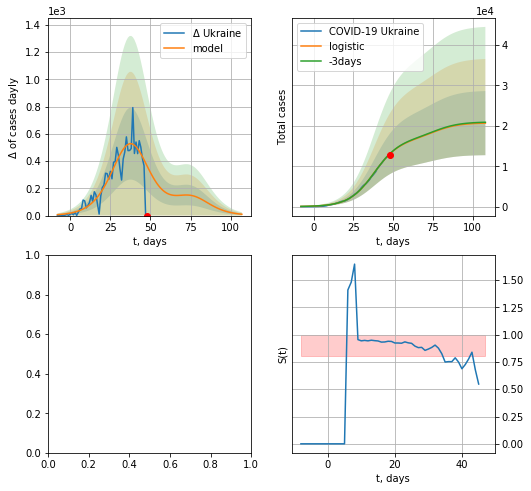

In [190]:
dfUR = read_df(pd.DataFrame(),"Ukr")
x=forecast('Ukraine',dfUR[:],d1,14*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:131: RuntimeWarning: invalid value encountered in true_divide


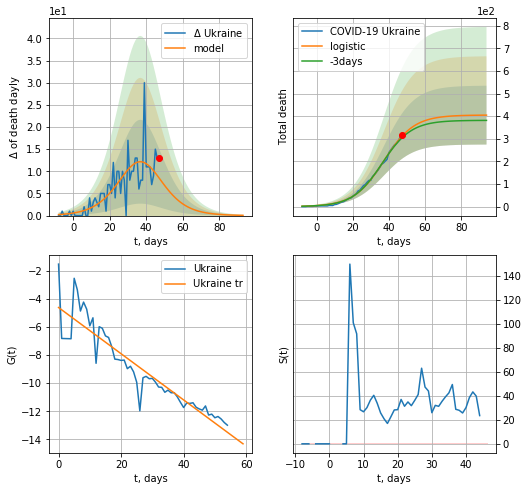

Ukraine data at: 2020-05-04
+3 day model MAPE: 0.02593666550775386
model: logistic
coeffs:  [4.05256236e+02 1.20139382e-01 3.72634727e+01]
rational stdev:  0.321485960917471
forecast at the end of period: +47 days
	 total death:  404 ± 130
trend coefficient of determination: 0.850672
 intercept: -4.600276
 slope: -0.164821


In [634]:
x=forecast('Ukraine',dfUR[:],d1,12*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


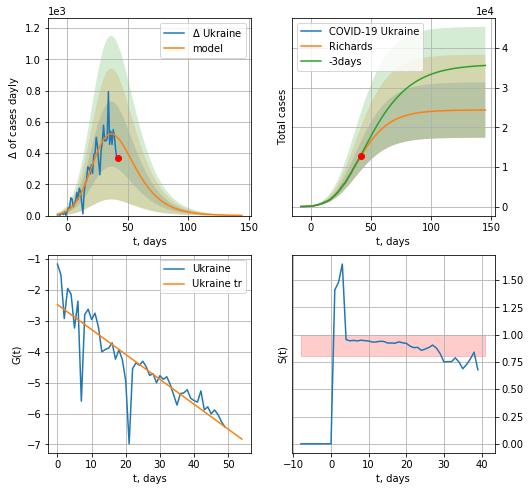

Ukraine data at: 2020-05-04
+3 day model MAPE: 0.029871
model: Richards
coeffs: [2.43704221e+04 2.19216592e-01 1.90562741e+01 3.05241956e-01]
rational stdev: 0.287003
forecast at the end of period: +103 days
	 deltaDaycases: 1
	 total cases: 24352 ± 6989
	 total death: 598 ± 514
trend coefficient of determination: 0.751325
 intercept: -2.474217
 slope: -0.080654


In [635]:
x=forecastRR('Ukraine',dfUR[5:],d1,7*20-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


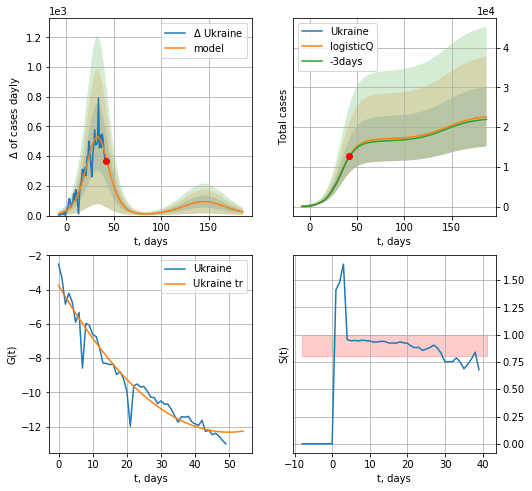

Ukraine data at: 2020-05-04
+3 day model MAPE: 0.013859
model: logisticQ
coeffs: [ 1.70017450e+04  6.73529045e-06  3.33744741e+01 -1.84650694e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.333034
forecast at the end of period: +145 days
	 deltaDaycases: 24
	 total cases: 22607 ± 7528
	 total death: 555 ± 554
trend coefficient of determination: 0.940979
 intercept_: -3.7464061957209216
 coeffs_: [ 0.         -0.34359632  0.00344419]


In [636]:
x=forecastRRR('Ukraine',dfUR[5:],d1,7*26-dT,addpred=True,xcoef=koreaCoeffs)

In [637]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

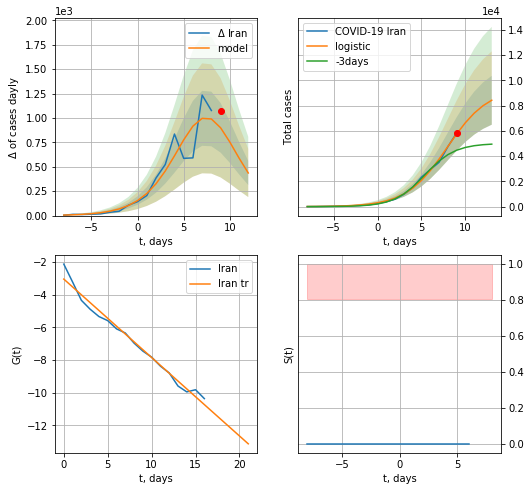

Iran data at: 2020-05-05
+3 day model MAPE: 0.41768987892528675
model: logistic
coeffs:  [9.38566037e+03 4.29600563e-01 7.92981697e+00]
rational stdev:  0.2297342175744371
forecast at the end of period: +4 days
	 deltaDaycases:  436
	 total cases:  8430 ± 1936
	 total death:  534 ± 368
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


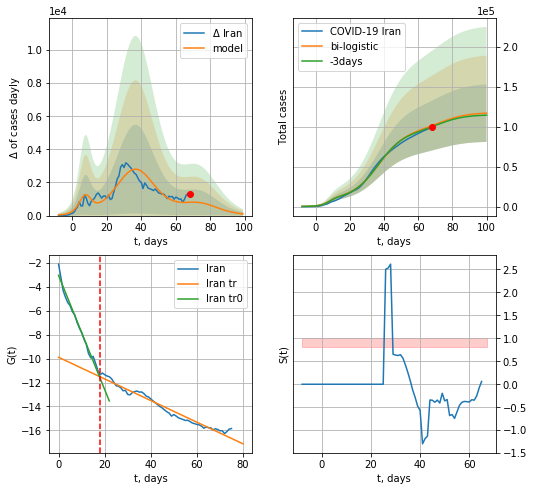

Iran data at: 2020-05-05
+3 day model MAPE: 0.014284035526191487
model: bi-logistic
coeffs:  [8.66934803e+04 1.28333814e-01 3.69954907e+01] [9.38566037e+03 4.29600563e-01 7.92981697e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.30762202022970736
forecast at the end of period: +32 days
	 deltaDaycases:  101
	 total cases:  116982 ± 35986
	 total death:  7418 ± 6845
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.967157
 intercept: -9.894162
 slope: -0.090246


In [191]:
x = forecast('Iran',dfIN[:18],d1,6*7-dT)
xx = forecast2('Iran',dfIN[:],d1,10*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


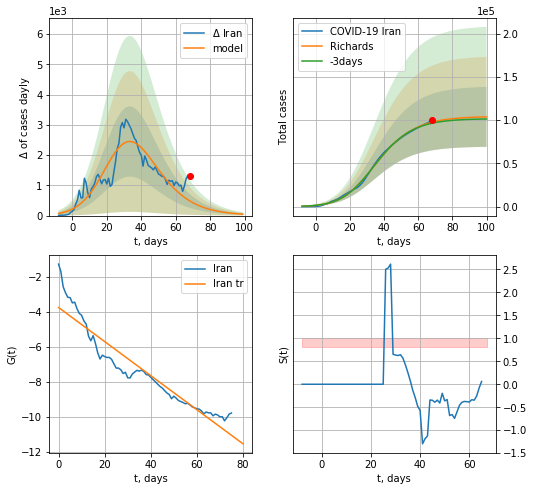

Iran data at: 2020-05-05
+3 day model MAPE: 0.013392
model: Richards
coeffs: [1.04376051e+05 1.65485894e-01 2.43081997e+01 4.74441970e-01]
rational stdev: 0.334074
forecast at the end of period: +32 days
	 deltaDaycases: 46
	 total cases: 103800 ± 34677
	 total death: 6582 ± 6596
trend coefficient of determination: 0.896185
 intercept: -3.753581
 slope: -0.097404


In [192]:
x = forecastRR('Iran',dfIN[:],d1,10*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


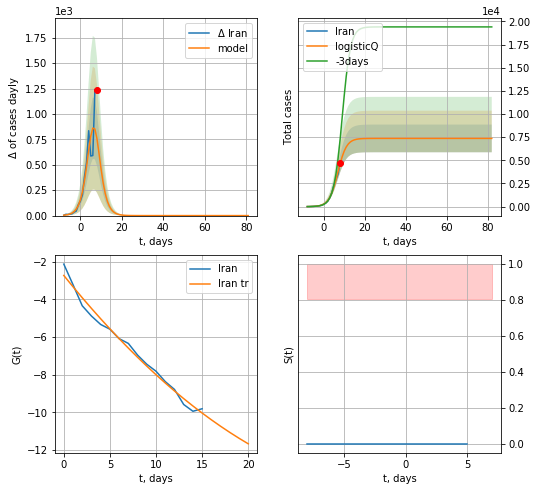

Iran data at: 2020-05-05
+3 day model MAPE: 0.437963
model: logisticQ
coeffs: [ 7.36885538e+03  7.42900276e-05 -6.37012173e+03  6.90117085e+00]
rational stdev: 0.203007
forecast at the end of period: +74 days
	 deltaDaycases: 0
	 total cases: 7368 ± 1495
	 total death: 467 ± 284
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


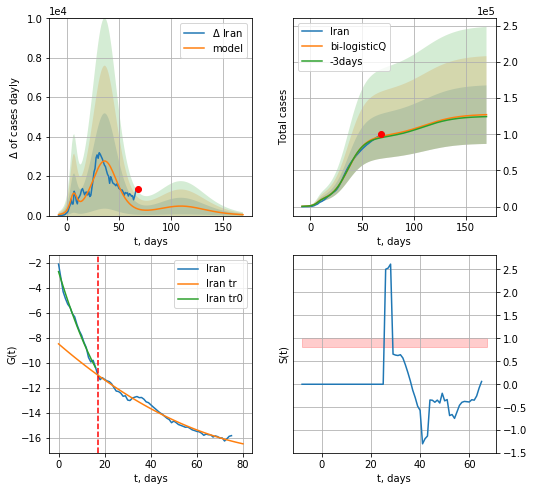

Iran data at: 2020-05-05
+3 day model MAPE: 0.018972
model: bi-logisticQ
coeffs: [ 8.91897875e+04  9.42545818e-07  3.66426863e+01 -1.30718173e+05]
S.Korea scenario coeffs: [0.35, 0.5, 3, 1]
rational stdev: 0.318169
forecast at the end of period: +102 days
	 deltaDaycases: 46
	 total cases: 127025 ± 40415
	 total death: 8055 ± 7688
bi-logisticQ approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.982985
 intercept_: -8.497450197710199
 coeffs_: [ 0.         -0.15921015  0.00074124]


In [193]:
x = forecastRRR('Iran',dfIN[:17],d1,16*7-dT,addpred=False,xcoef=[0.35,.5,3,1])
xx = forecast2RRR('Iran',dfIN[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,3,1],vL=17)

RS
          date     cases  active   death
62 2020-05-01  114431.0  100042  1169.0
63 2020-05-02  124054.0  107819  1222.0
64 2020-05-03  134687.0  116768  1280.0
65 2020-05-04  145268.0  125817  1356.0
66 2020-05-05  155370.0  134054  1451.0


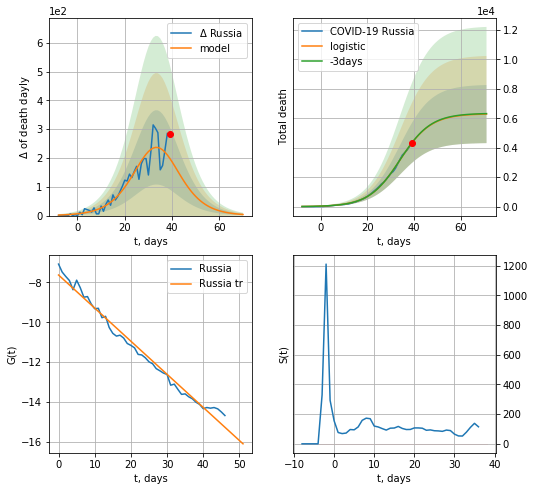

Russia data at: 2020-05-05
+3 day model MAPE: 0.0030745407676904487
model: logistic
coeffs:  [6.30586911e+03 1.50422404e-01 3.38819743e+01]
rational stdev:  0.3138625458722915
forecast at the end of period: +32 days
	 total death:  6282 ± 1971
trend coefficient of determination: 0.983892
 intercept: -7.624940
 slope: -0.166330


In [194]:
dfRS = read_df(pd.DataFrame(),"RS")
x = forecast('Russia',dfRS[19:],d1,10*7-dT,shift=3.,cases='death')
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]

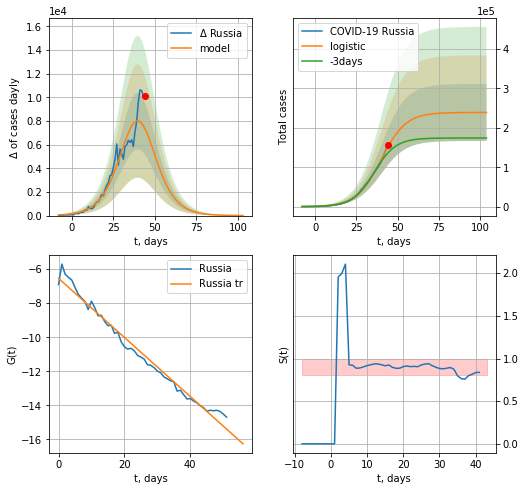

Russia data at: 2020-05-05
+3 day model MAPE: 0.12584985033514814
model: logistic
coeffs:  [2.39093584e+05 1.34074421e-01 4.00782507e+01]
rational stdev:  0.30276418053128396
forecast at the end of period: +60 days
	 deltaDaycases:  6
	 total cases:  239048 ± 72375
	 total death:  2232 ± 2027
trend coefficient of determination: 0.981392
 intercept: -6.542115
 slope: -0.173456


In [195]:
x = forecast('Russia',dfRS[14:],d1,14*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


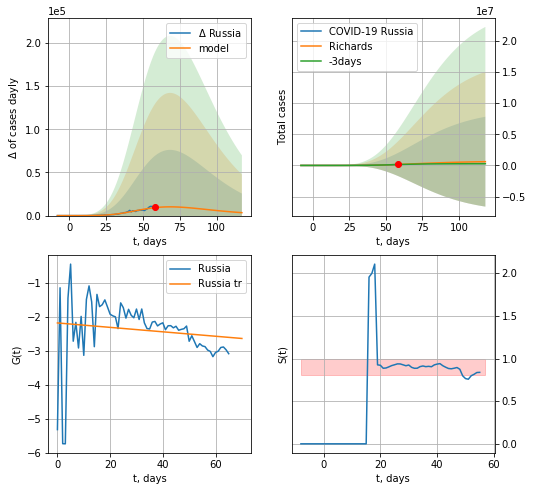

Russia data at: 2020-05-05
+3 day model MAPE: 0.086225
model: Richards
coeffs: [ 6.92567349e+05  1.36973007e+00 -1.85233144e+01  2.94568646e-02]
rational stdev: 11.947226
forecast at the end of period: +60 days
	 deltaDaycases: 3395
	 total cases: 603720 ± 7212786
	 total death: 5638 ± 202075
trend coefficient of determination: 0.019123
 intercept: -2.178034
 slope: -0.006543


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


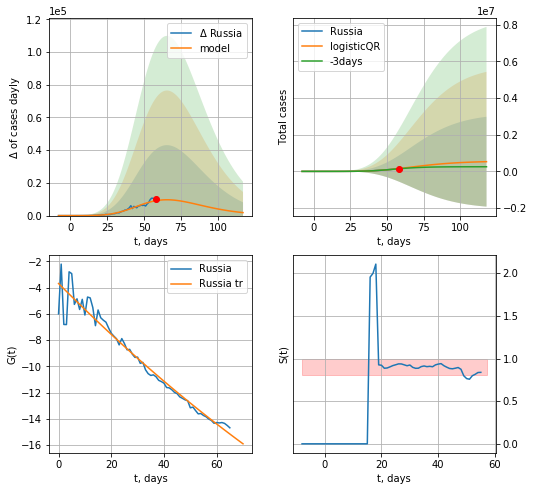

Russia data at: 2020-05-05
+3 day model MAPE: 0.08842173019154749
model: logisticQR
coeffs:  [ 5.59973040e+05  1.45448218e-02 -1.06849504e+02 -2.08211356e+02
  7.28884809e-03]
rational stdev:  4.633449048233519
forecast at the end of period: +60 days
	 deltaDaycases:  1823
	 total cases:  528648 ± 2449465
	 total death:  4937 ± 68626
trend coefficient of determination: 0.952885
 intercept_: -3.686154533049173
 coeffs_: [ 0.         -0.20157222  0.00038557]


In [196]:
x = forecastRR('Russia',dfRS[:],d1,14*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]
x = forecastQR('Russia',dfRS[:],d1,14*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


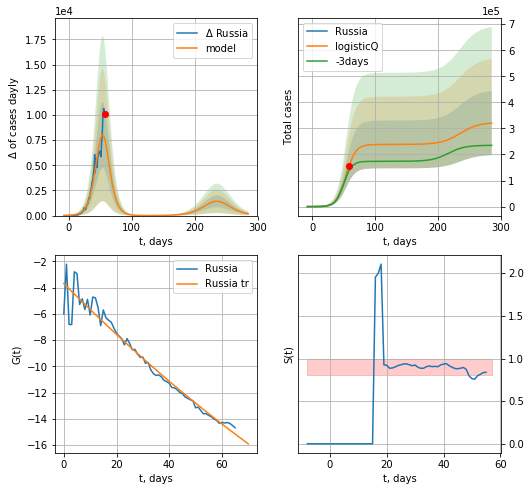

Russia data at: 2020-05-05
+3 day model MAPE: 0.126128
model: logisticQ
coeffs: [ 2.38551548e+05  6.05960897e-06  5.40433992e+01 -2.21087119e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.384187
forecast at the end of period: +228 days
	 deltaDaycases: 183
	 total cases: 320317 ± 123061
	 total death: 2991 ± 3447
trend coefficient of determination: 0.952885
 intercept_: -3.686154533049173
 coeffs_: [ 0.         -0.20157222  0.00038557]


In [197]:
x = forecastRRR('Russia',dfRS[:],d1,38*7-dT,addpred=True,xcoef=koreaCoeffs)

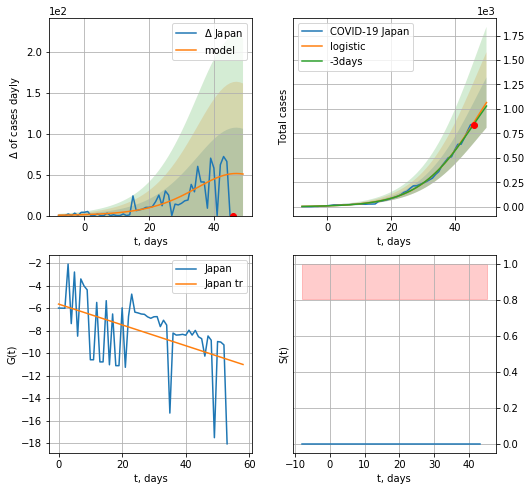

Japan data at: 2020-05-05
+3 day model MAPE: 0.0244139001087548
model: logistic
coeffs:  [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.24188431663406776
forecast at the end of period: +4 days
	 deltaDaycases:  50
	 total cases:  1065 ± 257
	 total death:  38 ± 27
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


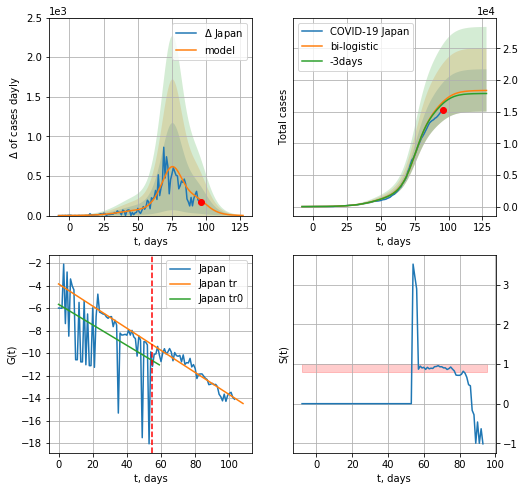

Japan data at: 2020-05-05
+3 day model MAPE: 0.01715591524154349
model: bi-logistic
coeffs:  [1.31992499e+04 1.79455542e-01 7.56552600e+01] [1.86668601e+03 1.09971339e-01 4.74124632e+01]
scenario coeffs:  [0.25, 1.0, 1.25]
rational stdev:  0.18237668817664732
forecast at the end of period: +32 days
	 deltaDaycases:  1
	 total cases:  18356 ± 3347
	 total death:  669 ± 366
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.875559
 intercept: -3.857819
 slope: -0.098410


In [198]:
x = forecast('Japan',dfJP[:55],d1,6*7-dT)
xx = forecast2('Japan',dfJP[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,1.25],vL=55)

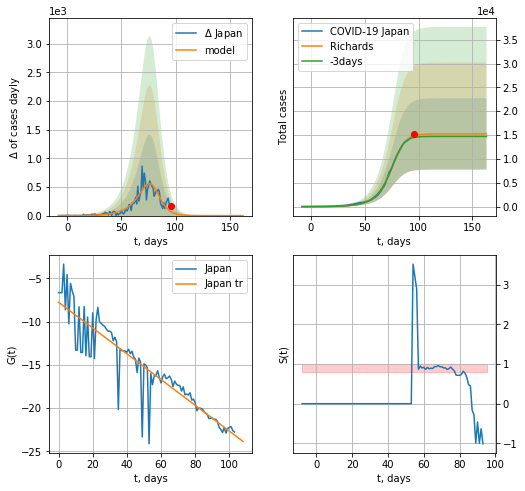

Japan data at: 2020-05-05
+3 day model MAPE: 0.026375
model: Richards
coeffs: [1.52467576e+04 9.74526265e-02 7.97882541e+01 1.89928160e+00]
rational stdev: 0.490332
forecast at the end of period: +67 days
	 deltaDaycases: 0
	 total cases: 15246 ± 7475
	 total death: 555 ± 816
trend coefficient of determination: 0.831685
 intercept: -7.751341
 slope: -0.149004


In [199]:
x = forecastRR('Japan',dfJP[:],d1,15*7-dT)

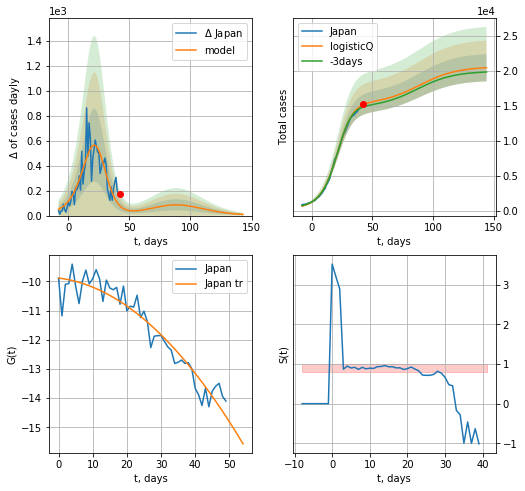

Japan data at: 2020-05-05
+3 day model MAPE: 0.022423
model: logisticQ
coeffs: [ 1.52176113e+04  1.15837760e-03  2.02548211e+01 -1.05375524e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.095258
forecast at the end of period: +102 days
	 deltaDaycases: 9
	 total cases: 20472 ± 1950
	 total death: 746 ± 213
trend coefficient of determination: 0.918489
 intercept_: -9.886611161935987
 coeffs_: [ 0.         -0.01437823 -0.00168034]


In [200]:
x = forecastRRR('Japan',dfJP[54:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


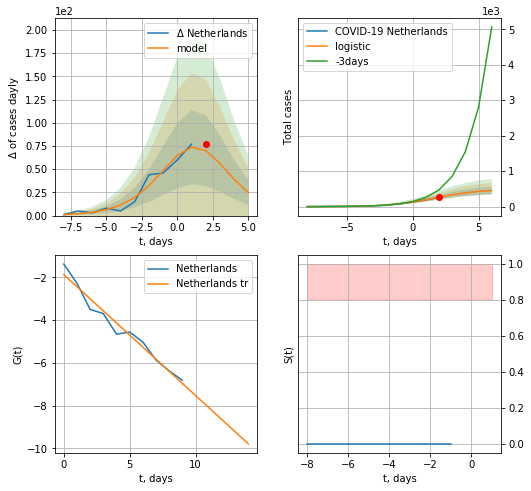

Netherlands data at: 2020-05-05
model: logistic
coeffs:  [487.74708253   0.61204074   1.72557629]
rational stdev:  0.23761280835096962
forecast at the end of period: +4 days
	 deltaDaycases:  24
	 total cases:  454 ± 108
	 total death:  57 ± 40
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:230: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


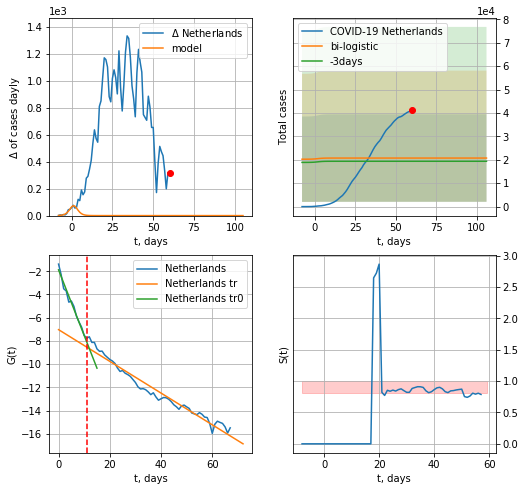

Netherlands data at: 2020-05-05
+3 day model MAPE: 0.07071630527184815
model: bi-logistic
coeffs:  [ 1.62064847e+04 -3.72642575e+00  1.20774407e+02] [487.74708253   0.61204074   1.72557629]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.9004756595519211
forecast at the end of period: +46 days
	 deltaDaycases:  0
	 total cases:  20745 ± 18681
	 total death:  2609 ± 7048
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.962079
 intercept: -7.030814
 slope: -0.136583


In [201]:
vL=11
vL1=32
x = forecast('Netherlands',dfNL[:vL],d1,6*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

NL
          date  cases  active   death
64 2020-05-01  39791   34648  4893.0
65 2020-05-02  40236   34999  4987.0
66 2020-05-03  40571   35265  5056.0
67 2020-05-04  40770   35438  5082.0
68 2020-05-05  41087   35669  5168.0


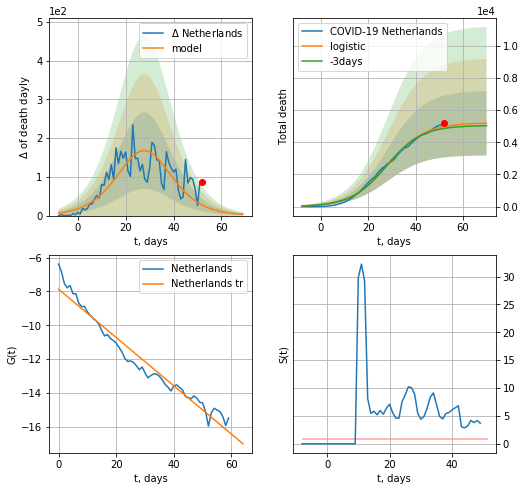

Netherlands data at: 2020-05-05
+3 day model MAPE: 0.024225358120621893
model: logistic
coeffs:  [5.20331935e+03 1.28959852e-01 2.82696621e+01]
rational stdev:  0.3854887889236337
forecast at the end of period: +18 days
	 total death:  5179 ± 1996
trend coefficient of determination: 0.957840
 intercept: -7.864167
 slope: -0.143075


In [202]:
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[8:],d1,8*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


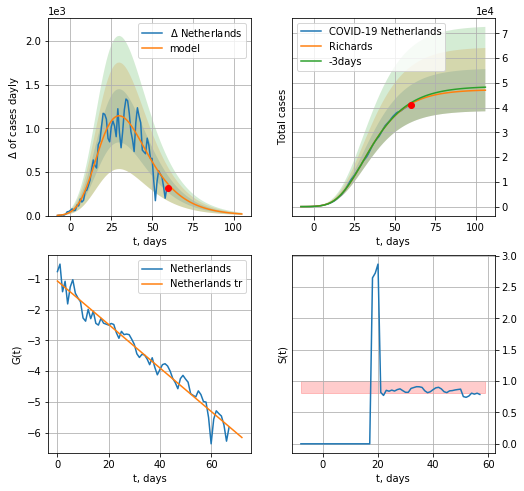

Netherlands data at: 2020-05-05
+3 day model MAPE: 0.009747
model: Richards
coeffs: [ 4.73098871e+04  7.61297365e-01 -4.77308404e+00  9.01729588e-02]
rational stdev: 0.181263
forecast at the end of period: +46 days
	 deltaDaycases: 18
	 total cases: 47049 ± 8528
	 total death: 5917 ± 3217
trend coefficient of determination: 0.964838
 intercept: -1.063235
 slope: -0.070792


In [203]:
x = forecastRR('Netherlands',dfNL[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


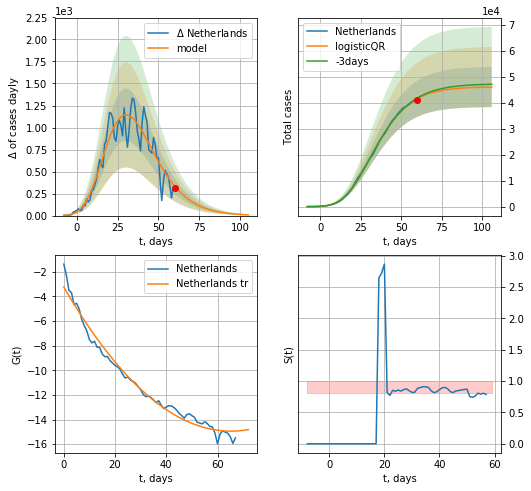

Netherlands data at: 2020-05-05
+3 day model MAPE: 0.008124656566512125
model: logisticQR
coeffs:  [ 4.60558597e+04  2.88797654e-02 -7.76404164e+01 -2.11632147e+02
  6.72264260e-03]
rational stdev:  0.16781229187801183
forecast at the end of period: +46 days
	 deltaDaycases:  8
	 total cases:  45973 ± 7714
	 total death:  5782 ± 2910
trend coefficient of determination: 0.980214
 intercept_: -3.248568028136626
 coeffs_: [ 0.         -0.35876158  0.00275153]


In [204]:
x = forecastQR('Netherlands',dfNL[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


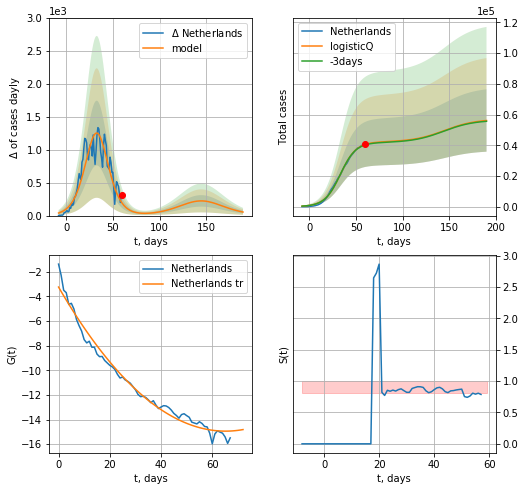

Netherlands data at: 2020-05-05
+3 day model MAPE: 0.008118
model: logisticQ
coeffs: [ 4.21263742e+04  1.48866882e-06  3.32214658e+01 -7.98702183e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.362311
forecast at the end of period: +130 days
	 deltaDaycases: 53
	 total cases: 56110 ± 20329
	 total death: 7057 ± 7670
trend coefficient of determination: 0.980214
 intercept_: -3.248568028136626
 coeffs_: [ 0.         -0.35876158  0.00275153]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: invalid value encountered in true_divide


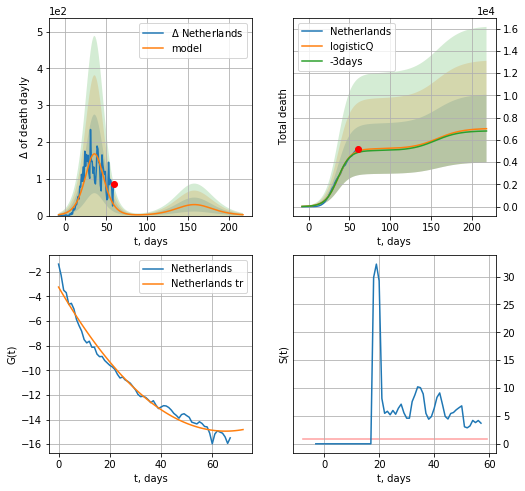

Netherlands data at: 2020-05-05
+3 day model MAPE: 0.024330
model: logisticQ
coeffs: [ 5.19982415e+03  1.45366166e-06  3.62568352e+01 -8.88108795e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.435489
forecast at the end of period: +158 days
	 total death: 7004 ± 3050
trend coefficient of determination: 0.980214
 intercept_: -3.248568028136626
 coeffs_: [ 0.         -0.35876158  0.00275153]


In [205]:
x = forecastRRR('Netherlands',dfNL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [206]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


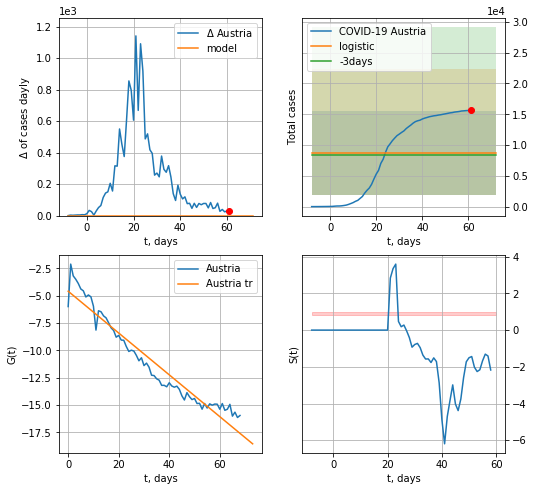

Austria data at: 2020-05-05
+3 day model MAPE: 0.042367047804410786
model: logistic
coeffs:  [ 8.18910014e+03 -2.88135036e+00  1.07338425e+02]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  0.7849060472186403
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  8700 ± 6829
	 total death:  336 ± 791
trend coefficient of determination: 0.934448
 intercept: -4.600344
 slope: -0.190922


In [207]:
x = forecast('Austria',dfAT[:],d1,7*7-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


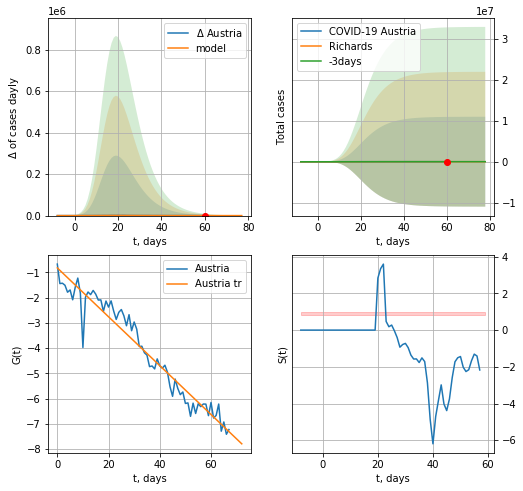

Austria data at: 2020-05-05
+3 day model MAPE: 0.005547
model: Richards
coeffs: [1.54080836e+04 1.43079469e+00 2.63249014e+00 9.64526197e-02]
rational stdev: 712.501036
forecast at the end of period: +18 days
	 deltaDaycases: 0
	 total cases: 15403 ± 10974815
	 total death: 596 ± 1273951
trend coefficient of determination: 0.940760
 intercept: -0.819484
 slope: -0.096780


In [208]:
x = forecastRR('Austria',dfAT[1:],d1,8*7-dT,addpred=False,xcoef=[0.25,1.,2.2,1.])
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


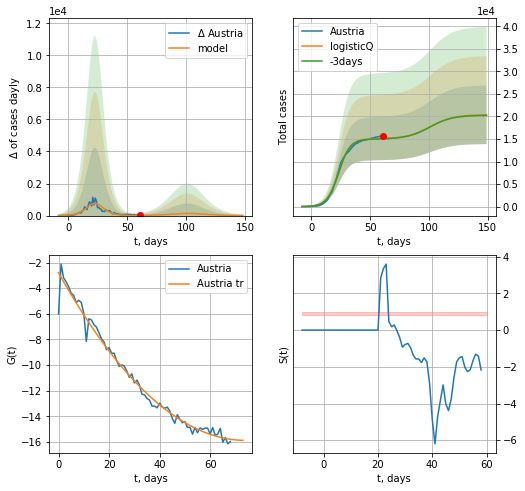

Austria data at: 2020-05-05
+3 day model MAPE: 0.006908
model: logisticQ
coeffs: [ 1.50671764e+04  1.38164800e-06  2.32021209e+01 -1.47020821e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.319076
forecast at the end of period: +88 days
	 deltaDaycases: 4
	 total cases: 20363 ± 6497
	 total death: 788 ± 754
trend coefficient of determination: 0.980396
 intercept_: -2.7976720088539597
 coeffs_: [ 0.         -0.35238171  0.0023746 ]


In [209]:
x = forecastRRR('Austria',dfAT[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:118: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


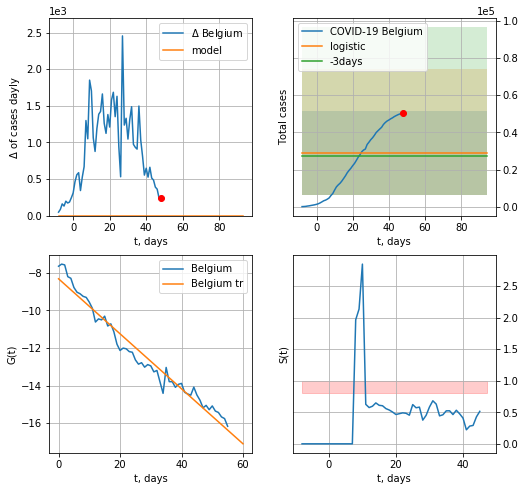

Belgium data at: 2020-05-05
+3 day model MAPE: 0.06829875942752028
model: logistic
coeffs:  [ 2.33530702e+04 -4.84499717e+00  1.85206704e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.7698676104459827
forecast at the end of period: +46 days
	 deltaDaycases:  0
	 total cases:  29191 ± 22473
	 total death:  4632 ± 10698
trend coefficient of determination: 0.962455
 intercept: -8.316469
 slope: -0.146475


In [213]:
vL=9
x = forecast('Belgium',dfBG[vL:],d1,12*7-dT,addpred=True,xcoef=[0.25,1.,3.])
#xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

BG
          date  cases  active   death
61 2020-05-01  49032   29437  7703.0
62 2020-05-02  49517   29541  7765.0
63 2020-05-03  49906   29753  7844.0
64 2020-05-04  50267   29965  7924.0
65 2020-05-05  50509   30052  8016.0


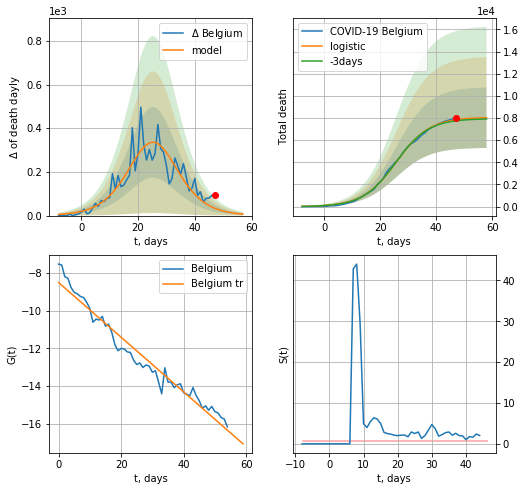

Belgium data at: 2020-05-05
+3 day model MAPE: 0.012743843813351651
model: logistic
coeffs:  [8.06452045e+03 1.66861388e-01 2.57456036e+01]
rational stdev:  0.3402093299292189
forecast at the end of period: +11 days
	 total death:  8027 ± 2731
trend coefficient of determination: 0.961257
 intercept: -8.511514
 slope: -0.145126


In [214]:
dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,7*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


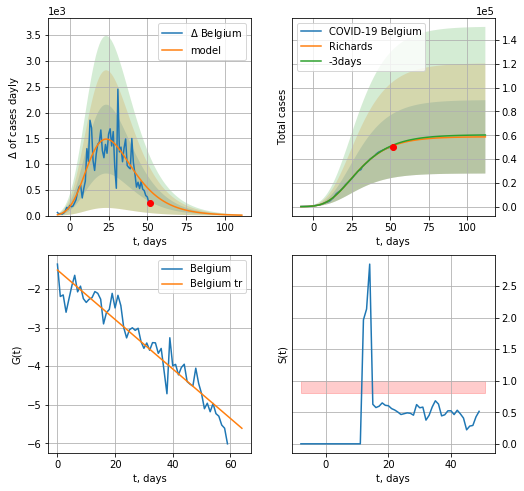

Belgium data at: 2020-05-05
+3 day model MAPE: 0.010244
model: Richards
coeffs: [ 5.87731506e+04  1.13881033e+00 -1.52960866e+01  6.21616735e-02]
rational stdev: 0.525517
forecast at the end of period: +60 days
	 deltaDaycases: 8
	 total cases: 58657 ± 30825
	 total death: 9309 ± 14676
trend coefficient of determination: 0.916724
 intercept: -1.507328
 slope: -0.064127


In [215]:
x = forecastRR('Belgium',dfBG[5:],d1,14*7-dT,addpred=False,xcoef=[0.25,1.,2.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


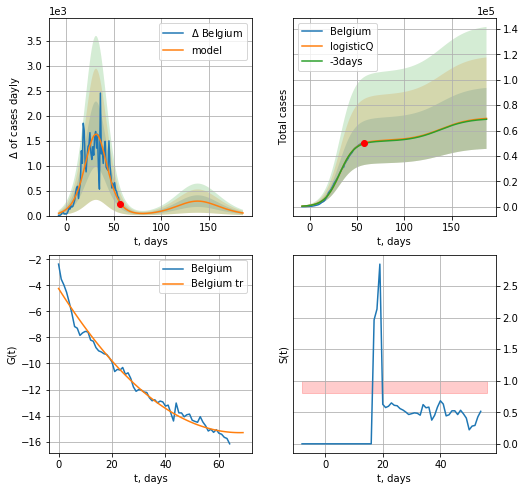

Belgium data at: 2020-05-05
+3 day model MAPE: 0.008493
model: logisticQ
coeffs: [ 5.19756218e+04  1.63626772e-06  3.18380629e+01 -7.65795744e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.345837
forecast at the end of period: +130 days
	 deltaDaycases: 51
	 total cases: 69544 ± 24051
	 total death: 11036 ± 11449
trend coefficient of determination: 0.978202
 intercept_: -4.2388382948898045
 coeffs_: [ 0.         -0.3265481   0.00240722]


In [216]:
x = forecastRRR('Belgium',dfBG[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

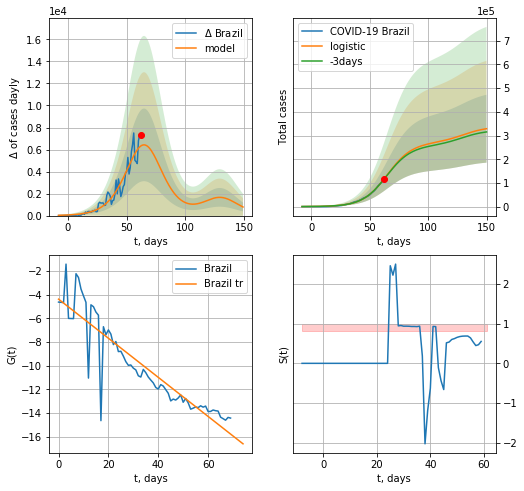

Brazil data at: 2020-05-05
+3 day model MAPE: 0.007427067020938676
model: logistic
coeffs:  [2.70363686e+05 9.48922958e-02 6.51749028e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.4356698441377943
forecast at the end of period: +88 days
	 deltaDaycases:  779
	 total cases:  328800 ± 143248
	 total death:  22565 ± 29492
trend coefficient of determination: 0.830096
 intercept: -4.376532
 slope: -0.165129


In [217]:
x = forecast('Brazil',dfBZ[:],d1,18*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


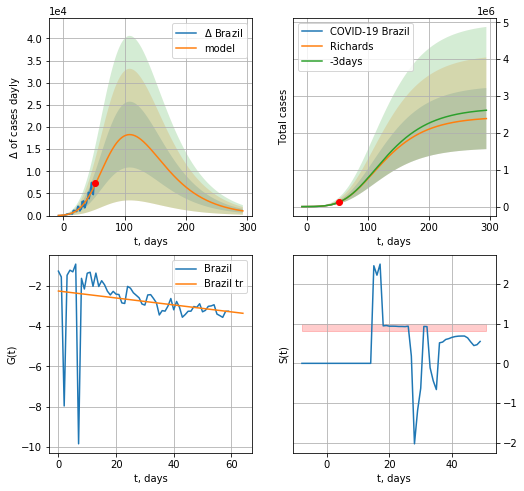

Brazil data at: 2020-05-05
+3 day model MAPE: 0.002203
model: Richards
coeffs: [ 2.43965186e+06  4.81167693e-01 -4.20739538e+01  4.32679635e-02]
rational stdev: 0.347161
forecast at the end of period: +242 days
	 deltaDaycases: 1061
	 total cases: 2388634 ± 829240
	 total death: 163934 ± 170734
trend coefficient of determination: 0.049242
 intercept: -2.264672
 slope: -0.017236


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


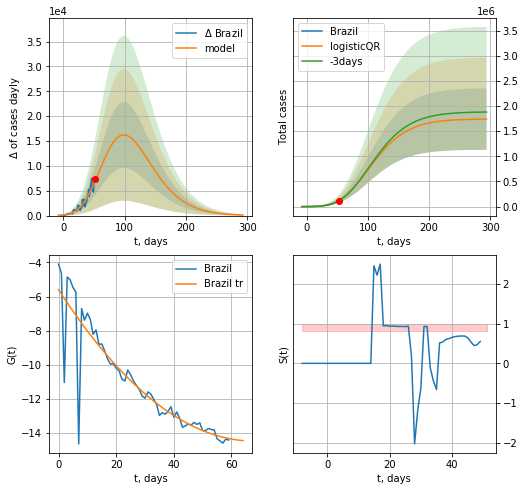

Brazil data at: 2020-05-05
+3 day model MAPE: 0.0038566285262966217
model: logisticQR
coeffs:  [ 1.74269380e+06  3.25853458e-03 -2.59568117e+02 -2.65803788e+02
  1.08742445e-02]
rational stdev:  0.3510554930223035
forecast at the end of period: +242 days
	 deltaDaycases:  109
	 total cases:  1739967 ± 610825
	 total death:  119416 ± 125764
trend coefficient of determination: 0.809849
 intercept_: -5.593912603791162
 coeffs_: [ 0.         -0.26154974  0.00192448]


In [218]:
x = forecastRR('Brazil',dfBZ[10:],d1,40*7-dT)
x = forecastQR('Brazil',dfBZ[10:],d1,40*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


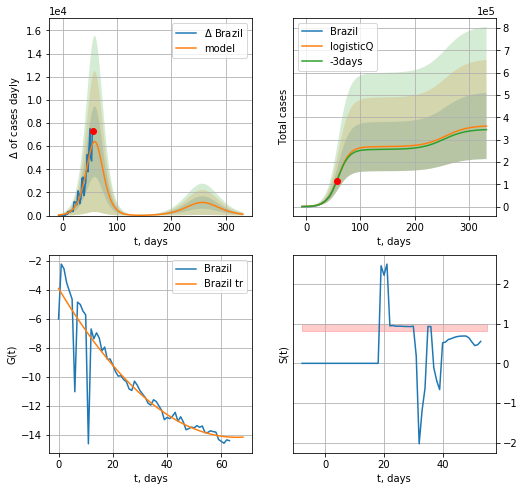

Brazil data at: 2020-05-05
+3 day model MAPE: 0.007622
model: logisticQ
coeffs: [ 2.68708194e+05  8.11307726e-06  5.90502735e+01 -1.16853153e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.409799
forecast at the end of period: +277 days
	 deltaDaycases: 119
	 total cases: 361375 ± 148091
	 total death: 24801 ± 30490
trend coefficient of determination: 0.845636
 intercept_: -3.9111814043897795
 coeffs_: [ 0.         -0.31274593  0.00237899]


In [219]:
x = forecastRRR('Brazil',dfBZ[6:],d1,45*7-dT,addpred=True,xcoef=koreaCoeffs)

In [220]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

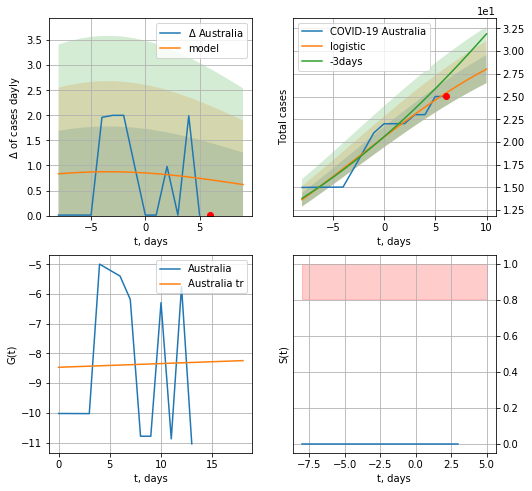

Australia data at: 2020-05-05
model: logistic
coeffs:  [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.0551816162827012
forecast at the end of period: +4 days
	 deltaDaycases:  0
	 total cases:  28 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


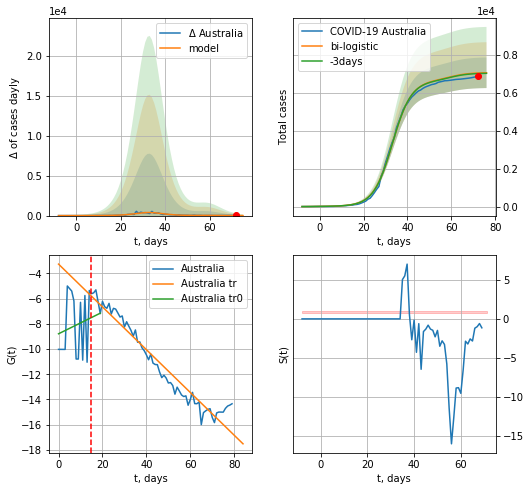

Australia data at: 2020-05-05
+3 day model MAPE: 0.004192898802126525
model: bi-logistic
coeffs:  [6.62177217e+03 2.31588084e-01 3.31857598e+01] [35.98153551  0.09728993 -2.93367767]
scenario coeffs:  [0.0625, 1.0, 1.8]
rational stdev:  0.11401732684668266
forecast at the end of period: +4 days
	 deltaDaycases:  2
	 total cases:  7061 ± 805
	 total death:  99 ± 33
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.942592
 intercept: -3.258045
 slope: -0.169752


In [221]:
x = forecast('Australia',dfAS[:15],d1,6*7-dT,pMAPE=False)
xx = forecast2('Australia',dfAS[:],d1,6*7-dT,x,vL=15,addpred=True,xcoef=[0.25/4,1.,1.8])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


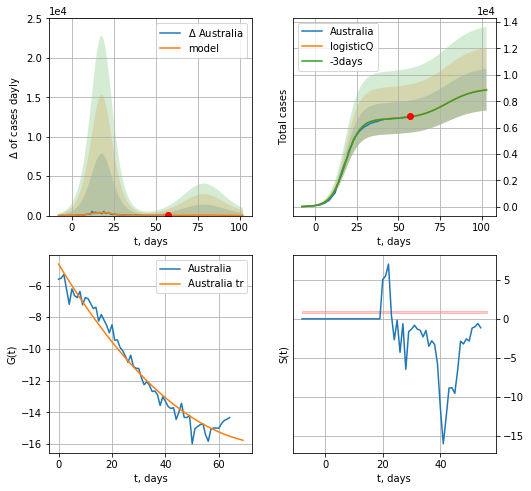

Australia data at: 2020-05-05
+3 day model MAPE: 0.004174
model: logisticQ
coeffs: [ 6.66161876e+03  2.71250568e-06  1.81322015e+01 -8.43080684e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.178418
forecast at the end of period: +46 days
	 deltaDaycases: 16
	 total cases: 8880 ± 1584
	 total death: 125 ± 66
trend coefficient of determination: 0.969881
 intercept_: -4.649533133798105
 coeffs_: [ 0.         -0.27975699  0.00171902]


In [222]:
x = forecastRRR('Australia',dfAS[15:],d1,12*7-dT,addpred=True,xcoef=koreaCoeffs)

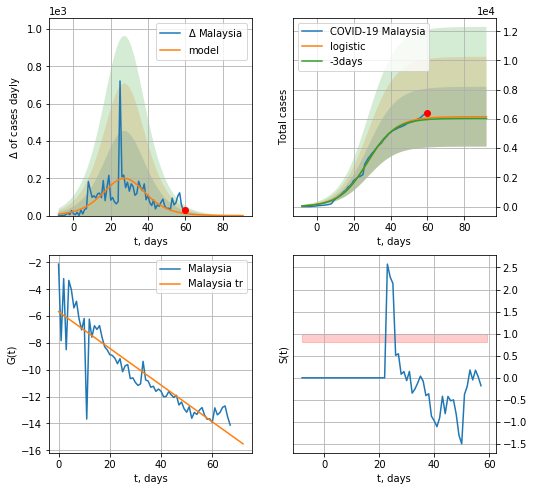

Malaysia data at: 2020-05-05
+3 day model MAPE: 0.01792804228890051
model: logistic
coeffs:  [6.15580017e+03 1.29905327e-01 2.77734951e+01]
rational stdev:  0.33267179896844706
forecast at the end of period: +32 days
	 deltaDaycases:  0
	 total cases:  6154 ± 2047
	 total death:  102 ± 101
trend coefficient of determination: 0.801805
 intercept: -5.665789
 slope: -0.136814


In [223]:
x = forecast('Malaysia',dfML[:],d1,10*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

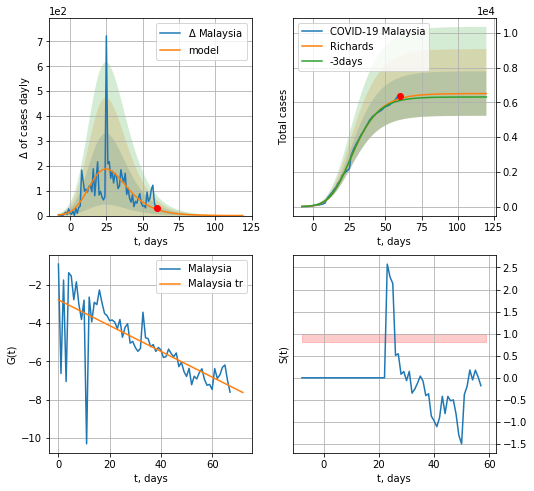

Malaysia data at: 2020-05-05
+3 day model MAPE: 0.018506
model: Richards
coeffs: [6.50321992e+03 3.44138584e-01 9.71164114e+00 2.56009693e-01]
rational stdev: 0.196545
forecast at the end of period: +60 days
	 deltaDaycases: 0
	 total cases: 6501 ± 1277
	 total death: 107 ± 63
trend coefficient of determination: 0.526700
 intercept: -2.789435
 slope: -0.067128


In [224]:
x = forecastRR('Malaysia',dfML[:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


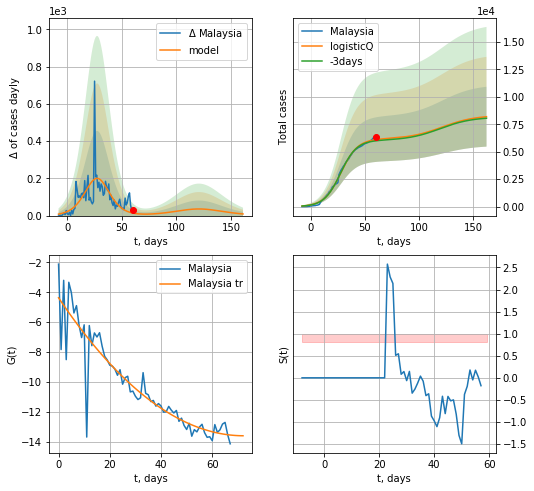

Malaysia data at: 2020-05-05
+3 day model MAPE: 0.017994
model: logisticQ
coeffs: [ 6.15538545e+03  1.62895837e-06  2.77729474e+01 -7.97028248e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.332793
forecast at the end of period: +102 days
	 deltaDaycases: 8
	 total cases: 8194 ± 2727
	 total death: 136 ± 135
trend coefficient of determination: 0.842821
 intercept_: -4.368199965436997
 coeffs_: [ 0.         -0.254797    0.00176108]


In [225]:
x = forecastRRR('Malaysia',dfML[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
          date   cases  active  death
63 2020-05-01  1485.0     202   20.0
64 2020-05-02  1487.0     201   20.0
65 2020-05-03  1487.5     191   20.0
66 2020-05-04  1487.8     164   20.0
67 2020-05-05  1488.0     151   21.0


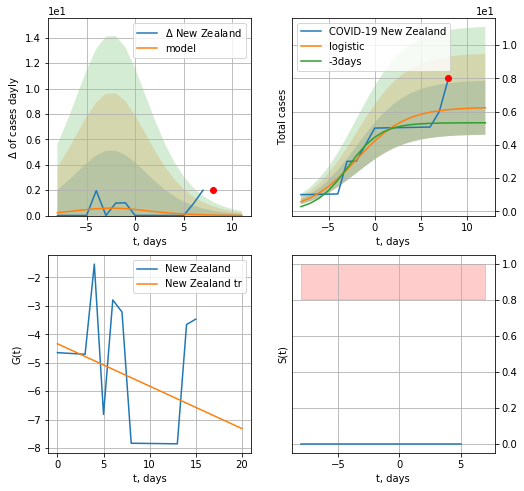

New Zealand data at: 2020-05-05
model: logistic
coeffs:  [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.26005250078288755
forecast at the end of period: +4 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


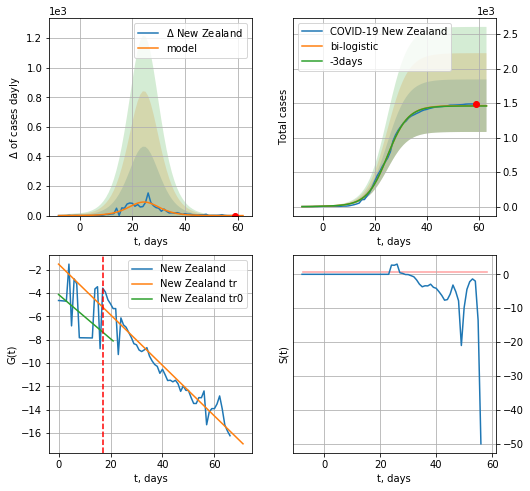

New Zealand data at: 2020-05-05
+3 day model MAPE: 0.0030663242208485136
model: bi-logistic
coeffs:  [1.45640413e+03 2.52889055e-01 2.48875702e+01] [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.26009837590931156
forecast at the end of period: +4 days
	 deltaDaycases:  0
	 total cases:  1462 ± 380
	 total death:  20 ± 15
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.932791
 intercept: -1.530222
 slope: -0.216660


In [226]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
x = forecast('New Zealand',dfZL[:vL],d1,6*7-dT,pMAPE=False)
xx = forecast2('New Zealand',dfZL[:],d1,6*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#

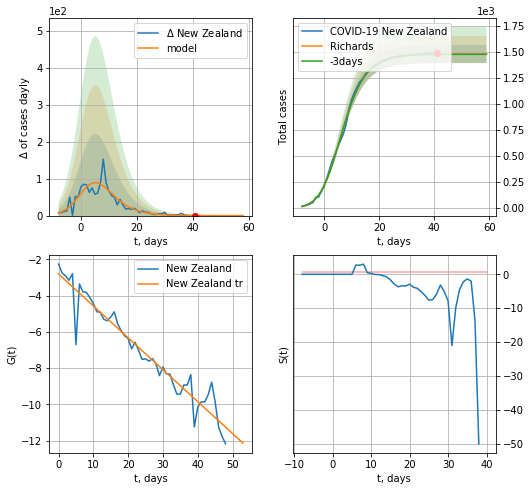

New Zealand data at: 2020-05-05
+3 day model MAPE: 0.002176
model: Richards
coeffs: [1.47704381e+03 4.47720415e-01 1.62333373e+00 4.47339023e-01]
rational stdev: 0.058722
forecast at the end of period: +18 days
	 deltaDaycases: 0
	 total cases: 1477 ± 86
	 total death: 20 ± 3
trend coefficient of determination: 0.928515
 intercept: -2.802269
 slope: -0.176288


In [227]:
x = forecastRR('New Zealand',dfZL[18:],d1,8*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


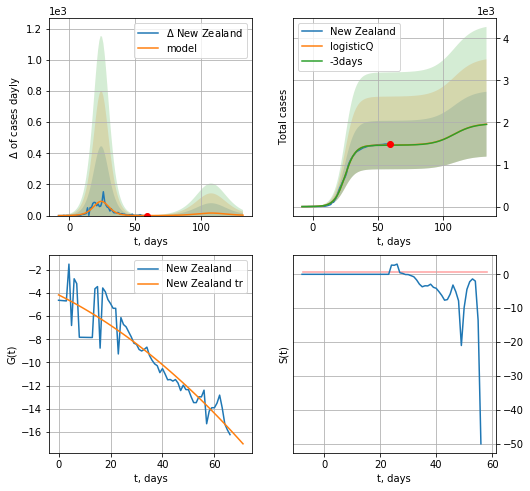

New Zealand data at: 2020-05-05
+3 day model MAPE: 0.003012
model: logisticQ
coeffs: [ 1.46340604e+03  4.13913362e-06  2.48449945e+01 -6.04334750e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.393468
forecast at the end of period: +74 days
	 deltaDaycases: 2
	 total cases: 1959 ± 771
	 total death: 27 ± 31
trend coefficient of determination: 0.859726
 intercept_: -4.180662544708462
 coeffs_: [ 0.         -0.11142835 -0.00097526]


In [228]:
x = forecastRRR('New Zealand',dfZL[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)

BR
          date    cases  active  death
63 2020-05-01  14917.0   11906   93.0
64 2020-05-02  15828.0   12614   97.0
65 2020-05-03  16705.0   13410   99.0
66 2020-05-04  17489.0   14127  103.0
67 2020-05-05  18350.0   14472  107.0


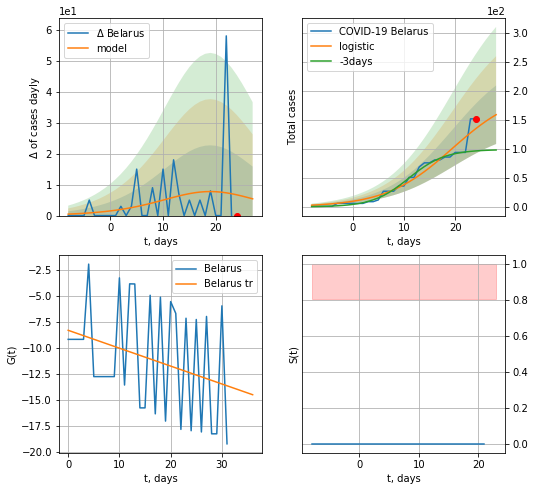

Belarus data at: 2020-05-05
+3 day model MAPE: 0.45662004942481244
model: logistic
coeffs:  [2.01843698e+02 1.53900219e-01 1.94560978e+01]
rational stdev:  0.31755857499649554
forecast at the end of period: +4 days
	 deltaDaycases:  5
	 total cases:  159 ± 50
	 total death:  0 ± 0
trend coefficient of determination: 0.089858
 intercept: -8.339930
 slope: -0.172092


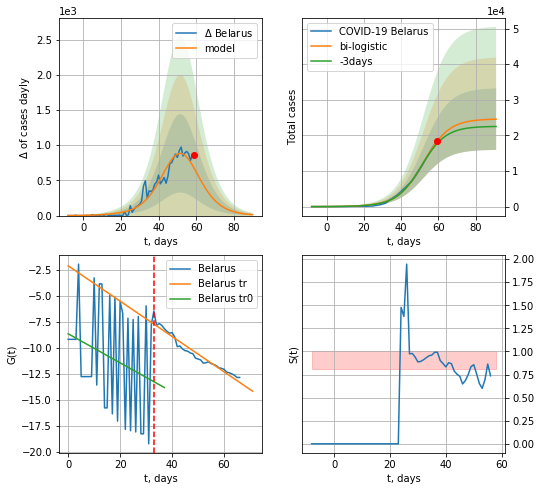

Belarus data at: 2020-05-05
+3 day model MAPE: 0.038942725436663425
model: bi-logistic
coeffs:  [2.44293729e+04 1.44878446e-01 5.20320504e+01] [2.01843698e+02 1.53900219e-01 1.94560978e+01]
rational stdev:  0.35180390287768004
forecast at the end of period: +32 days
	 deltaDaycases:  13
	 total cases:  24545 ± 8635
	 total death:  143 ± 150
bi-logistic approximation splitting point: 33
trend0 coefficient of determination: 0.064228
 intercept: -8.674644
 slope: -0.139700
trend coefficient of determination: 0.945603
 intercept: -2.138020
 slope: -0.169900


In [229]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:33],d1,6*7-dT)
xx = forecast2('Belarus',dfBR[:],d1,10*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=33)

BR
          date    cases  active  death
63 2020-05-01  14917.0   11906   93.0
64 2020-05-02  15828.0   12614   97.0
65 2020-05-03  16705.0   13410   99.0
66 2020-05-04  17489.0   14127  103.0
67 2020-05-05  18350.0   14472  107.0


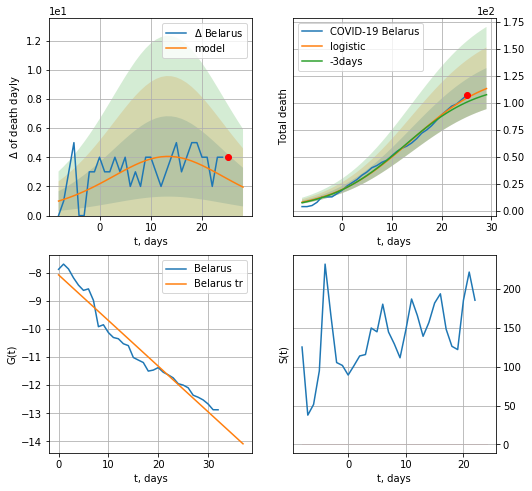

Belarus data at: 2020-05-05
+3 day model MAPE: 0.04147710289154331
model: logistic
coeffs:  [1.30647747e+02 1.24263757e-01 1.38795072e+01]
rational stdev:  0.1679723797879391
forecast at the end of period: +4 days
	 total death:  113 ± 19
trend coefficient of determination: 0.956006
 intercept: -8.067293
 slope: -0.162744


In [230]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[34:],d1,6*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


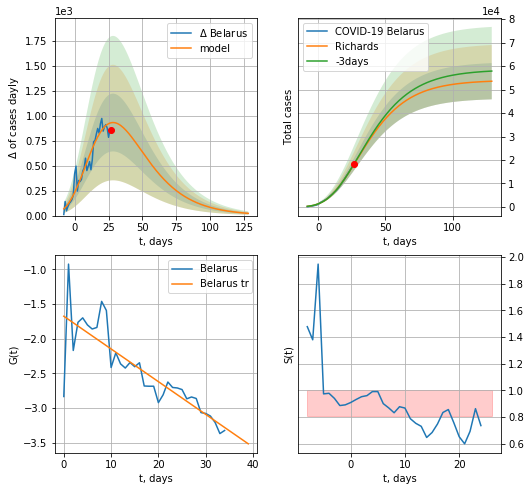

Belarus data at: 2020-05-05
+3 day model MAPE: 0.009253
model: Richards
coeffs: [ 5.40139678e+04  1.76440474e+00 -4.72137634e+01  2.69465594e-02]
rational stdev: 0.144017
forecast at the end of period: +102 days
	 deltaDaycases: 22
	 total cases: 53555 ± 7712
	 total death: 312 ± 134
trend coefficient of determination: 0.711754
 intercept: -1.674570
 slope: -0.047218


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


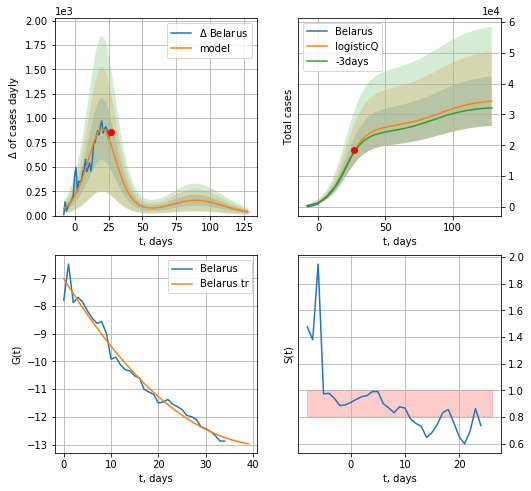

Belarus data at: 2020-05-05
+3 day model MAPE: 0.027175
model: logisticQ
coeffs: [ 2.57560946e+04  6.78856562e-06  2.06113999e+01 -2.01712834e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.233506
forecast at the end of period: +102 days
	 deltaDaycases: 38
	 total cases: 34303 ± 8010
	 total death: 200 ± 140
trend coefficient of determination: 0.976649
 intercept_: -7.007865173266945
 coeffs_: [ 0.         -0.27640168  0.00316475]


In [231]:
x = forecastRR('Belarus',dfBR[32:],d1,20*7-dT)
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


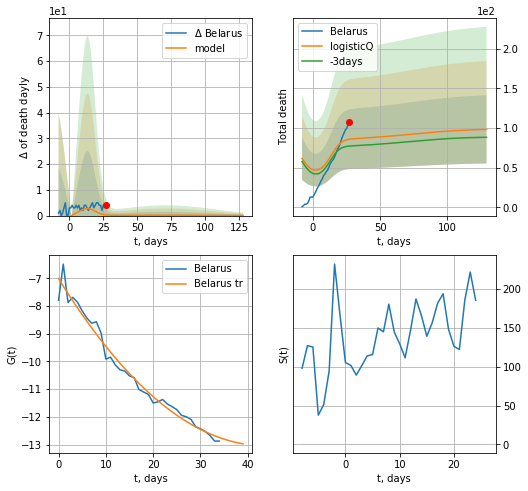

Belarus data at: 2020-05-05
+3 day model MAPE: 0.112578
model: logisticQ
coeffs: [ 7.31715491e+01  8.09675339e-03  5.65974319e+00 -1.30991187e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.437583
forecast at the end of period: +102 days
	 total death: 98 ± 42
trend coefficient of determination: 0.976649
 intercept_: -7.007865173266945
 coeffs_: [ 0.         -0.27640168  0.00316475]


In [232]:
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

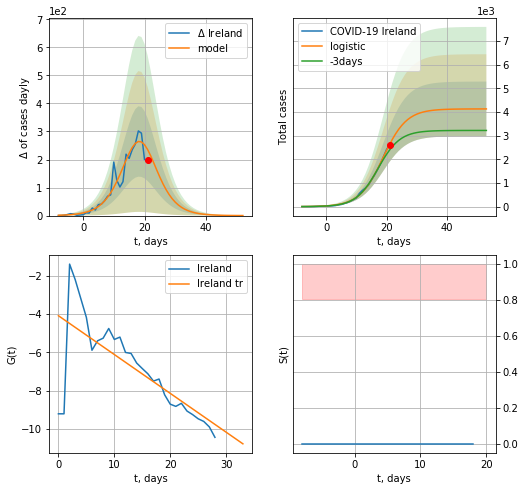

Ireland data at: 2020-05-05
+3 day model MAPE: 0.12282208812559416
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +32 days
	 deltaDaycases:  0
	 total cases:  4126 ± 1154
	 total death:  251 ± 210
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


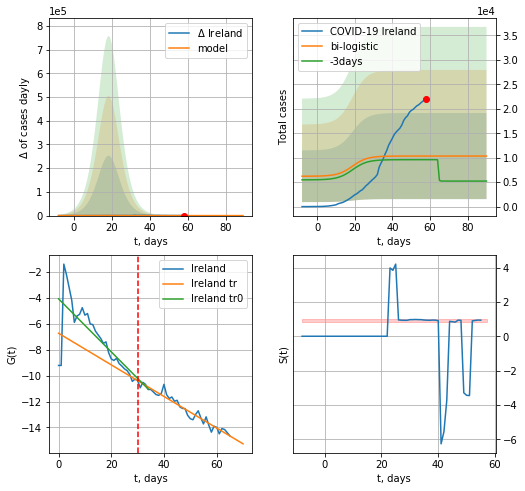

Ireland data at: 2020-05-05
+3 day model MAPE: 0.07727756281819605
model: bi-logistic
coeffs:  [4969.25939719  -10.43342814  144.10515965] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.8514024816281518
forecast at the end of period: +32 days
	 deltaDaycases:  0
	 total cases:  10338 ± 8802
	 total death:  629 ± 1606
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.948291
 intercept: -6.724676
 slope: -0.121946


In [233]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,10*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


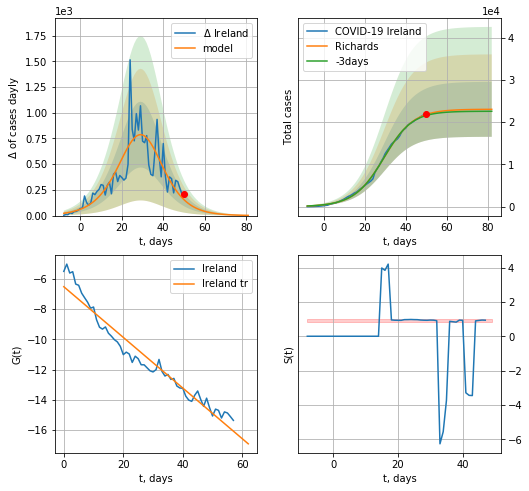

Ireland data at: 2020-05-05
+3 day model MAPE: 0.011660
model: Richards
coeffs: [2.30333437e+04 1.30375493e-01 3.00507476e+01 1.07307205e+00]
rational stdev: 0.282192
forecast at the end of period: +32 days
	 deltaDaycases: 2
	 total cases: 23018 ± 6495
	 total death: 1402 ± 1186
trend coefficient of determination: 0.948052
 intercept: -6.507934
 slope: -0.168077


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp


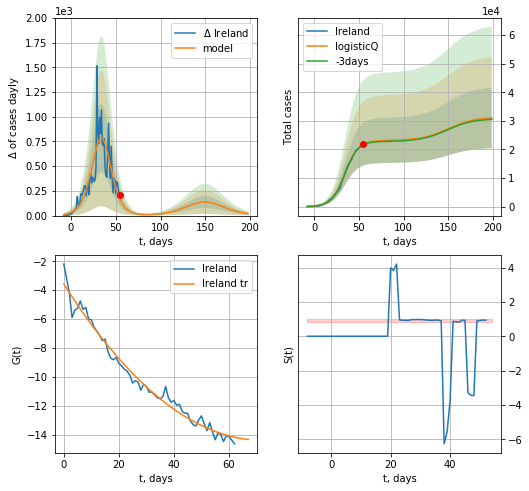

Ireland data at: 2020-05-05
+3 day model MAPE: 0.008841
model: logisticQ
coeffs: [ 2.31429213e+04  3.22806581e-05  3.43995023e+01 -4.16201970e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.341654
forecast at the end of period: +144 days
	 deltaDaycases: 19
	 total cases: 31054 ± 10609
	 total death: 1891 ± 1938
trend coefficient of determination: 0.980139
 intercept_: -3.582015525573837
 coeffs_: [ 0.         -0.29932658  0.00206925]


In [234]:
x = forecastRR('Ireland',dfIR[8:],d1,10*7-dT)
x = forecastRRR('Ireland',dfIR[3:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

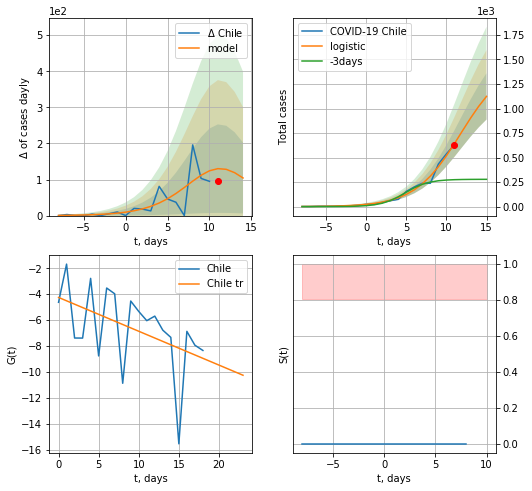

Chile data at: 2020-05-05
+3 day model MAPE: 1.7934705345739388
model: logistic
coeffs:  [1.48202088e+03 3.52936511e-01 1.17607351e+01]
rational stdev:  0.2100967778814968
forecast at the end of period: +4 days
	 deltaDaycases:  104
	 total cases:  1123 ± 236
	 total death:  14 ± 8
trend coefficient of determination: 0.220917
 intercept: -4.249067
 slope: -0.261154


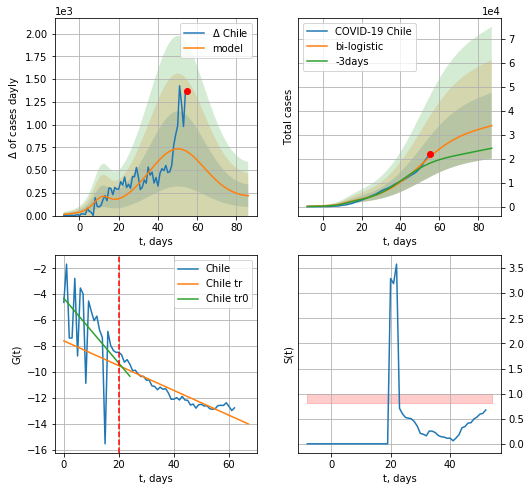

Chile data at: 2020-05-05
+3 day model MAPE: 0.160392306003401
model: bi-logistic
coeffs:  [3.15855235e+04 9.20442070e-02 5.04658273e+01] [1.48202088e+03 3.52936511e-01 1.17607351e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.4068610352419925
forecast at the end of period: +32 days
	 deltaDaycases:  218
	 total cases:  33724 ± 13721
	 total death:  421 ± 513
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.233377
 intercept: -4.310588
 slope: -0.250901
trend coefficient of determination: 0.866381
 intercept: -7.603259
 slope: -0.095678


In [235]:
vL=20
x = forecast('Chile',dfCL[:vL],d1,6*7-dT)
xx = forecast2('Chile',dfCL[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


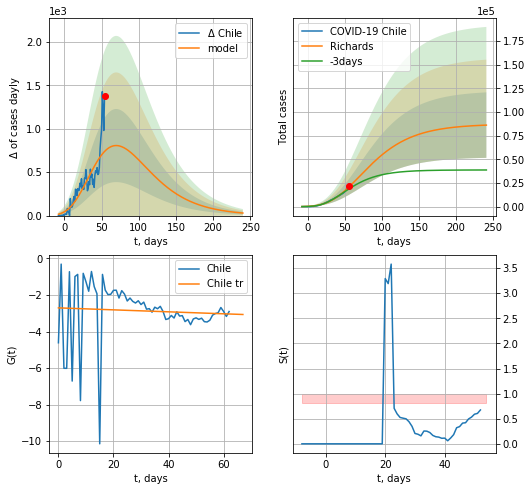

Chile data at: 2020-05-05
+3 day model MAPE: 0.114623
model: Richards
coeffs: [ 8.72260712e+04  1.98252101e+00 -1.02260232e+02  1.27604787e-02]
rational stdev: 0.401683
forecast at the end of period: +186 days
	 deltaDaycases: 29
	 total cases: 86076 ± 34575
	 total death: 1075 ± 1295
trend coefficient of determination: 0.003649
 intercept: -2.704671
 slope: -0.005400


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


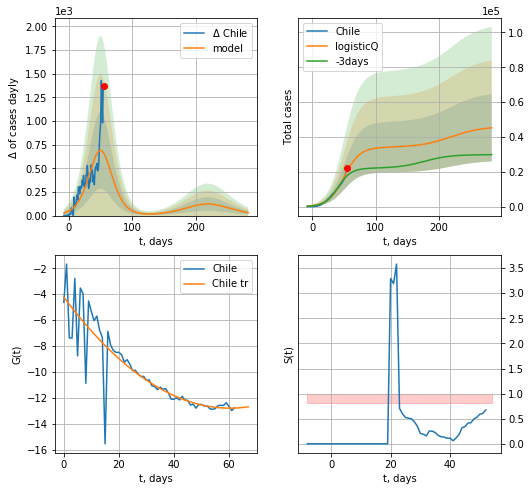

Chile data at: 2020-05-05
+3 day model MAPE: 0.159068
model: logisticQ
coeffs: [ 3.40098492e+04  1.51173087e-06  5.01184228e+01 -5.34279122e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.426699
forecast at the end of period: +228 days
	 deltaDaycases: 31
	 total cases: 45240 ± 19304
	 total death: 565 ± 723
trend coefficient of determination: 0.753943
 intercept_: -4.224801459947761
 coeffs_: [ 0.         -0.28418989  0.00235554]


In [236]:
x = forecastRR('Chile',dfCL[:],d1,32*7-dT)
x = forecastRRR('Chile',dfCL[:],d1,38*7-dT,addpred=True,xcoef=koreaCoeffs)

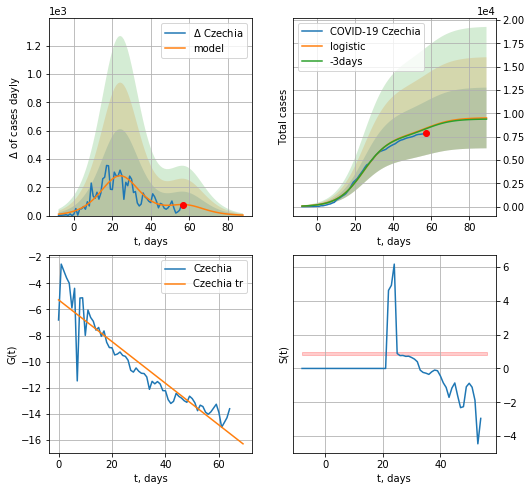

Czechia data at: 2020-05-05
+3 day model MAPE: 0.0071669323927613165
model: logistic
coeffs:  [7.62616364e+03 1.46730735e-01 2.44559474e+01]
scenario coeffs:  [0.25, 1.0, 2.4]
rational stdev:  0.34220147046822275
forecast at the end of period: +32 days
	 deltaDaycases:  3
	 total cases:  9510 ± 3254
	 total death:  309 ± 317
trend coefficient of determination: 0.870587
 intercept: -5.267451
 slope: -0.159724


In [237]:
x = forecast('Czechia',dfCH[:],d1,10*7-dT,shift=1.,addpred=True,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


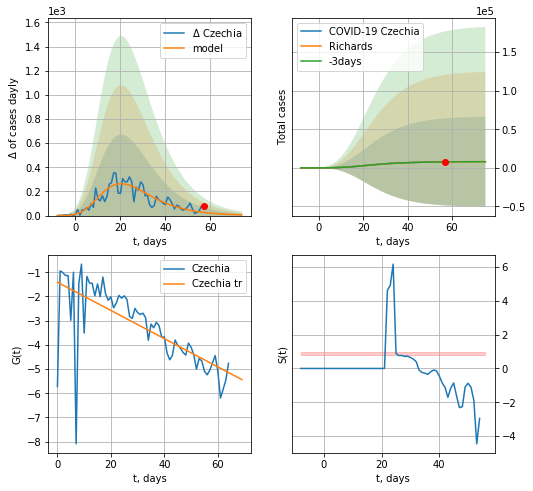

Czechia data at: 2020-05-05
+3 day model MAPE: 0.004078
model: Richards
coeffs: [ 8.10694246e+03  6.10161484e+00 -2.66517534e+01  1.46011443e-02]
rational stdev: 7.240651
forecast at the end of period: +18 days
	 deltaDaycases: 5
	 total cases: 8042 ± 58232
	 total death: 261 ± 5669
trend coefficient of determination: 0.493192
 intercept: -1.412287
 slope: -0.058324


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


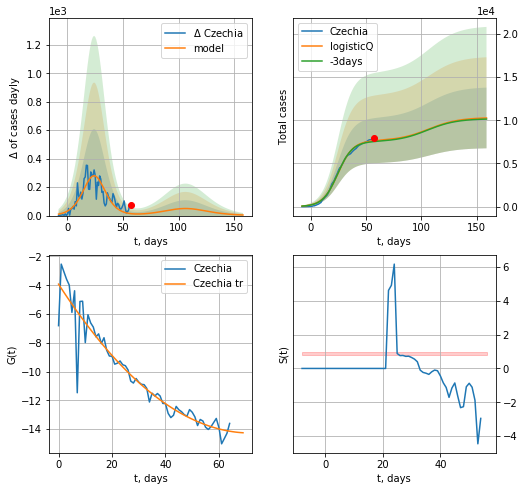

Czechia data at: 2020-05-05
+3 day model MAPE: 0.012582
model: logisticQ
coeffs: [ 7.62594728e+03  1.13373460e-06  2.44560175e+01 -1.29367384e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.342299
forecast at the end of period: +102 days
	 deltaDaycases: 4
	 total cases: 10271 ± 3515
	 total death: 334 ± 342
trend coefficient of determination: 0.909098
 intercept_: -3.9240315000370085
 coeffs_: [ 0.         -0.28769473  0.00199974]


In [238]:
x = forecastRR('Czechia',dfCH[:],d1,8*7-dT)
x = forecastRRR('Czechia',dfCH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

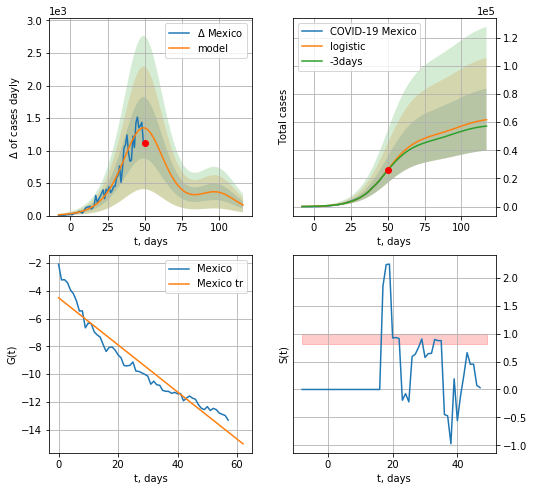

Mexico data at: 2020-05-05
+3 day model MAPE: 0.020240234260541
model: logistic
coeffs:  [5.07585121e+04 1.05812551e-01 4.95160650e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3557395493662819
forecast at the end of period: +67 days
	 deltaDaycases:  162
	 total cases:  61758 ± 21970
	 total death:  5949 ± 6348
trend coefficient of determination: 0.925714
 intercept: -4.500508
 slope: -0.169633


In [239]:
x = forecast('Mexico',dfMX[:],d1,15*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


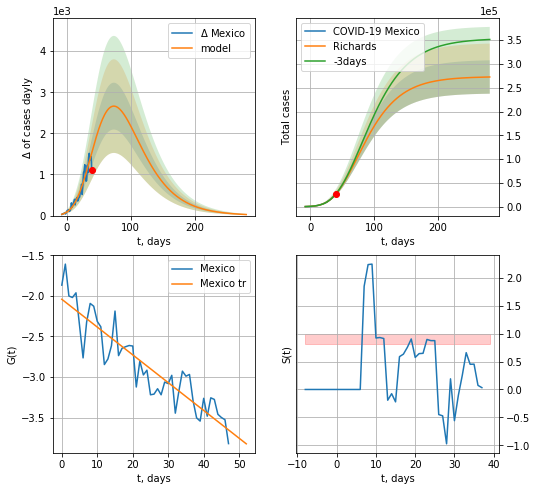

Mexico data at: 2020-05-05
+3 day model MAPE: 0.008837
model: Richards
coeffs: [ 2.73563557e+05  4.12037809e-01 -2.52748644e+01  6.63325252e-02]
rational stdev: 0.128766
forecast at the end of period: +242 days
	 deltaDaycases: 25
	 total cases: 272636 ± 35106
	 total death: 26263 ± 10145
trend coefficient of determination: 0.834676
 intercept: -2.042480
 slope: -0.034235


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


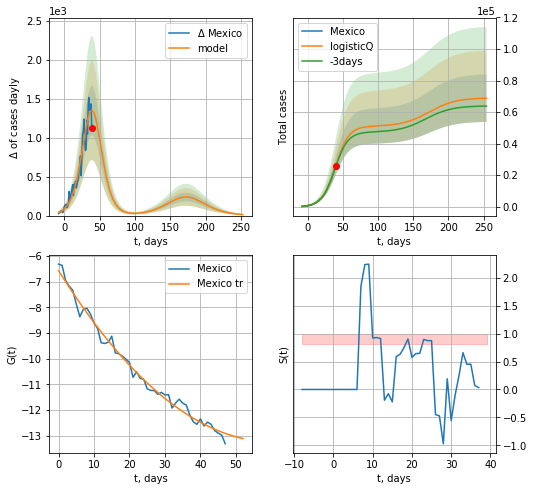

Mexico data at: 2020-05-05
+3 day model MAPE: 0.018581
model: logisticQ
coeffs: [ 5.10052498e+04  1.55215911e-05  3.95975519e+01 -6.77879975e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.218804
forecast at the end of period: +214 days
	 deltaDaycases: 12
	 total cases: 68832 ± 15060
	 total death: 6630 ± 4352
trend coefficient of determination: 0.987975
 intercept_: -6.572806392384744
 coeffs_: [ 0.         -0.22052172  0.00182403]


In [240]:
x = forecastRR('Mexico',dfMX[10:],d1,40*7-dT,addpred=False,xcoef=[.25,1.,2.])#
x = forecastRRR('Mexico',dfMX[10:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)#

LT
          date  cases  active  death     tests
53 2020-05-01   1406     728   45.0  138270.0
54 2020-05-02   1410     727   46.0  141678.0
55 2020-05-03   1419     735   46.1  144029.0
56 2020-05-04   1423     678   46.0  149106.0
57 2020-05-05   1423     699   46.0       NaN


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:478: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

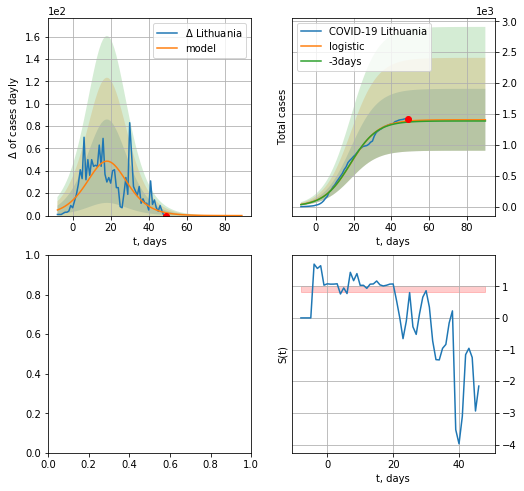

In [241]:
vL = 17
dfLT = read_df(pd.DataFrame(),"LT")
x = forecast('Lithuania',dfLT[:],d1,6*7-1)
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [688]:
#np.diff(dfLT["cases"])

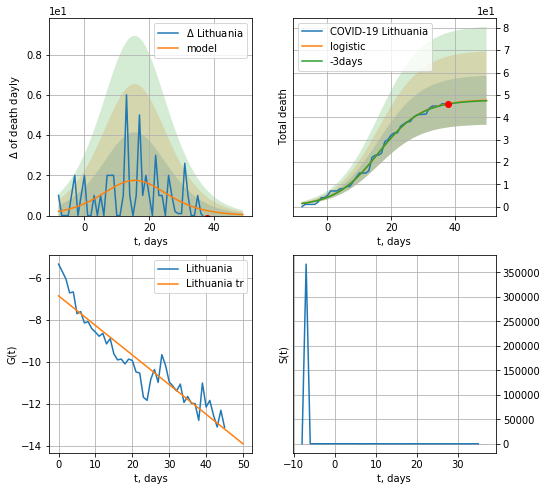

Lithuania data at: 2020-05-04
+3 day model MAPE: 0.004004333972352032
model: logistic
coeffs:  [47.92107226  0.14617652 16.01940865]
rational stdev:  0.2299972810777542
forecast at the end of period: +12 days
	 total death:  47 ± 10
trend coefficient of determination: 0.885619
 intercept: -6.856146
 slope: -0.141263


In [689]:
x = forecast('Lithuania',dfLT[10:],d1,7*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


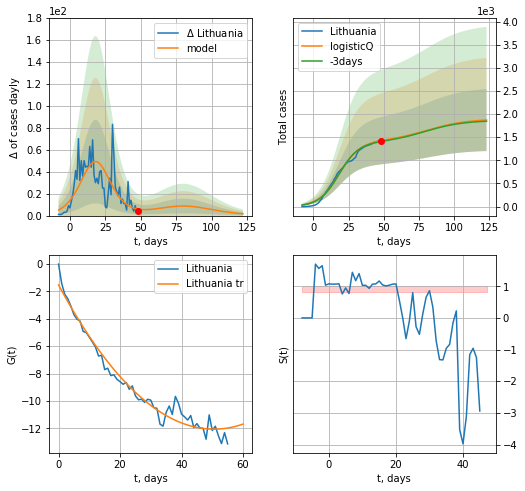

Lithuania data at: 2020-05-04
+3 day model MAPE: 0.012957
model: logisticQ
coeffs: [ 1.40003854e+03  9.08424793e-07  1.84600545e+01 -1.53455362e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.358347
forecast at the end of period: +75 days
	 deltaDaycases: 1
	 total cases: 1872 ± 670
	 total death: 60 ± 64
trend coefficient of determination: 0.968183
 intercept_: -1.519874676099799
 coeffs_: [ 0.         -0.41748067  0.00413237]


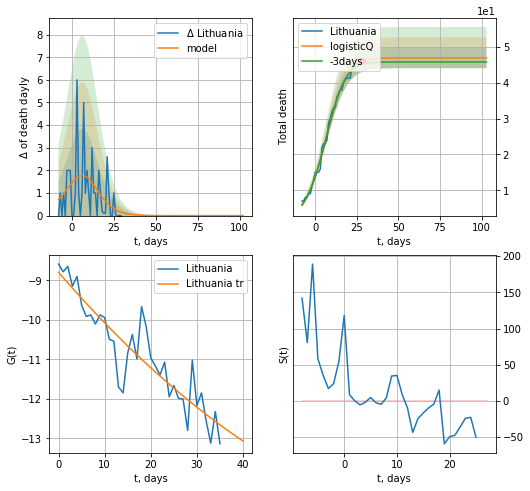

Lithuania data at: 2020-05-04
+3 day model MAPE: 0.016827
model: logisticQ
coeffs: [ 4.69732079e+01  6.70586950e-04  5.86143217e+00 -2.18843043e+02]
rational stdev: 0.061239
forecast at the end of period: +75 days
	 total death: 46 ± 2
trend coefficient of determination: 0.823734
 intercept_: -8.798304973670938
 coeffs_: [ 0.         -0.13470927  0.00070129]


In [690]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
x = forecastRRR('Lithuania',dfLT[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


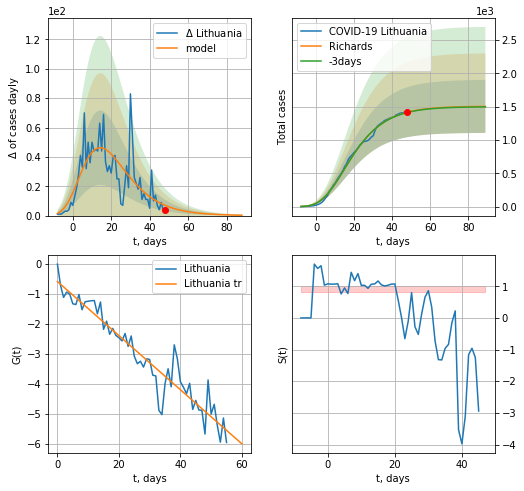

Lithuania data at: 2020-05-04
+3 day model MAPE: 0.003356
model: Richards
coeffs: [ 1.50539456e+03  9.04150925e+00 -4.09913899e+01  9.28453030e-03]
rational stdev: 0.264476
forecast at the end of period: +41 days
	 deltaDaycases: 0
	 total cases: 1502 ± 397
	 total death: 48 ± 38
trend coefficient of determination: 0.908498
 intercept: -0.579530
 slope: -0.090127


In [691]:
x = forecastRR('Lithuania',dfLT[:],d1,6*7-1)
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


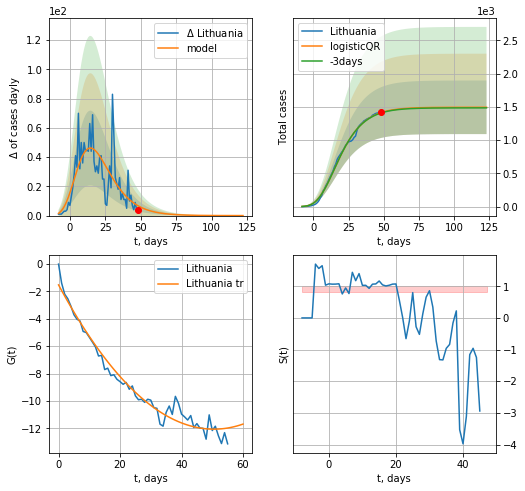

Lithuania data at: 2020-05-04
+3 day model MAPE: 0.004044052770565358
model: logisticQR
coeffs:  [ 1.49502256e+03  4.82069735e-02 -6.84550610e+01 -1.04523337e+03
  1.52714186e-03]
rational stdev:  0.26971961262427513
forecast at the end of period: +75 days
	 deltaDaycases:  0
	 total cases:  1494 ± 403
	 total death:  48 ± 38
trend coefficient of determination: 0.968183
 intercept_: -1.519874676099799
 coeffs_: [ 0.         -0.41748067  0.00413237]


In [692]:
x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
          date   cases  active  death
55 2020-05-01  3802.0     497   92.0
56 2020-05-02  3812.0     402   92.0
57 2020-05-03  3824.0     349   96.0
58 2020-05-04  3828.0     327   96.0
59 2020-05-05  3840.0     332   96.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


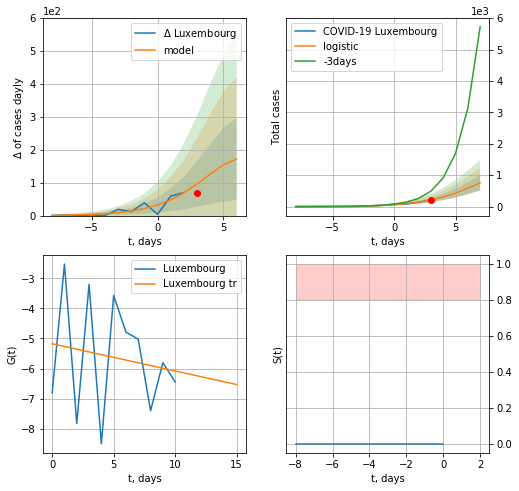

Luxembourg data at: 2020-05-05
model: logistic
coeffs:  [1.56298312e+03 4.51684200e-01 7.13428385e+00]
rational stdev:  0.3215238047871676
forecast at the end of period: +4 days
	 deltaDaycases:  172
	 total cases:  757 ± 243
	 total death:  18 ± 17
trend coefficient of determination: 0.022967
 intercept: -5.176630
 slope: -0.090347


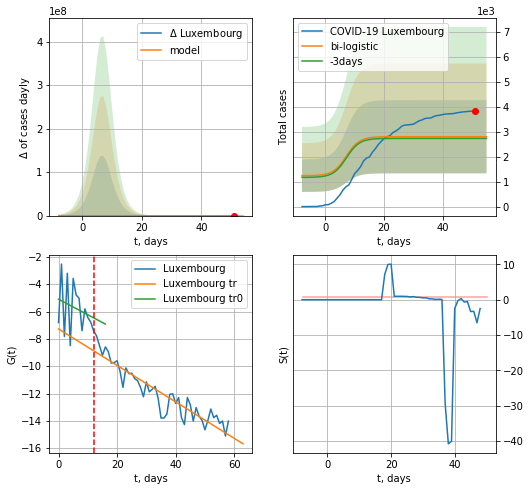

Luxembourg data at: 2020-05-05
+3 day model MAPE: 0.025153519306288126
model: bi-logistic
coeffs:  [1104.9017483    -5.07807695  208.74784202] [1.56298312e+03 4.51684200e-01 7.13428385e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.5231086105019057
forecast at the end of period: +4 days
	 deltaDaycases:  0
	 total cases:  2805 ± 1467
	 total death:  70 ± 109
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.045986
 intercept: -5.098250
 slope: -0.113861
trend coefficient of determination: 0.853905
 intercept: -7.277943
 slope: -0.133398


In [242]:
dfLX = read_df(pd.DataFrame(),"LX")
x = forecast("Luxembourg",dfLX[:12],d1,6*7-dT,pMAPE=False)
xx = forecast2("Luxembourg",dfLX[:],d1,6*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


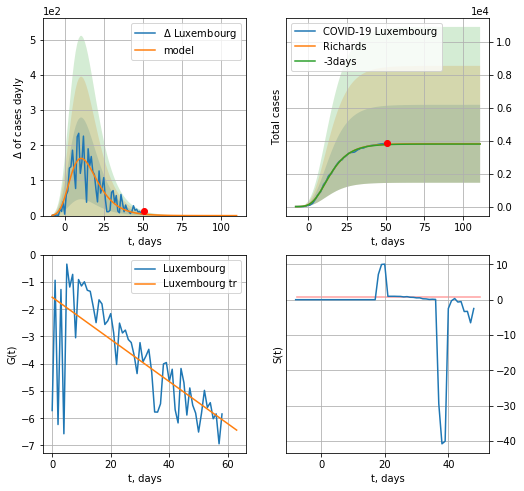

Luxembourg data at: 2020-05-05
+3 day model MAPE: 0.004360
model: Richards
coeffs: [ 3.81022998e+03  1.28216920e+01 -2.92202446e+01  9.10939524e-03]
rational stdev: 0.619855
forecast at the end of period: +60 days
	 deltaDaycases: 0
	 total cases: 3810 ± 2361
	 total death: 95 ± 176
trend coefficient of determination: 0.515977
 intercept: -1.559393
 slope: -0.077399


In [243]:
x = forecastRR("Luxembourg",dfLX[:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


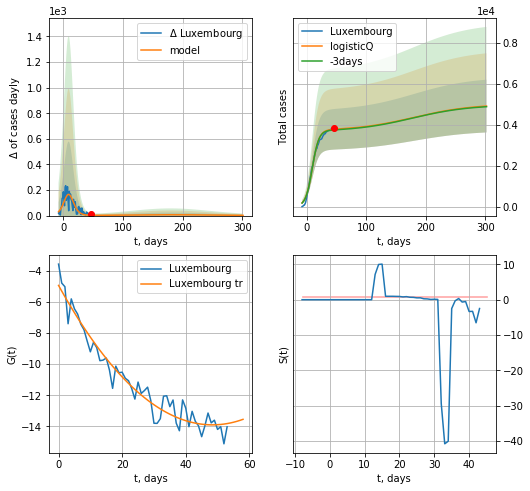

Luxembourg data at: 2020-05-05
+3 day model MAPE: 0.008272
model: logisticQ
coeffs: [ 3.69684494e+03  1.16238712e-06 -1.53927079e+05  9.32129059e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.262011
forecast at the end of period: +256 days
	 deltaDaycases: 1
	 total cases: 4905 ± 1285
	 total death: 122 ± 95
trend coefficient of determination: 0.944288
 intercept_: -4.940352640028236
 coeffs_: [ 0.         -0.3703007   0.00382754]


In [244]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,42*7-dT,addpred=True,xcoef=koreaCoeffs)

ED
          date    cases   active   death
62 2020-05-01  26336.0  23360.0  1063.0
63 2020-05-02  27464.0  23961.0  1371.0
64 2020-05-03  29538.0  24674.0  1564.0
65 2020-05-04  31881.0  26879.0  1569.0
66 2020-05-05  31881.0  26879.0  1569.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:478: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

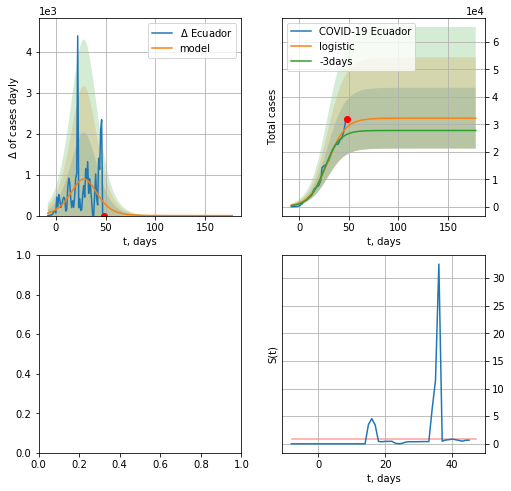

In [245]:
dfED = read_df(pd.DataFrame(),"ED")
x = forecast("Ecuador",dfED[10:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


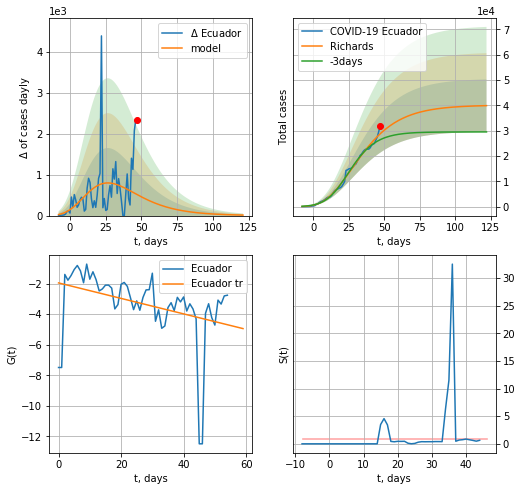

Ecuador data at: 2020-05-04
+3 day model MAPE: 0.095941
model: Richards
coeffs: [ 4.01078564e+04  3.65330437e+00 -5.01397240e+01  1.49337485e-02]
rational stdev: 0.259644
forecast at the end of period: +75 days
	 deltaDaycases: 12
	 total cases: 39884 ± 10355
	 total death: 1962 ± 1528
trend coefficient of determination: 0.129162
 intercept: -1.960703
 slope: -0.050614


In [697]:
x = forecastRR("Ecuador",dfED[10:],d1,16*7-dT,addpred=False,xcoef=[0.35,.5,4.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


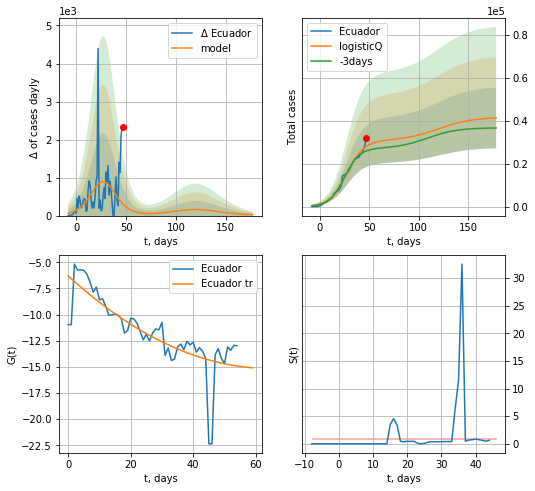

Ecuador data at: 2020-05-04
+3 day model MAPE: 0.085850
model: logisticQ
coeffs: [ 3.07235442e+04  1.55214511e-06  2.75534123e+01 -7.48634821e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.341728
forecast at the end of period: +131 days
	 deltaDaycases: 20
	 total cases: 41248 ± 14095
	 total death: 2030 ± 2081
trend coefficient of determination: 0.624533
 intercept_: -6.297136920890916
 coeffs_: [ 0.         -0.27370308  0.00211128]


In [698]:
x = forecastRRR("Ecuador",dfED[10:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
          date   cases  active  death
66 2020-05-01  5051.0    1833  218.0
67 2020-05-02  5176.0    1956  220.0
68 2020-05-03  5254.0    2024  230.0
69 2020-05-04  5327.0    1587  240.0
70 2020-05-05  5412.0    1666  246.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


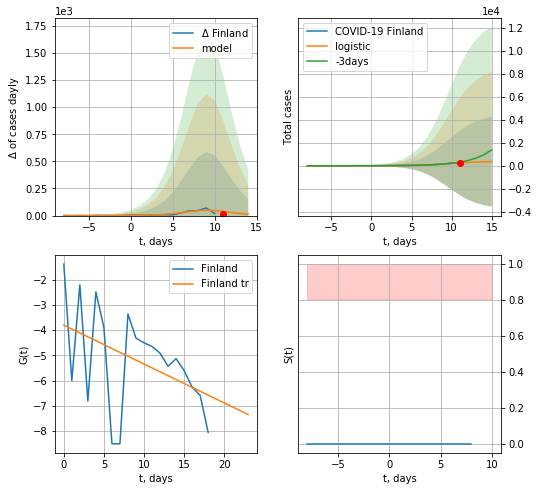

Finland data at: 2020-05-05
+3 day model MAPE: 0.3536794792474036
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +4 days
	 deltaDaycases:  12
	 total cases:  353 ± 3899
	 total death:  16 ± 529
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


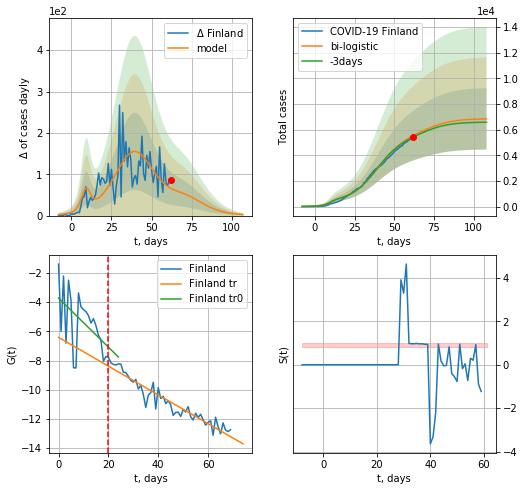

Finland data at: 2020-05-05
+3 day model MAPE: 0.02081942779266965
model: bi-logistic
coeffs:  [5.18757097e+03 1.16859047e-01 3.95922303e+01] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.3493964741356561
forecast at the end of period: +46 days
	 deltaDaycases:  2
	 total cases:  6838 ± 2389
	 total death:  310 ± 324
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.911417
 intercept: -6.410200
 slope: -0.098672


In [246]:
dfFI = read_df(pd.DataFrame(),"FI")
x = forecast("Finland",dfFI[:20],d1,6*7-dT)
xx = forecast2("Finland",dfFI[:],d1,12*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


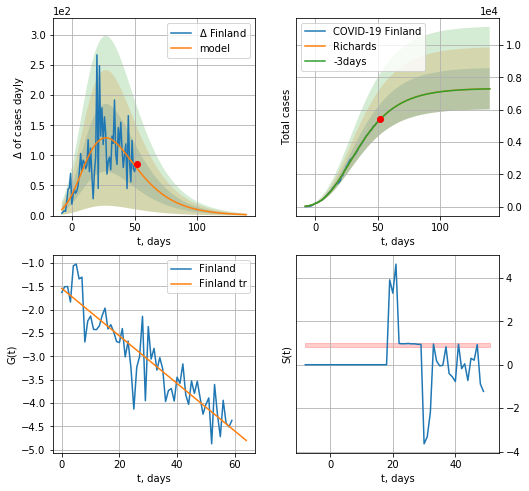

Finland data at: 2020-05-05
+3 day model MAPE: 0.000590
model: Richards
coeffs: [ 7.32855566e+03  1.91168311e+00 -4.81214368e+01  2.53924566e-02]
rational stdev: 0.174650
forecast at the end of period: +88 days
	 deltaDaycases: 1
	 total cases: 7297 ± 1274
	 total death: 331 ± 173
trend coefficient of determination: 0.824490
 intercept: -1.546331
 slope: -0.050852


In [247]:
x = forecastRR("Finland",dfFI[10:],d1,18*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


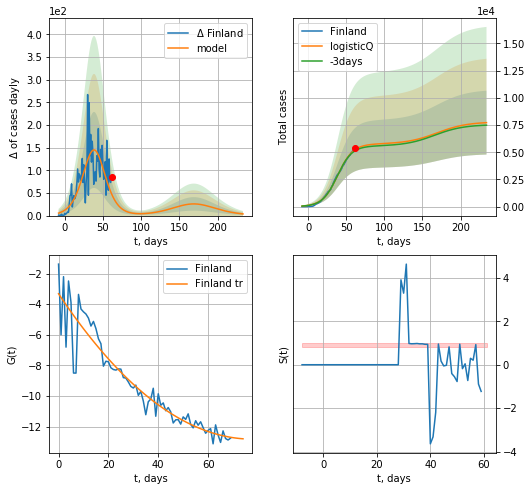

Finland data at: 2020-05-05
+3 day model MAPE: 0.021107
model: logisticQ
coeffs: [ 5.75698833e+03  1.29330238e-06  3.88031161e+01 -7.77353585e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.380006
forecast at the end of period: +172 days
	 deltaDaycases: 3
	 total cases: 7722 ± 2934
	 total death: 351 ± 400
trend coefficient of determination: 0.885911
 intercept_: -3.3211999513875945
 coeffs_: [ 0.         -0.2440381   0.00156815]


In [248]:
x = forecastRRR("Finland",dfFI[:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

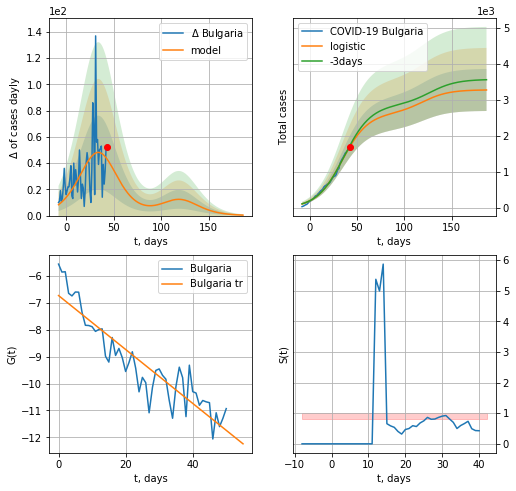

Bulgaria data at: 2020-05-05
+3 day model MAPE: 0.022286086034741834
model: logistic
coeffs:  [2.62838594e+03 7.31984194e-02 3.42119007e+01]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.17799167375912942
forecast at the end of period: +144 days
	 deltaDaycases:  0
	 total cases:  3280 ± 583
	 total death:  154 ± 82
trend coefficient of determination: 0.840083
 intercept: -6.729388
 slope: -0.100170


In [249]:
x = forecast('Bulgaria',dfBL[5:],d1,26*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


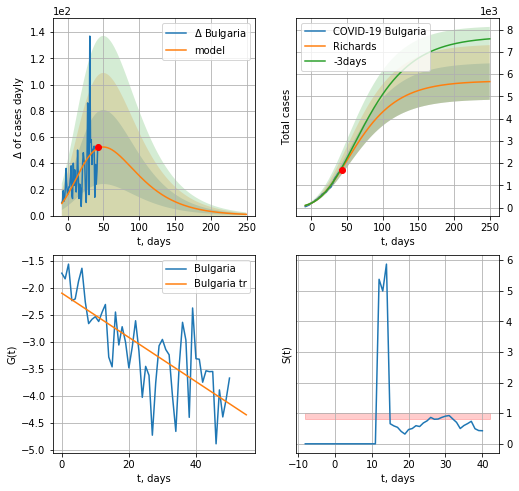

Bulgaria data at: 2020-05-05
+3 day model MAPE: 0.028669
model: Richards
coeffs: [ 5.69655407e+03  1.05611719e+00 -9.73177877e+01  2.39385949e-02]
rational stdev: 0.144800
forecast at the end of period: +207 days
	 deltaDaycases: 0
	 total cases: 5660 ± 819
	 total death: 265 ± 115
trend coefficient of determination: 0.562136
 intercept: -2.093742
 slope: -0.040991


In [250]:
x = forecastRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=False,xcoef=[0.25,1.,4.5])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


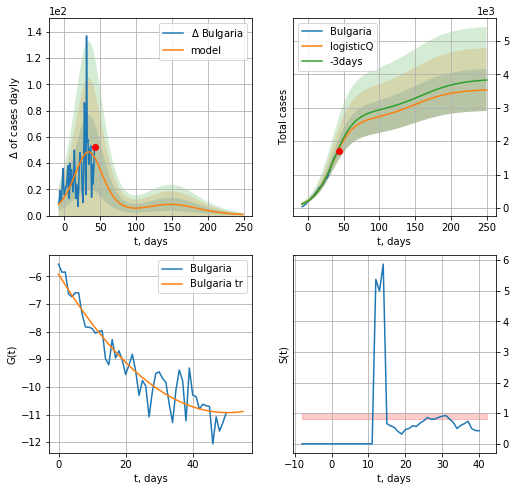

Bulgaria data at: 2020-05-05
+3 day model MAPE: 0.021120
model: logisticQ
coeffs: [ 2.62202223e+03  3.49306334e-06  3.41440818e+01 -2.09671122e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.178159
forecast at the end of period: +207 days
	 deltaDaycases: 0
	 total cases: 3528 ± 628
	 total death: 165 ± 88
trend coefficient of determination: 0.896898
 intercept_: -5.923547076170568
 coeffs_: [ 0.         -0.1988813   0.00197459]


In [251]:
x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
          date  cases  active  death
64 2020-05-01   2966   180.0   54.0
65 2020-05-02   2969   176.0   54.0
66 2020-05-03   2987   193.0   54.0
67 2020-05-04   2988   187.0   54.0
68 2020-05-05   2989   173.0   55.0


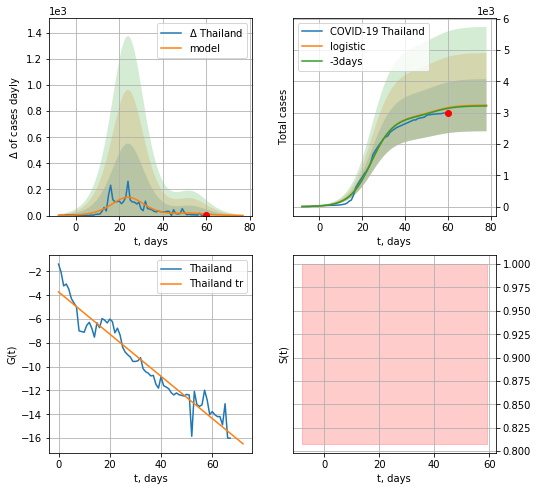

Thailand data at: 2020-05-05
+3 day model MAPE: 0.006653141055129007
model: logistic
coeffs:  [2.88114295e+03 1.95155075e-01 2.44414761e+01]
scenario coeffs:  [0.125, 1.0, 2.2]
rational stdev:  0.25704615662511765
forecast at the end of period: +18 days
	 deltaDaycases:  0
	 total cases:  3238 ± 832
	 total death:  59 ± 45
trend coefficient of determination: 0.931844
 intercept: -3.722373
 slope: -0.177241


In [252]:
dfTH = read_df(pd.DataFrame(),"TH")
x = forecast("Thailand",dfTH[:],d1,8*7-dT,addpred=True,xcoef=[0.25/2,1.,2.2])
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [253]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


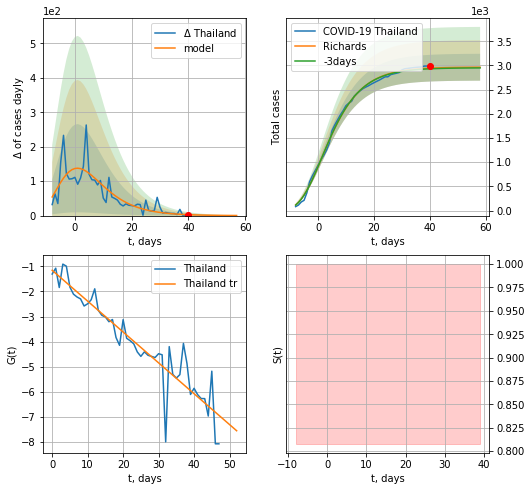

Thailand data at: 2020-05-05
+3 day model MAPE: 0.004442
model: Richards
coeffs: [ 2.96603902e+03  1.61365917e+01 -3.68923691e+01  7.85046178e-03]
rational stdev: 0.093764
forecast at the end of period: +18 days
	 deltaDaycases: 0
	 total cases: 2963 ± 277
	 total death: 54 ± 15
trend coefficient of determination: 0.863879
 intercept: -1.157842
 slope: -0.122827


In [254]:
x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/6,.5,4,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


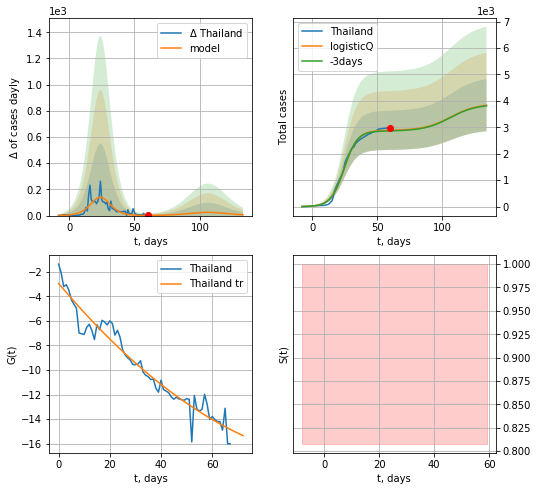

Thailand data at: 2020-05-05
+3 day model MAPE: 0.008282
model: logisticQ
coeffs: [ 2.88093399e+03  1.07214626e-05  2.44430398e+01 -1.81536344e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.257268
forecast at the end of period: +74 days
	 deltaDaycases: 6
	 total cases: 3836 ± 986
	 total death: 70 ± 54
trend coefficient of determination: 0.941848
 intercept_: -2.9530127936950565
 coeffs_: [ 0.         -0.24720233  0.00104434]


In [255]:
x = forecastRRR("Thailand",dfTH[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)

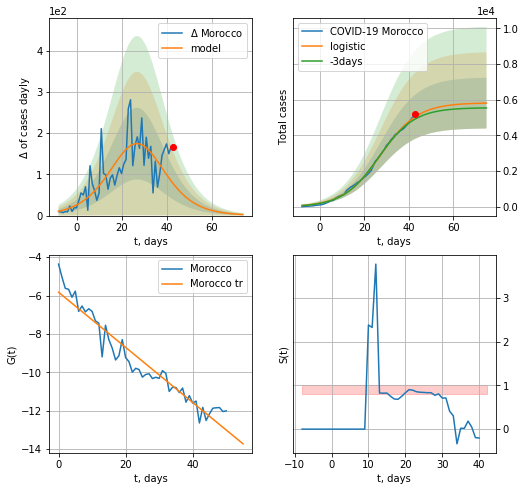

Morocco data at: 2020-05-05
+3 day model MAPE: 0.027624517549517946
model: logistic
coeffs:  [5.83270565e+03 1.19847006e-01 2.73896348e+01]
rational stdev:  0.24466557763751456
forecast at the end of period: +32 days
	 deltaDaycases:  2
	 total cases:  5813 ± 1422
	 total death:  201 ± 147
trend coefficient of determination: 0.926226
 intercept: -5.827499
 slope: -0.143598


In [256]:
x = forecast("Morocco",dfMR[5:],d1,10*7-dT)

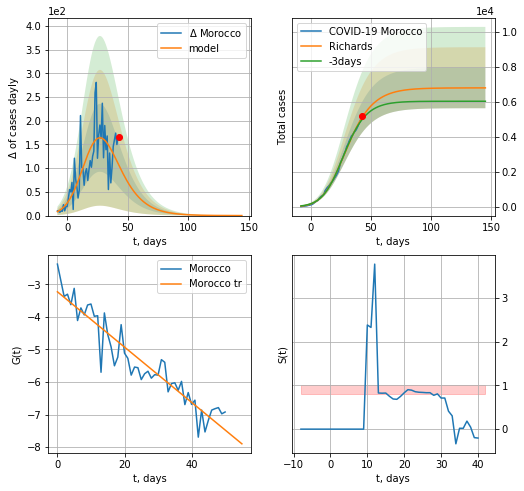

Morocco data at: 2020-05-05
+3 day model MAPE: 0.028086
model: Richards
coeffs: [6.79810863e+03 1.93668643e-01 1.60730602e+01 4.05799172e-01]
rational stdev: 0.170745
forecast at the end of period: +102 days
	 deltaDaycases: 0
	 total cases: 6797 ± 1160
	 total death: 235 ± 120
trend coefficient of determination: 0.889900
 intercept: -3.231557
 slope: -0.084857


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


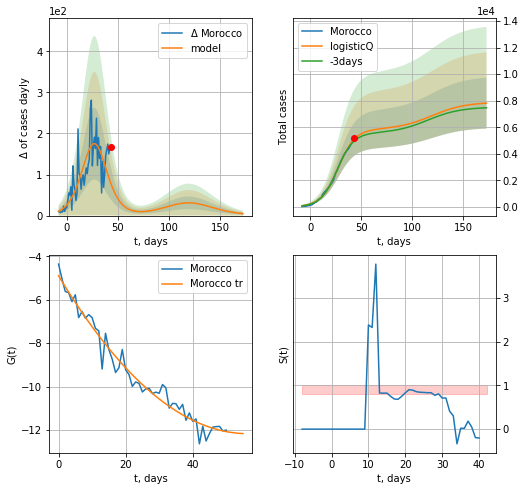

Morocco data at: 2020-05-05
+3 day model MAPE: 0.027593
model: logisticQ
coeffs: [ 5.82831077e+03  5.47334627e-06  2.73768794e+01 -2.18870851e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.245047
forecast at the end of period: +130 days
	 deltaDaycases: 4
	 total cases: 7814 ± 1914
	 total death: 271 ± 199
trend coefficient of determination: 0.966801
 intercept_: -4.898113598088032
 coeffs_: [ 0.         -0.2574484   0.00227747]


In [257]:
x = forecastRR("Morocco",dfMR[5:],d1,20*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1])
x = forecastRRR("Morocco",dfMR[5:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

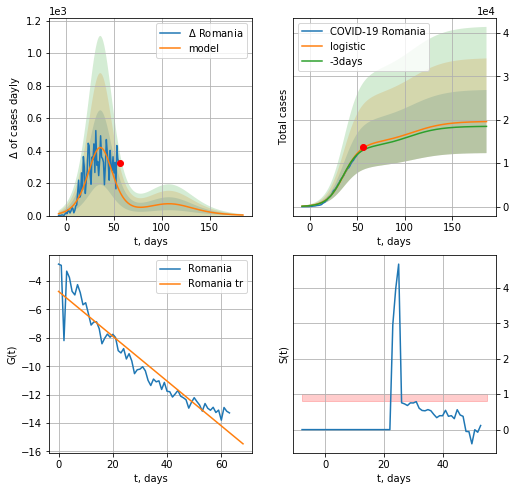

Romania data at: 2020-05-05
+3 day model MAPE: 0.03794242841635012
model: logistic
coeffs:  [1.45429142e+04 1.13972551e-01 3.60683481e+01]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.37107763906552943
forecast at the end of period: +130 days
	 deltaDaycases:  3
	 total cases:  19573 ± 7263
	 total death:  1189 ± 1323
trend coefficient of determination: 0.909857
 intercept: -4.727365
 slope: -0.157868


In [258]:
#dfRM = read_df(pd.DataFrame(),"RM")
x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


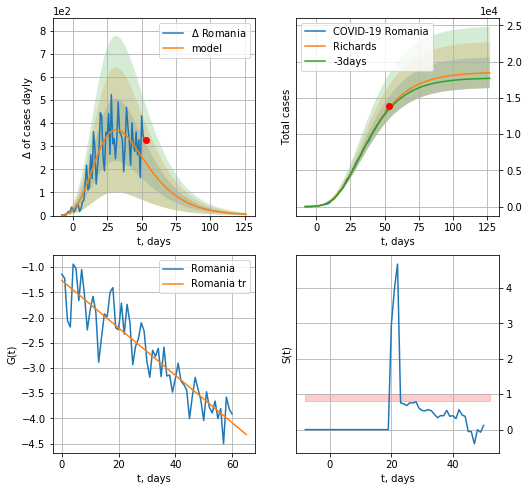

Romania data at: 2020-05-05
+3 day model MAPE: 0.015350
model: Richards
coeffs: [ 1.85642485e+04  3.25795336e+00 -4.25711681e+01  1.68286168e-02]
rational stdev: 0.114486
forecast at the end of period: +74 days
	 deltaDaycases: 5
	 total cases: 18463 ± 2113
	 total death: 1122 ± 385
trend coefficient of determination: 0.840805
 intercept: -1.263407
 slope: -0.047039


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


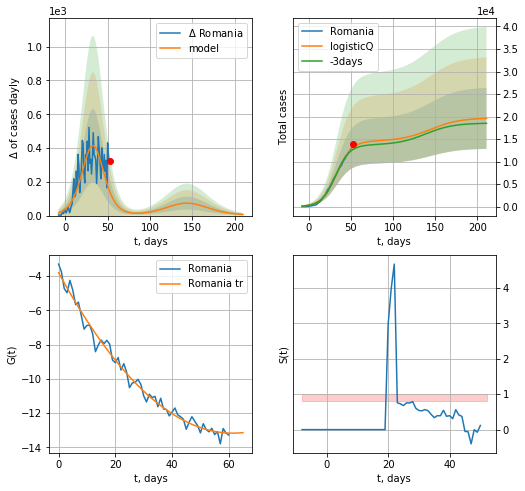

Romania data at: 2020-05-05
+3 day model MAPE: 0.038583
model: logisticQ
coeffs: [ 1.45486535e+04  1.45284262e-06  3.30782059e+01 -7.83245888e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.345679
forecast at the end of period: +158 days
	 deltaDaycases: 6
	 total cases: 19591 ± 6772
	 total death: 1190 ± 1234
trend coefficient of determination: 0.985534
 intercept_: -3.7941445659123216
 coeffs_: [ 0.         -0.30547596  0.00248659]


In [259]:
x = forecastRR("Romania",dfRM[8:],d1,16*7-dT)
xx = forecastRRR("Romania",dfRM[8:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

In [260]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
          date    cases  active     death
83 2020-05-01  1022788  447423  105770.0
84 2020-05-02  1031728  444169  107059.0
85 2020-05-03  1038173  444491  107861.0
86 2020-05-04  1044364  435371  108980.0
87 2020-05-05  1052341  434135  110111.0


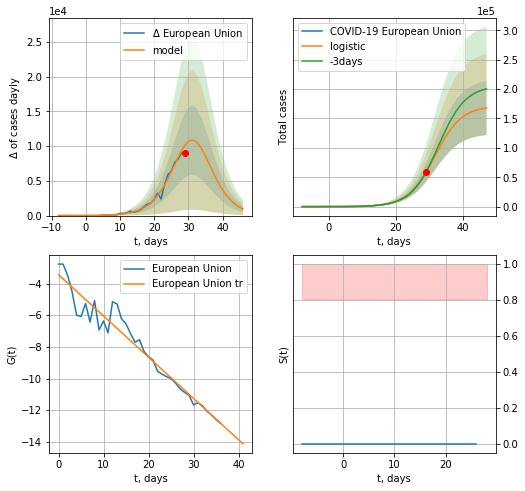

European Union data at: 2020-05-05
+3 day model MAPE: 0.026654473576493115
model: logistic
coeffs:  [1.71206811e+05 2.54019570e-01 3.15968250e+01]
rational stdev:  0.2741183518342743
forecast at the end of period: +18 days
	 deltaDaycases:  945
	 total cases:  167852 ± 46011
	 total death:  17563 ± 14443
trend coefficient of determination: 0.946316
 intercept: -3.442935
 slope: -0.260531


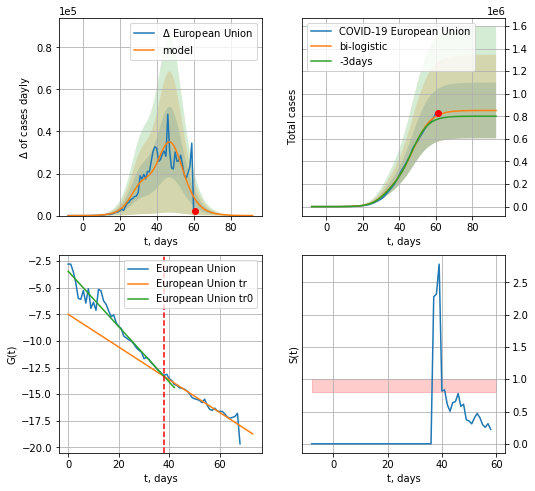

European Union data at: 2020-05-05
+3 day model MAPE: 0.04651829112234155
model: bi-logistic
coeffs:  [6.80547246e+05 2.01837730e-01 4.76694046e+01] [1.71206811e+05 2.54019570e-01 3.15968250e+01]
rational stdev:  0.28952183224371997
forecast at the end of period: +32 days
	 deltaDaycases:  16
	 total cases:  851681 ± 246580
	 total death:  89115 ± 77402
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.950267
 intercept: -3.442010
 slope: -0.260608
trend coefficient of determination: 0.919561
 intercept: -7.491452
 slope: -0.154009


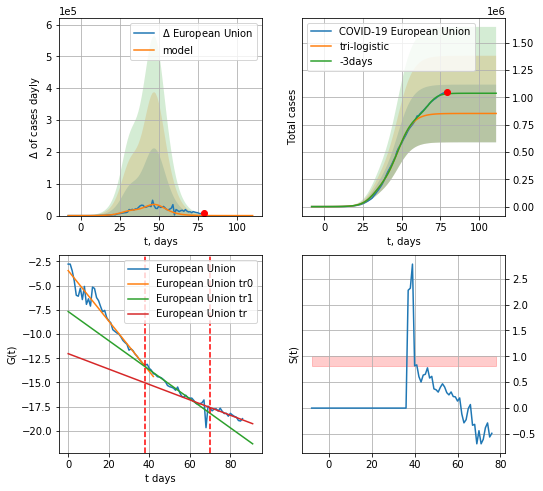

European Union data at: 2020-05-05
+3 day model MAPE: 0.1758649115516103
model: tri-logistic
coeffs:  [ 3.01407041e+04 -8.52153425e-01 -2.00828180e+01] [1.71206811e+05 2.54019570e-01 3.15968250e+01 6.80547246e+05
 2.01837730e-01 4.76694046e+01]
forecast rational stdev:  0.309700623112481
forecast at the end of period: +32 days
	 deltaDaycases:  0
	 total cases:  851752 ± 263788
	 total death:  89122 ± 82803
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.950267
 intercept: -3.442010
 slope: -0.260608
trend1 coefficient of determination: 0.917498
 intercept: -7.673048
 slope: -0.150226
trend coefficient of determination: 0.865299
 intercept: -12.028561
 slope: -0.079516


In [261]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,8*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,10*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,10*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


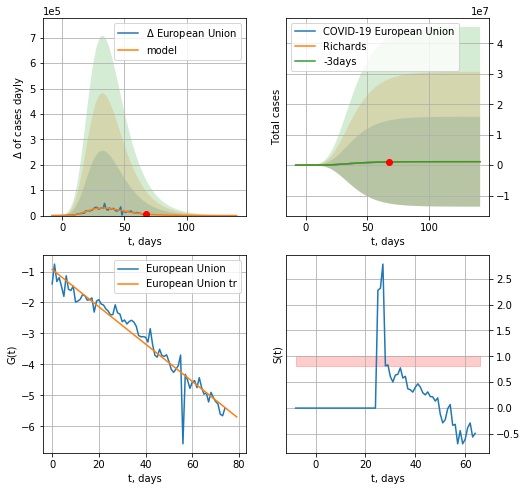

European Union data at: 2020-05-05
+3 day model MAPE: 0.003649
model: Richards
coeffs: [ 1.13726810e+06  1.92416722e+00 -1.19098195e+01  3.79471269e-02]
rational stdev: 12.987103
forecast at the end of period: +74 days
	 deltaDaycases: 32
	 total cases: 1136843 ± 14764306
	 total death: 118952 ± 4634525
trend coefficient of determination: 0.932541
 intercept: -0.934821
 slope: -0.060204


In [262]:
x = forecastRR("European Union",dfEU[12:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


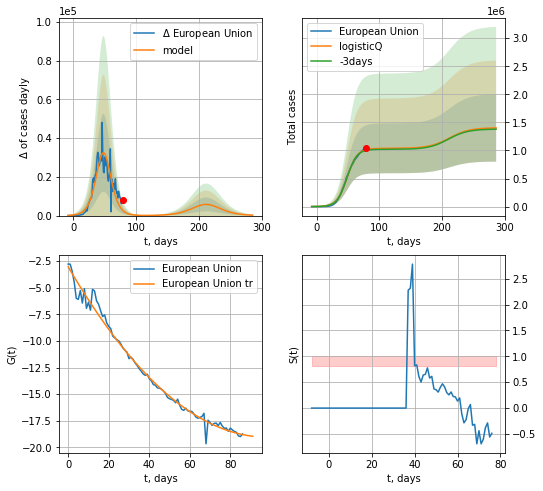

European Union data at: 2020-05-05
+3 day model MAPE: 0.014295
model: logisticQ
coeffs: [ 1.03771034e+06  1.11115334e-06  4.85133590e+01 -1.12604034e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.427899
forecast at the end of period: +207 days
	 deltaDaycases: 214
	 total cases: 1401902 ± 599872
	 total death: 146687 ± 188301
trend coefficient of determination: 0.987108
 intercept_: -3.0249849057464147
 coeffs_: [ 0.         -0.32721308  0.00167164]


In [263]:
x = forecastRRR("European Union",dfEU[:],d1,35*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


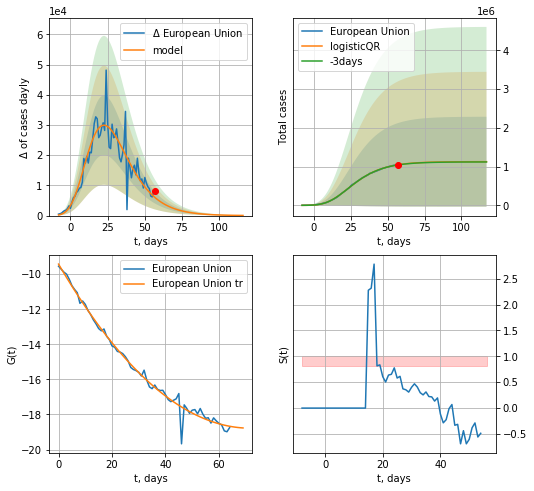

European Union data at: 2020-05-05
+3 day model MAPE: 0.0033722909142945927
model: logisticQR
coeffs:  [ 1.12708614e+06  1.95782804e-02 -6.07566453e+01 -7.37533536e+02
  4.38026152e-03]
rational stdev:  1.028907713801675
forecast at the end of period: +60 days
	 deltaDaycases:  52
	 total cases:  1126519 ± 1159085
	 total death:  117872 ± 363838
trend coefficient of determination: 0.987056
 intercept_: -9.428126473631927
 coeffs_: [ 0.         -0.26051376  0.00181354]


In [264]:
x = forecastQR("European Union",dfEU[22:],d1,14*7-dT,addpred=False,xcoef=[0.35,.5,2.5,1.,1])

In [722]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [723]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [724]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [725]:
#dfIC[:]

IC
          date    cases  active  death
61 2020-05-01  1798.00      99  10.05
62 2020-05-02  1798.01      82  10.06
63 2020-05-03  1799.00      72  10.00
64 2020-05-04  1799.50      66  10.00
65 2020-05-05  1799.70      56  10.00


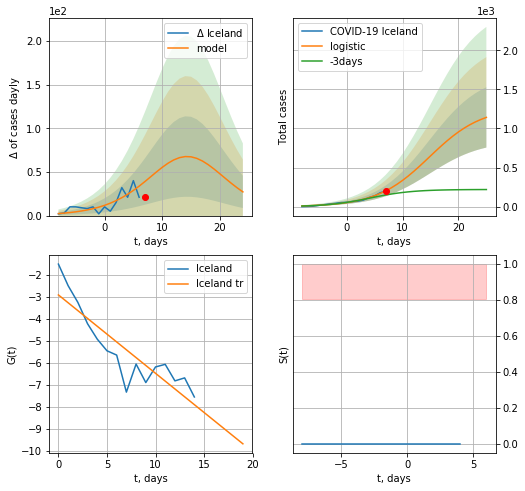

Iceland data at: 2020-05-05
+3 day model MAPE: 0.49229543132944575
model: logistic
coeffs:  [1.27194861e+03 2.12945173e-01 1.48141483e+01]
rational stdev:  0.3377978270267634
forecast at the end of period: +18 days
	 deltaDaycases:  27
	 total cases:  1141 ± 385
	 total death:  6 ± 6
trend coefficient of determination: 0.778766
 intercept: -2.904405
 slope: -0.356109


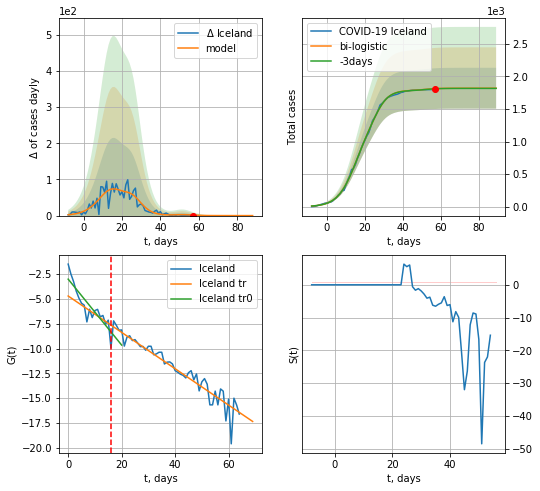

Iceland data at: 2020-05-05
+3 day model MAPE: 0.0013430044738172366
model: bi-logistic
coeffs:  [5.15150562e+02 2.89758740e-01 2.60888179e+01] [1.27194861e+03 2.12945173e-01 1.48141483e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.17251652804449166
forecast at the end of period: +32 days
	 deltaDaycases:  0
	 total cases:  1819 ± 313
	 total death:  10 ± 5
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.772657
 intercept: -3.017482
 slope: -0.331878
trend coefficient of determination: 0.896482
 intercept: -4.714193
 slope: -0.183017


In [266]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
x = forecast("Iceland",dfIC[:vL],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
xx = forecast2("Iceland",dfIC[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


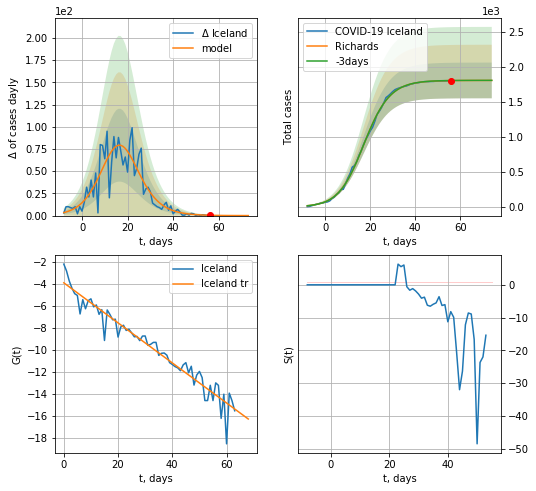

Iceland data at: 2020-05-05
+3 day model MAPE: 0.000574
model: Richards
coeffs: [1.80664071e+03 1.96329707e-01 1.60140797e+01 8.56236679e-01]
rational stdev: 0.141183
forecast at the end of period: +18 days
	 deltaDaycases: 0
	 total cases: 1806 ± 255
	 total death: 10 ± 4
trend coefficient of determination: 0.937183
 intercept: -3.923109
 slope: -0.181532


In [267]:
x = forecastRR("Iceland",dfIC[1:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


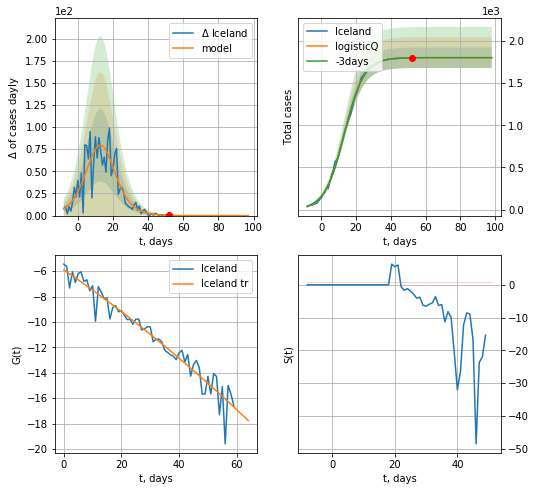

Iceland data at: 2020-05-05
+3 day model MAPE: 0.000031
model: logisticQ
coeffs: [ 1.80193666e+03  1.00058419e-05  1.33192615e+01 -1.77083026e+04]
rational stdev: 0.067503
forecast at the end of period: +46 days
	 deltaDaycases: 0
	 total cases: 1801 ± 121
	 total death: 10 ± 2
trend coefficient of determination: 0.937901
 intercept_: -5.895724721284179
 coeffs_: [ 0.         -0.15497627 -0.00047576]


In [268]:
x = forecastRRR("Iceland",dfIC[5:],d1,12*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

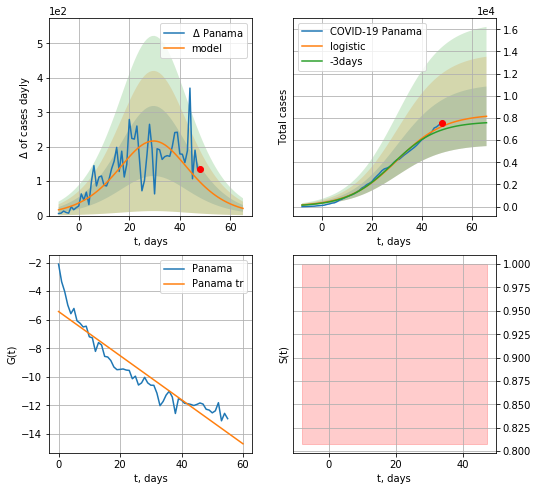

Panama data at: 2020-05-05
+3 day model MAPE: 0.047492022695570305
model: logistic
coeffs:  [8.34344295e+03 1.03854565e-01 3.01017673e+01]
rational stdev:  0.32990968223899164
forecast at the end of period: +18 days
	 deltaDaycases:  20
	 total cases:  8147 ± 2687
	 total death:  227 ± 224
trend coefficient of determination: 0.879276
 intercept: -5.426314
 slope: -0.154630


In [269]:
#dfPM = read_df(pd.DataFrame(),"PM")
x = forecast("Panama",dfPM[:],d1,8*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


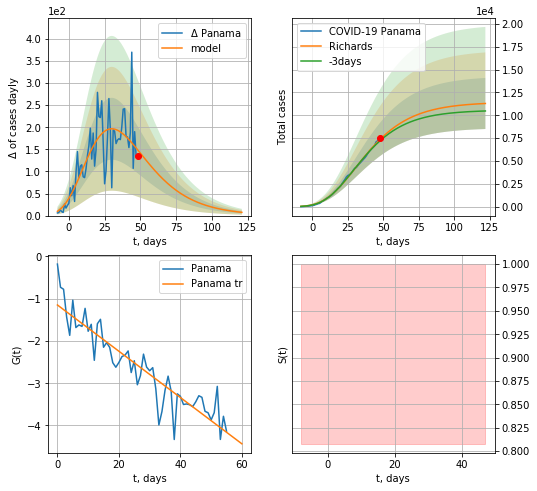

Panama data at: 2020-05-05
+3 day model MAPE: 0.022410
model: Richards
coeffs: [ 1.14468856e+04  3.42401837e+00 -6.07925001e+01  1.37259390e-02]
rational stdev: 0.247484
forecast at the end of period: +74 days
	 deltaDaycases: 7
	 total cases: 11292 ± 2794
	 total death: 315 ± 233
trend coefficient of determination: 0.844640
 intercept: -1.147973
 slope: -0.054769


In [270]:
x = forecastRR("Panama",dfPM[:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


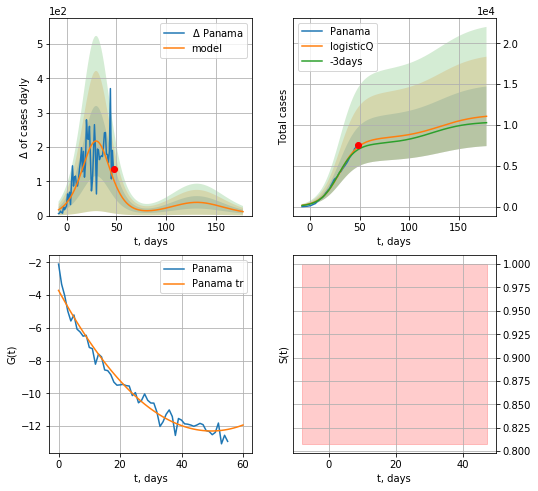

Panama data at: 2020-05-05
+3 day model MAPE: 0.046886
model: logisticQ
coeffs: [ 8.34114604e+03  1.30289843e-06  3.00962600e+01 -7.96890486e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.329965
forecast at the end of period: +130 days
	 deltaDaycases: 11
	 total cases: 11059 ± 3649
	 total death: 308 ± 304
trend coefficient of determination: 0.972391
 intercept_: -3.7062667670551726
 coeffs_: [ 0.         -0.34579522  0.00347616]


In [271]:
x = forecastRRR("Panama",dfPM[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

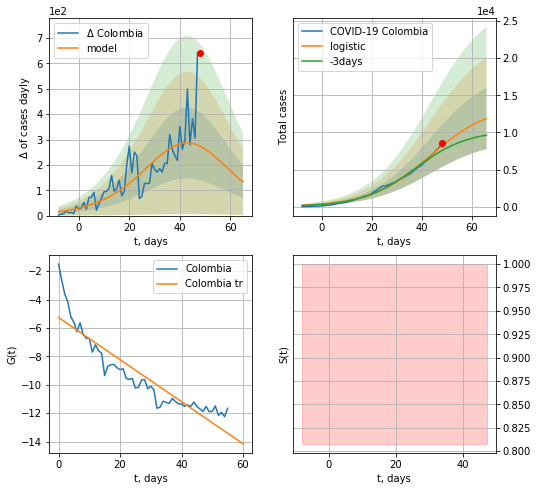

Colombia data at: 2020-05-05
+3 day model MAPE: 0.0902443908249396
model: logistic
coeffs:  [1.36111322e+04 8.43025939e-02 4.33145340e+01]
rational stdev:  0.34733509969661147
forecast at the end of period: +18 days
	 deltaDaycases:  132
	 total cases:  11859 ± 4119
	 total death:  520 ± 541
trend coefficient of determination: 0.840514
 intercept: -5.265816
 slope: -0.148228


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


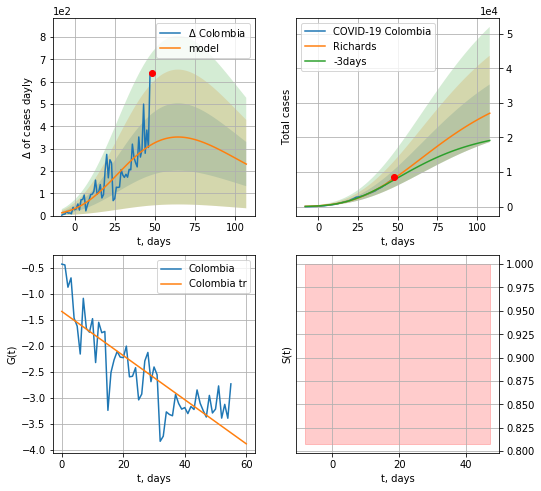

Colombia data at: 2020-05-05
+3 day model MAPE: 0.059007
model: Richards
coeffs: [ 3.76384110e+04  1.75951078e+00 -1.00387568e+02  1.45436810e-02]
rational stdev: 0.308111
forecast at the end of period: +60 days
	 deltaDaycases: 230
	 total cases: 27021 ± 8325
	 total death: 1185 ± 1095
trend coefficient of determination: 0.685929
 intercept: -1.334359
 slope: -0.042553


In [272]:
x = forecast("Colombia",dfCB[:],d1,8*7-dT)
x = forecastRR("Colombia",dfCB[:],d1,14*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


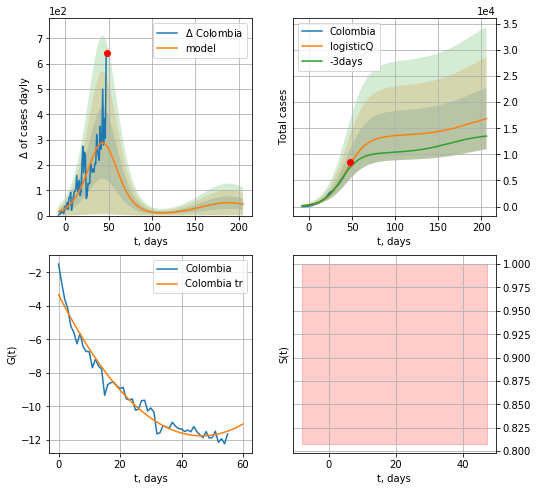

Colombia data at: 2020-05-05
+3 day model MAPE: 0.089662
model: logisticQ
coeffs: [ 1.35842621e+04  2.47687146e-06  4.32670729e+01 -3.40381414e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.347352
forecast at the end of period: +158 days
	 deltaDaycases: 44
	 total cases: 16840 ± 5849
	 total death: 739 ± 770
trend coefficient of determination: 0.962117
 intercept_: -3.3383319076186275
 coeffs_: [ 0.         -0.36244383  0.00389528]


In [273]:
x = forecastRRR("Colombia",dfCB[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
          date   cases  active  death
58 2020-05-01  4154.0  1880.0  453.0
59 2020-05-02  4295.0  1964.0  459.0
60 2020-05-03  4474.0  2075.0  463.0
61 2020-05-04  4648.0  2185.0  465.0
62 2020-05-05  4838.0  2301.0  470.0


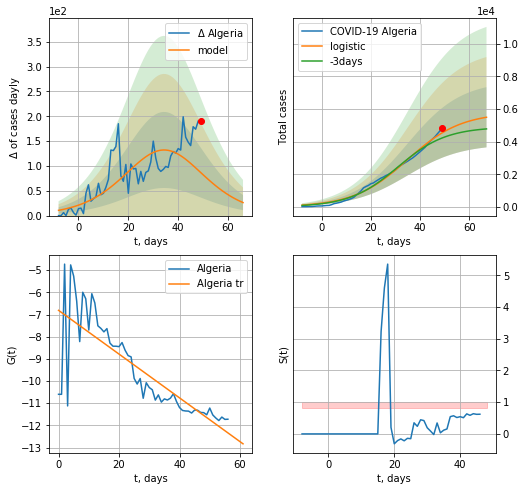

Algeria data at: 2020-05-05
+3 day model MAPE: 0.08031360596708134
model: logistic
coeffs:  [5.78311865e+03 9.14424386e-02 3.48254617e+01]
rational stdev:  0.335889752246097
forecast at the end of period: +18 days
	 deltaDaycases:  26
	 total cases:  5493 ± 1845
	 total death:  533 ± 537
trend coefficient of determination: 0.648540
 intercept: -6.811774
 slope: -0.098669


In [274]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,8*7-dT)
#dfAG

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


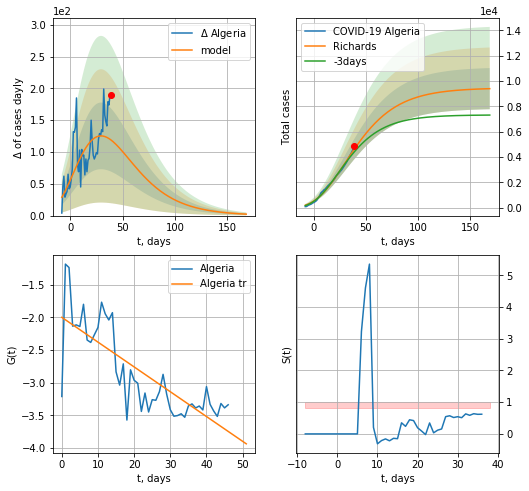

Algeria data at: 2020-05-05
+3 day model MAPE: 0.053165
model: Richards
coeffs: [ 9.46228281e+03  3.07442907e+00 -9.27191222e+01  1.17817207e-02]
rational stdev: 0.172857
forecast at the end of period: +130 days
	 deltaDaycases: 2
	 total cases: 9401 ± 1625
	 total death: 913 ± 473
trend coefficient of determination: 0.621204
 intercept: -1.999555
 slope: -0.037934


In [275]:
x = forecastRR("Algeria",dfAR[15:],d1,24*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


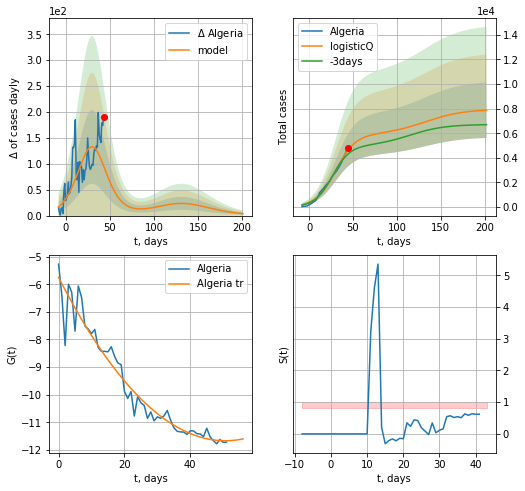

Algeria data at: 2020-05-05
+3 day model MAPE: 0.075875
model: logisticQ
coeffs: [ 5.87930413e+03  1.29899841e-06  3.02486946e+01 -6.90571153e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.286466
forecast at the end of period: +158 days
	 deltaDaycases: 3
	 total cases: 7877 ± 2256
	 total death: 765 ± 657
trend coefficient of determination: 0.942253
 intercept_: -5.746773910024121
 coeffs_: [ 0.         -0.23406873  0.00231228]


In [276]:
x = forecastRRR("Algeria",dfAR[10:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

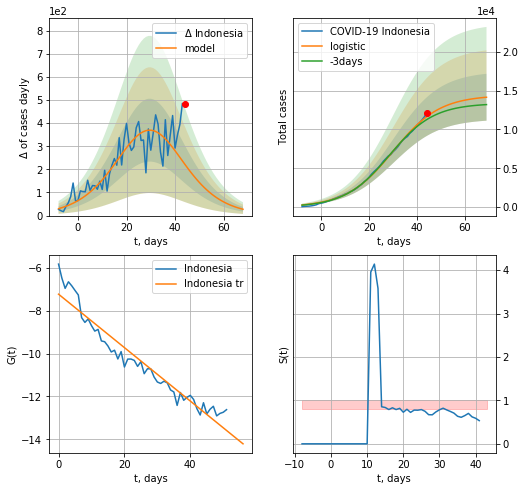

Indonesia data at: 2020-05-05
+3 day model MAPE: 0.03598435404170755
model: logistic
coeffs:  [1.43993399e+04 1.02754798e-01 3.00380278e+01]
rational stdev:  0.213320503500265
forecast at the end of period: +25 days
	 deltaDaycases:  27
	 total cases:  14141 ± 3016
	 total death:  1021 ± 653
trend coefficient of determination: 0.930229
 intercept: -7.234247
 slope: -0.124513


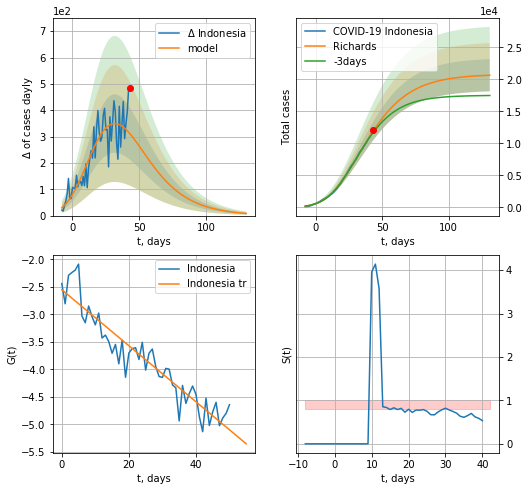

Indonesia data at: 2020-05-05
+3 day model MAPE: 0.021918
model: Richards
coeffs: [ 2.08071309e+04  3.23830798e-01 -6.33635317e+00  1.51569521e-01]
rational stdev: 0.121980
forecast at the end of period: +88 days
	 deltaDaycases: 8
	 total cases: 20645 ± 2518
	 total death: 1491 ± 545
trend coefficient of determination: 0.881252
 intercept: -2.551364
 slope: -0.050910


In [278]:
x = forecast("Indonesia",dfIE[5:],d1,9*7-dT)
x = forecastRR("Indonesia",dfIE[6:],d1,18*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


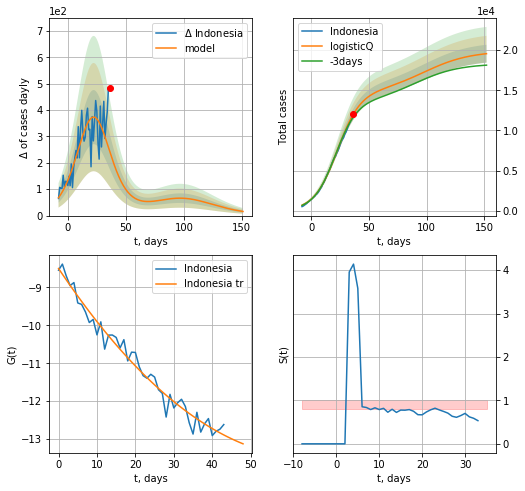

Indonesia data at: 2020-05-05
+3 day model MAPE: 0.031162
model: logisticQ
coeffs: [ 1.46821232e+04  1.81999785e-05  2.24989226e+01 -5.48149353e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.056842
forecast at the end of period: +116 days
	 deltaDaycases: 15
	 total cases: 19558 ± 1111
	 total death: 1412 ± 240
trend coefficient of determination: 0.972726
 intercept_: -8.504069785020034
 coeffs_: [ 0.         -0.151387    0.00114955]


In [279]:
x = forecastRRR("Indonesia",dfIE[13:],d1,22*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


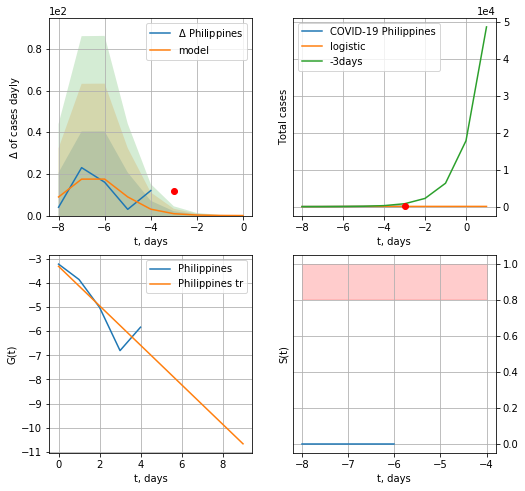

Philippines data at: 2020-05-05
+3 day model MAPE: 0.9724006736169737
model: logistic
coeffs:  [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.19348550855350297
forecast at the end of period: +4 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  4 ± 2
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


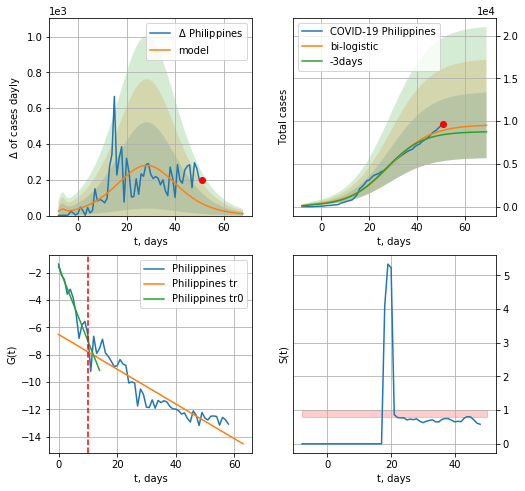

Philippines data at: 2020-05-05
+3 day model MAPE: 0.06382750246711887
model: bi-logistic
coeffs:  [9.53022991e+03 1.17662566e-01 2.88207529e+01] [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.4039916434139397
forecast at the end of period: +18 days
	 deltaDaycases:  10
	 total cases:  9508 ± 3841
	 total death:  625 ± 757
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.844180
 intercept: -6.520133
 slope: -0.126756


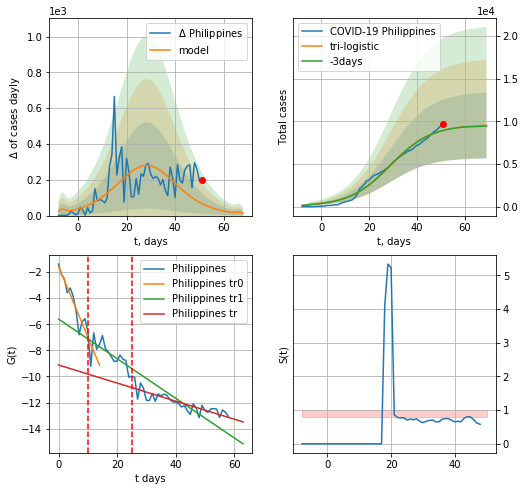

Philippines data at: 2020-05-05
+3 day model MAPE: 3.307752485900524e-10
model: tri-logistic
coeffs:  [19.86729869  1.46596841 66.84682098] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  9.53022991e+03
  1.17662566e-01  2.88207529e+01]
forecast rational stdev:  0.4039916434139363
forecast at the end of period: +18 days
	 deltaDaycases:  12
	 total cases:  9527 ± 3848
	 total death:  626 ± 758
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.734769
 intercept: -9.122778
 slope: -0.069280


In [280]:
vL=10
vL1=25
x = forecast("Philippines",dfPH[4:vL],d1,6*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
xx = forecast2("Philippines",dfPH[:],d1,8*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


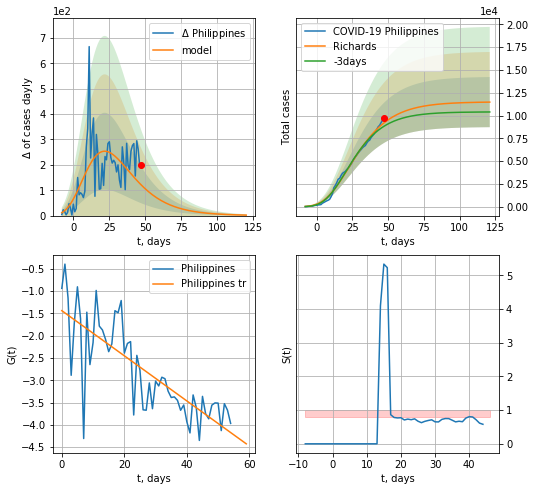

Philippines data at: 2020-05-05
+3 day model MAPE: 0.044209
model: Richards
coeffs: [ 1.15018278e+04  6.61454462e+00 -5.57256966e+01  9.11064046e-03]
rational stdev: 0.239775
forecast at the end of period: +74 days
	 deltaDaycases: 1
	 total cases: 11471 ± 2750
	 total death: 754 ± 542
trend coefficient of determination: 0.622666
 intercept: -1.437831
 slope: -0.050660


In [281]:
x = forecastRR("Philippines",dfPH[4:],d1,16*7-dT,addpred=False,xcoef=[0.25,1.,2.3])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


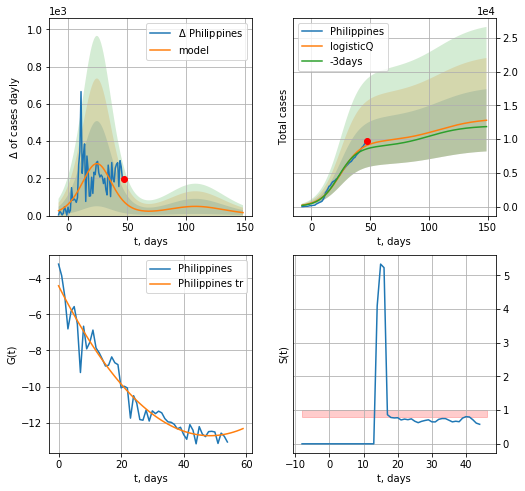

Philippines data at: 2020-05-05
+3 day model MAPE: 0.061068
model: logisticQ
coeffs: [ 9.66399388e+03  1.29262873e-06  2.48448440e+01 -8.88465547e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.360423
forecast at the end of period: +102 days
	 deltaDaycases: 16
	 total cases: 12789 ± 4609
	 total death: 841 ± 909
trend coefficient of determination: 0.946066
 intercept_: -4.419114655018356
 coeffs_: [ 0.         -0.34253259  0.00353548]


In [282]:
x = forecastRRR("Philippines",dfPH[4:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

GC
          date  cases  active  death
62 2020-05-01   2612    1098  140.0
63 2020-05-02   2620    1103  143.0
64 2020-05-03   2626    1108  144.0
65 2020-05-04   2632    1112  146.0
66 2020-05-05   2642    1122  146.0


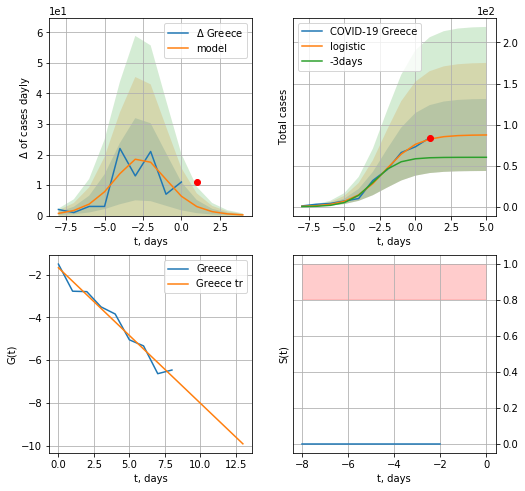

Greece data at: 2020-05-05
+3 day model MAPE: 0.42128754754463943
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +4 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  4 ± 6
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


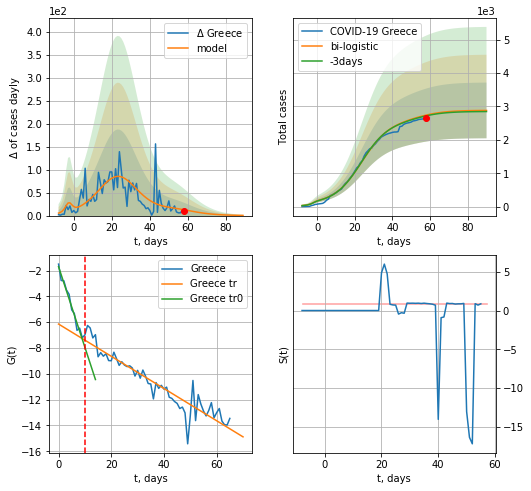

Greece data at: 2020-05-05
+3 day model MAPE: 0.008377870522339235
model: bi-logistic
coeffs:  [2.48650384e+03 1.36443136e-01 2.36846659e+01] [87.54984336  0.87627722 -2.15069813]
scenario coeffs:  [0.125, 1.0, 2.3]
rational stdev:  0.2893915987611912
forecast at the end of period: +32 days
	 deltaDaycases:  0
	 total cases:  2882 ± 834
	 total death:  159 ± 138
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.877201
 intercept: -6.147017
 slope: -0.124837


In [283]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,6*7-dT)
xx = forecast2("Greece",dfGC[:],d1,10*7-dT,x,addpred=True,xcoef=[.25/2,1.,2.3],vL=10)

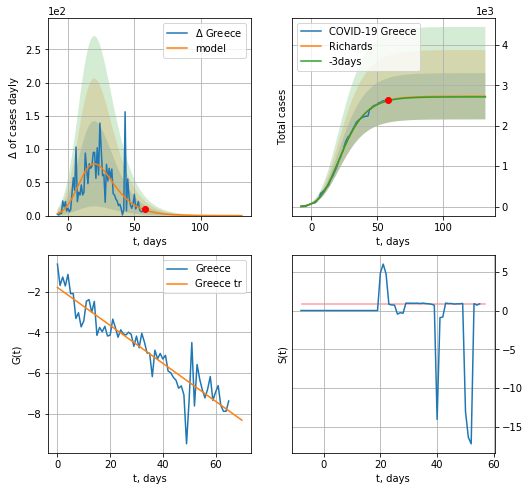

Greece data at: 2020-05-05
+3 day model MAPE: 0.003729
model: Richards
coeffs: [2.72902861e+03 3.80637354e-01 3.06907968e+00 2.26716336e-01]
rational stdev: 0.209421
forecast at the end of period: +74 days
	 deltaDaycases: 0
	 total cases: 2728 ± 571
	 total death: 150 ± 94
trend coefficient of determination: 0.863363
 intercept: -1.799121
 slope: -0.092934


In [284]:
x = forecastRR("Greece",dfGC[:],d1,16*7-dT,addpred=False,xcoef=[.35/4,.5,4,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


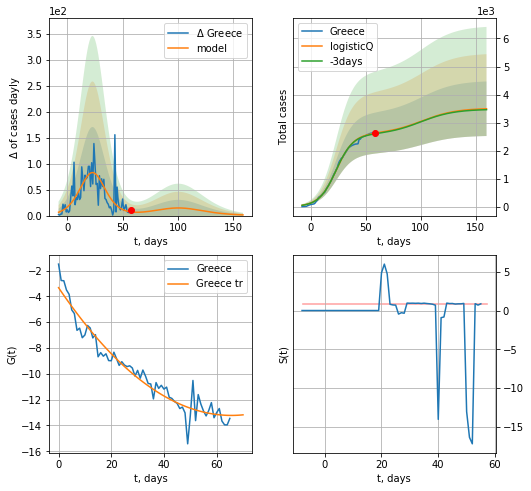

Greece data at: 2020-05-05
+3 day model MAPE: 0.009038
model: logisticQ
coeffs: [ 2.59463981e+03  1.31187140e-06  2.31631755e+01 -9.70947510e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.278656
forecast at the end of period: +102 days
	 deltaDaycases: 1
	 total cases: 3493 ± 973
	 total death: 193 ± 161
trend coefficient of determination: 0.937445
 intercept_: -3.328617784490744
 coeffs_: [ 0.         -0.3017444   0.00230005]


In [285]:
x = forecastRRR("Greece",dfGC[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

HG
          date  cases  active  death
56 2020-05-01   2942    1982  335.0
57 2020-05-02   2998    2029  340.0
58 2020-05-03   3035    2054  351.0
59 2020-05-04   3065    1993  363.0
60 2020-05-05   3111    1979  373.0


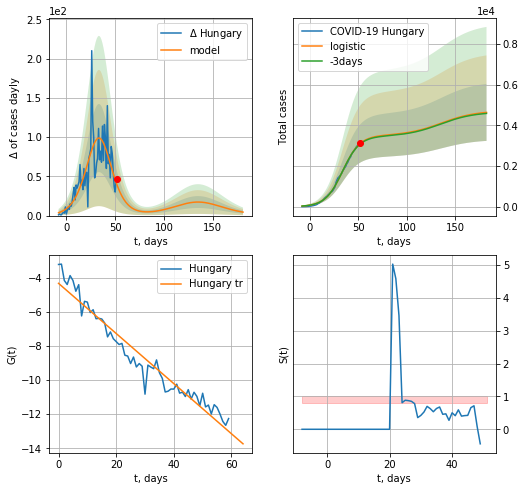

Hungary data at: 2020-05-05
+3 day model MAPE: 0.007245821662116388
model: logistic
coeffs:  [3.49189427e+03 1.12953384e-01 3.38385692e+01]
scenario coeffs:  [0.35, 0.5, 4, 1]
rational stdev:  0.30222613575626045
forecast at the end of period: +130 days
	 deltaDaycases:  4
	 total cases:  4632 ± 1399
	 total death:  555 ± 503
trend coefficient of determination: 0.943848
 intercept: -4.326990
 slope: -0.147048


In [286]:
dfHG = read_df(pd.DataFrame(),"HG")
x = forecast("Hungary",dfHG[:],d1,24*7-dT,addpred=True,xcoef=[.35,.5,4,1])
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


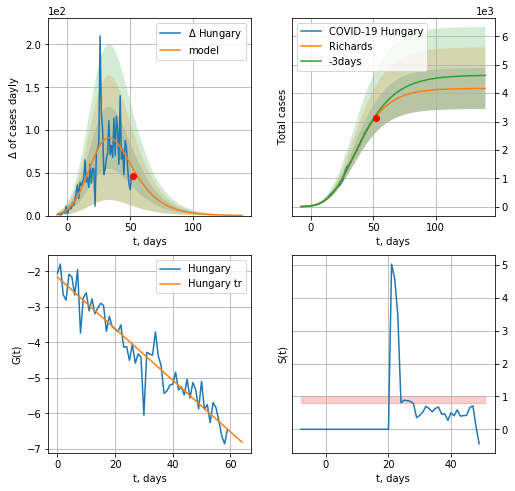

Hungary data at: 2020-05-05
+3 day model MAPE: 0.020603
model: Richards
coeffs: [4.16686702e+03 2.43041212e-01 1.46069218e+01 2.77708400e-01]
rational stdev: 0.173546
forecast at the end of period: +88 days
	 deltaDaycases: 0
	 total cases: 4163 ± 722
	 total death: 499 ± 259
trend coefficient of determination: 0.904814
 intercept: -2.158582
 slope: -0.072649


In [287]:
x = forecastRR("Hungary",dfHG[:],d1,18*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


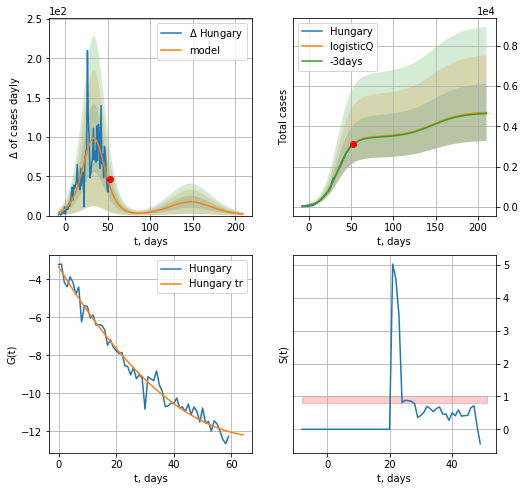

Hungary data at: 2020-05-05
+3 day model MAPE: 0.007322
model: logisticQ
coeffs: [ 3.49051413e+03  2.85866410e-06  3.38316389e+01 -3.94897402e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.302468
forecast at the end of period: +158 days
	 deltaDaycases: 1
	 total cases: 4692 ± 1419
	 total death: 562 ± 509
trend coefficient of determination: 0.975824
 intercept_: -3.3323740965411393
 coeffs_: [ 0.         -0.24996813  0.00174464]


In [288]:
x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


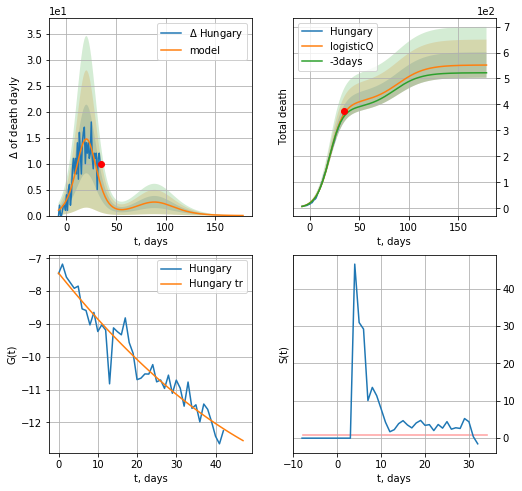

Hungary data at: 2020-05-05
+3 day model MAPE: 0.030257
model: logisticQ
coeffs: [ 4.07626605e+02  2.94695844e-05  2.04448425e+01 -4.86627455e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.088811
forecast at the end of period: +144 days
	 total death: 551 ± 49
trend coefficient of determination: 0.925986
 intercept_: -7.450204345379554
 coeffs_: [ 0.         -0.14885832  0.00085553]


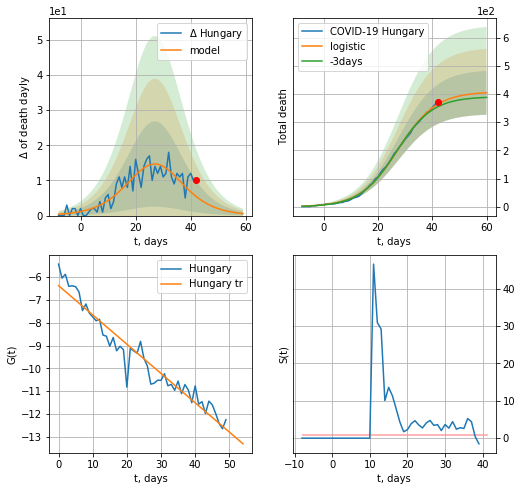

Hungary data at: 2020-05-05
+3 day model MAPE: 0.027111225330766826
model: logistic
coeffs:  [4.08120270e+02 1.43938429e-01 2.74568702e+01]
rational stdev:  0.19220365611720233
forecast at the end of period: +18 days
	 total death:  404 ± 77
trend coefficient of determination: 0.934516
 intercept: -6.370071
 slope: -0.128634


In [289]:
x = forecastRRR("Hungary",dfHG[17:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,8*7-dT,cases='death')

MT
          date  cases  active  death
54 2020-05-01  467.0      80    4.0
55 2020-05-02  468.0      85    4.0
56 2020-05-03  477.0      81    4.0
57 2020-05-04  480.0      77    4.0
58 2020-05-05  482.0      74    5.0


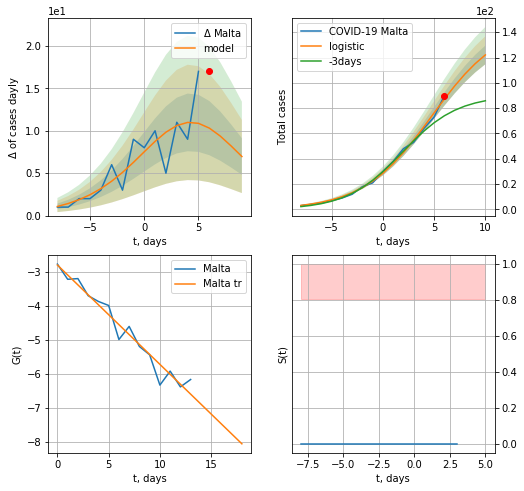

Malta data at: 2020-05-05
model: logistic
coeffs:  [147.79636191   0.29837112   4.7799048 ]
rational stdev:  0.06036954020755974
forecast at the end of period: +4 days
	 deltaDaycases:  6
	 total cases:  122 ± 7
	 total death:  1 ± 0
trend coefficient of determination: 0.952854
 intercept: -2.800130
 slope: -0.292111


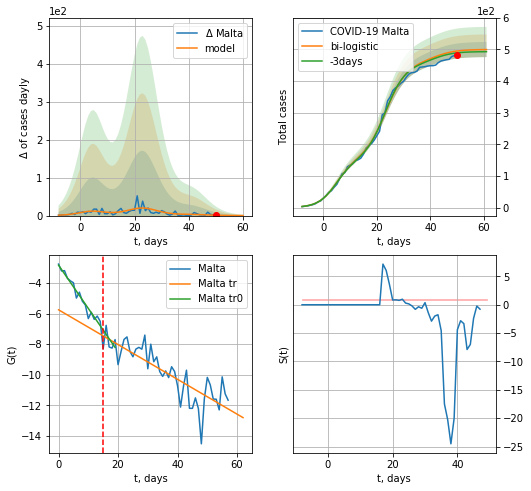

Malta data at: 2020-05-05
+3 day model MAPE: 0.012340898444744817
model: bi-logistic
coeffs:  [3.12513442e+02 2.52924707e-01 2.33660379e+01] [147.79636191   0.29837112   4.7799048 ]
scenario coeffs:  [0.125, 1.0, 1.8]
rational stdev:  0.04777282474289295
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  499 ± 23
	 total death:  5 ± 0
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.954424
 intercept: -2.840997
 slope: -0.282680
trend coefficient of determination: 0.687205
 intercept: -5.757094
 slope: -0.113605


In [290]:
dfMT = read_df(pd.DataFrame(),"MT")
x = forecast("Malta",dfMT[:15],d1,6*7-dT,pMAPE=False)
xx = forecast2("Malta",dfMT[:],d1,7*7-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


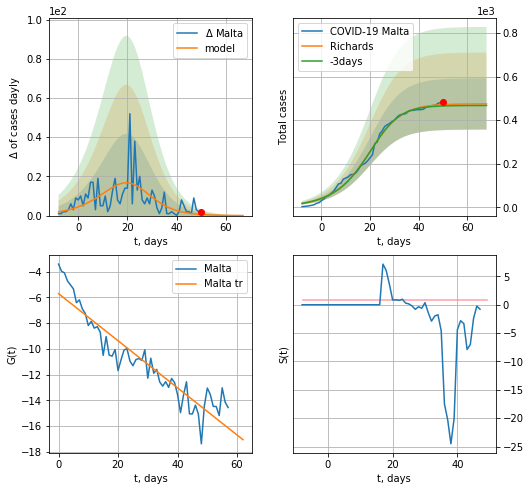

Malta data at: 2020-05-05
+3 day model MAPE: 0.013524
model: Richards
coeffs: [4.74534617e+02 1.09867053e-01 2.24343997e+01 1.46774110e+00]
rational stdev: 0.248283
forecast at the end of period: +18 days
	 deltaDaycases: 0
	 total cases: 474 ± 117
	 total death: 4 ± 2
trend coefficient of determination: 0.870497
 intercept: -5.712309
 slope: -0.182856


In [291]:
x = forecastRR("Malta",dfMT[:],d1,8*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


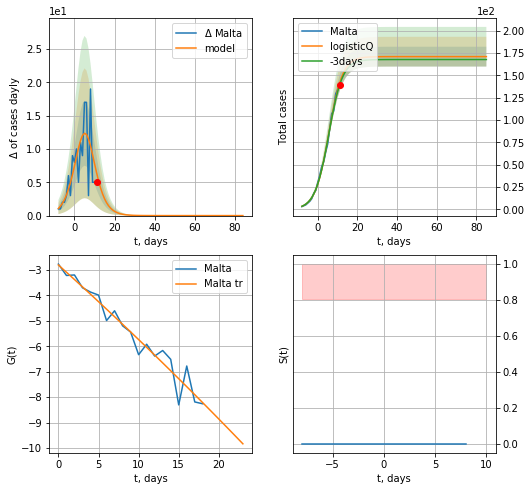

Malta data at: 2020-05-05
+3 day model MAPE: 0.017372
model: logisticQ
coeffs: [ 1.70905491e+02  1.60191203e-04  5.61725093e+00 -1.80321010e+03]
rational stdev: 0.064892
forecast at the end of period: +74 days
	 deltaDaycases: 0
	 total cases: 170 ± 11
	 total death: 1 ± 0
trend coefficient of determination: 0.945272
 intercept_: -2.8075452596601114
 coeffs_: [ 0.         -0.2833994  -0.00095541]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


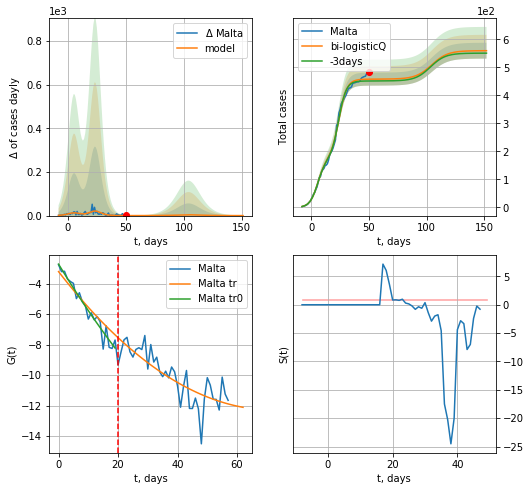

Malta data at: 2020-05-05
+3 day model MAPE: 0.014337
model: bi-logisticQ
coeffs: [ 2.86789014e+02  1.82400152e-06  2.39651494e+01 -1.57650105e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.050583
forecast at the end of period: +102 days
	 deltaDaycases: 0
	 total cases: 559 ± 28
	 total death: 5 ± 0
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.942709
 intercept_: -2.7278514236597555
 coeffs_: [ 0.         -0.32197154  0.00170311]
trend coefficient of determination: 0.644433
 intercept_: -3.2202372801364927
 coeffs_: [ 0.         -0.25134603  0.00173908]


In [292]:
x = forecastRRR("Malta",dfMT[:20],d1,16*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
xx = forecast2RRR("Malta",dfMT[:],d1,20*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=20)

SL
          date  cases  active  death
52 2020-05-01   1403   822.0   23.0
53 2020-05-02   1407   775.0   24.0
54 2020-05-03   1408   765.0   24.0
55 2020-05-04   1413   745.0   25.0
56 2020-05-05   1421   655.0   25.0


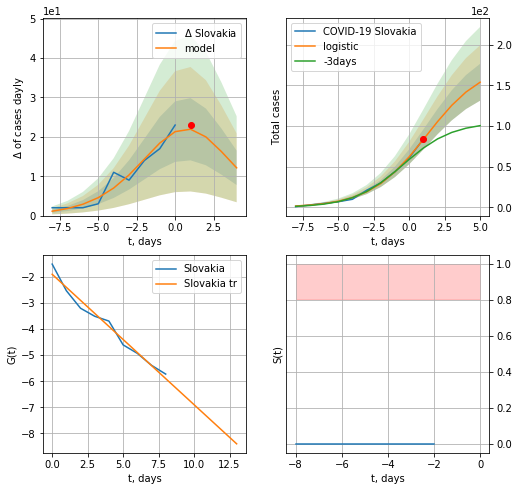

Slovakia data at: 2020-05-05
model: logistic
coeffs:  [177.28786794   0.4996723    1.23158092]
rational stdev:  0.14723856172050678
forecast at the end of period: +4 days
	 deltaDaycases:  12
	 total cases:  153 ± 22
	 total death:  2 ± 0
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610


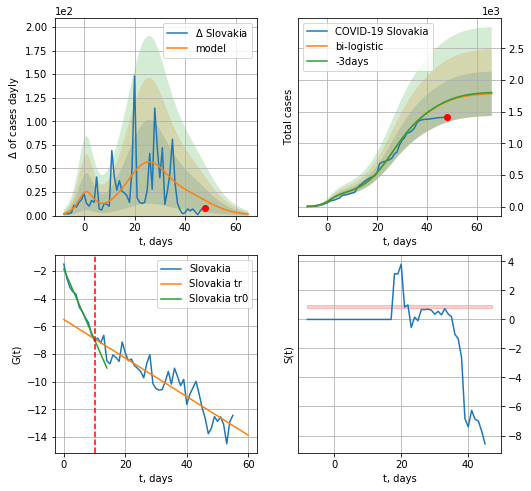

Slovakia data at: 2020-05-05
+3 day model MAPE: 0.006599565741440564
model: bi-logistic
coeffs:  [1.29228651e+03 1.69361867e-01 2.56999668e+01] [177.28786794   0.4996723    1.23158092]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.19722330009036868
forecast at the end of period: +18 days
	 deltaDaycases:  1
	 total cases:  1784 ± 351
	 total death:  31 ± 18
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.981202
 intercept: -1.868036
 slope: -0.510655
trend coefficient of determination: 0.851281
 intercept: -5.510367
 slope: -0.139435


In [293]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
x = forecast("Slovakia",dfSL[:10],d1,6*7-dT,pMAPE=False)
xx = forecast2("Slovakia",dfSL[:],d1,8*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


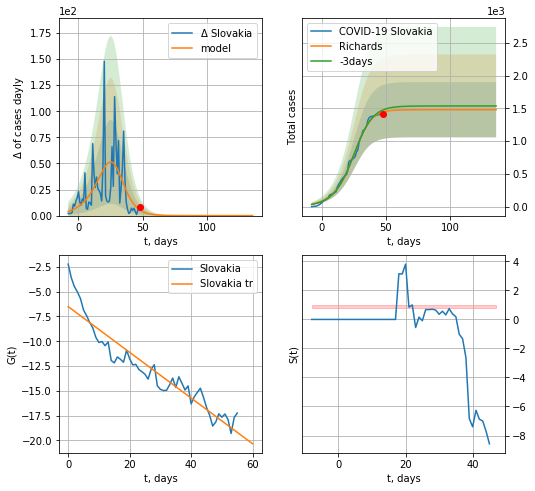

Slovakia data at: 2020-05-05
+3 day model MAPE: 0.023156
model: Richards
coeffs: [1.48024656e+03 1.00511972e-01 2.85356564e+01 1.66061561e+00]
rational stdev: 0.284538
forecast at the end of period: +88 days
	 deltaDaycases: 0
	 total cases: 1480 ± 421
	 total death: 26 ± 22
trend coefficient of determination: 0.889240
 intercept: -6.512365
 slope: -0.230409


In [294]:
x = forecastRR("Slovakia",dfSL[:],d1,18*7-dT)

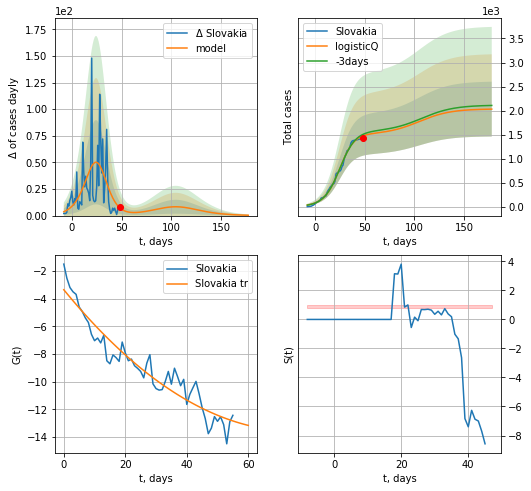

Slovakia data at: 2020-05-05
+3 day model MAPE: 0.021583
model: logisticQ
coeffs: [ 1.50272867e+03  4.57772011e-04  2.39745535e+01 -2.65557465e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.280987
forecast at the end of period: +130 days
	 deltaDaycases: 0
	 total cases: 2029 ± 570
	 total death: 35 ± 29
trend coefficient of determination: 0.907722
 intercept_: -3.3576138233031436
 coeffs_: [ 0.         -0.2715195   0.00180019]


In [295]:
x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

SV
          date   cases  active  death
57 2020-05-01  1434.0  1109.0   92.0
58 2020-05-02  1439.0  1106.0   94.0
59 2020-05-03  1439.5  1102.0   96.0
60 2020-05-04  1439.8  1101.0   97.0
61 2020-05-05  1445.0  1103.0   98.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


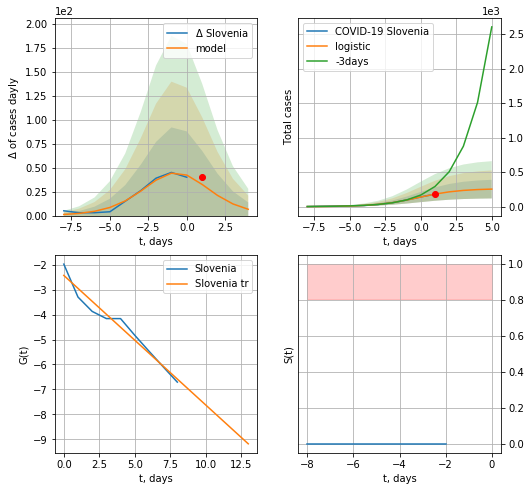

Slovenia data at: 2020-05-05
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +4 days
	 deltaDaycases:  6
	 total cases:  254 ± 135
	 total death:  17 ± 27
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636


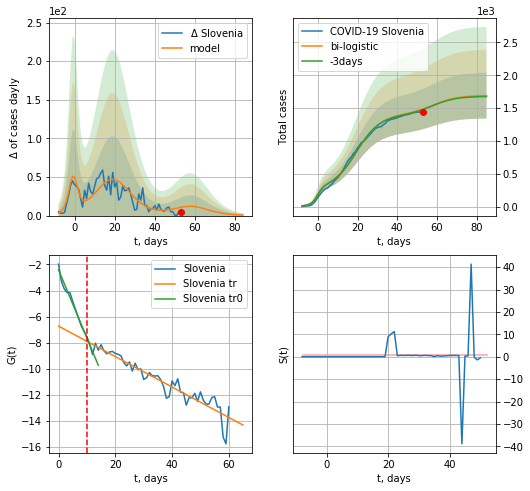

Slovenia data at: 2020-05-05
+3 day model MAPE: 0.004650024082304688
model: bi-logistic
coeffs:  [1.14633382e+03 1.63566595e-01 1.94763039e+01] [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.20619463712569377
forecast at the end of period: +32 days
	 deltaDaycases:  0
	 total cases:  1690 ± 348
	 total death:  114 ± 70
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.969651
 intercept: -2.421914
 slope: -0.521632
trend coefficient of determination: 0.897293
 intercept: -6.725194
 slope: -0.116728


In [296]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
x = forecast("Slovenia",dfSV[:10],d1,6*7-dT,pMAPE=False)
xx = forecast2("Slovenia",dfSV[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


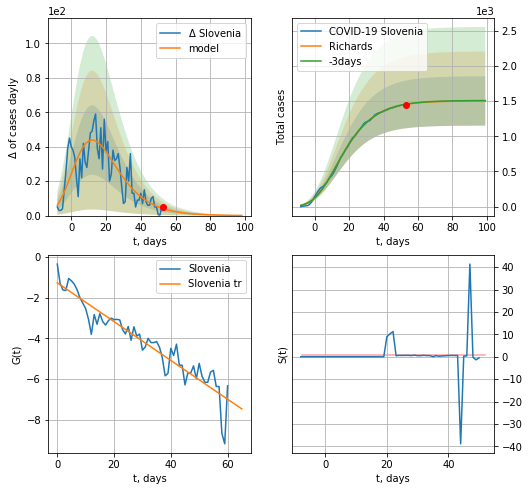

Slovenia data at: 2020-05-05
+3 day model MAPE: 0.002129
model: Richards
coeffs: [ 1.50239386e+03  8.52698006e-01 -1.54228919e+01  9.76006594e-02]
rational stdev: 0.233305
forecast at the end of period: +46 days
	 deltaDaycases: 0
	 total cases: 1501 ± 350
	 total death: 101 ± 70
trend coefficient of determination: 0.885952
 intercept: -1.276780
 slope: -0.095300


In [297]:
x = forecastRR("Slovenia",dfSV[:],d1,12*7-dT)

[0.35416971, 0.02606324, 4.35859408, 19.30413219]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp


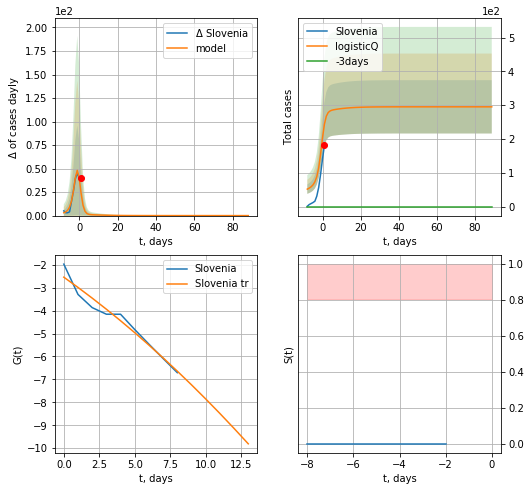

Slovenia data at: 2020-05-05
+3 day model MAPE: inf
model: logisticQ
coeffs: [ 2.17965799e+02  4.01733228e-02 -2.21208435e+01 -7.00287194e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266979
forecast at the end of period: +88 days
	 deltaDaycases: 0
	 total cases: 295 ± 78
	 total death: 20 ± 16
trend coefficient of determination: 0.956027
 intercept_: -2.543480478113449
 coeffs_: [ 0.         -0.43771568 -0.00932819]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


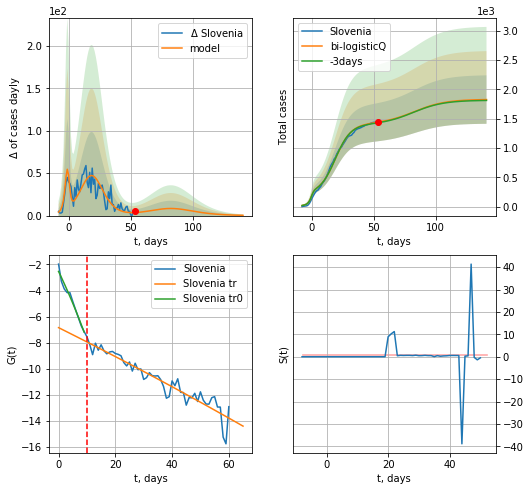

Slovenia data at: 2020-05-05
+3 day model MAPE: 0.007329
model: bi-logisticQ
coeffs: [ 1.19136099e+03  1.02917186e-06  1.89385321e+01 -1.53465096e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.226157
forecast at the end of period: +88 days
	 deltaDaycases: 0
	 total cases: 1827 ± 413
	 total death: 123 ± 83
bi-logisticQ approximation splitting point: 10
trend coefficient of determination: 0.968209
 intercept_: -2.53431844604435
 coeffs_: [ 0.         -0.45029183 -0.00732028]
trend coefficient of determination: 0.897438
 intercept_: -6.8432386290151115
 coeffs_: [ 0.         -0.10854705 -0.00011673]


In [298]:
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
print(koreaCoeffs)
x = forecastRRR("Slovenia",dfSV[:10],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
xx = forecast2RRR("Slovenia",dfSV[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
          date  cases  active  death
52 2020-05-01   9205  7641.0  185.0
53 2020-05-02   9362  7747.0  189.0
54 2020-05-03   9464  7720.0  193.0
55 2020-05-04   9557  7786.0  197.0
56 2020-05-05   9677  7754.0  200.0


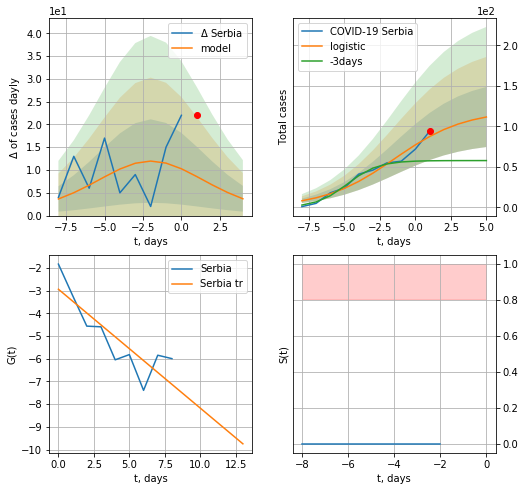

Serbia data at: 2020-05-05
model: logistic
coeffs:  [119.86809018   0.40041874  -1.48148467]
rational stdev:  0.3321032925412913
forecast at the end of period: +4 days
	 deltaDaycases:  3
	 total cases:  111 ± 37
	 total death:  2 ± 1
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


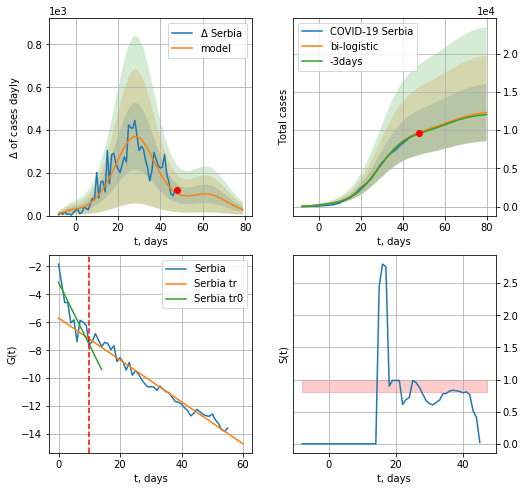

Serbia data at: 2020-05-05
+3 day model MAPE: 0.01632528993908836
model: bi-logistic
coeffs:  [9.88837384e+03 1.49014371e-01 2.87377981e+01] [119.86809018   0.40041874  -1.48148467]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.3040018600375966
forecast at the end of period: +32 days
	 deltaDaycases:  28
	 total cases:  12288 ± 3735
	 total death:  253 ± 230
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.971348
 intercept: -5.691140
 slope: -0.150103


In [299]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,6*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


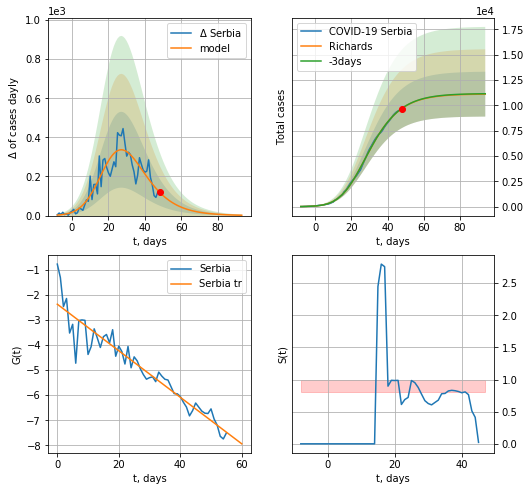

Serbia data at: 2020-05-05
+3 day model MAPE: 0.001294
model: Richards
coeffs: [1.11240615e+04 2.82629701e-01 1.62532284e+01 3.39551116e-01]
rational stdev: 0.199285
forecast at the end of period: +46 days
	 deltaDaycases: 1
	 total cases: 11105 ± 2213
	 total death: 229 ± 136
trend coefficient of determination: 0.909005
 intercept: -2.368957
 slope: -0.092830


In [300]:
x = forecastRR("Serbia",dfSB[:],d1,12*7-dT)


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


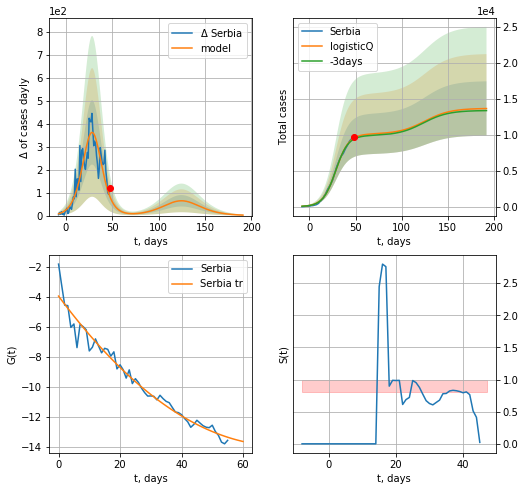

Serbia data at: 2020-05-05
+3 day model MAPE: 0.015619
model: logisticQ
coeffs: [ 1.01057644e+04  3.19770941e-06  2.86924344e+01 -4.48122147e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.277482
forecast at the end of period: +144 days
	 deltaDaycases: 2
	 total cases: 13656 ± 3789
	 total death: 282 ± 234
trend coefficient of determination: 0.967040
 intercept_: -3.961895993890936
 coeffs_: [ 0.         -0.27547499  0.00190222]


In [301]:
x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CT
          date  cases  active  death
62 2020-05-01   2085   589.0   75.0
63 2020-05-02   2088   548.0   77.0
64 2020-05-03   2096   528.0   79.0
65 2020-05-04   2101   499.0   80.0
66 2020-05-05   2112   469.0   83.0


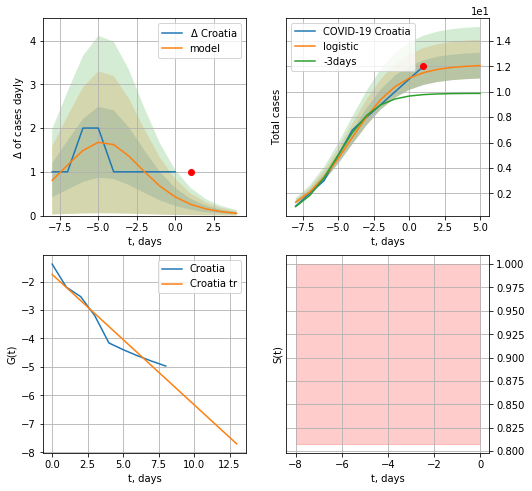

Croatia data at: 2020-05-05
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +4 days
	 deltaDaycases:  0
	 total cases:  12 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


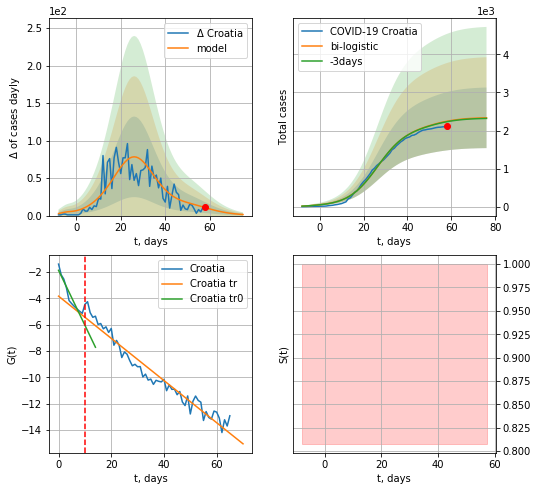

Croatia data at: 2020-05-05
+3 day model MAPE: 0.005440888332064297
model: bi-logistic
coeffs:  [2.07180634e+03 1.49966737e-01 2.64112227e+01] [12.13023855  0.55939634 -4.20963748]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.34103775417533355
forecast at the end of period: +18 days
	 deltaDaycases:  1
	 total cases:  2333 ± 795
	 total death:  91 ± 93
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.922384
 intercept: -1.856940
 slope: -0.417612
trend coefficient of determination: 0.949787
 intercept: -3.821852
 slope: -0.160333


In [302]:
dfCT = read_df(pd.DataFrame(),"CT")
x = forecast("Croatia",dfCT[:10],d1,6*7-dT,pMAPE=False)
xx = forecast2("Croatia",dfCT[:],d1,8*7-dT,x,addpred=True,xcoef=[0.25/2,1.,2.],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


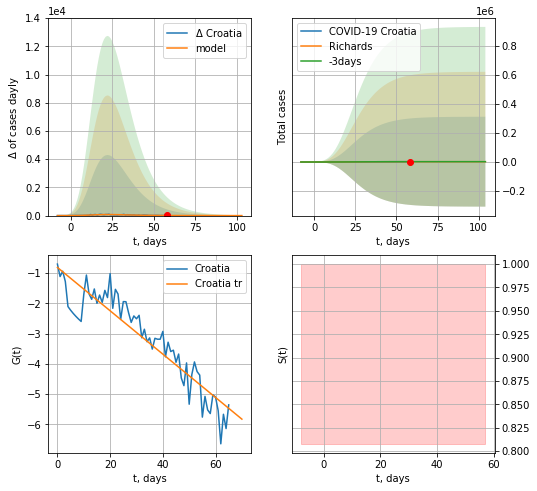

Croatia data at: 2020-05-05
+3 day model MAPE: 0.002704
model: Richards
coeffs: [ 2.21248896e+03  6.89511730e+00 -2.51752792e+01  1.31444253e-02]
rational stdev: 140.147609
forecast at the end of period: +46 days
	 deltaDaycases: 0
	 total cases: 2211 ± 309880
	 total death: 86 ± 36158
trend coefficient of determination: 0.851232
 intercept: -0.812454
 slope: -0.071675


In [303]:
x = forecastRR("Croatia",dfCT[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


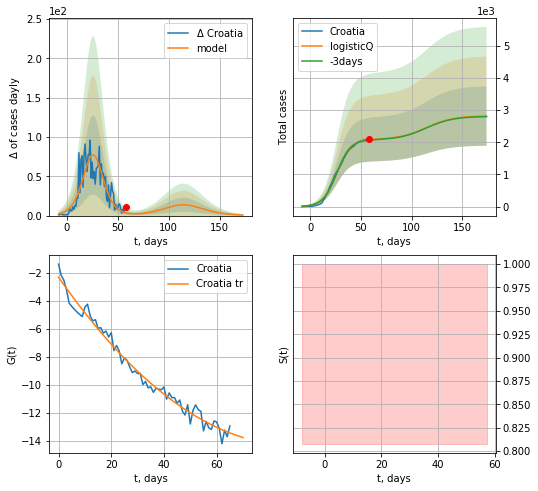

Croatia data at: 2020-05-05
+3 day model MAPE: 0.006419
model: logisticQ
coeffs: [ 2.08716293e+03  1.30204878e-06  2.63332049e+01 -1.13607060e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.328026
forecast at the end of period: +116 days
	 deltaDaycases: 0
	 total cases: 2817 ± 924
	 total death: 110 ± 108
trend coefficient of determination: 0.981174
 intercept_: -2.31939405470391
 coeffs_: [ 0.         -0.26861867  0.00150732]


In [304]:
x = forecastRRR("Croatia",dfCT[:],d1,22*7-dT,addpred=True,xcoef=koreaCoeffs)

EG
          date  cases  active  death
56 2020-05-01   5895    4029  406.0
57 2020-05-02   6193    4256  415.0
58 2020-05-03   6465    4474  429.0
59 2020-05-04   6813    4745  436.0
60 2020-05-05   7201    5019  452.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


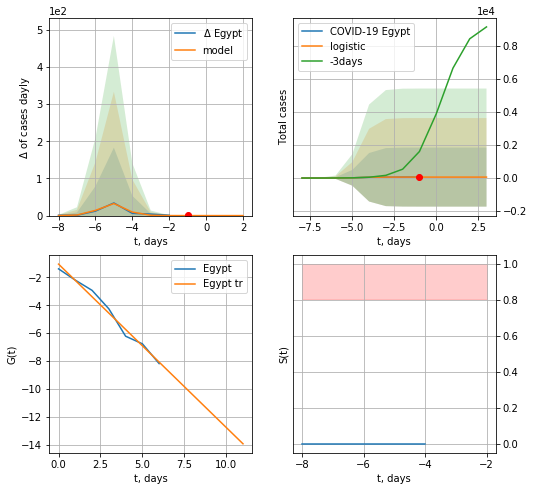

Egypt data at: 2020-05-05
+3 day model MAPE: 0.9848657964650105
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +4 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  3 ± 273
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


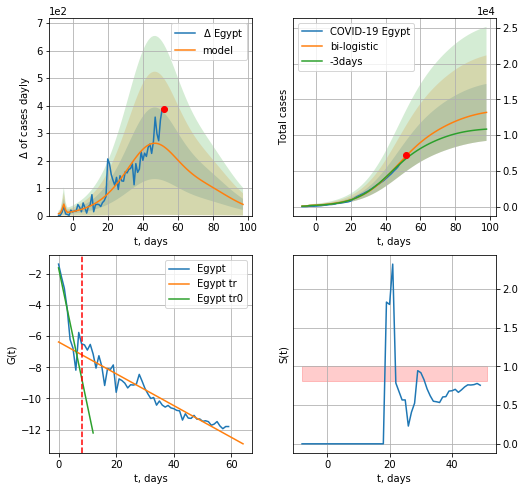

Egypt data at: 2020-05-05
+3 day model MAPE: 0.060599422716076386
model: bi-logistic
coeffs:  [1.08905604e+04 9.22247529e-02 4.62712311e+01] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.30241621708715816
forecast at the end of period: +46 days
	 deltaDaycases:  40
	 total cases:  13188 ± 3988
	 total death:  827 ± 750
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.925173
 intercept: -6.379142
 slope: -0.102049


In [305]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,6*7-dT)
xx = forecast2("Egypt",dfEG[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


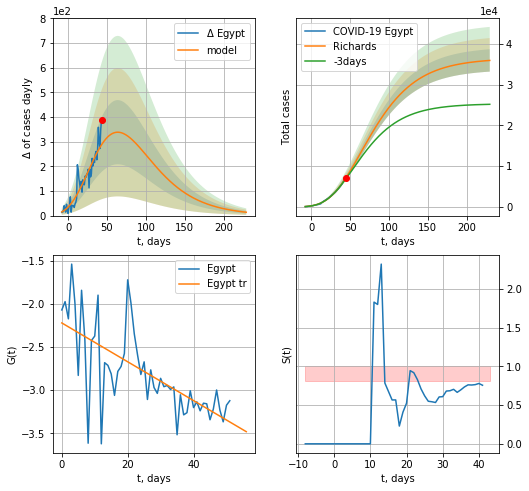

Egypt data at: 2020-05-05
+3 day model MAPE: 0.034347
model: Richards
coeffs: [ 3.64617938e+04  1.12285672e+00 -8.41831138e+01  2.26990757e-02]
rational stdev: 0.076302
forecast at the end of period: +186 days
	 deltaDaycases: 13
	 total cases: 35931 ± 2741
	 total death: 2255 ± 516
trend coefficient of determination: 0.457655
 intercept: -2.221140
 slope: -0.022509


In [306]:
x = forecastRR("Egypt",dfEG[8:],d1,32*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


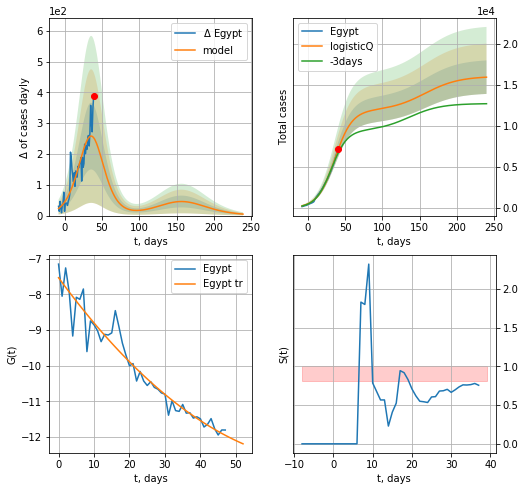

Egypt data at: 2020-05-05
+3 day model MAPE: 0.064207
model: logisticQ
coeffs: [ 1.18732462e+04  1.12366388e-05  3.60187601e+01 -7.67985630e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.128110
forecast at the end of period: +200 days
	 deltaDaycases: 4
	 total cases: 15967 ± 2045
	 total death: 1002 ± 385
trend coefficient of determination: 0.934613
 intercept_: -7.536196000748603
 coeffs_: [ 0.         -0.13553167  0.00088567]


In [307]:
x = forecastRRR("Egypt",dfEG[12:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
          date  cases  active  death
59 2020-05-01   2153   645.0   94.0
60 2020-05-02   2219   651.0   95.0
61 2020-05-03   2296   709.0   97.0
62 2020-05-04   2346   704.0   98.0
63 2020-05-05   2431   758.0  102.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


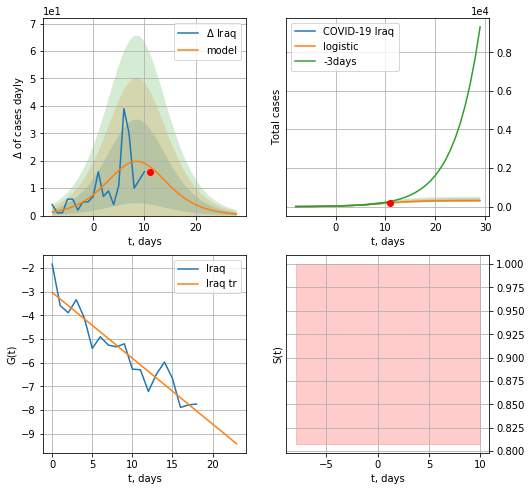

Iraq data at: 2020-05-05
+3 day model MAPE: 0.3447403684117319
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +18 days
	 deltaDaycases:  0
	 total cases:  314 ± 65
	 total death:  13 ± 8
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


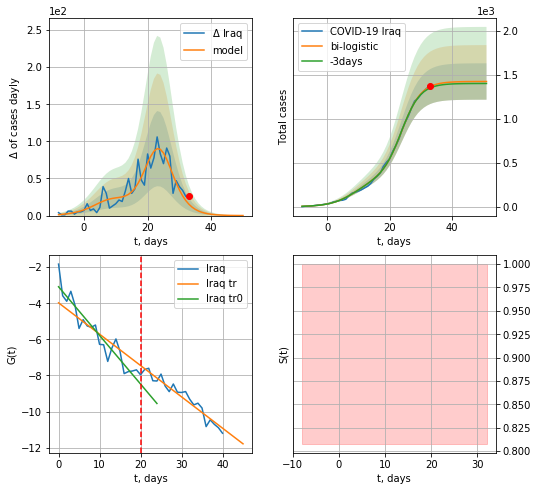

Iraq data at: 2020-05-05
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +18 days
	 deltaDaycases:  0
	 total cases:  1425 ± 207
	 total death:  59 ± 25
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


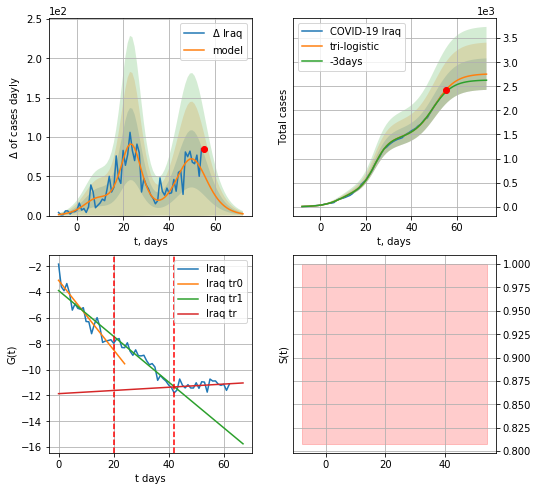

Iraq data at: 2020-05-05
+3 day model MAPE: 0.0207363074756366
model: tri-logistic
coeffs:  [1.33670037e+03 2.16497261e-01 5.01658261e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  0.1187780486477463
forecast at the end of period: +18 days
	 deltaDaycases:  2
	 total cases:  2753 ± 327
	 total death:  115 ± 40
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.059184
 intercept: -11.864380
 slope: 0.012366


In [308]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
x = forecast("Iraq",dfIQ[:vL],d1,8*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,8*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


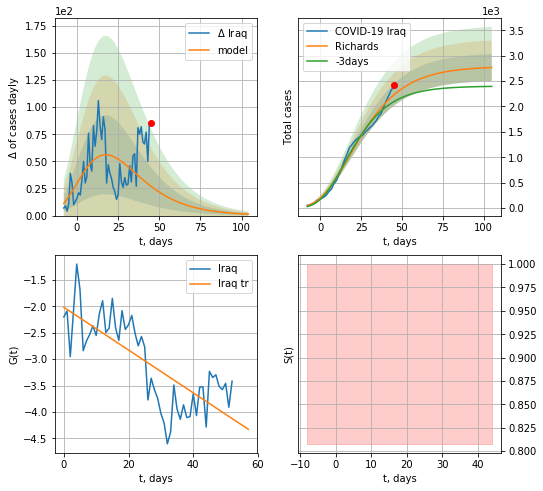

Iraq data at: 2020-05-05
+3 day model MAPE: 0.066745
model: Richards
coeffs: [ 2.78960813e+03  6.75875611e+00 -6.97809271e+01  8.12210195e-03]
rational stdev: 0.096290
forecast at the end of period: +60 days
	 deltaDaycases: 1
	 total cases: 2766 ± 266
	 total death: 116 ± 33
trend coefficient of determination: 0.578266
 intercept: -2.014274
 slope: -0.040609


In [309]:
x = forecastRR("Iraq",dfIQ[10:],d1,14*7-dT)


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


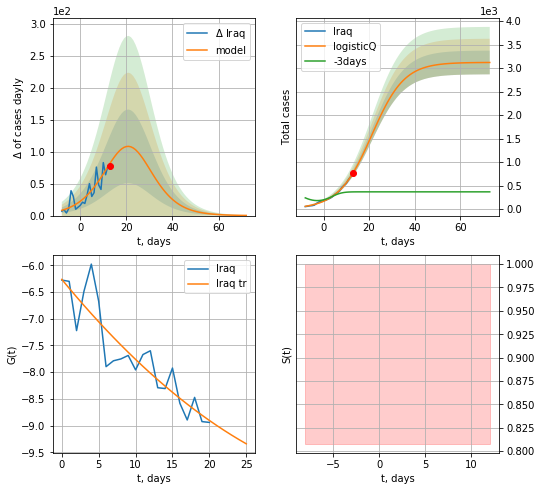

Iraq data at: 2020-05-05
+3 day model MAPE: 1.325310
model: logisticQ
coeffs: [ 3.12023575e+03  1.31776194e-04  2.10594687e+01 -1.03469115e+03]
rational stdev: 0.080850
forecast at the end of period: +60 days
	 deltaDaycases: 0
	 total cases: 3118 ± 252
	 total death: 130 ± 31
trend coefficient of determination: 0.824005
 intercept_: -6.262912434952875
 coeffs_: [ 0.         -0.16770647  0.00178172]


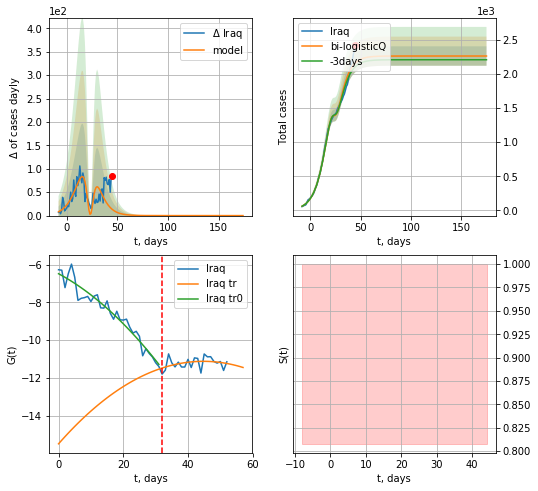

Iraq data at: 2020-05-05
+3 day model MAPE: 0.025765
model: bi-logisticQ
coeffs: [-8.53828401e+02  4.92467212e-03  2.34492571e+01 -7.50308078e+01]
rational stdev: 0.062911
forecast at the end of period: +130 days
	 deltaDaycases: 0
	 total cases: 2266 ± 142
	 total death: 95 ± 17
bi-logisticQ approximation splitting point: 32
trend coefficient of determination: 0.943011
 intercept_: -6.485709272215987
 coeffs_: [ 0.         -0.09183938 -0.00203399]
trend coefficient of determination: 0.148561
 intercept_: -15.493004019730602
 coeffs_: [ 0.          0.19510364 -0.00217846]


In [310]:
x = forecastRRR("Iraq",dfIQ[10:32],d1,14*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
xx = forecast2RRR("Iraq",dfIQ[10:],d1,24*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=32)

In [311]:
#len(dfAR)

AR
          date   cases  active  death
58 2020-05-01  4154.0  1880.0  453.0
59 2020-05-02  4295.0  1964.0  459.0
60 2020-05-03  4474.0  2075.0  463.0
61 2020-05-04  4648.0  2185.0  465.0
62 2020-05-05  4838.0  2301.0  470.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


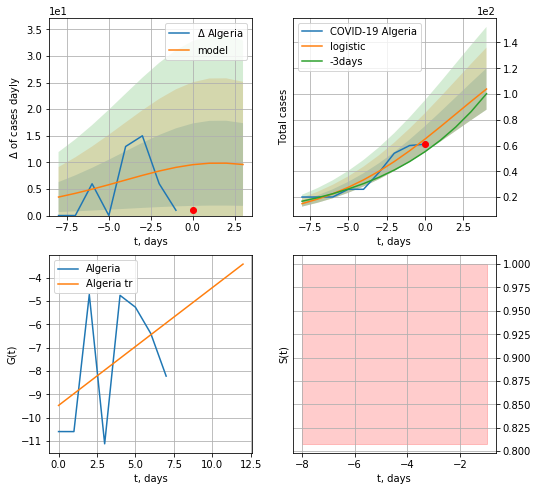

Algeria data at: 2020-05-05
+3 day model MAPE: 0.16392556519478307
model: logistic
coeffs:  [169.67177645   0.23328983   2.04237406]
rational stdev:  0.15467845008978148
forecast at the end of period: +4 days
	 deltaDaycases:  9
	 total cases:  103 ± 16
	 total death:  10 ± 4
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


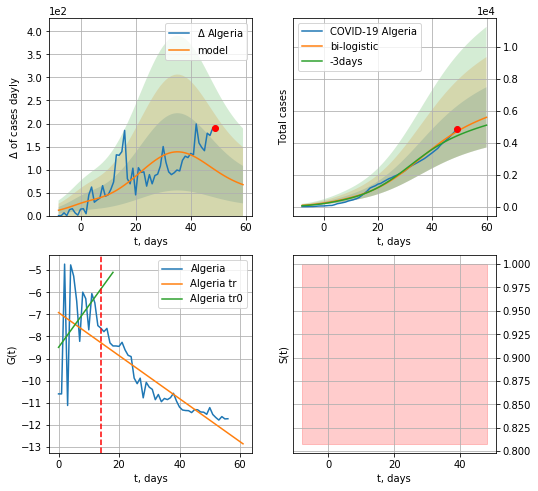

Algeria data at: 2020-05-05
+3 day model MAPE: 0.06532340385113773
model: bi-logistic
coeffs:  [5.49124448e+03 9.78776418e-02 3.50742966e+01] [169.67177645   0.23328983   2.04237406]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3364124940148353
forecast at the end of period: +11 days
	 deltaDaycases:  67
	 total cases:  5591 ± 1881
	 total death:  543 ± 548
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.865433
 intercept: -6.919931
 slope: -0.097312


In [312]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,6*7-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


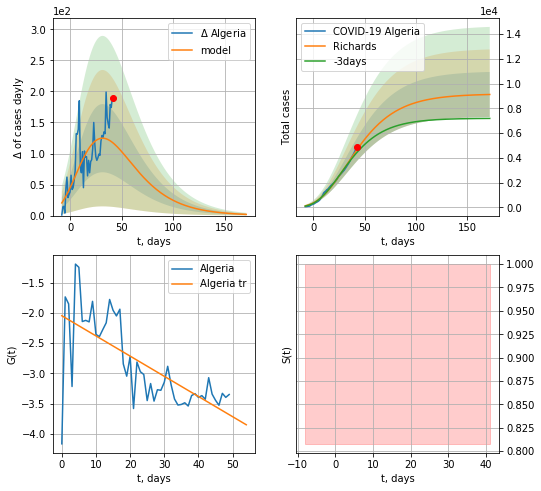

Algeria data at: 2020-05-05
+3 day model MAPE: 0.053505
model: Richards
coeffs: [ 9.16895627e+03  2.79930226e+00 -8.40347761e+01  1.32985974e-02]
rational stdev: 0.199567
forecast at the end of period: +130 days
	 deltaDaycases: 1
	 total cases: 9119 ± 1819
	 total death: 885 ± 529
trend coefficient of determination: 0.481532
 intercept: -2.046923
 slope: -0.033395


In [313]:
x = forecastRR("Algeria",dfAR[12:],d1,24*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


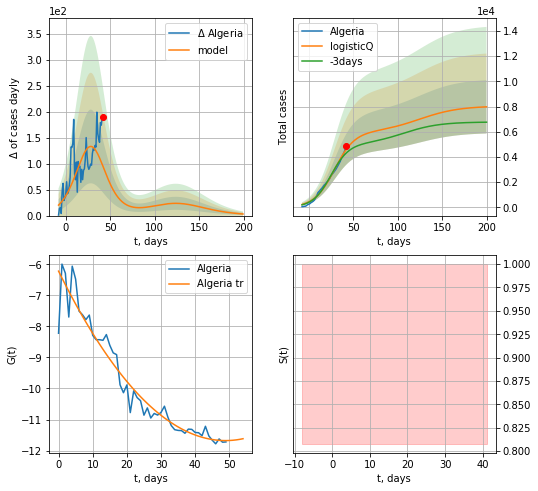

Algeria data at: 2020-05-05
+3 day model MAPE: 0.073340
model: logisticQ
coeffs: [ 5.94393704e+03  1.48305029e-06  2.85302008e+01 -5.97675134e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.265051
forecast at the end of period: +158 days
	 deltaDaycases: 3
	 total cases: 7979 ± 2114
	 total death: 775 ± 616
trend coefficient of determination: 0.932665
 intercept_: -6.222559189423097
 coeffs_: [ 0.         -0.2232412   0.00228391]


In [314]:
x = forecastRRR("Algeria",dfAR[12:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
          date  cases  active  death
50 2020-05-01  857.0   546.0   15.0
51 2020-05-02  864.0   553.0   15.0
52 2020-05-03  872.0   561.0   15.0
53 2020-05-04  874.0   563.0   15.0
54 2020-05-05  878.0   567.0   15.0


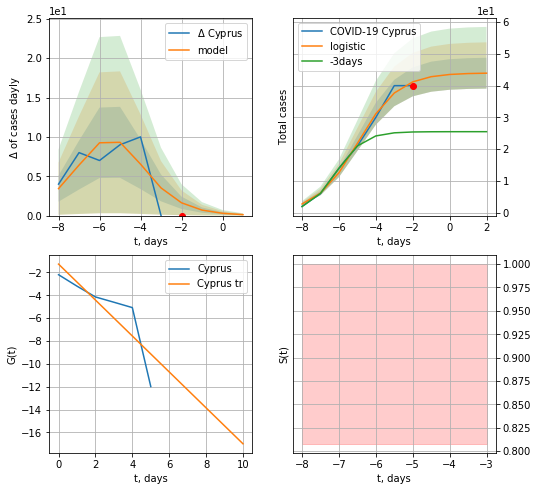

Cyprus data at: 2020-05-05
+3 day model MAPE: 0.6804910041763989
model: logistic
coeffs:  [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.11057143078785021
forecast at the end of period: +4 days
	 deltaDaycases:  0
	 total cases:  43 ± 4
	 total death:  0 ± 0
trend coefficient of determination: 0.714597
 intercept: -1.270285
 slope: -1.572073


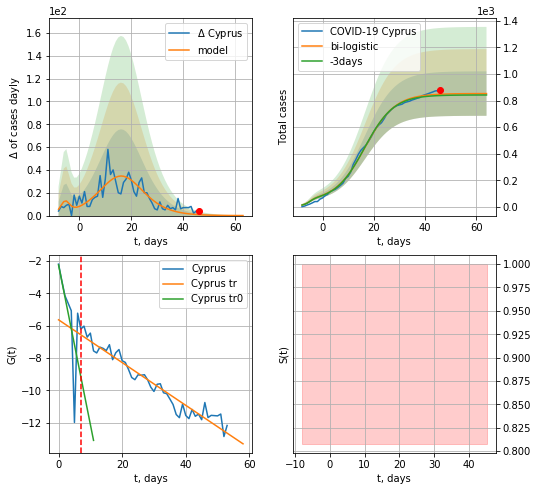

Cyprus data at: 2020-05-05
+3 day model MAPE: 0.011806476889753696
model: bi-logistic
coeffs:  [8.08341078e+02 1.71688606e-01 1.65904566e+01] [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.19614430308902858
forecast at the end of period: +18 days
	 deltaDaycases:  0
	 total cases:  852 ± 167
	 total death:  14 ± 8
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.449603
 intercept: -2.247366
 slope: -0.985825
trend coefficient of determination: 0.939599
 intercept: -5.639197
 slope: -0.132141


In [315]:
dfCP = read_df(pd.DataFrame(),"CP")
x = forecast("Cyprus",dfCP[:7],d1,6*7-dT)
xx = forecast2("Cyprus",dfCP[:],d1,8*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


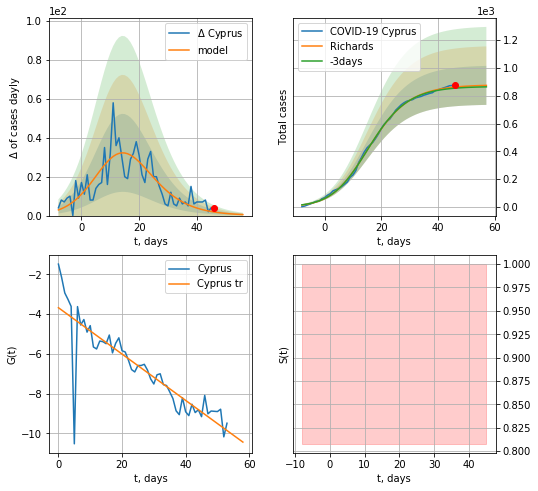

Cyprus data at: 2020-05-05
+3 day model MAPE: 0.010083
model: Richards
coeffs: [8.78376455e+02 2.13320159e-01 1.09045204e+01 6.04390196e-01]
rational stdev: 0.160438
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 874 ± 140
	 total death: 14 ± 6
trend coefficient of determination: 0.755601
 intercept: -3.680831
 slope: -0.116496


In [316]:
x = forecastRR("Cyprus",dfCP[:],d1,7*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


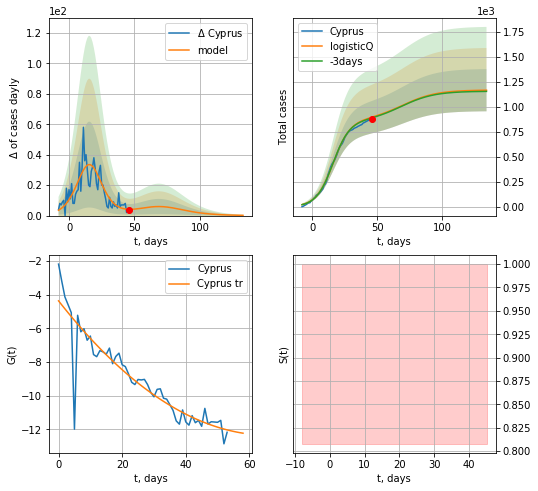

Cyprus data at: 2020-05-05
+3 day model MAPE: 0.008117
model: logisticQ
coeffs: [ 8.62257893e+02  3.01207949e-06  1.59189210e+01 -5.10763442e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.180930
forecast at the end of period: +88 days
	 deltaDaycases: 0
	 total cases: 1165 ± 210
	 total death: 19 ± 10
trend coefficient of determination: 0.831130
 intercept_: -4.375723140234835
 coeffs_: [ 0.         -0.24035041  0.00181108]


In [317]:
vL=33
x = forecastRRR("Cyprus",dfCP[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
          date  cases   active   death
55 2020-05-01  40459  28206.0  1124.0
56 2020-05-02  42534  28900.0  1200.0
57 2020-05-03  45928  31092.0  1286.0
58 2020-05-04  47372  31601.0  1344.0
59 2020-05-05  51189  34332.0  1444.0


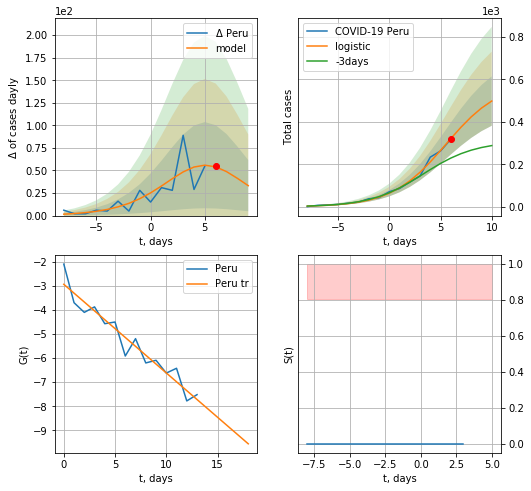

Peru data at: 2020-05-05
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +4 days
	 deltaDaycases:  33
	 total cases:  498 ± 116
	 total death:  14 ± 9
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


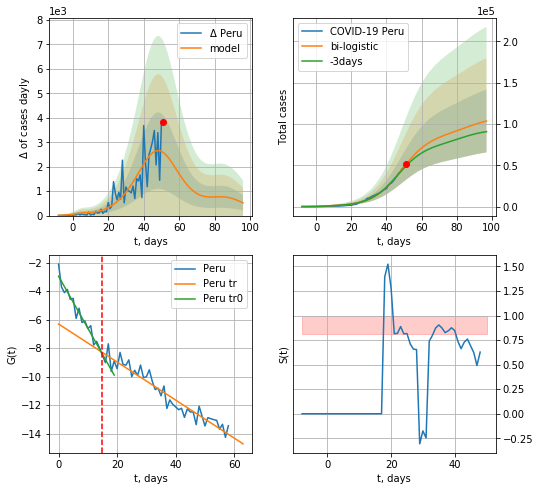

Peru data at: 2020-05-05
+3 day model MAPE: 0.04551224016812765
model: bi-logistic
coeffs:  [8.66270348e+04 1.21805211e-01 4.85200084e+01] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.3667160844796083
forecast at the end of period: +46 days
	 deltaDaycases:  520
	 total cases:  103535 ± 37968
	 total death:  2920 ± 3212
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.922194
 intercept: -6.301395
 slope: -0.133481


In [318]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,6*7-dT)
xx = forecast2("Peru",dfPU[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


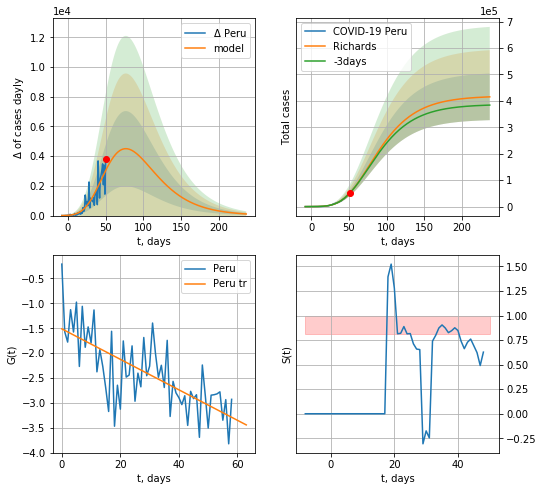

Peru data at: 2020-05-05
+3 day model MAPE: 0.008200
model: Richards
coeffs: [ 4.18768756e+05  9.75024178e-01 -4.04081826e+01  3.04586123e-02]
rational stdev: 0.212419
forecast at the end of period: +186 days
	 deltaDaycases: 108
	 total cases: 415151 ± 88186
	 total death: 11711 ± 7462
trend coefficient of determination: 0.492120
 intercept: -1.512096
 slope: -0.030587


In [319]:
x = forecastRR("Peru",dfPU[:],d1,32*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


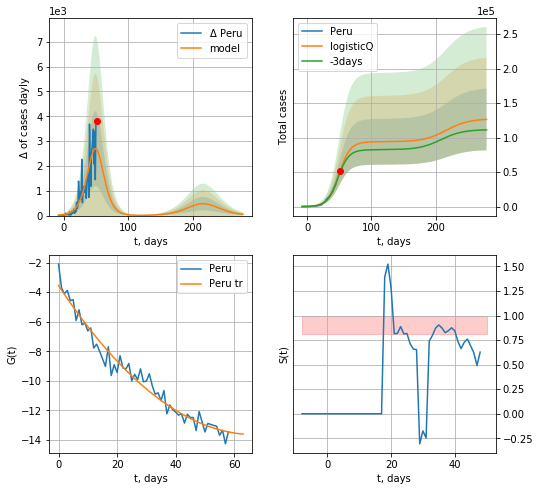

Peru data at: 2020-05-05
+3 day model MAPE: 0.036178
model: logisticQ
coeffs: [ 9.39845163e+04  6.16898917e-06  4.96792090e+01 -1.85682333e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.353629
forecast at the end of period: +228 days
	 deltaDaycases: 50
	 total cases: 126388 ± 44694
	 total death: 3565 ± 3782
trend coefficient of determination: 0.965928
 intercept_: -3.5541720016795644
 coeffs_: [ 0.         -0.30005837  0.00223132]


In [320]:
x = forecastRRR("Peru",dfPU[:].fillna(0),d1,38*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
          date  cases   active   death
62 2020-05-01  37336  26106.0  1223.0
63 2020-05-02  39980  27838.0  1323.0
64 2020-05-03  42533  29367.0  1391.0
65 2020-05-04  46437  32024.0  1566.0
66 2020-05-05  49436  33558.0  1695.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


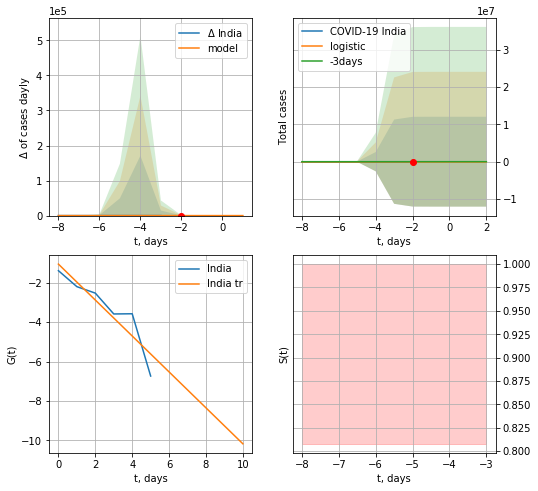

India data at: 2020-05-05
+3 day model MAPE: 0.19485949734745373
model: logistic
coeffs:  [29.40035511  4.01433678 -3.67575724]
rational stdev:  409363.3184161478
forecast at the end of period: +4 days
	 deltaDaycases:  0
	 total cases:  29 ± 12035426
	 total death:  1 ± 1228089
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


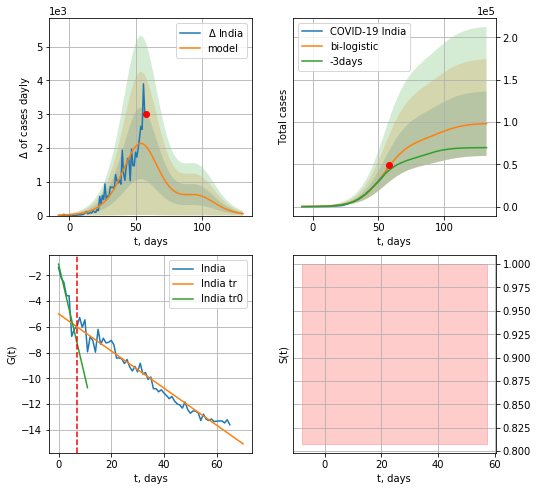

India data at: 2020-05-05
+3 day model MAPE: 0.12023419440676901
model: bi-logistic
coeffs:  [7.88683123e+04 1.07455352e-01 5.43631900e+01] [29.40035511  4.01433678 -3.67575724]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.3885200505338061
forecast at the end of period: +74 days
	 deltaDaycases:  56
	 total cases:  98105 ± 38116
	 total death:  3363 ± 3919
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.961272
 intercept: -4.983709
 slope: -0.144434


In [321]:
dfID = read_df(pd.DataFrame(),"ID")
x = forecast("India",dfID[:7],d1,6*7-dT)
xx = forecast2("India",dfID[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


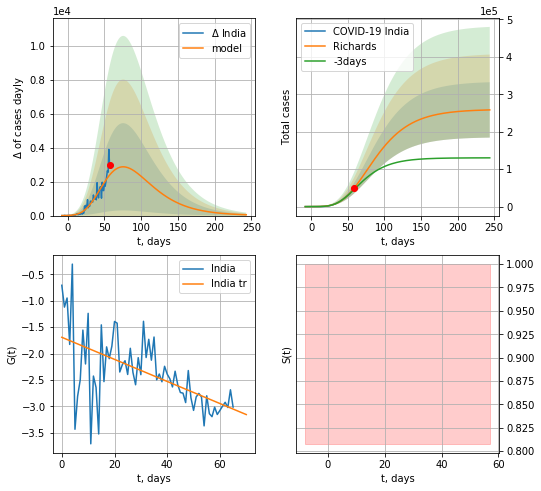

India data at: 2020-05-05
+3 day model MAPE: 0.073571
model: Richards
coeffs: [ 2.59933002e+05  1.56300100e+00 -5.37915278e+01  1.94310969e-02]
rational stdev: 0.286127
forecast at the end of period: +186 days
	 deltaDaycases: 48
	 total cases: 258358 ± 73923
	 total death: 8858 ± 7603
trend coefficient of determination: 0.339696
 intercept: -1.691540
 slope: -0.020897


In [322]:
x = forecastRR("India",dfID[:],d1,32*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


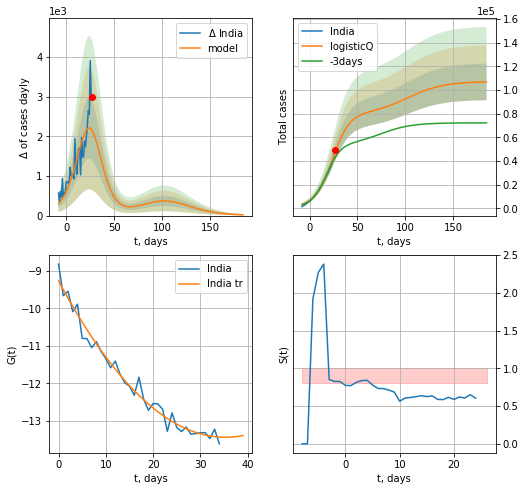

India data at: 2020-05-05
+3 day model MAPE: 0.118782
model: logisticQ
coeffs: [ 7.91913430e+04  2.79965388e-04  2.34358834e+01 -3.69818231e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.145006
forecast at the end of period: +158 days
	 deltaDaycases: 18
	 total cases: 106907 ± 15502
	 total death: 3665 ± 1594
trend coefficient of determination: 0.975881
 intercept_: -9.271747175667429
 coeffs_: [ 0.         -0.23640887  0.00335483]


In [323]:
x = forecastRRR("India",dfID[31:].fillna(0),d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
          date   cases  active  death
58 2020-05-01  4532.0  3015.0  225.0
59 2020-05-02  4681.0  3124.0  237.0
60 2020-05-03  4783.0  3183.0  246.0
61 2020-05-04  4887.0  3185.0  260.0
62 2020-05-05  5020.0  3284.0  264.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


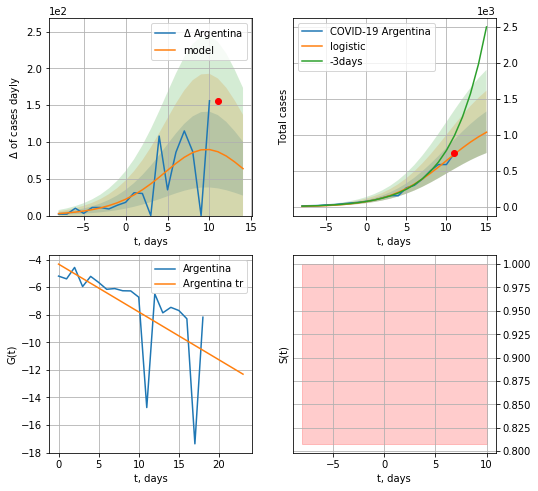

Argentina data at: 2020-05-05
+3 day model MAPE: 0.3427791439688051
model: logistic
coeffs:  [1.30607344e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.2777261346981541
forecast at the end of period: +4 days
	 deltaDaycases:  63
	 total cases:  1036 ± 287
	 total death:  54 ± 44
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


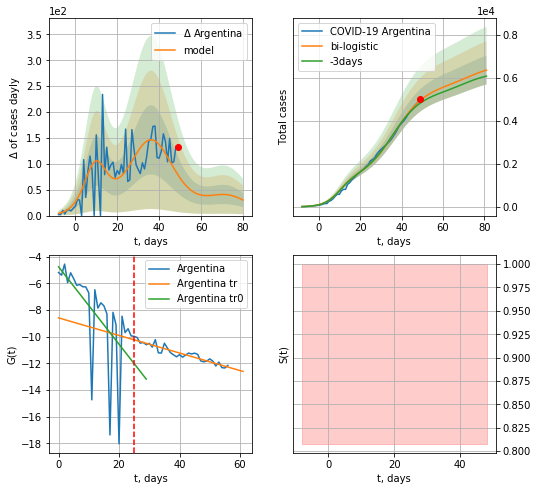

Argentina data at: 2020-05-05
+3 day model MAPE: 0.028128913173211686
model: bi-logistic
coeffs:  [4.27930053e+03 1.35740961e-01 3.65644846e+01] [1.30607344e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.10516299070227773
forecast at the end of period: +32 days
	 deltaDaycases:  30
	 total cases:  6371 ± 670
	 total death:  335 ± 105
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.872351
 intercept: -8.592371
 slope: -0.065740


In [324]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,6*7-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,10*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


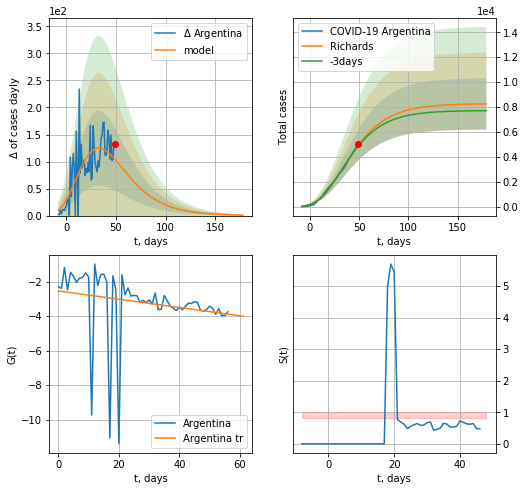

Argentina data at: 2020-05-05
+3 day model MAPE: 0.017747
model: Richards
coeffs: [ 8.27552870e+03  2.94864572e+00 -7.02461560e+01  1.40027997e-02]
rational stdev: 0.249348
forecast at the end of period: +130 days
	 deltaDaycases: 0
	 total cases: 8255 ± 2058
	 total death: 434 ± 324
trend coefficient of determination: 0.040879
 intercept: -2.536919
 slope: -0.024027


In [325]:
x = forecastRR('Argentina',dfAG[5:].fillna(0),d1,24*7-dT,1.0)


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


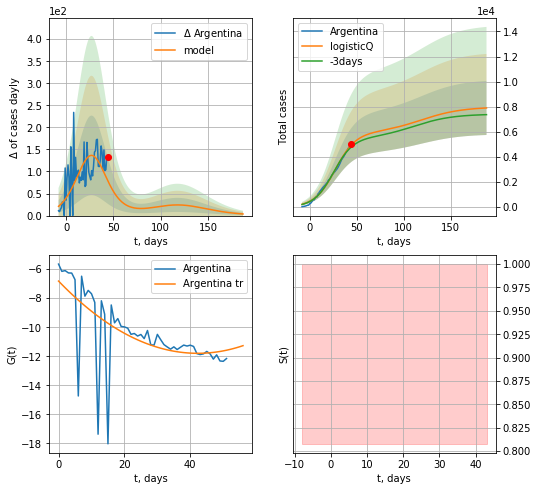

Argentina data at: 2020-05-05
+3 day model MAPE: 0.034287
model: logisticQ
coeffs: [ 5.89508228e+03  1.71995546e-06  2.71928622e+01 -5.32937903e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.272334
forecast at the end of period: +144 days
	 deltaDaycases: 3
	 total cases: 7901 ± 2151
	 total death: 415 ± 339
trend coefficient of determination: 0.366544
 intercept_: -6.820620255091356
 coeffs_: [ 0.         -0.23543198  0.00278636]


In [326]:
x = forecastRRR('Argentina',dfAG[10:],d1,26*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


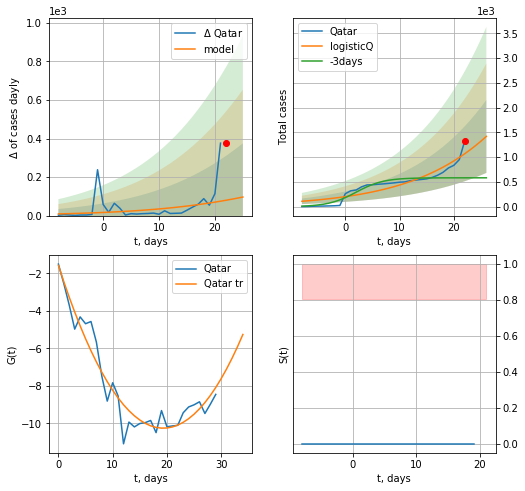

Qatar data at: 2020-05-05
+3 day model MAPE: 0.969413
model: logisticQ
coeffs: [ 1.17152185e+04  1.38701641e-05  5.07935568e+01 -5.73629534e+03]
rational stdev: 0.519403
forecast at the end of period: +4 days
	 deltaDaycases: 96
	 total cases: 1419 ± 737
	 total death: 0 ± 0
trend coefficient of determination: 0.927713
 intercept_: -1.5731660703847918
 coeffs_: [ 0.         -0.89771885  0.02321841]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp


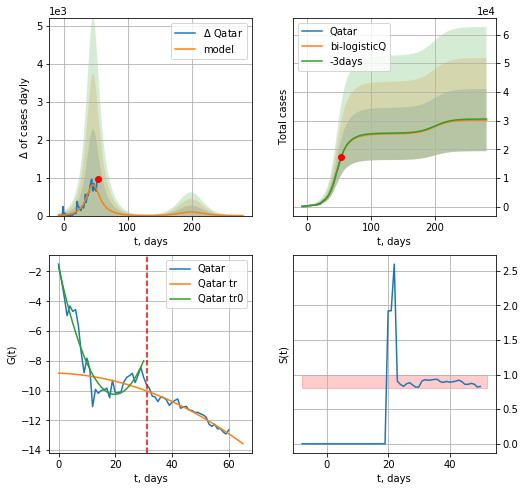

Qatar data at: 2020-05-05
+3 day model MAPE: 0.005799
model: bi-logisticQ
coeffs: [ 1.36260876e+04  3.64092072e-04  4.56522924e+01 -4.20147499e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.359172
forecast at the end of period: +228 days
	 deltaDaycases: 0
	 total cases: 30160 ± 10832
	 total death: 21 ± 22
bi-logisticQ approximation splitting point: 31
trend coefficient of determination: 0.919409
 intercept_: -1.6852707465713292
 coeffs_: [ 0.         -0.86529683  0.02183056]
trend coefficient of determination: 0.949976
 intercept_: -8.83404246077564
 coeffs_: [ 0.         -0.00692693 -0.00101751]


In [357]:
vL=31
x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,6*7-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


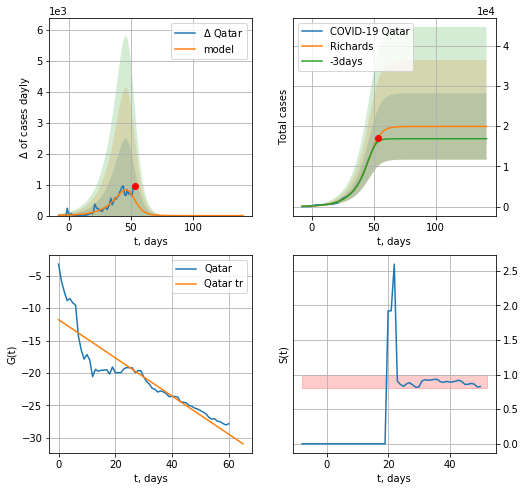

Qatar data at: 2020-05-05
+3 day model MAPE: 0.070959
model: Richards
coeffs: [1.99143750e+04 9.50642874e-02 5.03034698e+01 2.55680165e+00]
rational stdev: 0.413910
forecast at the end of period: +88 days
	 deltaDaycases: 0
	 total cases: 19914 ± 8242
	 total death: 13 ± 16
trend coefficient of determination: 0.819193
 intercept: -11.777373
 slope: -0.294520


In [358]:
x = forecastRR('Qatar',dfQR[:].fillna(0),d1,18*7-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])

In [359]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
          date    cases  active  death
76 2020-05-01  13038.0   10384  111.0
77 2020-05-02  13599.0   10816  119.0
78 2020-05-03  14163.0   11274  126.0
79 2020-05-04  14730.0   11627  137.0
80 2020-05-05  15192.0   11893  146.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


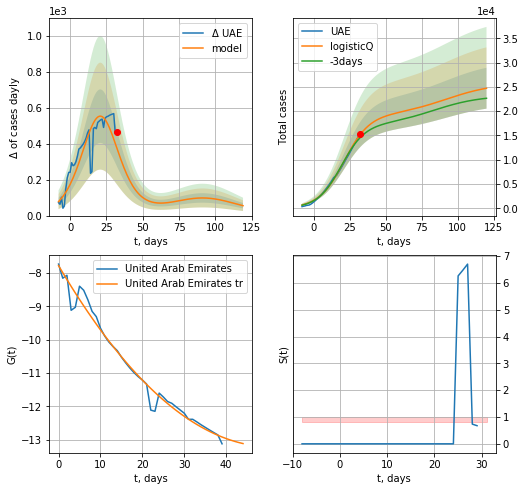

UAE data at: 2020-05-05
+3 day model MAPE: 0.045239
model: logisticQ
coeffs: [ 1.90818769e+04  3.29828527e-06  2.11158941e+01 -3.47312277e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.170335
forecast at the end of period: +88 days
	 deltaDaycases: 55
	 total cases: 24715 ± 4209
	 total death: 237 ± 121
trend coefficient of determination: 0.977148
 intercept_: -7.775565297048729
 coeffs_: [ 0.         -0.21381303  0.00210199]


In [360]:
dfUAE = read_df(pd.DataFrame(),"UAE")
x = forecastRRR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


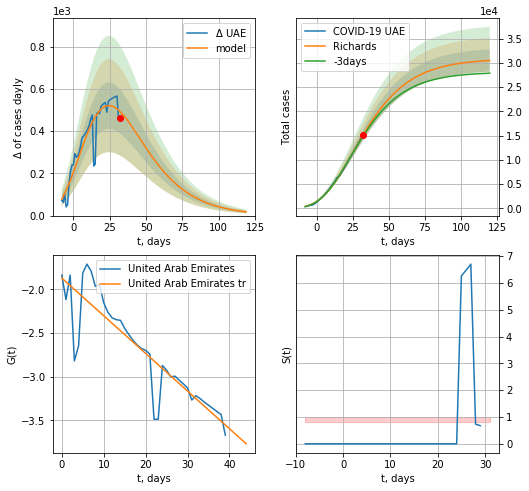

UAE data at: 2020-05-05
+3 day model MAPE: 0.018682
model: Richards
coeffs: [ 3.08625227e+04  2.53757446e+00 -6.14330946e+01  1.82607680e-02]
rational stdev: 0.075660
forecast at the end of period: +88 days
	 deltaDaycases: 17
	 total cases: 30487 ± 2306
	 total death: 292 ± 66
trend coefficient of determination: 0.792763
 intercept: -1.870719
 slope: -0.043110


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


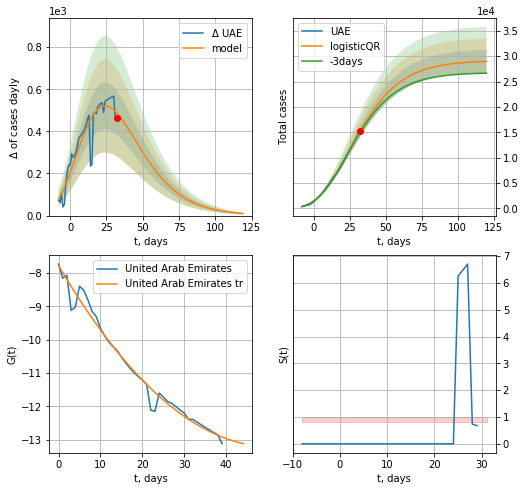

UAE data at: 2020-05-05
+3 day model MAPE: 0.01931099541917308
model: logisticQR
coeffs:  [ 2.91279278e+04  8.64570920e-03 -9.62352682e+01 -7.16432883e+02
  6.55727050e-03]
rational stdev:  0.07826055801991043
forecast at the end of period: +88 days
	 deltaDaycases:  9
	 total cases:  28971 ± 2267
	 total death:  278 ± 65
trend coefficient of determination: 0.977148
 intercept_: -7.775565297048729
 coeffs_: [ 0.         -0.21381303  0.00210199]


In [361]:
x = forecastRR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [362]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

SA
          date    cases  active  death
59 2020-05-01  24097.0   20373  169.0
60 2020-05-02  25459.0   21518  176.0
61 2020-05-03  27011.0   22693  184.0
62 2020-05-04  28656.0   23989  191.0
63 2020-05-05  30251.0   24620  200.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp


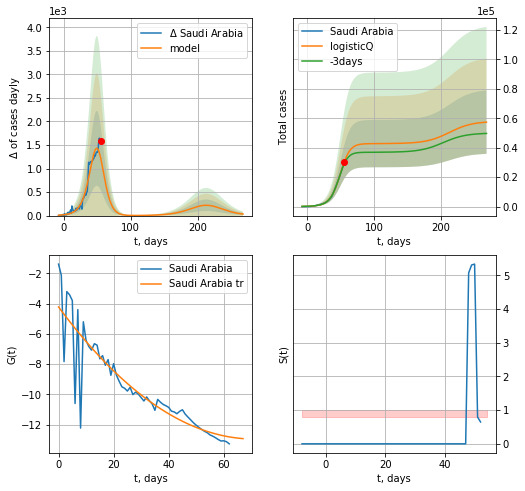

Saudi Arabia data at: 2020-05-05
+3 day model MAPE: 0.044792
model: logisticQ
coeffs: [ 4.27965864e+04  4.77413505e-04  4.88924865e+01 -2.30486089e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.375761
forecast at the end of period: +214 days
	 deltaDaycases: 32
	 total cases: 57405 ± 21570
	 total death: 379 ± 427
trend coefficient of determination: 0.799794
 intercept_: -4.216989925075281
 coeffs_: [ 0.         -0.24552397  0.00172683]


In [363]:
dfSA = read_df(pd.DataFrame(),"SA")
x = forecastRRR('Saudi Arabia',dfSA[:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


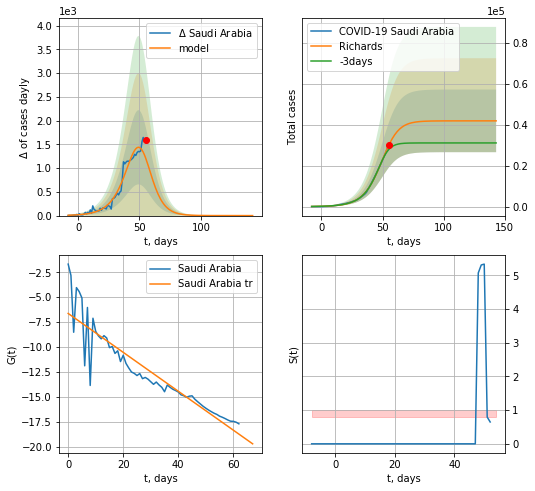

Saudi Arabia data at: 2020-05-05
+3 day model MAPE: 0.091606
model: Richards
coeffs: [4.18878604e+04 1.08572320e-01 5.19853088e+01 1.43118051e+00]
rational stdev: 0.365171
forecast at the end of period: +88 days
	 deltaDaycases: 0
	 total cases: 41887 ± 15296
	 total death: 276 ± 302
trend coefficient of determination: 0.843371
 intercept: -6.634844
 slope: -0.195239


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


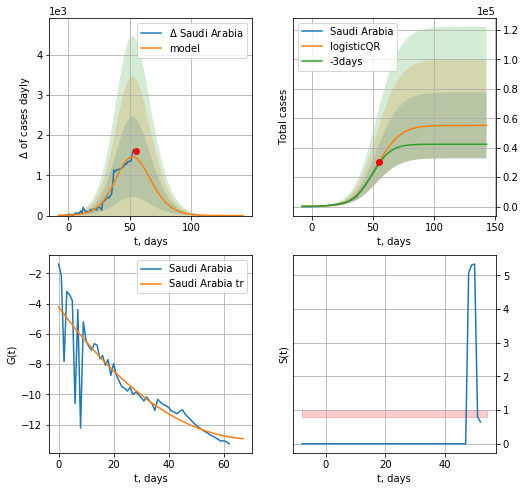

Saudi Arabia data at: 2020-05-05
+3 day model MAPE: 0.03536836252527488
model: logisticQR
coeffs:  [ 5.51549350e+04  3.68512437e-03 -3.87699556e+01  1.83309601e+01
  1.73575722e-01]
rational stdev:  0.40470045220325523
forecast at the end of period: +88 days
	 deltaDaycases:  0
	 total cases:  55154 ± 22321
	 total death:  364 ± 441
trend coefficient of determination: 0.799794
 intercept_: -4.216989925075281
 coeffs_: [ 0.         -0.24552397  0.00172683]


In [364]:
x = forecastRR('Saudi Arabia',dfSA[:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
x = forecastQR('Saudi Arabia',dfSA[:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

Sri
          date  cases  active  death
49 2020-04-28  619.0       0      0
50 2020-04-29  649.0       0      0
51 2020-04-30  663.0       0      0
52 2020-05-01  690.0       0      0
53 2020-05-02  702.0       0      0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


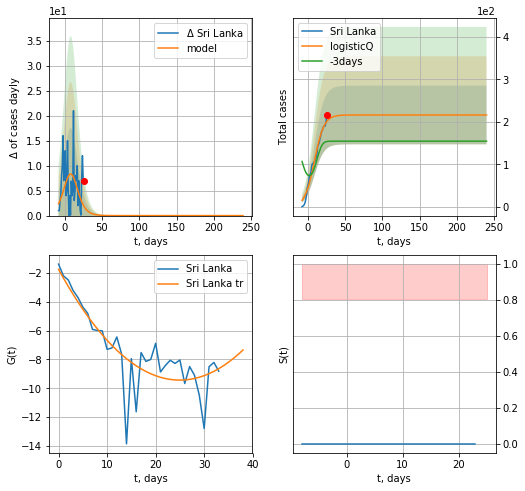

Sri Lanka data at: 2020-05-05
+3 day model MAPE: 0.324795
model: logisticQ
coeffs: [ 2.16378650e+02  6.51099157e-05  8.63891239e+00 -2.35705824e+03]
rational stdev: 0.318765
forecast at the end of period: +214 days
	 deltaDaycases: 0
	 total cases: 216 ± 68
	 total death: 2 ± 1
trend coefficient of determination: 0.700492
 intercept_: -1.7495743977322356
 coeffs_: [ 0.         -0.61543768  0.0123203 ]


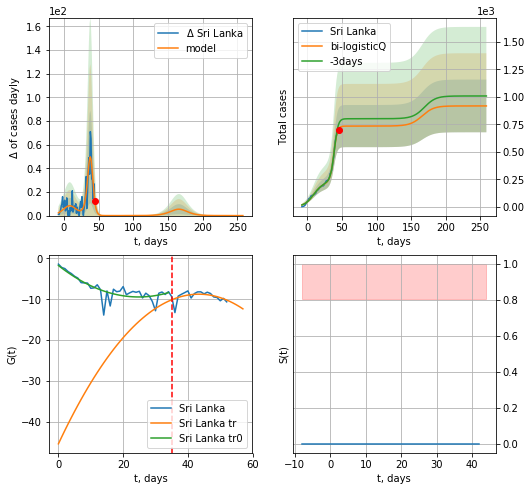

Sri Lanka data at: 2020-05-05
+3 day model MAPE: 0.062838
model: bi-logisticQ
coeffs: [ 5.18033887e+02  4.95277952e-03  3.80543331e+01 -3.87676409e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.261390
forecast at the end of period: +214 days
	 deltaDaycases: 0
	 total cases: 917 ± 239
	 total death: 10 ± 7
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.700900
 intercept_: -1.7291427146735243
 coeffs_: [ 0.         -0.62059696  0.01251448]
trend coefficient of determination: 0.356970
 intercept_: -45.35102800084556
 coeffs_: [ 0.          1.68688112 -0.01943157]


In [365]:
dfSri = read_df(pd.DataFrame(),"Sri")
vL= 35
x = forecastRRR('Sri Lanka',dfSri[:vL],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Sri Lanka',dfSri[:],d1,36*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

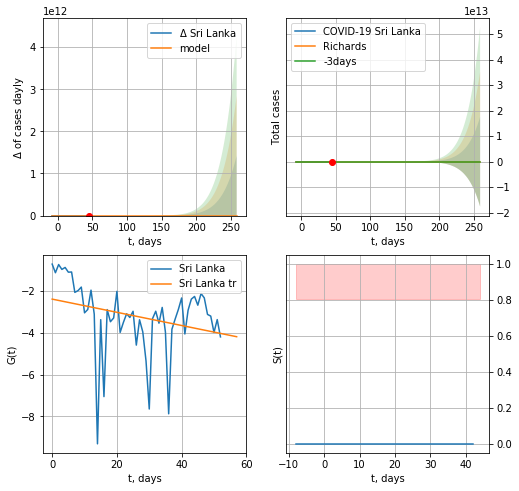

Sri Lanka data at: 2020-05-05
+3 day model MAPE: 1.000000
model: Richards
coeffs: [4.46105073e+02 3.48947501e-01 1.30751802e-01 1.91221241e-02]
rational stdev: 205193802976327.718750
forecast at the end of period: +214 days
	 deltaDaycases: 0
	 total cases: 0 ± 17607759258900
	 total death: 0 ± 0
trend coefficient of determination: 0.080211
 intercept: -2.384018
 slope: -0.031605


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


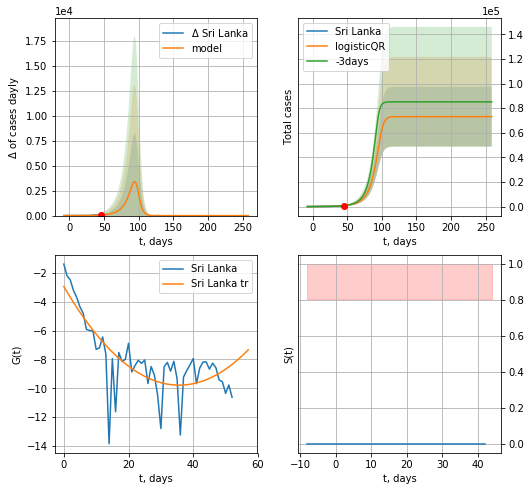

Sri Lanka data at: 2020-05-05
+3 day model MAPE: 0.05518169076740634
model: logisticQR
coeffs:  [ 7.31338913e+04  3.14273708e-04  9.79417920e+01 -2.30767672e+02
  2.83954838e+00]
rational stdev:  0.33242925378994026
forecast at the end of period: +214 days
	 deltaDaycases:  0
	 total cases:  73133 ± 24311
	 total death:  853 ± 850
trend coefficient of determination: 0.612466
 intercept_: -2.9436925942027994
 coeffs_: [ 0.         -0.38378893  0.00538271]


In [366]:
x = forecastRR('Sri Lanka',dfSri[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
x = forecastQR('Sri Lanka',dfSri[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [378]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [4]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=13:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

/usr/local/lib/python3.5/dist-packages/requests/__init__.py:83: RequestsDependencyWarning: Old version of cryptography ([1, 2, 3]) may cause slowdown.
  warnings.warn(warning, RequestsDependencyWarning)


[13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13]
1:"Country,Other"
2:"TotalCases"
3:"NewCases"
4:"TotalDeaths"
5:"NewDeaths"
6:"TotalRecovered"
7:"ActiveCases"
8:"Serious,Critical"
9:"Tot Cases/1M pop"
10:"Deaths/1M pop"
11:"TotalTests"
12:"Tests/
1M pop
"
13:"Continent"
[461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461]


In [5]:
df.head(10)

,ActiveCases,Continent,"Country,Other",Deaths/1M pop,NewCases,NewDeaths,"Serious,Critical",Tests/ 1M pop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,Tot Cases/1M pop
0,"1,019,143",North America,\nNorth America\n,,"+1,386",254,"17,362",,"1,348,588","79,700","249,745",,
1,"781,335",Europe,\nEurope\n,,46,10,"16,502",,"1,494,019","144,112","568,572",,
2,"250,527",Asia,\nAsia\n,,580,17,"5,258",,"587,772","20,467","316,778",,
3,"143,797",South America,\nSouth America\n,,"+1,371",42,"9,958",,"238,196","12,023","82,376",,
4,"31,329",Africa,\nAfrica\n,,64,2,128,,"50,230","1,919","16,982",,
5,965,Australia/Oceania,\nOceania\n,,28,2,31,,"8,467",118,"7,384",,
6,61,,\n\n,,,,4,,721,15,645,,
7,"2,227,157",All,World,33.1,"+3,475",327,"49,243",,"3,727,993","258,354","1,242,482",,478
8,"964,734",North America,USA,218,,,"16,179","23,347","1,237,633","72,271","200,628","7,727,811","3,739"
9,"70,230",Europe,Spain,548,,,"2,254","41,332","250,561","25,613","154,718","1,932,455","5,359"


In [6]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",df.columns[3]:"Deathsper1Mpop","Serious,Critical":"Serious_Critical",df.columns[7]:"Testsper1Mpop",df.columns[12]:"TotCasesper1Mpop"})
df.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,"1,019,143",North America,\nNorth America\n,,"+1,386",254,"17,362",,"1,348,588","79,700","249,745",,
1,"781,335",Europe,\nEurope\n,,46,10,"16,502",,"1,494,019","144,112","568,572",,
2,"250,527",Asia,\nAsia\n,,580,17,"5,258",,"587,772","20,467","316,778",,
3,"143,797",South America,\nSouth America\n,,"+1,371",42,"9,958",,"238,196","12,023","82,376",,
4,"31,329",Africa,\nAfrica\n,,64,2,128,,"50,230","1,919","16,982",,


In [7]:
df[df["Country"]=="Lithuania"]

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
90,699,Europe,Lithuania,17,,,17,"54,772","1,423",46,678,"149,106",523
322,699,Europe,Lithuania,17,4,,17,"54,772","1,423",46,678,"149,106",523


In [8]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

230


In [9]:
df.head(24)

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,"1,019,143",North America,\nNorth America\n,,"+1,386",254,"17,362",,"1,348,588","79,700","249,745",,
1,"781,335",Europe,\nEurope\n,,46,10,"16,502",,"1,494,019","144,112","568,572",,
2,"250,527",Asia,\nAsia\n,,580,17,"5,258",,"587,772","20,467","316,778",,
3,"143,797",South America,\nSouth America\n,,"+1,371",42,"9,958",,"238,196","12,023","82,376",,
4,"31,329",Africa,\nAfrica\n,,64,2,128,,"50,230","1,919","16,982",,
5,965,Australia/Oceania,\nOceania\n,,28,2,31,,"8,467",118,"7,384",,
6,61,,\n\n,,,,4,,721,15,645,,
7,"2,227,157",All,World,33.1,"+3,475",327,"49,243",,"3,727,993","258,354","1,242,482",,478
8,"964,734",North America,USA,218,,,"16,179","23,347","1,237,633","72,271","200,628","7,727,811","3,739"
9,"70,230",Europe,Spain,548,,,"2,254","41,332","250,561","25,613","154,718","1,932,455","5,359"


In [10]:
df.at[11, 'TotalRecovered'] = 0
df.at[22, 'TotalRecovered'] = 0
#df.at[12, 'TotalRecovered'] = 0


In [11]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1019143,North America,\nNorth America\n,NaN,1386.0,254.0,17362.0,NaN,1348588,79700.0,249745.0,NaN,NaN
1,781335,Europe,\nEurope\n,NaN,46.0,10.0,16502.0,NaN,1494019,144112.0,568572.0,NaN,NaN
2,250527,Asia,\nAsia\n,NaN,580.0,17.0,5258.0,NaN,587772,20467.0,316778.0,NaN,NaN
3,143797,South America,\nSouth America\n,NaN,1371.0,42.0,9958.0,NaN,238196,12023.0,82376.0,NaN,NaN
4,31329,Africa,\nAfrica\n,NaN,64.0,2.0,128.0,NaN,50230,1919.0,16982.0,NaN,NaN
5,965,Australia/Oceania,\nOceania\n,NaN,28.0,2.0,31.0,NaN,8467,118.0,7384.0,NaN,NaN
6,61,,\n\n,NaN,NaN,NaN,4.0,NaN,721,15.0,645.0,NaN,NaN
7,2227157,All,World,33.1,3475.0,327.0,49243.0,NaN,3727993,258354.0,1242482.0,NaN,478.0
8,964734,North America,USA,218.0,NaN,NaN,16179.0,23347.0,1237633,72271.0,200628.0,7727811.0,3739.0
9,70230,Europe,Spain,548.0,NaN,NaN,2254.0,41332.0,250561,25613.0,154718.0,1932455.0,5359.0


In [12]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
225,143797,South America,Total:,NaN,1371.0,42.0,9958.0,NaN,238196,12023.0,82376.0,NaN,NaN
226,31329,Africa,Total:,NaN,64.0,2.0,128.0,NaN,50230,1919.0,16982.0,NaN,NaN
227,965,Australia/Oceania,Total:,NaN,28.0,2.0,31.0,NaN,8467,118.0,7384.0,NaN,NaN
228,61,,Total:,NaN,NaN,NaN,4.0,NaN,721,15.0,645.0,NaN,NaN
229,434135,Europe,European Union,247.301231,46.0,10.0,11888.0,26309.595681,1052341,110111.0,507845.0,11714361.0,2363.480708


In [13]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1019143,North America,North America,NaN,1386.0,254.0,17362.0,NaN,1348588,79700.0,249745.0,NaN,NaN
1,781335,Europe,Europe,NaN,46.0,10.0,16502.0,NaN,1494019,144112.0,568572.0,NaN,NaN
2,250527,Asia,Asia,NaN,580.0,17.0,5258.0,NaN,587772,20467.0,316778.0,NaN,NaN
3,143797,South America,South America,NaN,1371.0,42.0,9958.0,NaN,238196,12023.0,82376.0,NaN,NaN
4,31329,Africa,Africa,NaN,64.0,2.0,128.0,NaN,50230,1919.0,16982.0,NaN,NaN


In [14]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [15]:
#df

In [14]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1019143,North America,North America,NaN,1386.0,254.0,17362.0,NaN,1348588,79700.0,249745.0,NaN,NaN
1,781335,Europe,Europe,NaN,46.0,10.0,16502.0,NaN,1494019,144112.0,568572.0,NaN,NaN
2,250527,Asia,Asia,NaN,580.0,17.0,5258.0,NaN,587772,20467.0,316778.0,NaN,NaN
3,143797,South America,South America,NaN,1371.0,42.0,9958.0,NaN,238196,12023.0,82376.0,NaN,NaN
4,31329,Africa,Africa,NaN,64.0,2.0,128.0,NaN,50230,1919.0,16982.0,NaN,NaN
5,965,Australia/Oceania,Oceania,NaN,28.0,2.0,31.0,NaN,8467,118.0,7384.0,NaN,NaN
7,2227157,All,World,33.1,3475.0,327.0,49243.0,NaN,3727993,258354.0,1242482.0,NaN,478.0
8,964734,North America,USA,218.0,NaN,NaN,16179.0,23347.0,1237633,72271.0,200628.0,7727811.0,3739.0
9,70230,Europe,Spain,548.0,NaN,NaN,2254.0,41332.0,250561,25613.0,154718.0,1932455.0,5359.0
10,98467,Europe,Italy,485.0,NaN,NaN,1427.0,37158.0,213013,29315.0,85231.0,2246666.0,3523.0


In [18]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [19]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

Singapore SG
Australia AS
Germany GR
Luxembourg LX
Ireland IR
Switzerland SZ
China CN
Denmark DK
Latvia LV
Poland PL
Finland FI
Greece GC
Portugal PT
Russia RS
Cyprus CP
Belarus BR
USA US
Iceland IC
Italy IT
Egypt EG
Saudi Arabia SA
Canada CA
Czechia CH
Peru PU
Turkey TR
Qatar QR
Algeria AR
Austria AT
UAE UAE
Lithuania LT
Slovenia SV
Morocco MR
Philippines PH
Israel IS
Brazil BZ
Indonesia IE
Malaysia ML
Japan JP
Iran IN
Serbia SB
Slovakia SL
Ecuador ED
Netherlands NL
India ID
France FR
Belgium BG
Romania RM
Mexico MX
Argentina AG
UK GB
Estonia ES
Spain SP
Ukraine Ukr
Chile CL
Bulgaria BL
European Union EU
Panama PM
Thailand TH
World World
Hungary HG
Malta MT
Norway NG
Pakistan PK
Iraq IQ
S. Korea KR
New Zealand ZL
Croatia CT
Colombia CB
Sweden SW


In [20]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    #if c!='European Union':
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America 2020-05-05,1348588,1019143,79700.0
Europe
Europe 2020-05-05,1494019,781335,144112.0
Asia
Asia 2020-05-05,587772,250527,20467.0
South America
South America 2020-05-05,238196,143797,12023.0
Africa
Africa 2020-05-05,50230,31329,1919.0
Oceania
Oceania 2020-05-05,8467,965,118.0
World
World 2020-05-05,3727993,2227157,258354.0
USA
USA 2020-05-05,1237633,964734,72271.0
Spain
Spain 2020-05-05,250561,70230,25613.0
Italy
Italy 2020-05-05,213013,98467,29315.0
UK
UK 2020-05-05,194990,165219,29427.0
France
France 2020-05-05,170551,92284,25531.0
Germany
Germany 2020-05-05,167007,24914,6993.0
Russia
Russia 2020-05-05,155370,134054,1451.0
Turkey
Turkey 2020-05-05,129491,52686,3520.0
Brazil
Brazil 2020-05-05,115953,59774,7958.0
Iran
Iran 2020-05-05,99970,13155,6340.0
Canada
Canada 2020-05-05,62046,31010,4043.0
Peru
Peru 2020-05-05,51189,34332,1444.0
Belgium
Belgium 2020-05-05,50509,30052,8016.0
India
India 2020-05-05,49436,33558,1695.0
Netherlands
Netherlands 2020-05-05,41087

Seychelles
Seychelles 2020-05-05,11,3,nan
Suriname
Suriname 2020-05-05,10,0,1.0
MS Zaandam
MS Zaandam 2020-05-05,9,7,2.0
Mauritania
Mauritania 2020-05-05,8,1,1.0
Papua New Guinea
Papua New Guinea 2020-05-05,8,0,nan
Bhutan
Bhutan 2020-05-05,7,2,nan
British Virgin Islands
British Virgin Islands 2020-05-05,6,2,1.0
Caribbean Netherlands
Caribbean Netherlands 2020-05-05,6,6,nan
St. Barth
St. Barth 2020-05-05,6,0,nan
Western Sahara
Western Sahara 2020-05-05,6,1,nan
Anguilla
Anguilla 2020-05-05,3,0,nan
Comoros
Comoros 2020-05-05,3,3,nan
Saint Pierre Miquelon
Saint Pierre Miquelon 2020-05-05,1,1,nan
China
China 2020-05-05,82883,339,4633.0
Total:
Total: 2020-05-05,1348588,1019143,79700.0
Total:
Total: 2020-05-05,1348588,1019143,79700.0
Total:
Total: 2020-05-05,1348588,1019143,79700.0
Total:
Total: 2020-05-05,1348588,1019143,79700.0
Total:
Total: 2020-05-05,1348588,1019143,79700.0
Total:
Total: 2020-05-05,1348588,1019143,79700.0
Total:
Total: 2020-05-05,1348588,1019143,79700.0
European Union
Eur

In [21]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [22]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaSG.csv 2020-05-05,19410,17873,18.0

append data/coronaAS.csv 2020-05-05,6875,803,97.0

append data/coronaGR.csv 2020-05-05,167007,24914,6993.0

append data/coronaLX.csv 2020-05-05,3840,332,96.0

append data/coronaIR.csv 2020-05-05,21983,7258,1339.0

append data/coronaSZ.csv 2020-05-05,30009,2814,1795.0

append data/coronaCN.csv 2020-05-05,82883,339,4633.0

append data/coronaDK.csv 2020-05-05,9821,2022,503.0

append data/coronaLV.csv 2020-05-05,896,531,17.0

append data/coronaPL.csv 2020-05-05,14431,9435,716.0

append data/coronaFI.csv 2020-05-05,5412,1666,246.0

append data/coronaGC.csv 2020-05-05,2642,1122,146.0

append data/coronaPT.csv 2020-05-05,25702,22885,1074.0

append data/coronaRS.csv 2020-05-05,155370,134054,1451.0

append data/coronaCP.csv 2020-05-05,878,567,15.0

append data/coronaBR.csv 2020-05-05,18350,14472,107.0

append data/coronaUS.csv 2020-05-05,1237633,964734,72271.0

append data/coronaIC.csv 2020-05-05,1799,56,10.0

append data/coronaIT.csv 2020-0

In [283]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [285]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF"}
    
for  c in cD3:#countryDic1:
    if c != "South Africa":
        continue
    dfc = pd.read_csv("europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/corona%s.csv'%(cD3[c]), index=False)#countryDic1

South Africa 0


In [911]:
#dfRM = read_df(pd.DataFrame(),"RM")

RM
          date  cases  active
29 2020-04-01   2245     NaN
30 2020-04-02   2460     NaN
31 2020-04-03   2738     NaN
32 2020-04-04   3183     NaN
33 2020-04-05   3613     0.0


In [892]:
dfc.head()#[['date', 'cases']]

,date,day,month,year,cases,deaths,countriesAndTerritories,geoId,countryterritoryCode,popData2018
6873,2020-02-27,27,2,2020,1,0,Romania,RO,ROU,19473936.0
6871,2020-02-29,29,2,2020,3,0,Romania,RO,ROU,19473936.0
6868,2020-03-04,4,3,2020,4,0,Romania,RO,ROU,19473936.0
6867,2020-03-06,6,3,2020,6,0,Romania,RO,ROU,19473936.0
6866,2020-03-07,7,3,2020,7,0,Romania,RO,ROU,19473936.0


In [875]:
date(2012, 3, 16)

datetime.date(2012, 3, 16)

In [7]:
len(countriesEU)

27

In [309]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

World 549497


In [328]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


7185.14611304862

In [287]:
#dfD

In [339]:
#dfAll[dfAll['Country'].isin(cLst)]

In [364]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

39345941.0 5058.879474387986


In [365]:
TT/7.7776e3

5058.879474387986

In [366]:
sum(dfp.Population)/1e6

16014.157998

In [282]:
dfAll[dfAll.TotalTests>0]

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
7,456815,North America,USA,57.000000,0.0,0.0,10917.0,7670.000000,502876,18747.0,27314.0,2538888.0,1519.000000
8,86524,Europe,Spain,344.000000,0.0,0.0,7371.0,7593.000000,158273,16081.0,55668.0,355000.0,3385.000000
9,98273,Europe,Italy,312.000000,0.0,0.0,3497.0,14999.000000,147577,18849.0,30455.0,906864.0,2441.000000
10,86740,Europe,France,202.000000,0.0,0.0,7004.0,5114.000000,124869,13197.0,24932.0,333807.0,1913.000000
11,65522,Europe,Germany,33.000000,0.0,0.0,4895.0,15730.000000,122171,2736.0,53913.0,1317887.0,1458.000000
12,64456,Europe,UK,132.000000,0.0,0.0,1559.0,4667.000000,73758,8958.0,344.0,316836.0,1086.000000
13,28495,Asia,Iran,50.000000,0.0,0.0,3969.0,2888.000000,68192,4232.0,35465.0,242568.0,812.000000
14,43600,Asia,Turkey,12.000000,0.0,0.0,1667.0,3643.000000,47029,1006.0,2423.0,307210.0,558.000000
15,18080,Europe,Belgium,260.000000,0.0,0.0,1278.0,7269.000000,26667,3019.0,5568.0,84248.0,2301.000000
16,12449,Europe,Switzerland,116.000000,0.0,0.0,386.0,20625.000000,24551,1002.0,11100.0,178500.0,2837.000000


In [272]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [300]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [301]:
#cDicEU["Ireland"][1]

In [367]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

25788.52272812873

In [468]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

0.0

In [381]:
#dfAll

In [369]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

5366.514646351626

In [132]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta"
]

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

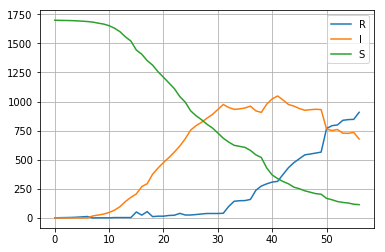

In [798]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

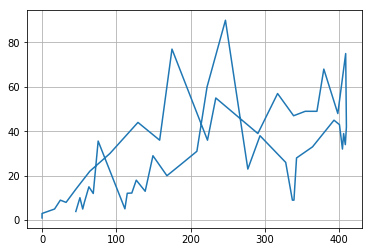

In [799]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

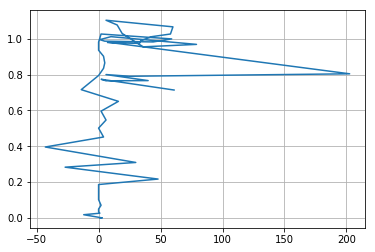

In [800]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

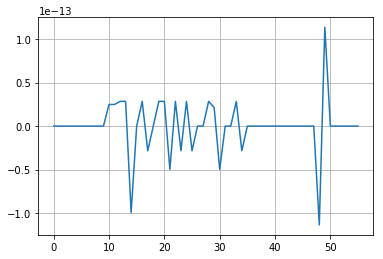

In [801]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [978]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [1044]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

[ 42.58270028 912.65637216]


In [1045]:
55*19

1045

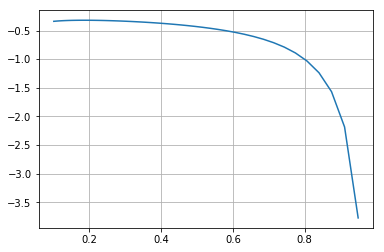

In [1046]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

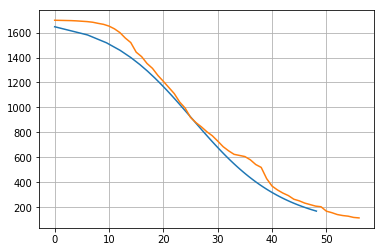

In [1059]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

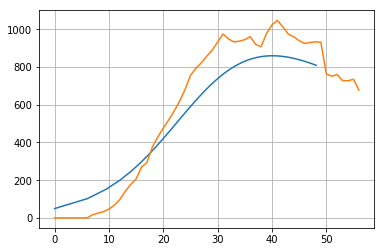

In [1058]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

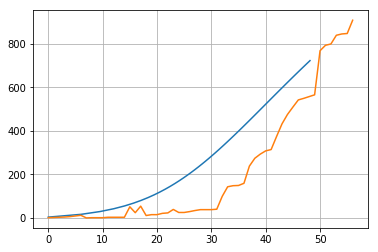

In [1060]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [992]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [824]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [995]:
gamma/(beta*x0)*55*4

45.5529411764706

In [1006]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

array([0.12589254, 0.16378937, 0.2130941 , 0.2772408 , 0.36069727,
       0.46927625, 0.61054023, 0.79432823])

In [1005]:
10**0.1

1.2589254117941673

In [1058]:
np.multiply(I,S)[1:].shape

(54,)

In [1056]:
np.diff(S).shape

(54,)

In [1063]:
50./400

0.125